# YC 1028

use ruiyi template to analyze the trials.
select rational ones for inverse.

# imports

In [1]:
import sys
import os
from pathlib import Path
import configparser
config = configparser.ConfigParser()
config.read_file(open('../../../privateconfig'))
resdir = Path(config['Datafolder']['data'])
workdir = Path(config['Codefolder']['workspace'])
os.chdir(workdir)

In [2]:
from scipy.io import loadmat
import numpy as np
from notification import notify
import matplotlib.pyplot as plt
from pathlib import Path
from matplotlib.patches import Ellipse, Circle
import matplotlib.transforms as transforms
from scipy.signal import savgol_filter
from scipy.stats import pearsonr, ttest_ind, sem, bootstrap
from scipy.ndimage import gaussian_filter1d
from sklearn.linear_model import LinearRegression, RidgeCV
from sklearn.model_selection import KFold
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.pipeline import make_pipeline
import pickle
import pandas as pd
from pingouin import partial_corr
import warnings
warnings.filterwarnings('ignore')

c:\Users\24455\miniconda3\envs\lab\lib\site-packages\numpy\_distributor_init.py:32: UserWarning: loaded more than 1 DLL from .libs:
c:\Users\24455\miniconda3\envs\lab\lib\site-packages\numpy\.libs\libopenblas.PYQHXLVVQ7VESDPUVUADXEVJOBGHJPAY.gfortran-win_amd64.dll
c:\Users\24455\miniconda3\envs\lab\lib\site-packages\numpy\.libs\libopenblas.XWYDX2IKJW2NMTWSFYNGFUWKQU3LYTCZ.gfortran-win_amd64.dll
  stacklevel=1)


In [3]:
# const
bin_size = 17 # how many bin of DT. about 0.1 s
num_bins = 24 # how many bins to use. use 2.4 s and discard the long trials.
monkey_height = 10
DT = 0.006 # DT for raw data
reward_boundary = 65
areas = ['PPC', 'PFC', 'MST']
t_total = 24
fontsize = 7; lw = 1

m = 'm53'
locals().update({m: {}})
figure_path = resdir/'figures'
datapaths = [i for i in Path(resdir/'mat_ruiyi').glob(f'{m}*.mat')]


In [4]:
# helper functions

def set_violin_plot(vp, facecolor, edgecolor, linewidth=1, alpha=1, ls='-', hatch=r''):
    plt.setp(vp['bodies'], facecolor=facecolor, edgecolor=edgecolor, 
             linewidth=linewidth, alpha=alpha ,ls=ls, hatch=hatch)
    plt.setp(vp['cmins'], facecolor=facecolor, edgecolor=edgecolor, 
             linewidth=linewidth, alpha=alpha)
    plt.setp(vp['cmaxes'], facecolor=facecolor, edgecolor=edgecolor, 
             linewidth=linewidth, alpha=alpha)
    plt.setp(vp['cbars'], facecolor=facecolor, edgecolor=edgecolor, 
             linewidth=linewidth, alpha=alpha)
    
    linecolor = 'k' if facecolor == 'None' else 'snow'
    if 'cmedians' in vp:
        plt.setp(vp['cmedians'], facecolor=linecolor, edgecolor=linecolor, 
                 linewidth=linewidth, alpha=alpha)
    if 'cmeans' in vp:
        plt.setp(vp['cmeans'], facecolor=linecolor, edgecolor=linecolor, 
                 linewidth=linewidth, alpha=alpha)
       
        
def downsample(data, bin_size=20):
    num_bin = data.shape[0] // bin_size
    data_ = data[:bin_size * num_bin]
    data_ = data_.reshape(num_bin, bin_size, data.shape[-1])
    data_ = np.nanmean(data_, axis=1)
    return data_


def convert_location_to_relative(
        mx,
        my,
        body_theta,
        x_fly,
        y_fly,
        dt=0.1

):
    '''
        calculate relative beliefs and states
    '''

    x_fly_rel = x_fly - mx
    y_fly_rel = y_fly - my
    phi = body_theta.reshape(-1)
    R = lambda theta : np.array([[np.cos(theta/180*np.pi),-np.sin(theta/180*np.pi)],[np.sin(theta/180*np.pi),np.cos(theta/180*np.pi)]])
    XY = np.zeros((2,x_fly_rel.shape[0]))
    XY[0,:] = x_fly_rel.reshape(-1)
    XY[1,:] = y_fly_rel.reshape(-1)
    rot = R(phi)
    XY = np.einsum('ijk,jk->ik', rot, XY)
    xfp_rel= XY[0, :]
    yfp_rel = XY[1, :]
    
    return xfp_rel,yfp_rel




def convert_location_to_angle(gaze_r, gaze_x, gaze_y, body_theta, body_x, body_y, hor_theta_eye, ver_theta_eye,DT=DT, remove_pre=True):
    '''
        convert the world overhead view location of the 'gaze' location to eye coord. 

        gaze location, the target
        gaze_r, relative distance
        gaze_x, gaze location x
        gaze_y,

        body_theta, heading direction
        body_x, monkey location x
        body_y, 

        hor_theta_eye, actual eye location in eye coord. used here to remove pre saccade (when monkey hasnt seen the target yet)
        ver_theta_eye
    '''

    #hor_theta = -np.rad2deg(np.arctan2(-(gaze_x - body_x), gaze_y - body_y) - (body_theta-np.deg2rad(90))).reshape(-1, 1) 
    hor_theta = -np.rad2deg(np.arctan2(-(gaze_x - body_x), np.sqrt((gaze_y - body_y)**2 + monkey_height**2))
                            - (body_theta-np.deg2rad(90))).reshape(-1, 1) 
    overshoot_idx = np.where(((gaze_x - body_x) * gaze_x < 0) | (gaze_y < body_y)
                             #| (abs(hor_theta.flatten()) > 60)
                            )[0]
    
    if overshoot_idx.size > 0:
        hor_theta[overshoot_idx[0]:] = np.nan

    k = -1 / np.tan(body_theta); b = body_y - k * body_x
    gaze_r_sign = (k * gaze_x + b < gaze_y).astype(int)
    gaze_r_sign[gaze_r_sign == 0] = -1
    ver_theta = -np.rad2deg(np.arctan2(monkey_height, gaze_r_sign * gaze_r)).reshape(-1, 1)
    overshoot_idx = np.where((gaze_r_sign < 0)
                             #| (abs(ver_theta.flatten()) > 60)
                            )[0]
    if overshoot_idx.size > 0:
        ver_theta[overshoot_idx[0]:] = np.nan
        
    # detect saccade
    if remove_pre:
        if hor_theta_eye.size > 2:
            saccade = np.sqrt((np.gradient(hor_theta_eye) / DT)**2 + 
                            (np.gradient(ver_theta_eye) / DT)**2)
            saccade_start_idx = np.where(saccade > 100)[0]
            saccade_start_idx = saccade_start_idx[0] + 16 if saccade_start_idx.size > 0 else None

            hor_theta[:saccade_start_idx] = np.nan
            ver_theta[:saccade_start_idx] = np.nan
        
    return hor_theta, ver_theta


def compute_error(data1, data2, mask):
    #data1 = data1[~mask]; data2 = data2[~mask]
    #corr = np.corrcoef(data1, data2)
    error = abs(data1 - data2)
    
    rng = np.random.default_rng(seed=0)
    data1_ = data1.copy(); data2_ = data2.copy()
    rng.shuffle(data1_); rng.shuffle(data2_)
    error_shuffle = abs(data1_ - data2_)
    return error



In [5]:
# load raw data

for idx, datapath in enumerate(datapaths):
    if datapath.stem[-1].isalpha():
        continue
    data = loadmat(datapath)
    eval(m)[datapath.stem] = data
    notify(datapath)
notify('all done! loaded')

In [6]:
# load neural data from raw

m_neural = {}
for key, data in eval(m).items():
    if key[-1].isalpha(): # skip except the monkey raw data file 
        continue
    
    try:
        trials_behv = data['trials_behv'][0]
        trials_units = data['units'][0]
        
        trials_neural = []
        for trial_idx, trial_behv in enumerate(trials_behv):
            trial_ts = trial_behv['continuous']['ts'][0][0].reshape(-1)
            activities = []
            
            for trials_unit in trials_units:
                fire_ts = trials_unit['trials'][0][trial_idx][0].reshape(-1)
                if fire_ts.size > 0 and fire_ts[-1] >= trial_ts[-1]:
                    fire_ts = fire_ts[:-1]
                activity = np.zeros_like(trial_ts)
                bin_indices = np.digitize(fire_ts, trial_ts)
                unique_bins, bin_counts = np.unique(bin_indices, return_counts=True)
                activity[unique_bins] = bin_counts
                activities.append(activity)

            activities = np.vstack(activities).T   # time * unit
            activities = gaussian_filter1d(activities, sigma=4, axis=0)
            trials_neural.append(activities)
            
        notify(key)
        m_neural[key + 'neural'] = trials_neural
    except:
        notify(f'bad, {key}')
        continue
eval(m).update(m_neural)
del m_neural

notify('done neural')

In [7]:
# downsample the task variables, including the trial errors.

m_extracted_continuous = {}; m_downsampled = {}; m_errors = {}
for key, data in eval(m).items():
    if key[-1].isalpha():
        continue
        
    trials_behv = data['trials_behv'][0]
    trials_units = data['units'][0]
    units_area = np.array([v[0] for v in trials_units['brain_area']])
    
    Xt = dict(zip(areas, [[[] for _ in range(num_bins)] for area in areas])) 
    Xdownsampled = dict(zip(areas, [[] for area in areas])) 
    Yt = [[] for _ in range(num_bins)]
    Ydownsampled = []
    Y = []
    trials_error = []; trials_error_sign = []; trials_target_angle = []; trials_target_distance = []
    for trial_idx, trial_behv in enumerate(trials_behv):
        trial_ts = trial_behv['continuous']['ts'][0][0].reshape(-1)
        t_mask = (trial_ts > 0) & (~np.isnan(trial_behv['continuous']['ymp'][0][0].reshape(-1)))
        t_mask &= trial_ts < trial_behv['events']['t_stop'][0][0].reshape(-1)
        if t_mask.sum() > 0:
            t_mask[np.where(t_mask == True)[0][0]] = False # remove the first data point to avoid downsample error
        
        # get Y
        mx = trial_behv['continuous']['xmp'][0][0][t_mask]
        my = trial_behv['continuous']['ymp'][0][0][t_mask]
        fx = trial_behv['continuous']['xfp'][0][0][t_mask]
        fy = trial_behv['continuous']['yfp'][0][0][t_mask]
        sx = np.ones_like(fx); sy = np.ones_like(fy)
        if my.size > 0:
            fx = np.ones_like(fx) * fx[0]
            fy = np.ones_like(fy) * fy[0]
            sx *= mx[-1]; sy *= my[-1]
            my = my + 30; fy = fy + 30; sy = sy + 30
        
        dx = fx - mx; dy = fy - my
        rel_dist = np.sqrt(dx**2 + dy**2); rel_ang = np.rad2deg(np.arctan2(dy, dx))
        rel_dist_stop = np.sqrt((sx - mx)**2 + (sy - my)**2)
        
        if my.size > 0:
            trials_error.append(rel_dist[-1][0])
            trials_error_sign.append(rel_dist[-1][0])
            trials_target_angle.append(np.rad2deg(np.arctan2(fy, fx))[-1][0] - 90)
            trials_target_distance.append(np.sqrt(fx**2 + fy**2)[-1][0])
            
        else:
            trials_error.append(np.nan)
            trials_error_sign.append(np.nan)
            trials_target_angle.append(np.nan)
            trials_target_distance.append(np.nan)
        
        if my.size > 0:
            d1 = np.sqrt(fx**2 + fy**2)
            r1 = (fx**2 + fy**2) / (2*fx)
            radian1 = 2 * r1 * np.arcsin(d1 / (2 * r1))

            d2 = np.sqrt(mx**2 + my**2)
            r2 = (mx**2 + my**2) / (2*mx + 1e-8)
            radian2 = 2 * r2 * np.arcsin(d2 / (2 * r2 + 1e-8))

            sign = np.ones_like(rel_dist)
            sign[radian2 < radian1] = -1
            rel_dist = sign * rel_dist
            trials_error_sign[-1] = rel_dist[-1][0]
        
        abs_dist = np.sqrt(mx**2 + my**2); abs_ang = np.rad2deg(np.arctan2(my, mx))

        hor_theta = trial_behv['continuous']['yre'][0][0][t_mask]
        ver_theta = trial_behv['continuous']['zre'][0][0][t_mask]
        mw = -trial_behv['continuous']['w'][0][0][t_mask].reshape(-1)
        body_theta = np.deg2rad(np.cumsum(mw) * DT + 90)
        body_x, body_y = mx.reshape(-1), my.reshape(-1)
        
        hor_theta_, ver_theta_ = convert_location_to_angle(abs(rel_dist).reshape(-1), fx.reshape(-1), fy.reshape(-1),
                                                           body_theta, body_x, body_y, 
                                                           hor_theta.reshape(-1), ver_theta.reshape(-1))
        
        target_variable = np.hstack([rel_dist, rel_ang, abs_dist, abs_ang,
                                     hor_theta, ver_theta, hor_theta_, ver_theta_,
                                     fx, fy, mx, my])
        Y.append(target_variable)
        target_variable = downsample(target_variable, bin_size=bin_size)
        
        # filter trials
        mv = trial_behv['continuous']['v'][0][0][t_mask].reshape(-1)
        #if t_mask.sum() * DT > 3.5 or t_mask.sum() * DT < 0.6 or mv.max() < 50 or abs_dist[-1] < 50 or \
        #   trial_behv['prs']['floordensity'] != 0.0001:
        if t_mask.sum() * DT > 3.5 or t_mask.sum() * DT < 0.6 or mv.max() < 50 or abs_dist[-1] < 50:
            continue
                
        # for Yt
        Ydownsampled.append([trial_idx, target_variable])
        for bin_idx in range(num_bins):
            if target_variable.shape[0] > bin_idx:
                Yt[bin_idx].append([trial_idx, target_variable[bin_idx]])
                #Yt[bin_idx].append([trial_idx, target_variable[-(bin_idx+1)]])
                
        # for Xt
        activity = eval(m)[key + 'neural'][trial_idx][t_mask]
        activity = downsample(activity, bin_size=bin_size)
        for area in areas:
            area_mask = [v in area for v in units_area]
            if sum(area_mask) == 0:
                continue
            activity_ = activity[:, area_mask]
            Xdownsampled[area].append([trial_idx, activity_])
            for bin_idx in range(num_bins):
                if activity_.shape[0] > bin_idx:
                    Xt[area][bin_idx].append([trial_idx, activity_[bin_idx]])
                    #Xt[area][bin_idx].append([trial_idx, activity_[-(bin_idx+1)]])
      
    m_extracted_continuous[key + 'Y'] = Y
    m_downsampled[key + 'Xt'] = Xt; m_downsampled[key + 'Yt'] = Yt
    m_downsampled[key + 'Ydownsampled'] = Ydownsampled
    m_downsampled[key + 'Xdownsampled'] = Xdownsampled
    m_errors[key + 'error'] = trials_error; m_errors[key + 'error_sign'] = trials_error_sign
    m_errors[key + 'target_angle'] = trials_target_angle; m_errors[key + 'target_distance'] = trials_target_distance

eval(m).update(m_downsampled); eval(m).update(m_extracted_continuous); eval(m).update(m_errors)
del m_downsampled, m_extracted_continuous, m_errors

notify('done downsampling')

# trial selection

In [28]:
for key, data in eval(m).items():
    if not key.endswith('Ydownsampled'):
        continue
    print(len(eval(m)[key]), (eval(m)[key])[0][0])
    

948 6
1355 3
811 5
810 3
1145 3
1246 5
662 6


In [35]:
key='m53s97Ydownsampled'

Y=eval(m)[key]
trial_idces, Y = zip(*Y); 
trial_idces = np.array(trial_idces)



[27,
 10,
 16,
 15,
 16,
 15,
 16,
 20,
 17,
 8,
 18,
 20,
 16,
 16,
 7,
 31,
 23,
 29,
 6,
 15,
 16,
 11,
 10,
 10,
 11,
 25,
 23,
 10,
 15,
 16,
 11,
 18,
 15,
 21,
 17,
 18,
 16,
 11,
 7,
 12,
 12,
 20,
 18,
 13,
 20,
 18,
 17,
 17,
 13,
 18,
 9,
 13,
 9,
 9,
 18,
 14,
 15,
 26,
 13,
 23,
 18,
 7,
 23,
 11,
 10,
 20,
 17,
 22,
 31,
 21,
 8,
 14,
 15,
 15,
 6,
 6,
 13,
 21,
 18,
 25,
 7,
 15,
 10,
 11,
 8,
 8,
 10,
 18,
 19,
 16,
 16,
 10,
 16,
 15,
 9,
 12,
 11,
 10,
 17,
 15,
 12,
 15,
 15,
 16,
 6,
 16,
 15,
 13,
 14,
 8,
 7,
 16,
 9,
 7,
 19,
 17,
 17,
 18,
 18,
 15,
 13,
 22,
 14,
 30,
 26,
 21,
 11,
 21,
 10,
 22,
 15,
 6,
 7,
 16,
 11,
 14,
 6,
 9,
 14,
 19,
 12,
 17,
 11,
 13,
 6,
 10,
 11,
 6,
 19,
 16,
 20,
 16,
 17,
 15,
 7,
 19,
 9,
 11,
 11,
 6,
 31,
 14,
 13,
 12,
 13,
 8,
 9,
 17,
 18,
 14,
 9,
 18,
 6,
 10,
 10,
 17,
 10,
 19,
 11,
 14,
 8,
 17,
 12,
 8,
 11,
 15,
 16,
 23,
 19,
 17,
 13,
 16,
 10,
 19,
 7,
 31,
 34,
 15,
 11,
 18,
 15,
 20,
 10,
 9,
 14,
 15,
 19,
 8

# decoder

In [11]:
# train a decoder (neural->task var)

kf = KFold(n_splits=5)
decoded_target_idx = [0, 1, 2, 3, 4, 5, 6, 7]
m_decoders = {}
for area in areas:  # loop areas
    decoders_session = {}; scores_session = {}
    for key in eval(m).keys():  # loop sessions
        if key[-1].isalpha():
            continue
        
        X = eval(m)[key + 'Xdownsampled'][area]
        if len(X) == 0:
            continue
        Y = eval(m)[key + 'Ydownsampled']
        trial_idces, X = zip(*X)
        trial_idces, Y = zip(*Y); trial_idces = np.array(trial_idces)
        
        score_variable = []; model_variable = []
        for idx_variable in decoded_target_idx:  # loop target variable
            score_kfold = []; model_kfold = []
            for train_trial_idx, test_trial_idx in kf.split(trial_idces):  # loop K fold
                X_train = np.concatenate([X[i] for i in train_trial_idx]) 
                X_test = np.concatenate([X[i] for i in test_trial_idx])
                Y_train = np.concatenate([Y[i] for i in train_trial_idx])
                Y_test = np.concatenate([Y[i] for i in test_trial_idx])
                
                train_mask = ~np.isnan(Y_train[:, idx_variable])
                test_mask = ~np.isnan(Y_test[:, idx_variable])
                
                pipe = make_pipeline(StandardScaler(), RidgeCV())
                pipe.fit(X_train[train_mask], Y_train[train_mask, idx_variable])
                
                model_kfold.append([test_trial_idx, trial_idces[test_trial_idx], pipe])
                score_kfold.append(pipe.score(X_test[test_mask], Y_test[test_mask, idx_variable]))
                
            score_variable.append(np.mean(score_kfold))
            model_variable.append(model_kfold)
        scores_session[key] = score_variable; decoders_session[key] = model_variable
        notify(f'{key}, {area}')
    m_decoders[area + 'decoding_rsq_session'] = scores_session; m_decoders[area + 'decoder'] = decoders_session
eval(m).update(m_decoders)

# save the decoder
decoder_save_name=resdir/m/'decoder.pkl'
os.makedirs(os.path.dirname(decoder_save_name), exist_ok=True)
with open(decoder_save_name, 'wb+') as file:
    pickle.dump(m_decoders, file)
del m_decoders

notify('done decoder')

In [15]:
# train a decoder (eye->target in eye coord)

decoded_target_idx = [0, 1, 2, 3, 4, 5, 6, 7]
m_score_t = {}
for area in areas:
    scores_session = {}; scores_error_session_by_trial = {}
    tracking_idx_session = {}; tracking_error_session_by_trial = {}
    for key in eval(m).keys():
        if key[-1].isalpha():
            continue
        
        Xt = eval(m)[key + 'Xt'][area]
        if len(Xt[0]) == 0:
            continue
        Yt = eval(m)[key + 'Yt']
        scores = []; scores_trial = []
        track_index_hor = []; track_index_ver = []; track_index_both = []; track_error = []
        
        for t in range(num_bins):
            trial_idces, X = zip(*Xt[t])
            X = np.vstack(X)
            trial_idces, Y = zip(*Yt[t])
            Y = np.vstack(Y)
            
            # tracking index
            mask = ~np.isnan(Y[:, 6])
            model_hor = LinearRegression(); model_hor.fit(Y[mask][:, [4]], Y[mask][:, 6])
            track_index_hor.append(model_hor.score(Y[mask][:, [4]], Y[mask][:, 6]))
            mask = ~np.isnan(Y[:, 7])
            model_ver = LinearRegression(); model_ver.fit(Y[mask][:, [5]], Y[mask][:, 7])
            track_index_ver.append(model_ver.score(Y[mask][:, [5]], Y[mask][:, 7]))
            mask = (~np.isnan(Y[:, 6])) & (~np.isnan(Y[:, 7]))
            model_both = LinearRegression(); model_both.fit(Y[mask][:, [4, 5]], Y[mask][:, [6, 7]])
            track_index_both.append(model_both.score(Y[mask][:, [4, 5]], Y[mask][:, [6, 7]]))
            
            # tracking error
            for trial_idx_enu, trial_idx in enumerate(trial_idces):
                track_error.append([trial_idx, t, 
                                    Y[trial_idx_enu:trial_idx_enu+1, 4][0], Y[trial_idx_enu:trial_idx_enu+1, 6][0],
                                    (Y[trial_idx_enu:trial_idx_enu+1, 4] - Y[trial_idx_enu:trial_idx_enu+1, 6])[0],
                                    Y[trial_idx_enu:trial_idx_enu+1, 5][0], Y[trial_idx_enu:trial_idx_enu+1, 7][0],
                                    (Y[trial_idx_enu:trial_idx_enu+1, 5] - Y[trial_idx_enu:trial_idx_enu+1, 7])[0]])
            
            
            # decoding
            score = []; score_trial = []
            for idx_variable in decoded_target_idx:
                Y_ = Y[:, idx_variable]
                score_ = []; score_trial_ = []
                for kfold_trial_indices, kfold_trial_relindices, kfold_decoder in eval(m)[area + 'decoder'][key][idx_variable]:
                    mask = ~np.isnan(Y_)
                    score_.append(kfold_decoder.score(X[mask], Y_[mask]))
                    # decoding error for each trial
                    for trial_idx_enu, trial_idx in enumerate(trial_idces):
                        if trial_idx not in kfold_trial_relindices:
                            continue
                        score_trial_.append([trial_idx, t, 
                                             kfold_decoder.predict(X[trial_idx_enu:trial_idx_enu+1])[0], 
                                             Y_[trial_idx_enu:trial_idx_enu+1][0]])
                                  
                score.append(np.mean(score_))
                score_trial.append(score_trial_)
            scores.append(score)
            scores_trial.append(np.array(score_trial))  
        scores_session[key] = np.array(scores)
        scores_error_session_by_trial[key] = np.concatenate(scores_trial, axis=1).swapaxes(0, 2)
        tracking_idx_session[key] = np.vstack([track_index_hor, track_index_ver, track_index_both])
        tracking_error_session_by_trial[key] = np.array(track_error)
    m_score_t[area + 'decoding_rsq'] = scores_session
    m_score_t[area + 'decoding_error_trial'] = scores_error_session_by_trial
    m_score_t[area + 'tracking_rsq'] = tracking_idx_session
    m_score_t[area + 'tracking_error_trial'] = tracking_error_session_by_trial
eval(m).update(m_score_t)
del m_score_t

In [16]:
# calculate error (distance)

error_data = {}
for area in ['PPC', 'MST', 'PFC']:    
    error_data_session = {}
    for key in eval(m)[f'{area}tracking_error_trial'].keys():  # loop sessions
        tracking_data = eval(m)[f'{area}tracking_error_trial'][key]
        decoder_true_data = eval(m)[f'{area}decoding_error_trial'][key][3]
        decoder_predicted_data = eval(m)[f'{area}decoding_error_trial'][key][2]
        decoding_error_data = decoder_predicted_data - decoder_true_data
        steer_error_data = np.array(eval(m)[key + 'error_sign'])
        target_angle_data = np.array(eval(m)[key + 'target_angle'])
        target_distance_data = np.array(eval(m)[key + 'target_distance'])

        error_data_t = []
        t_idces = np.unique(tracking_data[:, 1]).astype(int)
        for t_idx in t_idces:                
            t_mask = tracking_data[:, 1] == t_idx
        
            decode_reldist = decoder_predicted_data[t_mask][:, 7]
            decode_relang = decoder_predicted_data[t_mask][:, 6]
            
            decode_eye_hor = decoder_predicted_data[t_mask][:, 4]
            decode_eye_ver = decoder_predicted_data[t_mask][:, 5]
            
            eye_positions_hor = tracking_data[t_mask][:, 2]
            eye_positions_ideal_hor = tracking_data[t_mask][:, 3]
            eye_positions_ver = tracking_data[t_mask][:, 5]
            eye_positions_ideal_ver = tracking_data[t_mask][:, 6]
            
            mask = np.isnan(eye_positions_ideal_hor) | np.isnan(eye_positions_ideal_ver)
            
            error_data_t.append({'hor_vs_ideal_hor': compute_error(eye_positions_hor, eye_positions_ideal_hor, mask),
                                 'ver_vs_ideal_ver': compute_error(eye_positions_ver, eye_positions_ideal_ver, mask),
                                 'hor_vs_decode_tarang': compute_error(eye_positions_hor, decode_relang, mask),
                                 'ver_vs_decode_tardist': compute_error(eye_positions_ver, decode_reldist, mask),
                                 'hor_vs_decode_hor': compute_error(eye_positions_hor, decode_eye_hor, mask),
                                 'ver_vs_decode_ver': compute_error(eye_positions_ver, decode_eye_ver, mask),
                                 'decode_hor_vs_decode_tarang': compute_error(decode_eye_hor, decode_relang, mask),
                                 'decode_ver_vs_decode_tardist': compute_error(decode_eye_ver, decode_reldist, mask),
                                 })
                
        error_data_session[key] = error_data_t
    error_data[area] = error_data_session

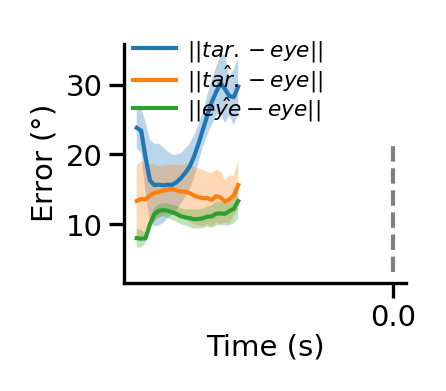

In [19]:
#M53 0.005
area = 'PFC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.4
tmask = xdata > -10.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
# ax.set_xlim(0, 2)
# ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
#ax.text(0.02, 15, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])


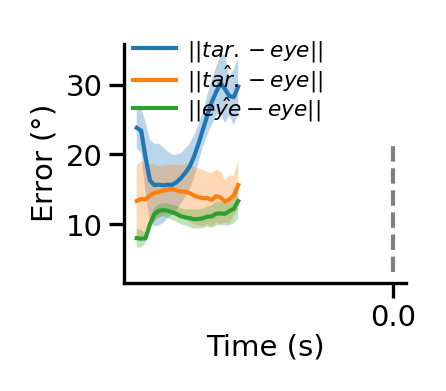

In [56]:
#M53 0.005
area = 'PFC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.4
tmask = xdata > -10.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
# ax.set_xlim(0, 2)
# ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
#ax.text(0.02, 15, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])


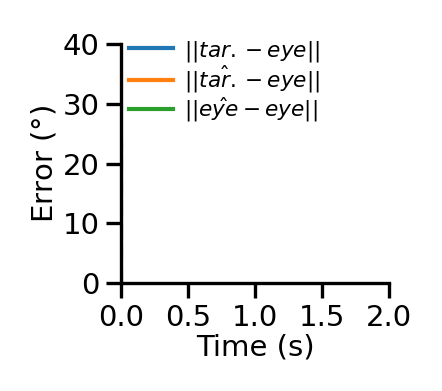

In [57]:
#M53 0.005
area = 'PPC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.4
tmask = xdata > -10.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 2)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
#ax.text(0.02, 15, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])


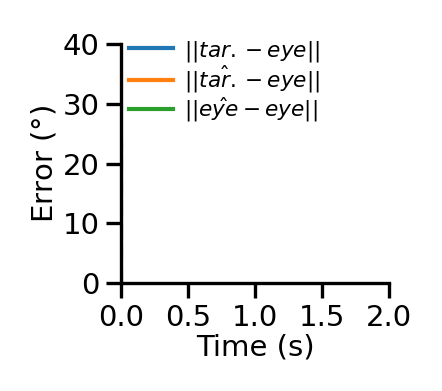

In [59]:
#M53 0.0001
area = 'PPC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.4
tmask = xdata > -10.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 2)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
#ax.text(0.02, 15, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])


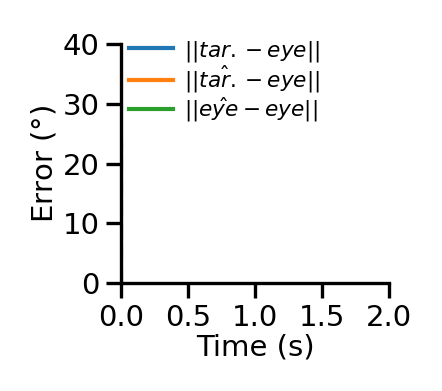

In [20]:
#M53
area = 'PFC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.4
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 2)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
#ax.text(0.02, 15, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])


# partial corr


In [23]:
# helper functions

def compute_corr(data1, data2, mask=None):
    '''compute the correlation coeef of two data'''
    if mask is not None:
        data1 = data1[~mask]; data2 = data2[~mask]
    corr = np.corrcoef(data1, data2)
    return abs(corr[0, 1])
def compute_partial_corr(data1, data2, data3, mask=None):
    '''compute the correlation of d1 and d2 while controling d3'''
    if mask is not None:
        data1 = data1[~mask]; data2 = data2[~mask]; data3 = data3[~mask]    
    df = pd.DataFrame({'d1': data1, 'd2': data2, 'd3': data3})
    corr_partial = partial_corr(data=df, x='d1', y='d2', covar='d3')['r'].item()
    return abs(corr_partial)

def shuffle_decoder(seed):
    kf = KFold(n_splits=5)
    decoded_target_idx = [4, 5, 6, 7]
    m_decoders = {}
    for area in areas:  # loop areas
        decoders_session = {}
        for key in eval(m).keys():  # loop sessions
            if key[-1].isalpha():
                continue

            X = eval(m)[key + 'Xdownsampled'][area]
            if len(X) == 0:
                continue
            Y = eval(m)[key + 'Ydownsampled_belief']
            trial_idces, X = zip(*X)
            trial_idces, Y = zip(*Y); trial_idces = np.array(trial_idces)

            model_variable = []
            for idx_variable in decoded_target_idx:  # loop target variable
                model_kfold = []
                for train_trial_idx, test_trial_idx in kf.split(trial_idces):  # loop K fold
                    X_train = np.concatenate([X[i] for i in train_trial_idx]) 
                    X_test = np.concatenate([X[i] for i in test_trial_idx])
                    Y_train = np.concatenate([Y[i] for i in train_trial_idx])
                    Y_test = np.concatenate([Y[i] for i in test_trial_idx])

                    train_mask = ~np.isnan(Y_train[:, idx_variable])
                    test_mask = ~np.isnan(Y_test[:, idx_variable])

                    #shuffle
                    rng = np.random.default_rng(seed=seed)
                    shifts = rng.integers(1, X_train.shape[0], size=X_train.shape[1])
                    for i, shift in enumerate(shifts):
                        X_train[:, i] = np.roll(X_train[:, i], shift=shift)

                    pipe = make_pipeline(StandardScaler(), RidgeCV())
                    pipe.fit(X_train[train_mask], Y_train[train_mask, idx_variable])

                    model_kfold.append([test_trial_idx, trial_idces[test_trial_idx], pipe])

                model_variable.append(model_kfold)
            decoders_session[key] = model_variable
        m_decoders[area + 'decoder'] = decoders_session


    m_score_t = {}
    for area in areas:
        scores_error_session_by_trial = {}
        for key in eval(m).keys():
            if key[-1].isalpha():
                continue

            Xt = eval(m)[key + 'Xt'][area]
            if len(Xt[0]) == 0:
                continue
            Yt = eval(m)[key + 'Yt']
            scores_trial = []

            for t in range(num_bins):
                trial_idces, X = zip(*Xt[t])
                X = np.vstack(X)
                trial_idces, Y = zip(*Yt[t])
                Y = np.vstack(Y)

                # decoding
                score_trial = []
                for idx_variable_enu, idx_variable in enumerate(decoded_target_idx):
                    Y_ = Y[:, idx_variable]
                    score_trial_ = []
                    for kfold_trial_indices, kfold_trial_relindices, kfold_decoder in \
                                                                        m_decoders[area + 'decoder'][key][idx_variable_enu]:
                        # decoding error for each trial
                        for trial_idx_enu, trial_idx in enumerate(trial_idces):
                            if trial_idx not in kfold_trial_relindices:
                                continue
                            score_trial_.append([trial_idx, t, 
                                                 kfold_decoder.predict(X[trial_idx_enu:trial_idx_enu+1])[0], 
                                                 Y_[trial_idx_enu:trial_idx_enu+1][0]])

                    score_trial.append(score_trial_)
                scores_trial.append(np.array(score_trial))  
            scores_error_session_by_trial[key] = np.concatenate(scores_trial, axis=1).swapaxes(0, 2)
        m_score_t[area + 'decoding_error_trial'] = scores_error_session_by_trial
    return m_score_t

In [24]:
correlation_data = {}
for area in ['PPC', 'MST', 'PFC']:    
    correlation_data_session = {}
    for key in eval(m)[f'{area}tracking_error_trial'].keys():  # loop sessions
        correlation_data_ = {}
        tracking_data = eval(m)[f'{area}tracking_error_trial'][key]
        decoder_true_data = eval(m)[f'{area}decoding_error_trial'][key][3]
        decoder_predicted_data = eval(m)[f'{area}decoding_error_trial'][key][2]
        decoding_error_data = decoder_predicted_data - decoder_true_data
        steer_error_data = eval(m)[key + 'error_sign']
        target_angle_data = np.array(eval(m)[key + 'target_angle'])
        target_distance_data = np.array(eval(m)[key + 'target_distance'])
        
        decode_reldist = decoder_predicted_data[:, 7]
        decode_relang = decoder_predicted_data[:, 6]

        decode_eye_hor = decoder_predicted_data[:, 4]
        decode_eye_ver = decoder_predicted_data[:, 5]

        eye_positions_hor = decoder_true_data[:, 4]
        eye_positions_ideal_hor = decoder_true_data[:, 6]
        eye_positions_ver = decoder_true_data[:, 5]
        eye_positions_ideal_ver = decoder_true_data[:, 7]
        
        mask = np.isnan(eye_positions_ideal_hor) | np.isnan(eye_positions_ideal_ver)
        
        correlation_data_['hor_vs_ideal_hor'] = compute_corr(eye_positions_hor, eye_positions_ideal_hor, mask)
        correlation_data_['ver_vs_ideal_ver'] = compute_corr(eye_positions_ver, eye_positions_ideal_ver, mask)
        
        correlation_data_['hor_vs_decode_tarang'] = compute_corr(eye_positions_hor, decode_relang, mask)
        correlation_data_['ver_vs_decode_tardist'] = compute_corr(eye_positions_ver, decode_reldist, mask)
        correlation_data_['hor_vs_decode_tarang_partial'] = compute_partial_corr(eye_positions_hor, decode_relang, 
                                                                                 eye_positions_ideal_hor, mask)
        correlation_data_['ver_vs_decode_tardist_partial'] = compute_partial_corr(eye_positions_ver, decode_reldist, 
                                                                                  eye_positions_ideal_ver, mask)
        
        correlation_data_['tarang_vs_decode_hor'] = compute_corr(eye_positions_ideal_hor, decode_eye_hor, mask)
        correlation_data_['tardist_vs_decode_ver'] = compute_corr(eye_positions_ideal_ver, decode_eye_ver, mask)
        correlation_data_['tarang_vs_decode_hor_partial'] = compute_partial_corr(eye_positions_ideal_hor, decode_eye_hor, 
                                                                                 eye_positions_hor, mask)
        correlation_data_['tardist_vs_decode_ver_partial'] = compute_partial_corr(eye_positions_ideal_ver, decode_eye_ver, 
                                                                                  eye_positions_ver, mask)
        
        correlation_data_['tarang_vs_decode_tarang'] = compute_corr(eye_positions_ideal_hor, decode_relang, mask)
        correlation_data_['tardist_vs_decode_tardist'] = compute_corr(eye_positions_ideal_ver, decode_reldist, mask)
        correlation_data_['tarang_vs_decode_tarang_partial'] = compute_partial_corr(eye_positions_ideal_hor, 
                                                                                    decode_relang, eye_positions_hor, mask)
        correlation_data_['tardist_vs_decode_tardist_partial'] = compute_partial_corr(eye_positions_ideal_ver, 
                                                                                      decode_reldist, 
                                                                                      eye_positions_ver, mask)
        
        correlation_data_['hor_vs_decode_hor'] = compute_corr(eye_positions_hor, decode_eye_hor, mask)
        correlation_data_['ver_vs_decode_ver'] = compute_corr(eye_positions_ver, decode_eye_ver, mask)
        correlation_data_['hor_vs_decode_hor_partial'] = compute_partial_corr(eye_positions_hor, decode_eye_hor, 
                                                                              eye_positions_ideal_hor, mask)
        correlation_data_['ver_vs_decode_ver_partial'] = compute_partial_corr(eye_positions_ver, decode_eye_ver, 
                                                                              eye_positions_ideal_ver, mask)
        
        correlation_data_['decode_hor_vs_decode_tarang'] = compute_corr(decode_eye_hor, decode_relang, mask)
        correlation_data_['decode_ver_vs_decode_tardist'] = compute_corr(decode_eye_ver, decode_reldist, mask)
                
        correlation_data_session[key] = correlation_data_
    correlation_data[area] = correlation_data_session

In [25]:
hor_vs_ideal_hor_PPC = [v['hor_vs_ideal_hor'] for v in correlation_data['PPC'].values()]
ver_vs_ideal_ver_PPC = [v['ver_vs_ideal_ver'] for v in correlation_data['PPC'].values()]
hor_vs_decode_tarang_PPC = [v['hor_vs_decode_tarang'] for v in correlation_data['PPC'].values()]
ver_vs_decode_tardist_PPC = [v['ver_vs_decode_tardist'] for v in correlation_data['PPC'].values()]
hor_vs_decode_tarang_partial_PPC = [v['hor_vs_decode_tarang_partial'] for v in correlation_data['PPC'].values()]
ver_vs_decode_tardist_partial_PPC = [v['ver_vs_decode_tardist_partial'] for v in correlation_data['PPC'].values()]
tarang_vs_decode_hor_PPC = [v['tarang_vs_decode_hor'] for v in correlation_data['PPC'].values()]
tardist_vs_decode_ver_PPC = [v['tardist_vs_decode_ver'] for v in correlation_data['PPC'].values()]
tarang_vs_decode_hor_partial_PPC = [v['tarang_vs_decode_hor_partial'] for v in correlation_data['PPC'].values()]
tardist_vs_decode_ver_partial_PPC = [v['tardist_vs_decode_ver_partial'] for v in correlation_data['PPC'].values()]
tarang_vs_decode_tarang_PPC = [v['tarang_vs_decode_tarang'] for v in correlation_data['PPC'].values()]
tardist_vs_decode_tardist_PPC = [v['tardist_vs_decode_tardist'] for v in correlation_data['PPC'].values()]
tarang_vs_decode_tarang_partial_PPC = [v['tarang_vs_decode_tarang_partial'] for v in correlation_data['PPC'].values()]
tardist_vs_decode_tardist_partial_PPC = [v['tardist_vs_decode_tardist_partial'] for v in correlation_data['PPC'].values()]
hor_vs_decode_hor_PPC = [v['hor_vs_decode_hor'] for v in correlation_data['PPC'].values()]
ver_vs_decode_ver_PPC = [v['ver_vs_decode_ver'] for v in correlation_data['PPC'].values()]
hor_vs_decode_hor_partial_PPC = [v['hor_vs_decode_hor_partial'] for v in correlation_data['PPC'].values()]
ver_vs_decode_ver_partial_PPC = [v['ver_vs_decode_ver_partial'] for v in correlation_data['PPC'].values()]
decode_hor_vs_decode_tarang_PPC = [v['decode_hor_vs_decode_tarang'] for v in correlation_data['PPC'].values()]
decode_ver_vs_decode_tardist_PPC = [v['decode_ver_vs_decode_tardist'] for v in correlation_data['PPC'].values()]

In [26]:
hor_vs_ideal_hor_MST = [v['hor_vs_ideal_hor'] for v in correlation_data['MST'].values()]
ver_vs_ideal_ver_MST = [v['ver_vs_ideal_ver'] for v in correlation_data['MST'].values()]
hor_vs_decode_tarang_MST = [v['hor_vs_decode_tarang'] for v in correlation_data['MST'].values()]
ver_vs_decode_tardist_MST = [v['ver_vs_decode_tardist'] for v in correlation_data['MST'].values()]
hor_vs_decode_tarang_partial_MST = [v['hor_vs_decode_tarang_partial'] for v in correlation_data['MST'].values()]
ver_vs_decode_tardist_partial_MST = [v['ver_vs_decode_tardist_partial'] for v in correlation_data['MST'].values()]
tarang_vs_decode_hor_MST = [v['tarang_vs_decode_hor'] for v in correlation_data['MST'].values()]
tardist_vs_decode_ver_MST = [v['tardist_vs_decode_ver'] for v in correlation_data['MST'].values()]
tarang_vs_decode_hor_partial_MST = [v['tarang_vs_decode_hor_partial'] for v in correlation_data['MST'].values()]
tardist_vs_decode_ver_partial_MST = [v['tardist_vs_decode_ver_partial'] for v in correlation_data['MST'].values()]
tarang_vs_decode_tarang_MST = [v['tarang_vs_decode_tarang'] for v in correlation_data['MST'].values()]
tardist_vs_decode_tardist_MST = [v['tardist_vs_decode_tardist'] for v in correlation_data['MST'].values()]
tarang_vs_decode_tarang_partial_MST = [v['tarang_vs_decode_tarang_partial'] for v in correlation_data['MST'].values()]
tardist_vs_decode_tardist_partial_MST = [v['tardist_vs_decode_tardist_partial'] for v in correlation_data['MST'].values()]
hor_vs_decode_hor_MST = [v['hor_vs_decode_hor'] for v in correlation_data['MST'].values()]
ver_vs_decode_ver_MST = [v['ver_vs_decode_ver'] for v in correlation_data['MST'].values()]
hor_vs_decode_hor_partial_MST = [v['hor_vs_decode_hor_partial'] for v in correlation_data['MST'].values()]
ver_vs_decode_ver_partial_MST = [v['ver_vs_decode_ver_partial'] for v in correlation_data['MST'].values()]
decode_hor_vs_decode_tarang_MST = [v['decode_hor_vs_decode_tarang'] for v in correlation_data['MST'].values()]
decode_ver_vs_decode_tardist_MST = [v['decode_ver_vs_decode_tardist'] for v in correlation_data['MST'].values()]

In [27]:
hor_vs_ideal_hor_PFC = [v['hor_vs_ideal_hor'] for v in correlation_data['PFC'].values()]
ver_vs_ideal_ver_PFC = [v['ver_vs_ideal_ver'] for v in correlation_data['PFC'].values()]
hor_vs_decode_tarang_PFC = [v['hor_vs_decode_tarang'] for v in correlation_data['PFC'].values()]
ver_vs_decode_tardist_PFC = [v['ver_vs_decode_tardist'] for v in correlation_data['PFC'].values()]
hor_vs_decode_tarang_partial_PFC = [v['hor_vs_decode_tarang_partial'] for v in correlation_data['PFC'].values()]
ver_vs_decode_tardist_partial_PFC = [v['ver_vs_decode_tardist_partial'] for v in correlation_data['PFC'].values()]
tarang_vs_decode_hor_PFC = [v['tarang_vs_decode_hor'] for v in correlation_data['PFC'].values()]
tardist_vs_decode_ver_PFC = [v['tardist_vs_decode_ver'] for v in correlation_data['PFC'].values()]
tarang_vs_decode_hor_partial_PFC = [v['tarang_vs_decode_hor_partial'] for v in correlation_data['PFC'].values()]
tardist_vs_decode_ver_partial_PFC = [v['tardist_vs_decode_ver_partial'] for v in correlation_data['PFC'].values()]
tarang_vs_decode_tarang_PFC = [v['tarang_vs_decode_tarang'] for v in correlation_data['PFC'].values()]
tardist_vs_decode_tardist_PFC = [v['tardist_vs_decode_tardist'] for v in correlation_data['PFC'].values()]
tarang_vs_decode_tarang_partial_PFC = [v['tarang_vs_decode_tarang_partial'] for v in correlation_data['PFC'].values()]
tardist_vs_decode_tardist_partial_PFC = [v['tardist_vs_decode_tardist_partial'] for v in correlation_data['PFC'].values()]
hor_vs_decode_hor_PFC = [v['hor_vs_decode_hor'] for v in correlation_data['PFC'].values()]
ver_vs_decode_ver_PFC = [v['ver_vs_decode_ver'] for v in correlation_data['PFC'].values()]
hor_vs_decode_hor_partial_PFC = [v['hor_vs_decode_hor_partial'] for v in correlation_data['PFC'].values()]
ver_vs_decode_ver_partial_PFC = [v['ver_vs_decode_ver_partial'] for v in correlation_data['PFC'].values()]
decode_hor_vs_decode_tarang_PFC = [v['decode_hor_vs_decode_tarang'] for v in correlation_data['PFC'].values()]
decode_ver_vs_decode_tardist_PFC = [v['decode_ver_vs_decode_tardist'] for v in correlation_data['PFC'].values()]

In [28]:
def shuffle_decoder(seed):
    kf = KFold(n_splits=5)
    decoded_target_idx = [4, 5, 6, 7]
    m_decoders = {}
    for area in areas:  # loop areas
        decoders_session = {}
        for key in eval(m).keys():  # loop sessions
            if key[-1].isalpha():
                continue

            X = eval(m)[key + 'Xdownsampled'][area]
            if len(X) == 0:
                continue
            Y = eval(m)[key + 'Ydownsampled']
            trial_idces, X = zip(*X)
            trial_idces, Y = zip(*Y); trial_idces = np.array(trial_idces)

            model_variable = []
            for idx_variable in decoded_target_idx:  # loop target variable
                model_kfold = []
                for train_trial_idx, test_trial_idx in kf.split(trial_idces):  # loop K fold
                    X_train = np.concatenate([X[i] for i in train_trial_idx]) 
                    X_test = np.concatenate([X[i] for i in test_trial_idx])
                    Y_train = np.concatenate([Y[i] for i in train_trial_idx])
                    Y_test = np.concatenate([Y[i] for i in test_trial_idx])

                    train_mask = ~np.isnan(Y_train[:, idx_variable])
                    test_mask = ~np.isnan(Y_test[:, idx_variable])

                    #shuffle
                    rng = np.random.default_rng(seed=seed)
                    shifts = rng.integers(1, X_train.shape[0], size=X_train.shape[1])
                    for i, shift in enumerate(shifts):
                        X_train[:, i] = np.roll(X_train[:, i], shift=shift)

                    pipe = make_pipeline(StandardScaler(), RidgeCV())
                    pipe.fit(X_train[train_mask], Y_train[train_mask, idx_variable])

                    model_kfold.append([test_trial_idx, trial_idces[test_trial_idx], pipe])

                model_variable.append(model_kfold)
            decoders_session[key] = model_variable
        m_decoders[area + 'decoder'] = decoders_session


    m_score_t = {}
    for area in areas:
        scores_error_session_by_trial = {}
        for key in eval(m).keys():
            if key[-1].isalpha():
                continue

            Xt = eval(m)[key + 'Xt'][area]
            if len(Xt[0]) == 0:
                continue
            Yt = eval(m)[key + 'Yt']
            scores_trial = []

            for t in range(num_bins):
                trial_idces, X = zip(*Xt[t])
                X = np.vstack(X)
                trial_idces, Y = zip(*Yt[t])
                Y = np.vstack(Y)

                # decoding
                score_trial = []
                for idx_variable_enu, idx_variable in enumerate(decoded_target_idx):
                    Y_ = Y[:, idx_variable]
                    score_trial_ = []
                    for kfold_trial_indices, kfold_trial_relindices, kfold_decoder in \
                                                                        m_decoders[area + 'decoder'][key][idx_variable_enu]:
                        # decoding error for each trial
                        for trial_idx_enu, trial_idx in enumerate(trial_idces):
                            if trial_idx not in kfold_trial_relindices:
                                continue
                            score_trial_.append([trial_idx, t, 
                                                 kfold_decoder.predict(X[trial_idx_enu:trial_idx_enu+1])[0], 
                                                 Y_[trial_idx_enu:trial_idx_enu+1][0]])

                    score_trial.append(score_trial_)
                scores_trial.append(np.array(score_trial))  
            scores_error_session_by_trial[key] = np.concatenate(scores_trial, axis=1).swapaxes(0, 2)
        m_score_t[area + 'decoding_error_trial'] = scores_error_session_by_trial
    return m_score_t

In [31]:
m_score_t_shuffle = []
for seed in range(20):
   m_score_t_shuffle.append(shuffle_decoder(seed=seed))
with open(resdir/f'{m}/shuffle_data.pkl', 'wb') as file:
   pickle.dump(m_score_t_shuffle, file)

In [ ]:
with open(resdir/f'{m}/shuffle_data.pkl', 'rb') as file:
    m_score_t_shuffle = pickle.load(file)
notify('shuffle decoder data loaded')

In [21]:
correlation_data_shuffle = {}
for area in ['PPC', 'MST', 'PFC']:    
    correlation_data_session = []
    for m_score_t in m_score_t_shuffle:  # loop seed
        for key in m_score_t[f'{area}decoding_error_trial'].keys():  # loop sessions
            correlation_data_ = {}
            decoder_true_data = m_score_t[f'{area}decoding_error_trial'][key][3]
            decoder_predicted_data = m_score_t[f'{area}decoding_error_trial'][key][2]

            decode_reldist = decoder_predicted_data[:, 3]
            decode_relang = decoder_predicted_data[:, 2]
            decode_eye_hor = decoder_predicted_data[:, 0]
            decode_eye_ver = decoder_predicted_data[:, 1]

            eye_positions_hor = decoder_true_data[:, 0]
            eye_positions_ideal_hor = decoder_true_data[:, 2]
            eye_positions_ver = decoder_true_data[:, 1]
            eye_positions_ideal_ver = decoder_true_data[:, 3]

            mask = np.isnan(eye_positions_ideal_hor) | np.isnan(eye_positions_ideal_ver)

            correlation_data_['hor_vs_ideal_hor'] = compute_corr(eye_positions_hor, eye_positions_ideal_hor, mask)
            correlation_data_['ver_vs_ideal_ver'] = compute_corr(eye_positions_ver, eye_positions_ideal_ver, mask)
            
            correlation_data_['hor_vs_decode_tarang'] = compute_corr(eye_positions_hor, decode_relang, mask)
            correlation_data_['ver_vs_decode_tardist'] = compute_corr(eye_positions_ver, decode_reldist, mask)
            correlation_data_['hor_vs_decode_tarang_partial'] = compute_partial_corr(eye_positions_hor, decode_relang, 
                                                                                     eye_positions_ideal_hor, mask)
            correlation_data_['ver_vs_decode_tardist_partial'] = compute_partial_corr(eye_positions_ver, decode_reldist, 
                                                                                      eye_positions_ideal_ver, mask)

            correlation_data_['tarang_vs_decode_hor'] = compute_corr(eye_positions_ideal_hor, decode_eye_hor, mask)
            correlation_data_['tardist_vs_decode_ver'] = compute_corr(eye_positions_ideal_ver, decode_eye_ver, mask)
            correlation_data_['tarang_vs_decode_hor_partial'] = compute_partial_corr(eye_positions_ideal_hor, decode_eye_hor, 
                                                                                     eye_positions_hor, mask)
            correlation_data_['tardist_vs_decode_ver_partial'] = compute_partial_corr(eye_positions_ideal_ver, decode_eye_ver, 
                                                                                      eye_positions_ver, mask)

            correlation_data_['tarang_vs_decode_tarang'] = compute_corr(eye_positions_ideal_hor, decode_relang, mask)
            correlation_data_['tardist_vs_decode_tardist'] = compute_corr(eye_positions_ideal_ver, decode_reldist, mask)
            correlation_data_['tarang_vs_decode_tarang_partial'] = compute_partial_corr(eye_positions_ideal_hor, 
                                                                                        decode_relang, eye_positions_hor, mask)
            correlation_data_['tardist_vs_decode_tardist_partial'] = compute_partial_corr(eye_positions_ideal_ver, 
                                                                                          decode_reldist, 
                                                                                          eye_positions_ver, mask)
            
            correlation_data_['hor_vs_decode_hor'] = compute_corr(eye_positions_hor, decode_eye_hor, mask)
            correlation_data_['ver_vs_decode_ver'] = compute_corr(eye_positions_ver, decode_eye_ver, mask)
            correlation_data_['hor_vs_decode_hor_partial'] = compute_partial_corr(eye_positions_hor, decode_eye_hor, 
                                                                                  eye_positions_ideal_hor, mask)
            correlation_data_['ver_vs_decode_ver_partial'] = compute_partial_corr(eye_positions_ver, decode_eye_ver, 
                                                                                  eye_positions_ideal_ver, mask)
            
            correlation_data_['decode_hor_vs_decode_tarang'] = compute_corr(decode_eye_hor, decode_relang, mask)
            correlation_data_['decode_ver_vs_decode_tardist'] = compute_corr(decode_eye_ver, decode_reldist, mask)

            correlation_data_session.append(correlation_data_)
            
    correlation_data_shuffle[area] = correlation_data_session

In [22]:
hor_vs_ideal_hor_shuffle_PPC = [v['hor_vs_ideal_hor'] for v in correlation_data_shuffle['PPC']]
ver_vs_ideal_ver_shuffle_PPC = [v['ver_vs_ideal_ver'] for v in correlation_data_shuffle['PPC']]
hor_vs_decode_tarang_shuffle_PPC = [v['hor_vs_decode_tarang'] for v in correlation_data_shuffle['PPC']]
ver_vs_decode_tardist_shuffle_PPC = [v['ver_vs_decode_tardist'] for v in correlation_data_shuffle['PPC']]
hor_vs_decode_tarang_partial_shuffle_PPC = [v['hor_vs_decode_tarang_partial'] for v in correlation_data_shuffle['PPC']]
ver_vs_decode_tardist_partial_shuffle_PPC = [v['ver_vs_decode_tardist_partial'] for v in correlation_data_shuffle['PPC']]
tarang_vs_decode_hor_shuffle_PPC = [v['tarang_vs_decode_hor'] for v in correlation_data_shuffle['PPC']]
tardist_vs_decode_ver_shuffle_PPC = [v['tardist_vs_decode_ver'] for v in correlation_data_shuffle['PPC']]
tarang_vs_decode_hor_partial_shuffle_PPC = [v['tarang_vs_decode_hor_partial'] for v in correlation_data_shuffle['PPC']]
tardist_vs_decode_ver_partial_shuffle_PPC = [v['tardist_vs_decode_ver_partial'] for v in correlation_data_shuffle['PPC']]
tarang_vs_decode_tarang_shuffle_PPC = [v['tarang_vs_decode_tarang'] for v in correlation_data_shuffle['PPC']]
tardist_vs_decode_tardist_shuffle_PPC = [v['tardist_vs_decode_tardist'] for v in correlation_data_shuffle['PPC']]
hor_vs_decode_hor_shuffle_PPC = [v['hor_vs_decode_hor'] for v in correlation_data_shuffle['PPC']]
ver_vs_decode_ver_shuffle_PPC = [v['ver_vs_decode_ver'] for v in correlation_data_shuffle['PPC']]
decode_hor_vs_decode_tarang_shuffle_PPC = [v['decode_hor_vs_decode_tarang'] for v in correlation_data_shuffle['PPC']]
decode_ver_vs_decode_tardist_shuffle_PPC = [v['decode_ver_vs_decode_tardist'] for v in correlation_data_shuffle['PPC']]

In [23]:
hor_vs_ideal_hor_shuffle_MST = [v['hor_vs_ideal_hor'] for v in correlation_data_shuffle['MST']]
ver_vs_ideal_ver_shuffle_MST = [v['ver_vs_ideal_ver'] for v in correlation_data_shuffle['MST']]
hor_vs_decode_tarang_shuffle_MST = [v['hor_vs_decode_tarang'] for v in correlation_data_shuffle['MST']]
ver_vs_decode_tardist_shuffle_MST = [v['ver_vs_decode_tardist'] for v in correlation_data_shuffle['MST']]
hor_vs_decode_tarang_partial_shuffle_MST = [v['hor_vs_decode_tarang_partial'] for v in correlation_data_shuffle['MST']]
ver_vs_decode_tardist_partial_shuffle_MST = [v['ver_vs_decode_tardist_partial'] for v in correlation_data_shuffle['MST']]
tarang_vs_decode_hor_shuffle_MST = [v['tarang_vs_decode_hor'] for v in correlation_data_shuffle['MST']]
tardist_vs_decode_ver_shuffle_MST = [v['tardist_vs_decode_ver'] for v in correlation_data_shuffle['MST']]
tarang_vs_decode_hor_partial_shuffle_MST = [v['tarang_vs_decode_hor_partial'] for v in correlation_data_shuffle['MST']]
tardist_vs_decode_ver_partial_shuffle_MST = [v['tardist_vs_decode_ver_partial'] for v in correlation_data_shuffle['MST']]
tarang_vs_decode_tarang_shuffle_MST = [v['tarang_vs_decode_tarang'] for v in correlation_data_shuffle['MST']]
tardist_vs_decode_tardist_shuffle_MST = [v['tardist_vs_decode_tardist'] for v in correlation_data_shuffle['MST']]
hor_vs_decode_hor_shuffle_MST = [v['hor_vs_decode_hor'] for v in correlation_data_shuffle['MST']]
ver_vs_decode_ver_shuffle_MST = [v['ver_vs_decode_ver'] for v in correlation_data_shuffle['MST']]
decode_hor_vs_decode_tarang_shuffle_MST = [v['decode_hor_vs_decode_tarang'] for v in correlation_data_shuffle['MST']]
decode_ver_vs_decode_tardist_shuffle_MST = [v['decode_ver_vs_decode_tardist'] for v in correlation_data_shuffle['MST']]

In [24]:
hor_vs_ideal_hor_shuffle_PFC = [v['hor_vs_ideal_hor'] for v in correlation_data_shuffle['PFC']]
ver_vs_ideal_ver_shuffle_PFC = [v['ver_vs_ideal_ver'] for v in correlation_data_shuffle['PFC']]
hor_vs_decode_tarang_shuffle_PFC = [v['hor_vs_decode_tarang'] for v in correlation_data_shuffle['PFC']]
ver_vs_decode_tardist_shuffle_PFC = [v['ver_vs_decode_tardist'] for v in correlation_data_shuffle['PFC']]
hor_vs_decode_tarang_partial_shuffle_PFC = [v['hor_vs_decode_tarang_partial'] for v in correlation_data_shuffle['PFC']]
ver_vs_decode_tardist_partial_shuffle_PFC = [v['ver_vs_decode_tardist_partial'] for v in correlation_data_shuffle['PFC']]
tarang_vs_decode_hor_shuffle_PFC = [v['tarang_vs_decode_hor'] for v in correlation_data_shuffle['PFC']]
tardist_vs_decode_ver_shuffle_PFC = [v['tardist_vs_decode_ver'] for v in correlation_data_shuffle['PFC']]
tarang_vs_decode_hor_partial_shuffle_PFC = [v['tarang_vs_decode_hor_partial'] for v in correlation_data_shuffle['PFC']]
tardist_vs_decode_ver_partial_shuffle_PFC = [v['tardist_vs_decode_ver_partial'] for v in correlation_data_shuffle['PFC']]
tarang_vs_decode_tarang_shuffle_PFC = [v['tarang_vs_decode_tarang'] for v in correlation_data_shuffle['PFC']]
tardist_vs_decode_tardist_shuffle_PFC = [v['tardist_vs_decode_tardist'] for v in correlation_data_shuffle['PFC']]
hor_vs_decode_hor_shuffle_PFC = [v['hor_vs_decode_hor'] for v in correlation_data_shuffle['PFC']]
ver_vs_decode_ver_shuffle_PFC = [v['ver_vs_decode_ver'] for v in correlation_data_shuffle['PFC']]
decode_hor_vs_decode_tarang_shuffle_PFC = [v['decode_hor_vs_decode_tarang'] for v in correlation_data_shuffle['PFC']]
decode_ver_vs_decode_tardist_shuffle_PFC = [v['decode_ver_vs_decode_tardist'] for v in correlation_data_shuffle['PFC']]

In [19]:
def sampled_units_decoder(seed):
    kf = KFold(n_splits=5)
    decoded_target_idx = [4, 5, 6, 7]
    m_decoders = {}
    for area in areas:  # loop areas
        decoders_session = {}
        for key in eval(m).keys():  # loop sessions
            if key[-1].isalpha():
                continue

            #min_num_neuron = min(eval(m)[key + 'Xt']['PPC'][0][0][1].size, eval(m)[key + 'Xt']['MST'][0][0][1].size,
            #                     eval(m)[key + 'Xt']['PFC'][0][0][1].size)
            min_num_neuron = min(eval(m)[key + 'Xt']['PPC'][0][0][1].size, eval(m)[key + 'Xt']['MST'][0][0][1].size)
            
            X = eval(m)[key + 'Xdownsampled'][area]
            if len(X) == 0:
                continue
            Y = eval(m)[key + 'Ydownsampled']
            trial_idces, X = zip(*X)
            trial_idces, Y = zip(*Y); trial_idces = np.array(trial_idces)

            model_variable = []
            for idx_variable in decoded_target_idx:  # loop target variable
                model_kfold = []
                for train_trial_idx, test_trial_idx in kf.split(trial_idces):  # loop K fold
                    X_train = np.concatenate([X[i] for i in train_trial_idx]) 
                    X_test = np.concatenate([X[i] for i in test_trial_idx])
                    Y_train = np.concatenate([Y[i] for i in train_trial_idx])
                    Y_test = np.concatenate([Y[i] for i in test_trial_idx])

                    train_mask = ~np.isnan(Y_train[:, idx_variable])
                    test_mask = ~np.isnan(Y_test[:, idx_variable])

                    # sample units
                    rng = np.random.default_rng(seed=seed)
                    sampled_dims = rng.choice(X_train.shape[1], min_num_neuron, replace=False)
                    
                    pipe = make_pipeline(StandardScaler(), RidgeCV())
                    pipe.fit(X_train[:, sampled_dims][train_mask], Y_train[train_mask, idx_variable])

                    model_kfold.append([test_trial_idx, trial_idces[test_trial_idx], pipe, sampled_dims])

                model_variable.append(model_kfold)
            decoders_session[key] = model_variable
        m_decoders[area + 'decoder'] = decoders_session


    m_score_t = {}
    for area in areas:
        scores_error_session_by_trial = {}
        for key in eval(m).keys():
            if key[-1].isalpha():
                continue

            Xt = eval(m)[key + 'Xt'][area]
            if len(Xt[0]) == 0:
                continue
            Yt = eval(m)[key + 'Yt']
            scores_trial = []

            for t in range(num_bins):
                trial_idces, X = zip(*Xt[t])
                X = np.vstack(X)
                trial_idces, Y = zip(*Yt[t])
                Y = np.vstack(Y)

                # decoding
                score_trial = []
                for idx_variable_enu, idx_variable in enumerate(decoded_target_idx):
                    Y_ = Y[:, idx_variable]
                    score_trial_ = []
                    for kfold_trial_indices, kfold_trial_relindices, kfold_decoder, sampled_dims in \
                                                                        m_decoders[area + 'decoder'][key][idx_variable_enu]:
                        # decoding error for each trial
                        for trial_idx_enu, trial_idx in enumerate(trial_idces):
                            if trial_idx not in kfold_trial_relindices:
                                continue
                            score_trial_.append([trial_idx, t, 
                                                 kfold_decoder.predict(X[:, sampled_dims][trial_idx_enu:trial_idx_enu+1])[0], 
                                                 Y_[trial_idx_enu:trial_idx_enu+1][0]])

                    score_trial.append(score_trial_)
                scores_trial.append(np.array(score_trial))  
            scores_error_session_by_trial[key] = np.concatenate(scores_trial, axis=1).swapaxes(0, 2)
        m_score_t[area + 'decoding_error_trial'] = scores_error_session_by_trial
    return m_score_t

In [20]:
#m_score_sampled_units = []
#for seed in range(5):
#    m_score_sampled_units.append(sampled_units_decoder(seed=seed))

In [24]:
#with open(f'D:/firefly_monkey_data_mat/{m}/sampled_units_data.pkl', 'wb') as file:
#    pickle.dump(m_score_sampled_units, file)

In [25]:
with open(f'D:/firefly_monkey_data_mat/{m}/sampled_units_data.pkl', 'rb') as file:
    m_score_sampled_units = pickle.load(file)

In [26]:
correlation_data_sampled_units = {}
for area in ['PPC', 'MST', 'PFC']:    
    correlation_data_session = []
    for m_score_t in m_score_sampled_units:  # loop seed
        for key in m_score_t[f'{area}decoding_error_trial'].keys():  # loop sessions
            correlation_data_ = {}
            decoder_true_data = m_score_t[f'{area}decoding_error_trial'][key][3]
            decoder_predicted_data = m_score_t[f'{area}decoding_error_trial'][key][2]

            decode_reldist = decoder_predicted_data[:, 3]
            decode_relang = decoder_predicted_data[:, 2]
            decode_eye_hor = decoder_predicted_data[:, 0]
            decode_eye_ver = decoder_predicted_data[:, 1]

            eye_positions_hor = decoder_true_data[:, 0]
            eye_positions_ideal_hor = decoder_true_data[:, 2]
            eye_positions_ver = decoder_true_data[:, 1]
            eye_positions_ideal_ver = decoder_true_data[:, 3]

            mask = np.isnan(eye_positions_ideal_hor) | np.isnan(eye_positions_ideal_ver)

            correlation_data_['hor_vs_ideal_hor'] = compute_corr(eye_positions_hor, eye_positions_ideal_hor, mask)
            correlation_data_['ver_vs_ideal_ver'] = compute_corr(eye_positions_ver, eye_positions_ideal_ver, mask)
            
            correlation_data_['hor_vs_decode_tarang'] = compute_corr(eye_positions_hor, decode_relang, mask)
            correlation_data_['ver_vs_decode_tardist'] = compute_corr(eye_positions_ver, decode_reldist, mask)
            correlation_data_['hor_vs_decode_tarang_partial'] = compute_partial_corr(eye_positions_hor, decode_relang, 
                                                                                     eye_positions_ideal_hor, mask)
            correlation_data_['ver_vs_decode_tardist_partial'] = compute_partial_corr(eye_positions_ver, decode_reldist, 
                                                                                      eye_positions_ideal_ver, mask)

            correlation_data_['tarang_vs_decode_hor'] = compute_corr(eye_positions_ideal_hor, decode_eye_hor, mask)
            correlation_data_['tardist_vs_decode_ver'] = compute_corr(eye_positions_ideal_ver, decode_eye_ver, mask)
            correlation_data_['tarang_vs_decode_hor_partial'] = compute_partial_corr(eye_positions_ideal_hor, decode_eye_hor, 
                                                                                     eye_positions_hor, mask)
            correlation_data_['tardist_vs_decode_ver_partial'] = compute_partial_corr(eye_positions_ideal_ver, decode_eye_ver, 
                                                                                      eye_positions_ver, mask)

            correlation_data_['tarang_vs_decode_tarang'] = compute_corr(eye_positions_ideal_hor, decode_relang, mask)
            correlation_data_['tardist_vs_decode_tardist'] = compute_corr(eye_positions_ideal_ver, decode_reldist, mask)
            correlation_data_['tarang_vs_decode_tarang_partial'] = compute_partial_corr(eye_positions_ideal_hor, 
                                                                                        decode_relang, eye_positions_hor, mask)
            correlation_data_['tardist_vs_decode_tardist_partial'] = compute_partial_corr(eye_positions_ideal_ver, 
                                                                                          decode_reldist, 
                                                                                          eye_positions_ver, mask)
            
            correlation_data_['hor_vs_decode_hor'] = compute_corr(eye_positions_hor, decode_eye_hor, mask)
            correlation_data_['ver_vs_decode_ver'] = compute_corr(eye_positions_ver, decode_eye_ver, mask)
            correlation_data_['hor_vs_decode_hor_partial'] = compute_partial_corr(eye_positions_hor, decode_eye_hor, 
                                                                                  eye_positions_ideal_hor, mask)
            correlation_data_['ver_vs_decode_ver_partial'] = compute_partial_corr(eye_positions_ver, decode_eye_ver, 
                                                                                  eye_positions_ideal_ver, mask)
            
            correlation_data_['decode_hor_vs_decode_tarang'] = compute_corr(decode_eye_hor, decode_relang, mask)
            correlation_data_['decode_ver_vs_decode_tardist'] = compute_corr(decode_eye_ver, decode_reldist, mask)

            correlation_data_session.append(correlation_data_)
            
    correlation_data_sampled_units[area] = correlation_data_session

In [27]:
hor_vs_ideal_hor_sampled_units_PPC = [v['hor_vs_ideal_hor'] for v in correlation_data_sampled_units['PPC']]
ver_vs_ideal_ver_sampled_units_PPC = [v['ver_vs_ideal_ver'] for v in correlation_data_sampled_units['PPC']]
hor_vs_decode_tarang_sampled_units_PPC = [v['hor_vs_decode_tarang'] for v in correlation_data_sampled_units['PPC']]
ver_vs_decode_tardist_sampled_units_PPC = [v['ver_vs_decode_tardist'] for v in correlation_data_sampled_units['PPC']]
hor_vs_decode_tarang_partial_sampled_units_PPC = [v['hor_vs_decode_tarang_partial'] for v in correlation_data_sampled_units['PPC']]
ver_vs_decode_tardist_partial_sampled_units_PPC = [v['ver_vs_decode_tardist_partial'] for v in correlation_data_sampled_units['PPC']]
tarang_vs_decode_hor_sampled_units_PPC = [v['tarang_vs_decode_hor'] for v in correlation_data_sampled_units['PPC']]
tardist_vs_decode_ver_sampled_units_PPC = [v['tardist_vs_decode_ver'] for v in correlation_data_sampled_units['PPC']]
tarang_vs_decode_hor_partial_sampled_units_PPC = [v['tarang_vs_decode_hor_partial'] for v in correlation_data_sampled_units['PPC']]
tardist_vs_decode_ver_partial_sampled_units_PPC = [v['tardist_vs_decode_ver_partial'] for v in correlation_data_sampled_units['PPC']]
tarang_vs_decode_tarang_sampled_units_PPC = [v['tarang_vs_decode_tarang'] for v in correlation_data_sampled_units['PPC']]
tardist_vs_decode_tardist_sampled_units_PPC = [v['tardist_vs_decode_tardist'] for v in correlation_data_sampled_units['PPC']]
hor_vs_decode_hor_sampled_units_PPC = [v['hor_vs_decode_hor'] for v in correlation_data_sampled_units['PPC']]
ver_vs_decode_ver_sampled_units_PPC = [v['ver_vs_decode_ver'] for v in correlation_data_sampled_units['PPC']]
decode_hor_vs_decode_tarang_sampled_units_PPC = [v['decode_hor_vs_decode_tarang'] for v in correlation_data_sampled_units['PPC']]
decode_ver_vs_decode_tardist_sampled_units_PPC = [v['decode_ver_vs_decode_tardist'] for v in correlation_data_sampled_units['PPC']]

In [28]:
hor_vs_ideal_hor_sampled_units_MST = [v['hor_vs_ideal_hor'] for v in correlation_data_sampled_units['MST']]
ver_vs_ideal_ver_sampled_units_MST = [v['ver_vs_ideal_ver'] for v in correlation_data_sampled_units['MST']]
hor_vs_decode_tarang_sampled_units_MST = [v['hor_vs_decode_tarang'] for v in correlation_data_sampled_units['MST']]
ver_vs_decode_tardist_sampled_units_MST = [v['ver_vs_decode_tardist'] for v in correlation_data_sampled_units['MST']]
hor_vs_decode_tarang_partial_sampled_units_MST = [v['hor_vs_decode_tarang_partial'] for v in correlation_data_sampled_units['MST']]
ver_vs_decode_tardist_partial_sampled_units_MST = [v['ver_vs_decode_tardist_partial'] for v in correlation_data_sampled_units['MST']]
tarang_vs_decode_hor_sampled_units_MST = [v['tarang_vs_decode_hor'] for v in correlation_data_sampled_units['MST']]
tardist_vs_decode_ver_sampled_units_MST = [v['tardist_vs_decode_ver'] for v in correlation_data_sampled_units['MST']]
tarang_vs_decode_hor_partial_sampled_units_MST = [v['tarang_vs_decode_hor_partial'] for v in correlation_data_sampled_units['MST']]
tardist_vs_decode_ver_partial_sampled_units_MST = [v['tardist_vs_decode_ver_partial'] for v in correlation_data_sampled_units['MST']]
tarang_vs_decode_tarang_sampled_units_MST = [v['tarang_vs_decode_tarang'] for v in correlation_data_sampled_units['MST']]
tardist_vs_decode_tardist_sampled_units_MST = [v['tardist_vs_decode_tardist'] for v in correlation_data_sampled_units['MST']]
hor_vs_decode_hor_sampled_units_MST = [v['hor_vs_decode_hor'] for v in correlation_data_sampled_units['MST']]
ver_vs_decode_ver_sampled_units_MST = [v['ver_vs_decode_ver'] for v in correlation_data_sampled_units['MST']]
decode_hor_vs_decode_tarang_sampled_units_MST = [v['decode_hor_vs_decode_tarang'] for v in correlation_data_sampled_units['MST']]
decode_ver_vs_decode_tardist_sampled_units_MST = [v['decode_ver_vs_decode_tardist'] for v in correlation_data_sampled_units['MST']]

In [29]:
hor_vs_ideal_hor_sampled_units_PFC = [v['hor_vs_ideal_hor'] for v in correlation_data_sampled_units['PFC']]
ver_vs_ideal_ver_sampled_units_PFC = [v['ver_vs_ideal_ver'] for v in correlation_data_sampled_units['PFC']]
hor_vs_decode_tarang_sampled_units_PFC = [v['hor_vs_decode_tarang'] for v in correlation_data_sampled_units['PFC']]
ver_vs_decode_tardist_sampled_units_PFC = [v['ver_vs_decode_tardist'] for v in correlation_data_sampled_units['PFC']]
hor_vs_decode_tarang_partial_sampled_units_PFC = [v['hor_vs_decode_tarang_partial'] for v in correlation_data_sampled_units['PFC']]
ver_vs_decode_tardist_partial_sampled_units_PFC = [v['ver_vs_decode_tardist_partial'] for v in correlation_data_sampled_units['PFC']]
tarang_vs_decode_hor_sampled_units_PFC = [v['tarang_vs_decode_hor'] for v in correlation_data_sampled_units['PFC']]
tardist_vs_decode_ver_sampled_units_PFC = [v['tardist_vs_decode_ver'] for v in correlation_data_sampled_units['PFC']]
tarang_vs_decode_hor_partial_sampled_units_PFC = [v['tarang_vs_decode_hor_partial'] for v in correlation_data_sampled_units['PFC']]
tardist_vs_decode_ver_partial_sampled_units_PFC = [v['tardist_vs_decode_ver_partial'] for v in correlation_data_sampled_units['PFC']]
tarang_vs_decode_tarang_sampled_units_PFC = [v['tarang_vs_decode_tarang'] for v in correlation_data_sampled_units['PFC']]
tardist_vs_decode_tardist_sampled_units_PFC = [v['tardist_vs_decode_tardist'] for v in correlation_data_sampled_units['PFC']]
hor_vs_decode_hor_sampled_units_PFC = [v['hor_vs_decode_hor'] for v in correlation_data_sampled_units['PFC']]
ver_vs_decode_ver_sampled_units_PFC = [v['ver_vs_decode_ver'] for v in correlation_data_sampled_units['PFC']]
decode_hor_vs_decode_tarang_sampled_units_PFC = [v['decode_hor_vs_decode_tarang'] for v in correlation_data_sampled_units['PFC']]
decode_ver_vs_decode_tardist_sampled_units_PFC = [v['decode_ver_vs_decode_tardist'] for v in correlation_data_sampled_units['PFC']]

# fig1, m51

In [11]:
with open(f'D:/firefly_monkey_data_mat/m44/decoder.pkl', 'rb') as file:
    m44decoder = pickle.load(file)
with open(f'D:/firefly_monkey_data_mat/m51/decoder.pkl', 'rb') as file:
    m51decoder = pickle.load(file)
with open(f'D:/firefly_monkey_data_mat/m53/decoder.pkl', 'rb') as file:
    m53decoder = pickle.load(file)

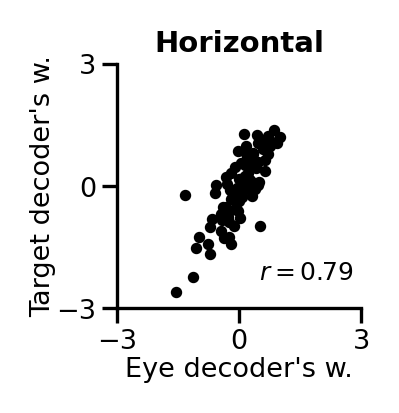

In [23]:
width = 1.2; height = 1.2
yticks = np.linspace(-3, 3, 3)
xticks = np.linspace(-3, 3, 3)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Horizontal', fontsize=fontsize, pad=3, fontweight='bold')
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize-0.5)
plt.yticks(yticks, fontsize=fontsize-0.5)
ax.set_ylabel("Target decoder's w.", fontsize=fontsize-0.5)
ax.set_xlabel("Eye decoder's w.", fontsize=fontsize-0.5)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.25, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

fold_idx = 3
xdata = m51['PPCdecoder']['m51s38'][4][fold_idx][2].named_steps['ridgecv'].coef_
ydata = m51['PPCdecoder']['m51s38'][6][fold_idx][2].named_steps['ridgecv'].coef_
ax.scatter(xdata, ydata, s=3, c='k')
ax.text(0.5, -2.3, f'$r=${np.round(np.corrcoef(xdata, ydata)[0, 1], 2)}', fontsize=fontsize-1, c='k')

fig.tight_layout(pad=0, rect=[0.01, 0, 1.01, 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='decoder_weights_hor'), orientation='landscape', format='pdf', 
#            transparent=True)

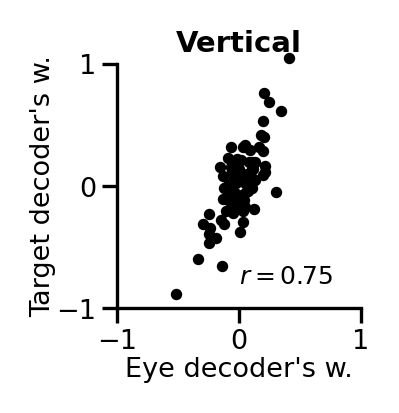

In [24]:
width = 1.2; height = 1.2
yticks = np.linspace(-1, 1, 3)
xticks = np.linspace(-1, 1, 3)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Vertical', fontsize=fontsize, pad=3, fontweight='bold')
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize-0.5)
plt.yticks(yticks, fontsize=fontsize-0.5)
ax.set_ylabel("Target decoder's w.", fontsize=fontsize-0.5)
ax.set_xlabel("Eye decoder's w.", fontsize=fontsize-0.5)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.25, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

fold_idx = 3
xdata = m51['PPCdecoder']['m51s38'][5][fold_idx][2].named_steps['ridgecv'].coef_
ydata = m51['PPCdecoder']['m51s38'][7][fold_idx][2].named_steps['ridgecv'].coef_
ax.scatter(xdata, ydata, s=3, c='k', clip_on=False)
ax.text(0, -0.8, f'$r=${np.round(np.corrcoef(xdata, ydata)[0, 1], 2)}', fontsize=fontsize-1, c='k')

fig.tight_layout(pad=0, rect=[0.01, 0, 1.01, 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='decoder_weights_ver'), orientation='landscape', format='pdf', 
#            transparent=True)

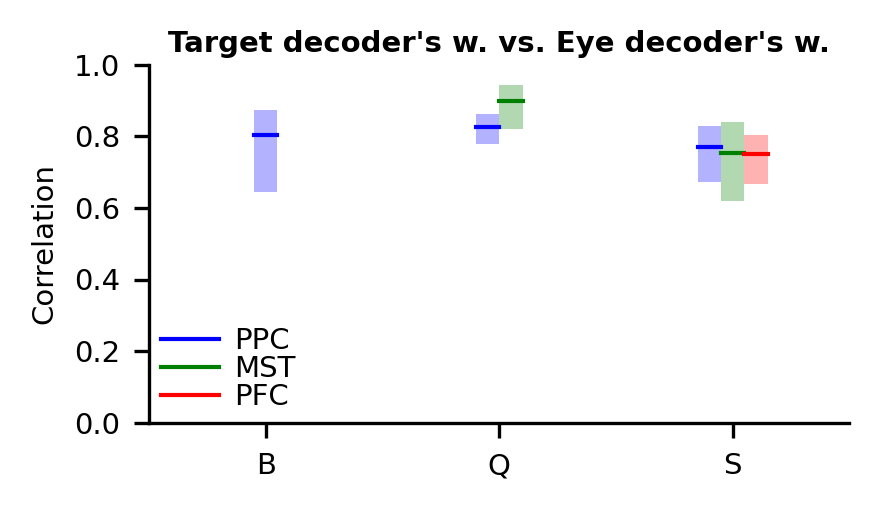

In [87]:
# cross decoding
# m44
MSTc = 'g'; PPCc = 'b'; PFCc = 'r'
width = 2.7; height = 1.5
yticks = np.linspace(0, 1, 6)

ydata1 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in m51decoder['PPCdecoder'].values()])

ydata2 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in m44decoder['PPCdecoder'].values()])

ydata3 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in m44decoder['MSTdecoder'].values()])

ydata4 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in m53decoder['PPCdecoder'].values()])

ydata5 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in m53decoder['MSTdecoder'].values()])

ydata6 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in m53decoder['PFCdecoder'].values()])

xticks = np.arange(3)
xticklabels = ['B', 'Q', 'S']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title("Target decoder's w. vs. Eye decoder's w.", fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

bar_wid = 0.05
ymean = ydata1.mean(); x = xticks[0]
res = bootstrap((ydata1, ), np.mean, confidence_level=0.95, random_state=0)
ax.plot([x-bar_wid, x+bar_wid], [ymean, ymean], c=PPCc, lw=1)
ax.fill_between([x-bar_wid, x+bar_wid], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                facecolor=PPCc, alpha=0.3)

for ydata, c, x in zip([ydata2, ydata3], [PPCc, MSTc], [xticks[1]-0.05, xticks[1]+0.05]):
    ymean = ydata.mean()
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-bar_wid, x+bar_wid], [ymean, ymean], c=c, lw=1)
    ax.fill_between([x-bar_wid, x+bar_wid], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor=c, alpha=0.3)
    
for ydata, c, x, label in zip([ydata4, ydata5, ydata6], [PPCc, MSTc, PFCc], 
                              [xticks[2]-0.1, xticks[2], xticks[2]+0.1], ['PPC', 'MST', 'PFC']):
    ymean = ydata.mean()
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-bar_wid, x+bar_wid], [ymean, ymean], c=c, lw=1, label=label)
    ax.fill_between([x-bar_wid, x+bar_wid], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor=c, alpha=0.3)
    
ax.legend(fontsize=fontsize, frameon=False, loc=[0, 0], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

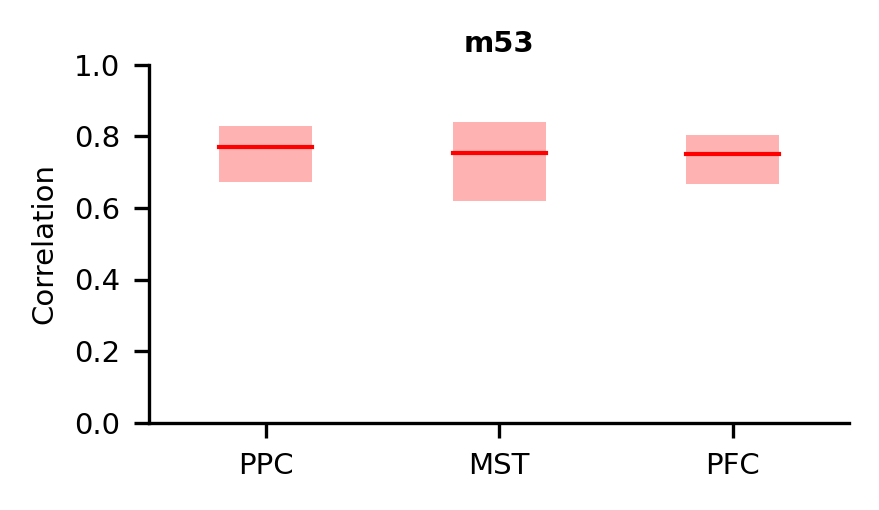

In [58]:
# cross decoding
# m53
monkey = 'm53'
width = 2.7; height = 1.5
yticks = np.linspace(0, 1, 6)
ydata1 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in eval(f'{monkey}decoder')['PPCdecoder'].values()])

ydata2 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in eval(f'{monkey}decoder')['MSTdecoder'].values()])

ydata3 = np.array([np.corrcoef(np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[4]]), 
                      np.hstack([fold[2].named_steps['ridgecv'].coef_ for fold in v[6]]))[0][1]
          for v in eval(f'{monkey}decoder')['PFCdecoder'].values()])

xticks = np.arange(3)
xticklabels = ['PPC', 'MST', 'PFC']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title(monkey, fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

ymean = ydata1.mean(); x = xticks[0]
res = bootstrap((ydata1, ), np.mean, confidence_level=0.95, random_state=0)
ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                facecolor='r', alpha=0.3)

ymean = ydata2.mean(); x = xticks[1]
res = bootstrap((ydata2, ), np.mean, confidence_level=0.95, random_state=0)
ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                facecolor='r', alpha=0.3)

ymean = ydata3.mean(); x = xticks[2]
res = bootstrap((ydata3, ), np.mean, confidence_level=0.95, random_state=0)
ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                facecolor='r', alpha=0.3)
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

In [38]:
# m53
print(hor_vs_ideal_hor_PPC)
print(ver_vs_ideal_ver_PPC)

[0.3631934577421338, 0.5336086724193789, 0.47891576763562976, 0.5788545140376675, 0.545045889213412, 0.4850058650669697, 0.44870073362669294]
[0.20515301630319344, 0.311760006820041, 0.2230561352284887, 0.22729306856787973, 0.2910729698692727, 0.1566883922624424, 0.21441575747519043]


In [36]:
test1_m53 = [0.3631934577421338, 0.5336086724193789, 0.47891576763562976, 0.5788545140376675, 
             0.545045889213412, 0.4850058650669697, 0.44870073362669294]
test2_m53 = [0.20515301630319344, 0.311760006820041, 0.2230561352284887, 0.22729306856787973, 
             0.2910729698692727, 0.1566883922624424, 0.21441575747519043]

In [18]:
# m51
print(hor_vs_ideal_hor_PPC)
print(ver_vs_ideal_ver_PPC)

[0.6301407736962871, 0.589614953384231, 0.6572256265455573, 0.6543132939662393, 0.7444581448629055]
[0.5066680695887102, 0.5754425396867903, 0.5350461900813172, 0.5353403406892562, 0.5514870179590369]


In [37]:
test1_m51 = [0.6301407736962871, 0.589614953384231, 0.6572256265455573, 0.6543132939662393, 0.7444581448629055]
test2_m51 = [0.5066680695887102, 0.5754425396867903, 0.5350461900813172, 0.5353403406892562, 0.5514870179590369]

In [24]:
# 44
print(hor_vs_ideal_hor_PPC)
print(ver_vs_ideal_ver_PPC)

[0.6057449913480168, 0.5293175141422747, 0.5208753803930372, 0.4974584601500741, 0.5562983587620721, 0.5996480126254491, 0.6643956165102727, 0.6014877649949009, 0.6046168334526903, 0.6137192152403373, 0.5861042009387719]
[0.3160823863452909, 0.1428690758717859, 0.10541738662005651, 0.12825515924202185, 0.14523981760834734, 0.1410316908332533, 0.1902357729582374, 0.2767808505827231, 0.2190169371309824, 0.29982045936067575, 0.17697363258203472]


In [38]:
test1_m44 = [0.6057449913480168, 0.5293175141422747, 0.5208753803930372, 0.4974584601500741, 
             0.5562983587620721, 0.5996480126254491, 
             0.6643956165102727, 0.6014877649949009, 0.6046168334526903, 
             0.6137192152403373, 0.5861042009387719]
test2_m44 = [0.3160823863452909, 0.1428690758717859, 0.10541738662005651, 0.12825515924202185, 
             0.14523981760834734, 0.1410316908332533, 0.1902357729582374, 0.2767808505827231, 
             0.2190169371309824, 0.29982045936067575, 0.17697363258203472]

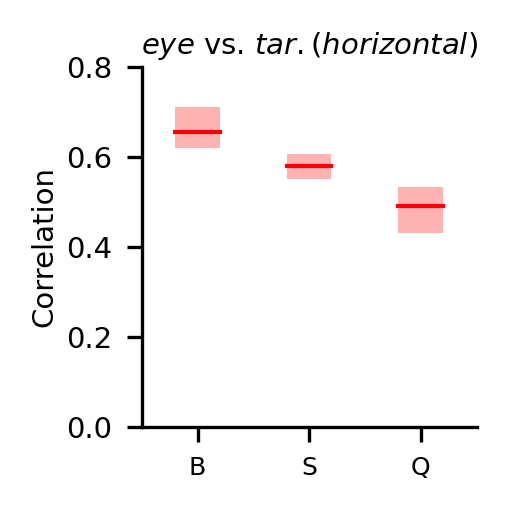

In [47]:
# cross decoding
width = 1.5; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = [np.array(test1_m51), np.array(test1_m44), np.array(test1_m53)]

xticks = np.arange(3)
xticklabels = ['B', 'S', 'Q']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('$eye$ vs. $tar. (horizontal)$', fontsize=fontsize, pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.25, 0.5)

for x, ydata in zip(xticks, ydata1):
    ymean = ydata.mean()
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='correlations_ver'), orientation='landscape', format='pdf', 
#            transparent=True)

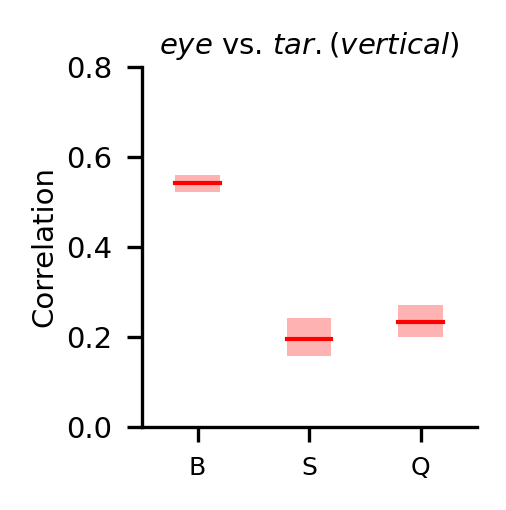

In [52]:
# cross decoding
width = 1.5; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = [np.array(test2_m51), np.array(test2_m44), np.array(test2_m53)]

xticks = np.arange(3)
xticklabels = ['B', 'S', 'Q']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('$eye$ vs. $tar. (vertical)$', fontsize=fontsize, pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.25, 0.5)

for x, ydata in zip(xticks, ydata1):
    ymean = ydata.mean()
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='correlations_ver'), orientation='landscape', format='pdf', 
#            transparent=True)

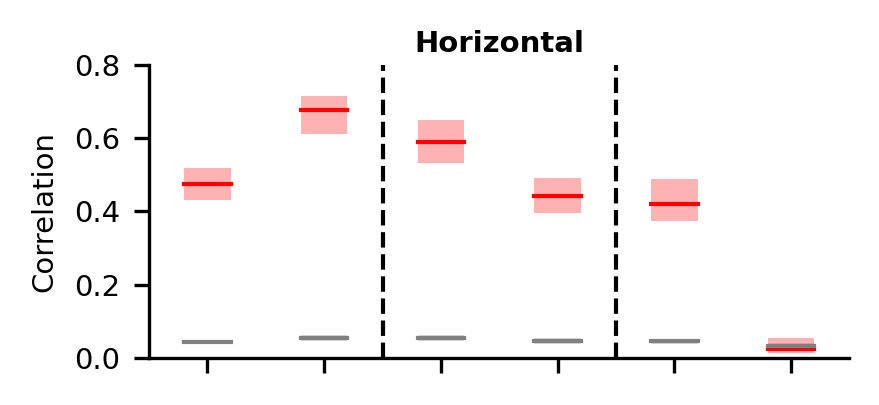

In [29]:
# cross decoding
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([tarang_vs_decode_tarang_PPC, hor_vs_decode_hor_PPC, hor_vs_decode_tarang_PPC, tarang_vs_decode_hor_PPC])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([hor_vs_decode_tarang_partial_PPC, tarang_vs_decode_hor_partial_PPC])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='correlations_hor'), orientation='landscape', format='pdf', 
            transparent=True)

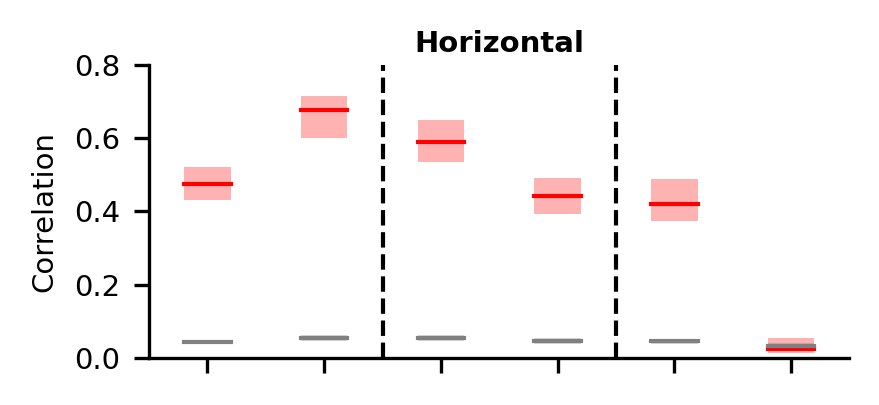

In [24]:
# cross decoding
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([tarang_vs_decode_tarang_PPC, hor_vs_decode_hor_PPC, hor_vs_decode_tarang_PPC, tarang_vs_decode_hor_PPC])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([hor_vs_decode_tarang_partial_PPC, tarang_vs_decode_hor_partial_PPC])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

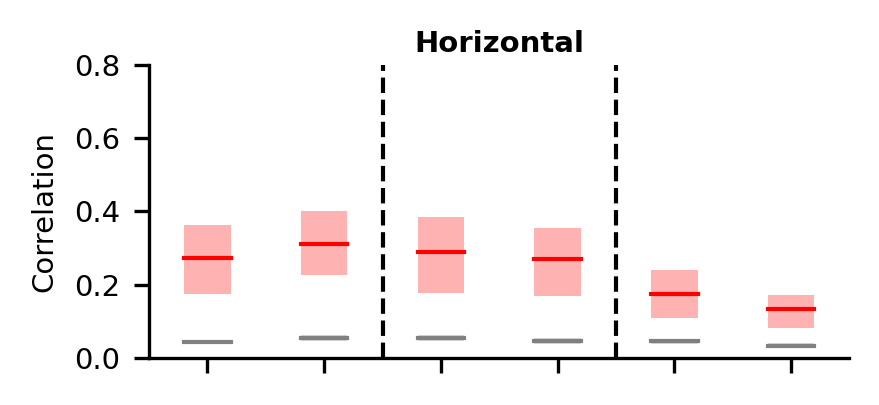

In [27]:
# m51 0.005
area = 'PPC'
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

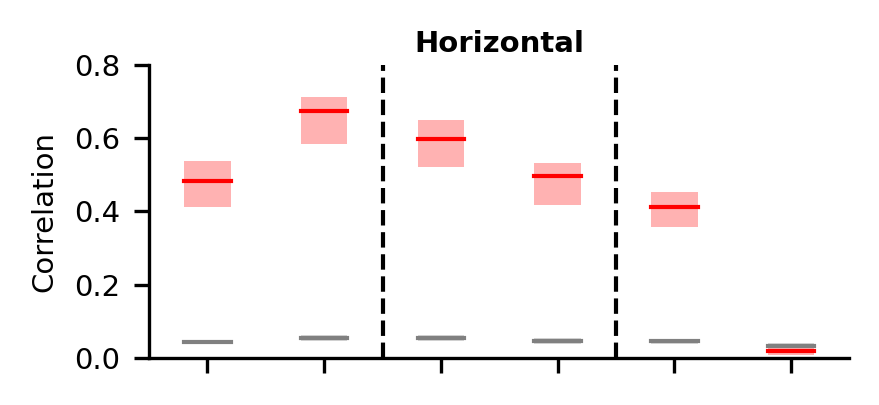

In [49]:
# m51 0.005
area = 'PPC'
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

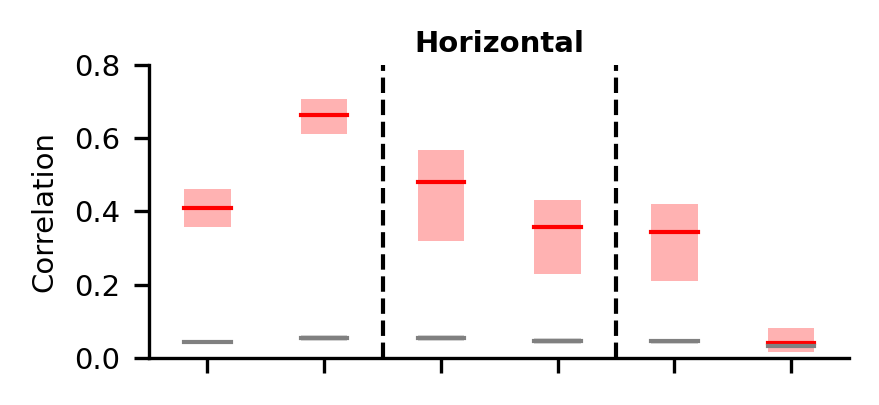

In [26]:
# m51 0.005
area = 'PPC'
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

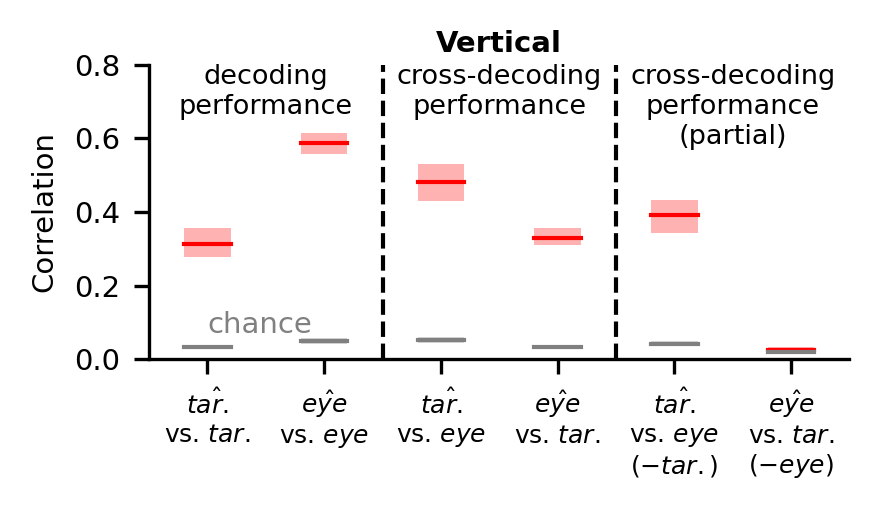

In [50]:
# cross decoding
# m44
area = 'PPC'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tardist_vs_decode_tardist_{area}'), eval(f'ver_vs_decode_ver_{area}'), 
                   eval(f'ver_vs_decode_tardist_{area}'), eval(f'tardist_vs_decode_ver_{area}')])

ydata2 = np.array([tardist_vs_decode_tardist_shuffle_PPC, ver_vs_decode_ver_shuffle_PPC, 
                   ver_vs_decode_tardist_shuffle_PPC, tardist_vs_decode_ver_shuffle_PPC])

ydata3 = np.array([eval(f'ver_vs_decode_tardist_partial_{area}'), eval(f'tardist_vs_decode_ver_partial_{area}')])
ydata4 = np.array([ver_vs_decode_tardist_partial_shuffle_PPC, tardist_vs_decode_ver_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

In [ ]:
# m51 0.005
area = 'PPC'
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

In [ ]:
tarang_vs_decode_hor_partial_sampled_units_MST

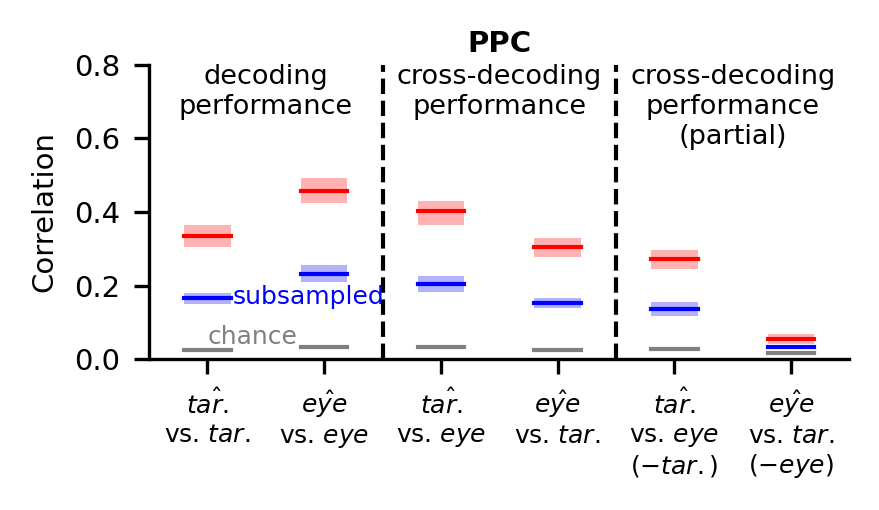

In [63]:
# cross decoding
# m44
area = 'PPC'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1_ = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata1 = np.array([eval(f'tarang_vs_decode_tarang_sampled_units_{area}'), eval(f'hor_vs_decode_hor_sampled_units_{area}'), 
                   eval(f'hor_vs_decode_tarang_sampled_units_{area}'), eval(f'tarang_vs_decode_hor_sampled_units_{area}')])

ydata2 = np.array([eval(f'tarang_vs_decode_tarang_shuffle_{area}'), eval(f'hor_vs_decode_hor_shuffle_{area}'), 
                   eval(f'hor_vs_decode_tarang_shuffle_{area}'), eval(f'tarang_vs_decode_hor_shuffle_{area}')])

ydata3_ = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_sampled_units_{area}'), 
                   eval(f'tarang_vs_decode_hor_partial_sampled_units_{area}')])
ydata4 = np.array([eval(f'hor_vs_decode_tarang_partial_shuffle_{area}'), eval(f'tarang_vs_decode_hor_partial_shuffle_{area}')])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title(area, fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1_.mean(axis=1), ydata1_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3_.mean(axis=1), ydata3_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.04, 'chance', fontsize=fontsize-1, c='gray')

ax.text(0.22, 0.15, 'subsampled', fontsize=fontsize-1, c='b')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

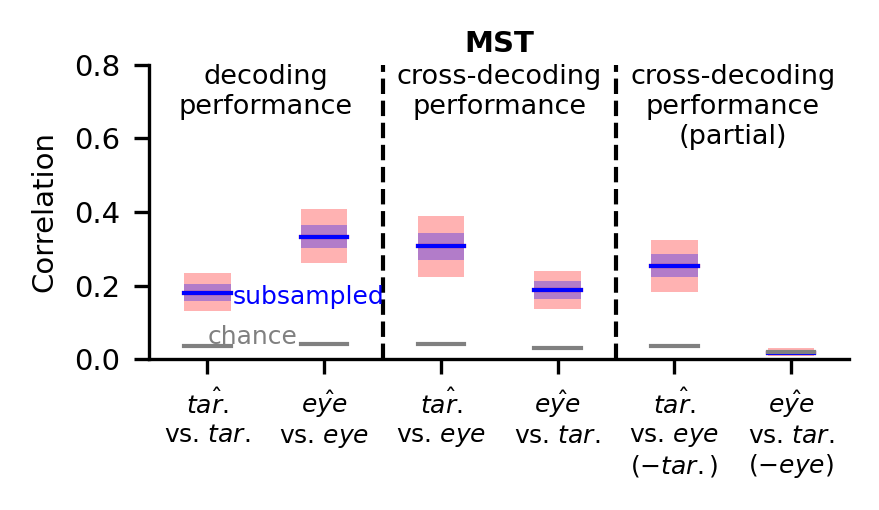

In [64]:
# cross decoding
# m44
area = 'MST'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1_ = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata1 = np.array([eval(f'tarang_vs_decode_tarang_sampled_units_{area}'), eval(f'hor_vs_decode_hor_sampled_units_{area}'), 
                   eval(f'hor_vs_decode_tarang_sampled_units_{area}'), eval(f'tarang_vs_decode_hor_sampled_units_{area}')])

ydata2 = np.array([eval(f'tarang_vs_decode_tarang_shuffle_{area}'), eval(f'hor_vs_decode_hor_shuffle_{area}'), 
                   eval(f'hor_vs_decode_tarang_shuffle_{area}'), eval(f'tarang_vs_decode_hor_shuffle_{area}')])

ydata3_ = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_sampled_units_{area}'), 
                   eval(f'tarang_vs_decode_hor_partial_sampled_units_{area}')])
ydata4 = np.array([eval(f'hor_vs_decode_tarang_partial_shuffle_{area}'), eval(f'tarang_vs_decode_hor_partial_shuffle_{area}')])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title(area, fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1_.mean(axis=1), ydata1_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3_.mean(axis=1), ydata3_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.04, 'chance', fontsize=fontsize-1, c='gray')

ax.text(0.22, 0.15, 'subsampled', fontsize=fontsize-1, c='b')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

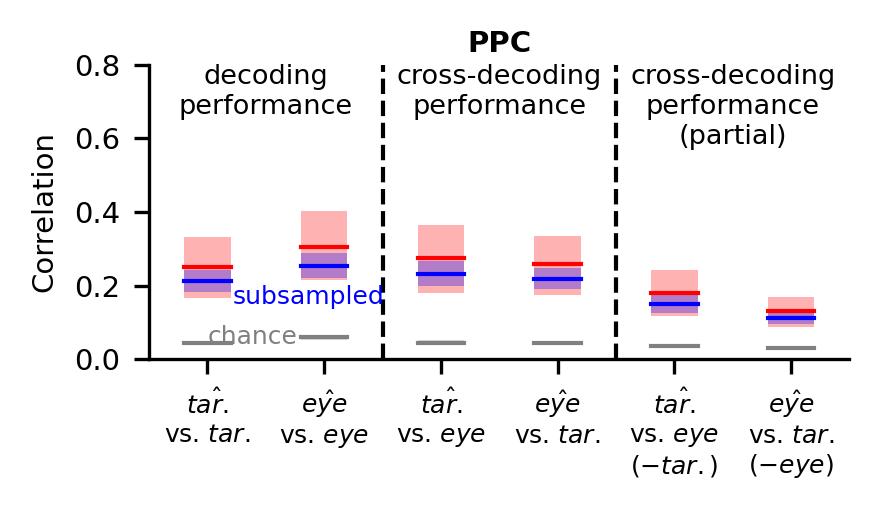

In [30]:
# cross decoding
# m44
area = 'PPC'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1_ = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata1 = np.array([eval(f'tarang_vs_decode_tarang_sampled_units_{area}'), eval(f'hor_vs_decode_hor_sampled_units_{area}'), 
                   eval(f'hor_vs_decode_tarang_sampled_units_{area}'), eval(f'tarang_vs_decode_hor_sampled_units_{area}')])

ydata2 = np.array([eval(f'tarang_vs_decode_tarang_shuffle_{area}'), eval(f'hor_vs_decode_hor_shuffle_{area}'), 
                   eval(f'hor_vs_decode_tarang_shuffle_{area}'), eval(f'tarang_vs_decode_hor_shuffle_{area}')])

ydata3_ = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_sampled_units_{area}'), 
                   eval(f'tarang_vs_decode_hor_partial_sampled_units_{area}')])
ydata4 = np.array([eval(f'hor_vs_decode_tarang_partial_shuffle_{area}'), eval(f'tarang_vs_decode_hor_partial_shuffle_{area}')])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title(area, fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1_.mean(axis=1), ydata1_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3_.mean(axis=1), ydata3_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.04, 'chance', fontsize=fontsize-1, c='gray')

ax.text(0.22, 0.15, 'subsampled', fontsize=fontsize-1, c='b')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

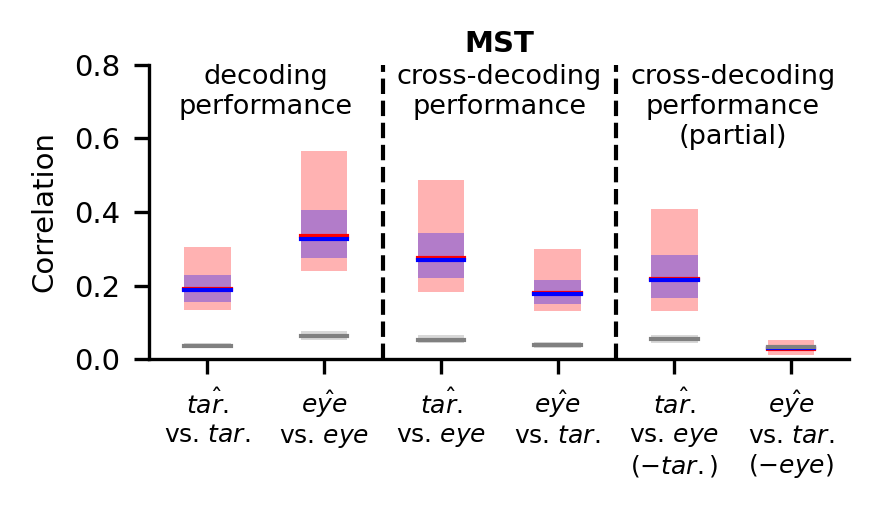

In [31]:
# cross decoding
# m44
area = 'MST'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1_ = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata1 = np.array([eval(f'tarang_vs_decode_tarang_sampled_units_{area}'), eval(f'hor_vs_decode_hor_sampled_units_{area}'), 
                   eval(f'hor_vs_decode_tarang_sampled_units_{area}'), eval(f'tarang_vs_decode_hor_sampled_units_{area}')])

ydata2 = np.array([eval(f'tarang_vs_decode_tarang_shuffle_{area}'), eval(f'hor_vs_decode_hor_shuffle_{area}'), 
                   eval(f'hor_vs_decode_tarang_shuffle_{area}'), eval(f'tarang_vs_decode_hor_shuffle_{area}')])

ydata3_ = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_sampled_units_{area}'), 
                   eval(f'tarang_vs_decode_hor_partial_sampled_units_{area}')])
ydata4 = np.array([eval(f'hor_vs_decode_tarang_partial_shuffle_{area}'), eval(f'tarang_vs_decode_hor_partial_shuffle_{area}')])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title(area, fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1_.mean(axis=1), ydata1_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3_.mean(axis=1), ydata3_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

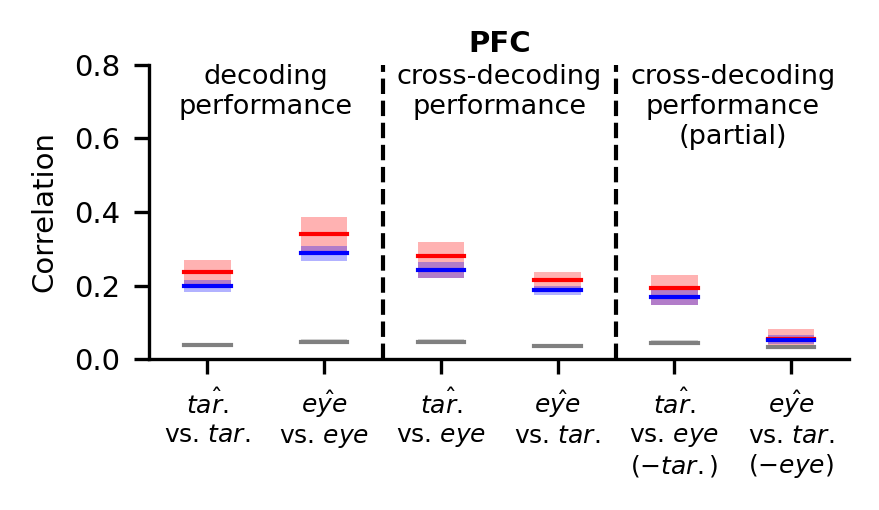

In [32]:
# cross decoding
# m44
area = 'PFC'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1_ = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata1 = np.array([eval(f'tarang_vs_decode_tarang_sampled_units_{area}'), eval(f'hor_vs_decode_hor_sampled_units_{area}'), 
                   eval(f'hor_vs_decode_tarang_sampled_units_{area}'), eval(f'tarang_vs_decode_hor_sampled_units_{area}')])

ydata2 = np.array([eval(f'tarang_vs_decode_tarang_shuffle_{area}'), eval(f'hor_vs_decode_hor_shuffle_{area}'), 
                   eval(f'hor_vs_decode_tarang_shuffle_{area}'), eval(f'tarang_vs_decode_hor_shuffle_{area}')])

ydata3_ = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_sampled_units_{area}'), 
                   eval(f'tarang_vs_decode_hor_partial_sampled_units_{area}')])
ydata4 = np.array([eval(f'hor_vs_decode_tarang_partial_shuffle_{area}'), eval(f'tarang_vs_decode_hor_partial_shuffle_{area}')])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title(area, fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1_.mean(axis=1), ydata1_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3_.mean(axis=1), ydata3_):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='b', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='b', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

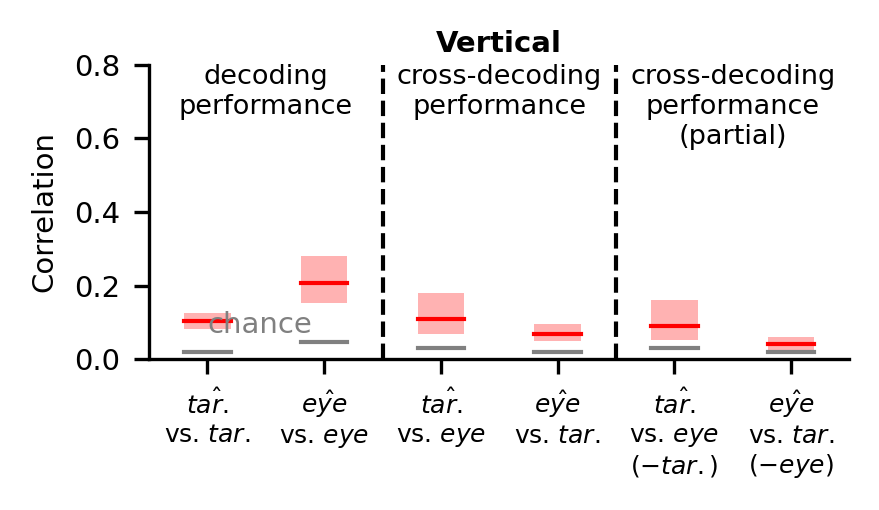

In [32]:
# cross decoding
# m44
area = 'MST'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tardist_vs_decode_tardist_{area}'), eval(f'ver_vs_decode_ver_{area}'), 
                   eval(f'ver_vs_decode_tardist_{area}'), eval(f'tardist_vs_decode_ver_{area}')])

ydata2 = np.array([eval(f'tardist_vs_decode_tardist_shuffle_{area}'), eval(f'ver_vs_decode_ver_shuffle_{area}'), 
                   eval(f'ver_vs_decode_tardist_shuffle_{area}'), eval(f'tardist_vs_decode_ver_shuffle_{area}')])

ydata3 = np.array([eval(f'ver_vs_decode_tardist_partial_{area}'), eval(f'tardist_vs_decode_ver_partial_{area}')])
ydata4 = np.array([eval(f'ver_vs_decode_tardist_partial_shuffle_{area}'), 
                   eval(f'tardist_vs_decode_ver_partial_shuffle_{area}')])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

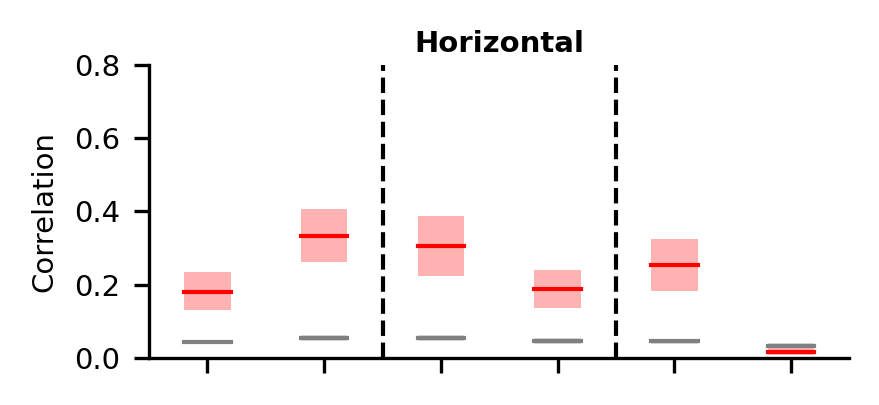

In [37]:
# m44
area = 'MST'
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

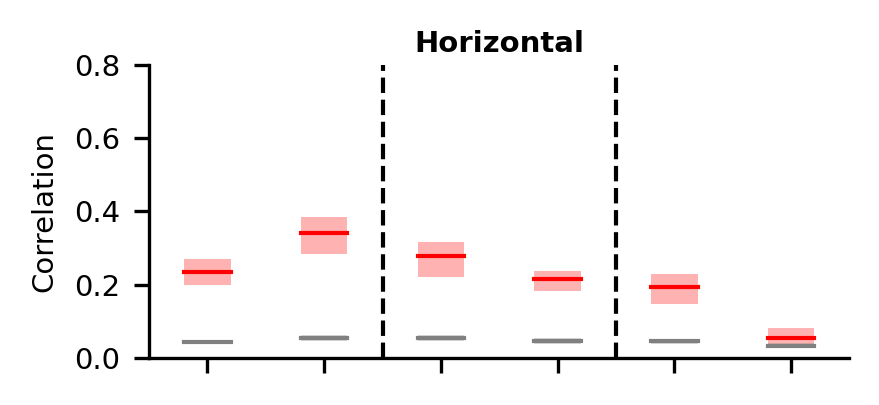

In [29]:
# m53
area = 'PFC'
width = 2.7; height = 1.15
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tarang_vs_decode_tarang_{area}'), eval(f'hor_vs_decode_hor_{area}'), 
                   eval(f'hor_vs_decode_tarang_{area}'), eval(f'tarang_vs_decode_hor_{area}')])

ydata2 = np.array([tarang_vs_decode_tarang_shuffle_PPC, hor_vs_decode_hor_shuffle_PPC, 
                   hor_vs_decode_tarang_shuffle_PPC, tarang_vs_decode_hor_shuffle_PPC])

ydata3 = np.array([eval(f'hor_vs_decode_tarang_partial_{area}'), eval(f'tarang_vs_decode_hor_partial_{area}')])
ydata4 = np.array([hor_vs_decode_tarang_partial_shuffle_PPC, tarang_vs_decode_hor_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, [], fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

#vio1 = ax.violinplot(ydata1, positions=xticks, showmeans=True)
#for pos, d in zip(xticks, ydata1):
#    ax.scatter(pos + np.random.randn(len(d)) * 0.05, d, s=5, c='C0')
#set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

#y = 1
#ax.text(0.5, y, 'Decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(2.5, y, 'Cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(4.5, y, 'Cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
#ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

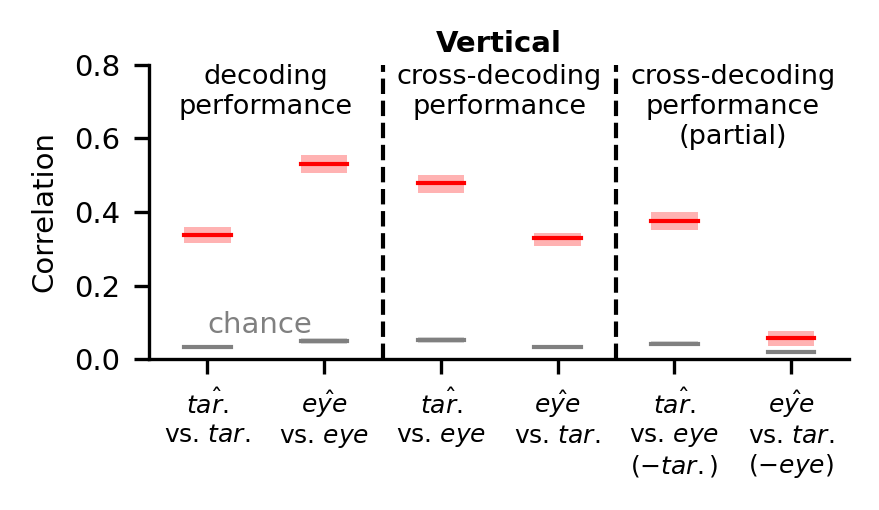

In [28]:
# cross decoding
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([tardist_vs_decode_tardist_PPC, ver_vs_decode_ver_PPC, ver_vs_decode_tardist_PPC, tardist_vs_decode_ver_PPC])

ydata2 = np.array([tardist_vs_decode_tardist_shuffle_PPC, ver_vs_decode_ver_shuffle_PPC, 
                   ver_vs_decode_tardist_shuffle_PPC, tardist_vs_decode_ver_shuffle_PPC])

ydata3 = np.array([ver_vs_decode_tardist_partial_PPC, tardist_vs_decode_ver_partial_PPC])
ydata4 = np.array([ver_vs_decode_tardist_partial_shuffle_PPC, tardist_vs_decode_ver_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='correlations_ver'), orientation='landscape', format='pdf', 
            transparent=True)

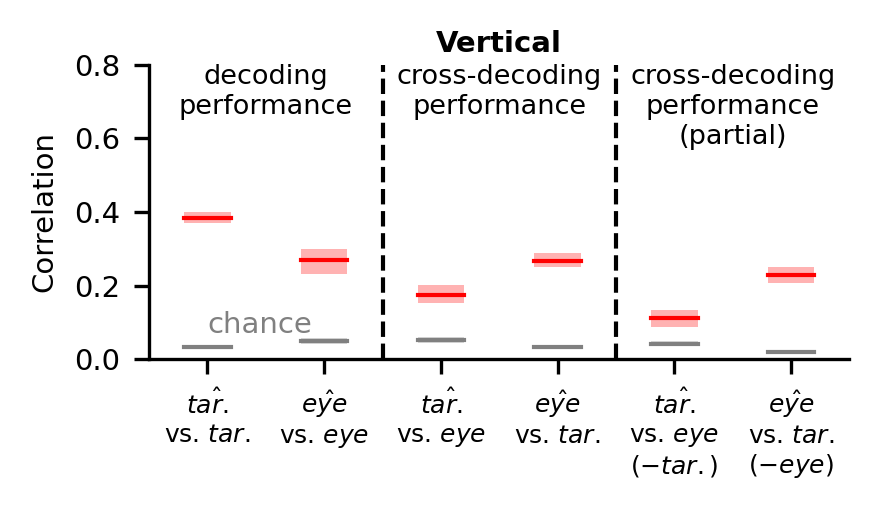

In [60]:
# cross decoding
# m44
area = 'PPC'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tardist_vs_decode_tardist_{area}'), eval(f'ver_vs_decode_ver_{area}'), 
                   eval(f'ver_vs_decode_tardist_{area}'), eval(f'tardist_vs_decode_ver_{area}')])

ydata2 = np.array([tardist_vs_decode_tardist_shuffle_PPC, ver_vs_decode_ver_shuffle_PPC, 
                   ver_vs_decode_tardist_shuffle_PPC, tardist_vs_decode_ver_shuffle_PPC])

ydata3 = np.array([eval(f'ver_vs_decode_tardist_partial_{area}'), eval(f'tardist_vs_decode_ver_partial_{area}')])
ydata4 = np.array([ver_vs_decode_tardist_partial_shuffle_PPC, tardist_vs_decode_ver_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

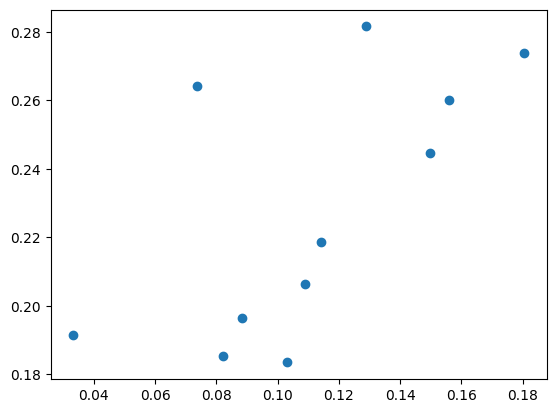

In [64]:
plt.scatter(ver_vs_decode_tardist_partial_PPC, tardist_vs_decode_ver_partial_PPC)

In [63]:
tardist_vs_decode_ver_partial_PPC

[0.2602356735093734,
 0.19627369859764943,
 0.2445112690040168,
 0.2816335370431937,
 0.27377061422830284,
 0.21864103644915175,
 0.18340466377608378,
 0.18531690689938882,
 0.1915669267417141,
 0.20624545488663906,
 0.264285663668027]

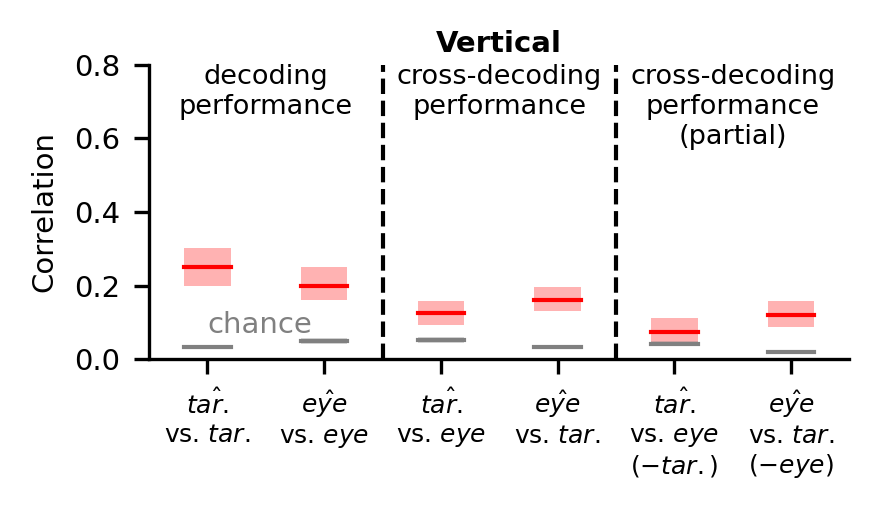

In [32]:
# cross decoding
# m44
area = 'PFC'
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([eval(f'tardist_vs_decode_tardist_{area}'), eval(f'ver_vs_decode_ver_{area}'), 
                   eval(f'ver_vs_decode_tardist_{area}'), eval(f'tardist_vs_decode_ver_{area}')])

ydata2 = np.array([tardist_vs_decode_tardist_shuffle_PPC, ver_vs_decode_ver_shuffle_PPC, 
                   ver_vs_decode_tardist_shuffle_PPC, tardist_vs_decode_ver_shuffle_PPC])

ydata3 = np.array([eval(f'ver_vs_decode_tardist_partial_{area}'), eval(f'tardist_vs_decode_ver_partial_{area}')])
ydata4 = np.array([ver_vs_decode_tardist_partial_shuffle_PPC, tardist_vs_decode_ver_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.8
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])

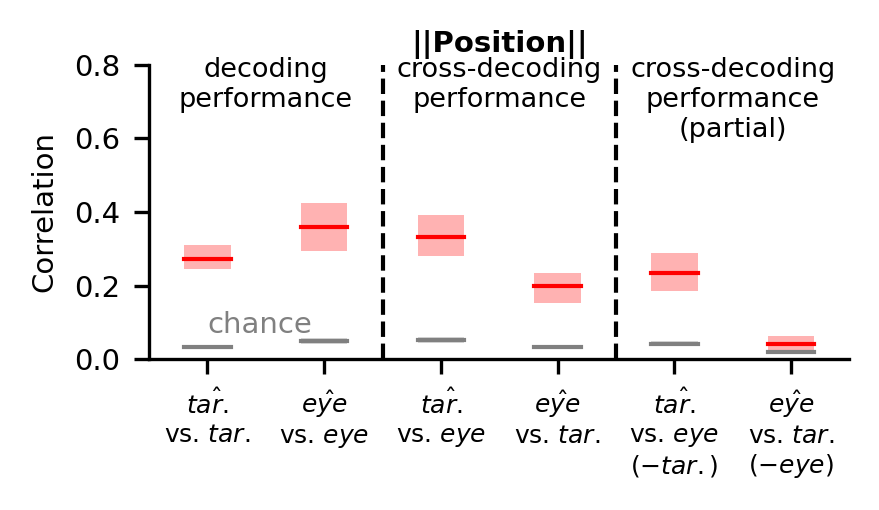

In [190]:
# cross decoding
width = 2.7; height = 1.5
yticks = np.linspace(0, 0.8, 5)
ydata1 = np.array([tardist_vs_decode_tardist_PPC, ver_vs_decode_ver_PPC, ver_vs_decode_tardist_PPC, tardist_vs_decode_ver_PPC])

ydata2 = np.array([tardist_vs_decode_tardist_shuffle_PPC, ver_vs_decode_ver_shuffle_PPC, 
                   ver_vs_decode_tardist_shuffle_PPC, tardist_vs_decode_ver_shuffle_PPC])

ydata3 = np.array([ver_vs_decode_tardist_partial_PPC, tardist_vs_decode_ver_partial_PPC])
ydata4 = np.array([ver_vs_decode_tardist_partial_shuffle_PPC, tardist_vs_decode_ver_partial_shuffle_PPC])

xticks = np.arange(6)
xticklabels = ['$\hat{tar.}$\nvs. $tar.$', '$\hat{eye}$\nvs. $eye$',
               '$\hat{tar.}$\nvs. $eye$', '$\hat{eye}$\nvs. $tar.$',
               '$\hat{tar.}$\nvs. $eye$\n($-tar.$)', '$\hat{eye}$\nvs. $tar.$\n($-eye$)']

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('||Position||', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize - 1)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.13, 0.5)

for x, ymean, ydata in zip(xticks[:4], ydata1.mean(axis=1), ydata1):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)

for x, ymean, ydata in zip(xticks[:4], ydata2.mean(axis=1), ydata2):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata3.mean(axis=1), ydata3):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='r', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='r', alpha=0.3)
    
for x, ymean, ydata in zip(xticks[4:], ydata4.mean(axis=1), ydata4):
    res = bootstrap((ydata, ), np.mean, confidence_level=0.95, random_state=0)
    ax.plot([x-0.2, x+0.2], [ymean, ymean], c='gray', lw=1)
    ax.fill_between([x-0.2, x+0.2], [res.confidence_interval.low] * 2, [res.confidence_interval.high] * 2, 
                    facecolor='gray', alpha=0.3)

y = 0.82
ax.text(0.5, y, 'decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(2.5, y, 'cross-decoding\nperformance', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(4.5, y, 'cross-decoding\nperformance\n(partial)', fontsize=fontsize-0.5, ha='center', va='top')
ax.text(0, 0.07, 'chance', fontsize=fontsize, c='gray')

for x in xticks[2::2]:
    x = x - 0.5
    ax.plot([x, x], ax.get_ylim(), lw=lw, c='k', ls='--')
    
fig.tight_layout(pad=0, rect=[0.015, 0, 1.015, 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='correlations_ver'), orientation='landscape', format='pdf', 
#            transparent=True)

# fig1, m44

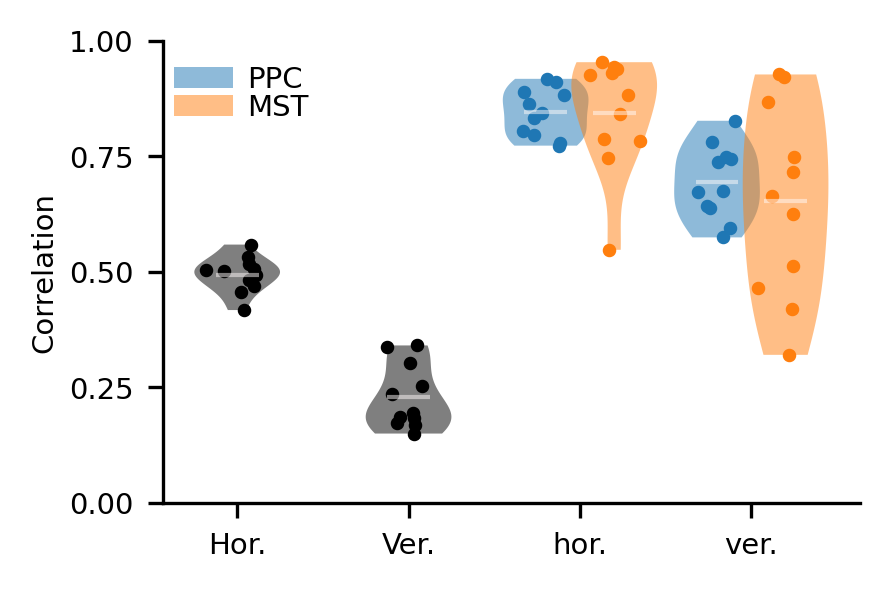

In [131]:
width = 3; height = 2
yticks = np.linspace(0, 1, 5)
xticks = np.arange(4)
xticklabels = ['Hor.', 'Ver.', 'hor.', 'ver.']

ydata1 = [hor_vs_ideal_hor_PPC, ver_vs_ideal_ver_PPC]
ydata2 = [decode_hor_vs_decode_tarang_PPC, decode_ver_vs_decode_tardist_PPC]
ydata3 = [decode_hor_vs_decode_tarang_MST, decode_ver_vs_decode_tardist_MST]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.15, 0.5)

vio1 = ax.violinplot(ydata1, positions=np.array([0, 1]), showmeans=True)
ax.scatter(0 + np.random.randn(len(ydata1[0]))*0.07, ydata1[0], s=5, c='k')
ax.scatter(1 + np.random.randn(len(ydata1[1]))*0.07, ydata1[1], s=5, c='k')
vio2 = ax.violinplot(ydata2, positions=np.array([2, 3]) - 0.2, showmeans=True)
ax.scatter(2 - 0.2 + np.random.randn(len(ydata2[0]))*0.07, ydata2[0], s=5, c='C0')
ax.scatter(3 - 0.2 + np.random.randn(len(ydata2[1]))*0.07, ydata2[1], s=5, c='C0')
vio3 = ax.violinplot(ydata3, positions=np.array([2, 3]) + 0.2, showmeans=True)
ax.scatter(2 + 0.2 + np.random.randn(len(ydata3[0]))*0.07, ydata3[0], s=5, c='C1')
ax.scatter(3 + 0.2 + np.random.randn(len(ydata3[1]))*0.07, ydata3[1], s=5, c='C1')
set_violin_plot(vio1, facecolor='k', edgecolor='None', alpha=0.5)
set_violin_plot(vio2, facecolor='C0', edgecolor='None', alpha=0.5)
set_violin_plot(vio3, facecolor='C1', edgecolor='None', alpha=0.5)
ax.legend([vio2['bodies'][0], vio3['bodies'][0]], ['PPC', 'MST'], 
          fontsize=fontsize, frameon=False, loc=[0, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

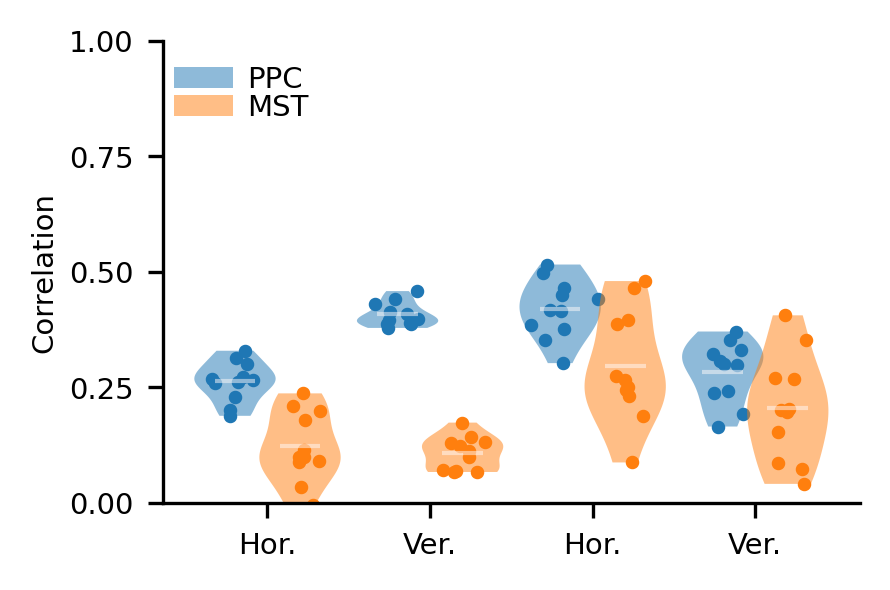

In [132]:
width = 3; height = 2
yticks = np.linspace(0, 1, 5)
xticks = np.arange(4)
xticklabels = ['Hor.', 'Ver.', 'Hor.', 'Ver.']

ydata1 = [tarang_vs_decode_tarang_PPC, tardist_vs_decode_tardist_PPC, hor_vs_decode_hor_PPC, ver_vs_decode_ver_PPC]
ydata2 = [tarang_vs_decode_tarang_MST, tardist_vs_decode_tardist_MST, hor_vs_decode_hor_MST, ver_vs_decode_ver_MST]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.15, 0.5)

vio1 = ax.violinplot(ydata1, positions=xticks-0.2, showmeans=True)
for pos, d in zip(xticks - 0.2, ydata1):
    ax.scatter(pos + np.random.randn(len(d)) * 0.07, d, s=5, c='C0')
vio2 = ax.violinplot(ydata2, positions=xticks+0.2, showmeans=True)
for pos, d in zip(xticks + 0.2, ydata2):
    ax.scatter(pos + np.random.randn(len(d)) * 0.07, d, s=5, c='C1')
set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)
set_violin_plot(vio2, facecolor='C1', edgecolor='None', alpha=0.5)
ax.legend([vio1['bodies'][0], vio2['bodies'][0]], ['PPC', 'MST'], 
          fontsize=fontsize, frameon=False, loc=[0, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

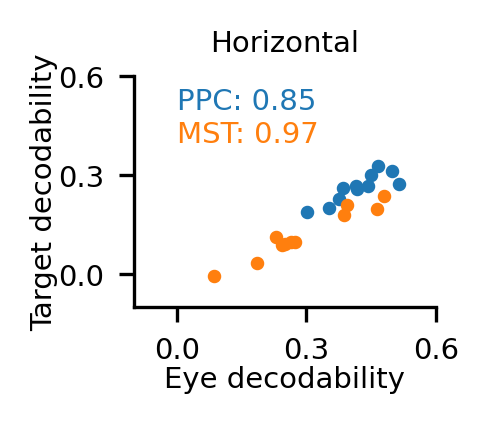

In [210]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.6, 3)
xticks = np.linspace(0, 0.6, 3)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Target decodability', fontsize=fontsize)
ax.set_xlabel('Eye decodability', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.1, xticks[-1])
ax.set_ylim(yticks[0]-0.1, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.scatter(hor_vs_decode_hor_PPC, tarang_vs_decode_tarang_PPC, s=5)
ax.scatter(hor_vs_decode_hor_MST, tarang_vs_decode_tarang_MST, s=5)
ax.text(0, 0.5, f'PPC: {np.round(np.corrcoef(hor_vs_decode_hor_PPC, tarang_vs_decode_tarang_PPC)[0, 1], 2)}', 
        fontsize=fontsize, c='C0')
ax.text(0, 0.4, f'MST: {np.round(np.corrcoef(hor_vs_decode_hor_MST, tarang_vs_decode_tarang_MST)[0, 1], 2)}', 
        fontsize=fontsize, c='C1')

    
plt.show()

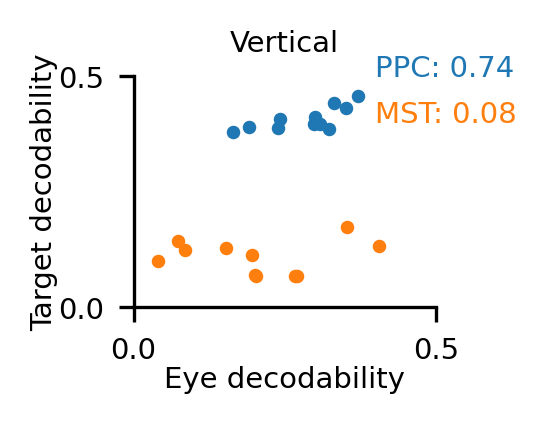

In [216]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.5, 2)
xticks = np.linspace(0, 0.5, 2)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Target decodability', fontsize=fontsize)
ax.set_xlabel('Eye decodability', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.scatter(ver_vs_decode_ver_PPC, tardist_vs_decode_tardist_PPC, s=5)
ax.scatter(ver_vs_decode_ver_MST, tardist_vs_decode_tardist_MST, s=5)
ax.text(0.4, 0.5, f'PPC: {np.round(np.corrcoef(ver_vs_decode_ver_PPC, tardist_vs_decode_tardist_PPC)[0, 1], 2)}', 
        fontsize=fontsize, c='C0')
ax.text(0.4, 0.4, f'MST: {np.round(np.corrcoef(ver_vs_decode_ver_MST, tardist_vs_decode_tardist_MST)[0, 1], 2)}', 
        fontsize=fontsize, c='C1')
    
plt.show()

# fig1, m53

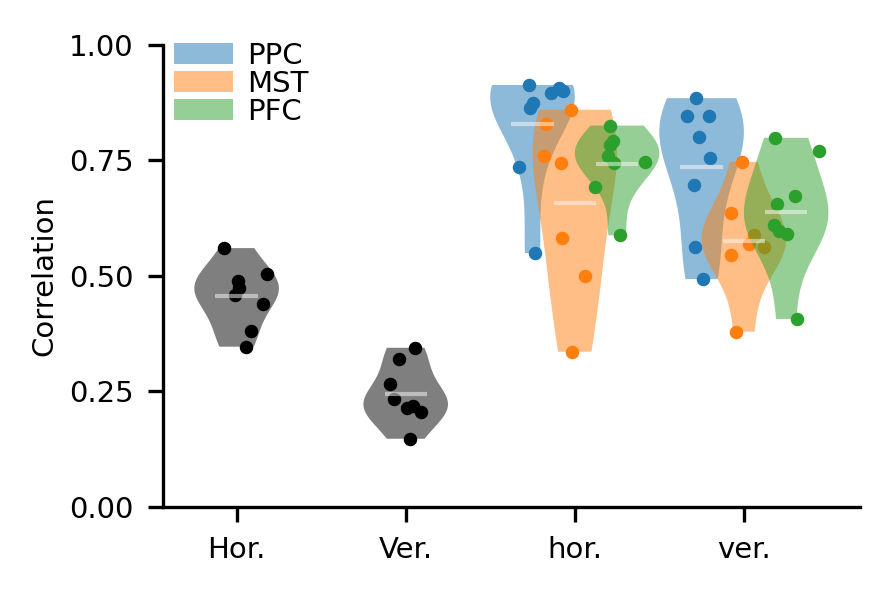

In [33]:
width = 3; height = 2
yticks = np.linspace(0, 1, 5)
xticks = np.arange(4)
xticklabels = ['Hor.', 'Ver.', 'hor.', 'ver.']

ydata1 = [hor_vs_ideal_hor_PPC, ver_vs_ideal_ver_PPC]
ydata2 = [decode_hor_vs_decode_tarang_PPC, decode_ver_vs_decode_tardist_PPC]
ydata3 = [decode_hor_vs_decode_tarang_MST, decode_ver_vs_decode_tardist_MST]
ydata4 = [decode_hor_vs_decode_tarang_PFC, decode_ver_vs_decode_tardist_PFC]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.15, 0.5)

vio1 = ax.violinplot(ydata1, positions=np.array([0, 1]), showmeans=True)
ax.scatter(0 + np.random.randn(len(ydata1[0]))*0.07, ydata1[0], s=5, c='k')
ax.scatter(1 + np.random.randn(len(ydata1[1]))*0.07, ydata1[1], s=5, c='k')
vio2 = ax.violinplot(ydata2, positions=np.array([2, 3]) - 0.25, showmeans=True)
ax.scatter(2 - 0.25 + np.random.randn(len(ydata2[0]))*0.07, ydata2[0], s=5, c='C0')
ax.scatter(3 - 0.25 + np.random.randn(len(ydata2[1]))*0.07, ydata2[1], s=5, c='C0')
vio3 = ax.violinplot(ydata3, positions=np.array([2, 3]), showmeans=True)
ax.scatter(2 + np.random.randn(len(ydata3[0]))*0.07, ydata3[0], s=5, c='C1')
ax.scatter(3 + np.random.randn(len(ydata3[1]))*0.07, ydata3[1], s=5, c='C1')
vio4 = ax.violinplot(ydata4, positions=np.array([2, 3]) + 0.25, showmeans=True)
ax.scatter(2 + 0.25 + np.random.randn(len(ydata4[0]))*0.07, ydata4[0], s=5, c='C2')
ax.scatter(3 + 0.25 + np.random.randn(len(ydata4[1]))*0.07, ydata4[1], s=5, c='C2')
set_violin_plot(vio1, facecolor='k', edgecolor='None', alpha=0.5)
set_violin_plot(vio2, facecolor='C0', edgecolor='None', alpha=0.5)
set_violin_plot(vio3, facecolor='C1', edgecolor='None', alpha=0.5)
set_violin_plot(vio4, facecolor='C2', edgecolor='None', alpha=0.5)
ax.legend([vio2['bodies'][0], vio3['bodies'][0],  vio4['bodies'][0]], ['PPC', 'MST', 'PFC'], 
          fontsize=fontsize, frameon=False, loc=[0, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

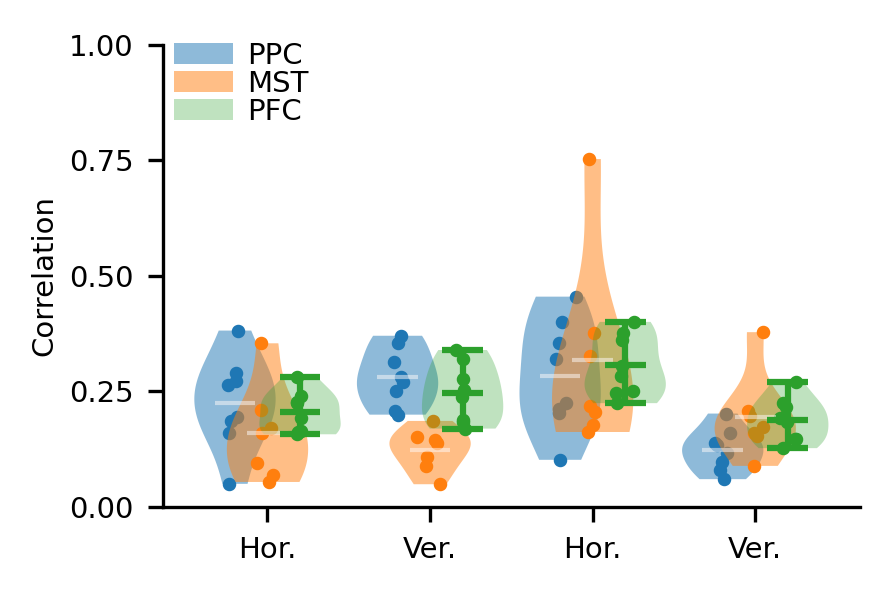

In [62]:
width = 3; height = 2
yticks = np.linspace(0, 1, 5)
xticks = np.arange(4)
xticklabels = ['Hor.', 'Ver.', 'Hor.', 'Ver.']

ydata1 = [tarang_vs_decode_tarang_PPC, tardist_vs_decode_tardist_PPC, hor_vs_decode_hor_PPC, ver_vs_decode_ver_PPC]
ydata2 = [tarang_vs_decode_tarang_MST, tardist_vs_decode_tardist_MST, hor_vs_decode_hor_MST, ver_vs_decode_ver_MST]
ydata3 = [tarang_vs_decode_tarang_PFC, tardist_vs_decode_tardist_PFC, hor_vs_decode_hor_PFC, ver_vs_decode_ver_PFC]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Correlation', fontsize=fontsize)
#ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.2)
ax.yaxis.set_label_coords(-0.15, 0.5)

vio1 = ax.violinplot(ydata1, positions=xticks-0.2, showmeans=True)
for pos, d in zip(xticks - 0.2, ydata1):
    ax.scatter(pos + np.random.randn(len(d)) * 0.03, d, s=5, c='C0')
vio2 = ax.violinplot(ydata2, positions=xticks, showmeans=True)
for pos, d in zip(xticks, ydata2):
    ax.scatter(pos + np.random.randn(len(d)) * 0.03, d, s=5, c='C1')
vio3 = ax.violinplot(ydata3, positions=xticks+0.2, showmeans=True)
for pos, d in zip(xticks + 0.2, ydata3):
    ax.scatter(pos + np.random.randn(len(d)) * 0.03, d, s=5, c='C2')
set_violin_plot(vio1, facecolor='C0', edgecolor='None', alpha=0.5)
set_violin_plot(vio2, facecolor='C1', edgecolor='None', alpha=0.5)
ax.legend([vio1['bodies'][0], vio2['bodies'][0],  vio3['bodies'][0]], ['PPC', 'MST', 'PFC'], 
          fontsize=fontsize, frameon=False, loc=[0, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

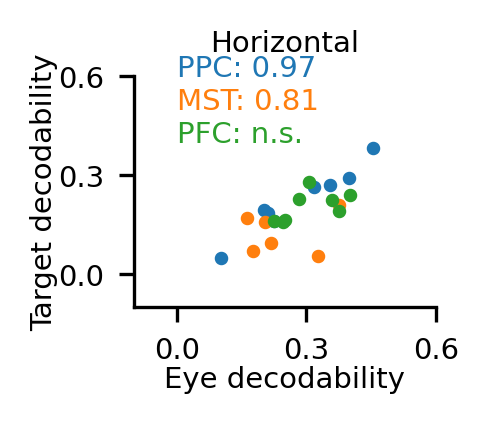

In [46]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.6, 3)
xticks = np.linspace(0, 0.6, 3)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Target decodability', fontsize=fontsize)
ax.set_xlabel('Eye decodability', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.1, xticks[-1])
ax.set_ylim(yticks[0]-0.1, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.scatter(hor_vs_decode_hor_PPC, tarang_vs_decode_tarang_PPC, s=5)
ax.scatter(hor_vs_decode_hor_MST, tarang_vs_decode_tarang_MST, s=5)
ax.scatter(hor_vs_decode_hor_PFC, tarang_vs_decode_tarang_PFC, s=5)
ax.text(0, 0.6, f'PPC: {np.round(np.corrcoef(hor_vs_decode_hor_PPC, tarang_vs_decode_tarang_PPC)[0, 1], 2)}', 
        fontsize=fontsize, c='C0')
ax.text(0, 0.5, f'MST: {np.round(np.corrcoef(hor_vs_decode_hor_MST, tarang_vs_decode_tarang_MST)[0, 1], 2)}', 
        fontsize=fontsize, c='C1')
ax.text(0, 0.4, f'PFC: n.s.', 
        fontsize=fontsize, c='C2')

    
plt.show()

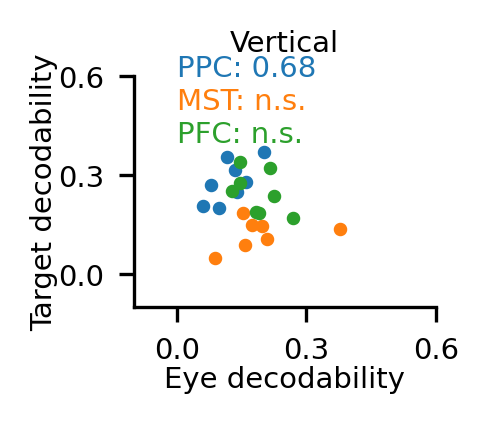

In [51]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.6, 3)
xticks = np.linspace(0, 0.6, 3)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Target decodability', fontsize=fontsize)
ax.set_xlabel('Eye decodability', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.1, xticks[-1])
ax.set_ylim(yticks[0]-0.1, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.scatter(ver_vs_decode_ver_PPC, tardist_vs_decode_tardist_PPC, s=5)
ax.scatter(ver_vs_decode_ver_MST, tardist_vs_decode_tardist_MST, s=5)
ax.scatter(ver_vs_decode_ver_PFC, tardist_vs_decode_tardist_PFC, s=5)
ax.text(0, 0.6, f'PPC: {np.round(np.corrcoef(ver_vs_decode_ver_PPC, tardist_vs_decode_tardist_PPC)[0, 1], 2)}', 
        fontsize=fontsize, c='C0')
ax.text(0, 0.5, f'MST: n.s.', 
        fontsize=fontsize, c='C1')
ax.text(0, 0.4, f'PFC: n.s.', 
        fontsize=fontsize, c='C2')

    
plt.show()

# fig2, m51

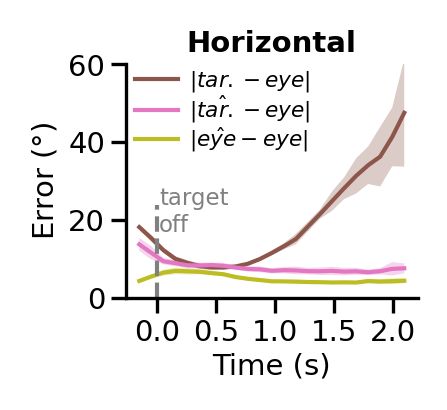

In [364]:
area = 'PPC'
width = 1.3; height = 1.2
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['hor_vs_ideal_hor']) for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['hor_vs_decode_tarang'].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['hor_vs_decode_hor'].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.23)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C5', label='$|tar.-eye|$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C6', label='$|\hat{tar.}-eye|$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C8', label='$|\hat{eye}-eye|$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C5', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C6', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C8', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.58], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
ax.text(0.02, 17, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='error_over_time_hor'), orientation='landscape', format='pdf', 
            transparent=True)

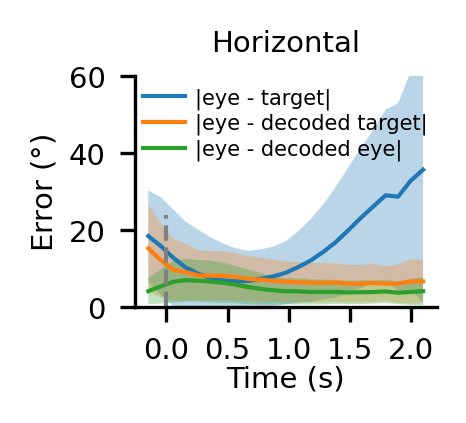

In [58]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([sess_v[t]['hor_vs_ideal_hor'] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([sess_v[t]['hor_vs_ideal_hor'] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.hstack([sess_v[t]['hor_vs_decode_tarang'] for sess_v in error_data[area].values()]).mean()
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.hstack([sess_v[t]['hor_vs_decode_tarang'] for sess_v in error_data[area].values()]).std()
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.hstack([sess_v[t]['hor_vs_decode_hor'] for sess_v in error_data[area].values()]).mean()
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.hstack([sess_v[t]['hor_vs_decode_hor'] for sess_v in error_data[area].values()]).std()
         for t in range(t_total)])[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

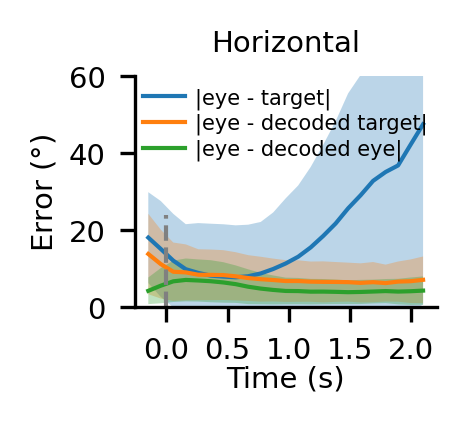

In [218]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([sess_v[t]['hor_vs_ideal_hor'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([sess_v[t]['hor_vs_ideal_hor'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.hstack([sess_v[t]['hor_vs_decode_tarang'][1] for sess_v in error_data[area].values()]).mean()
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.hstack([sess_v[t]['hor_vs_decode_tarang'][1] for sess_v in error_data[area].values()]).std()
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.hstack([sess_v[t]['hor_vs_decode_hor'][1] for sess_v in error_data[area].values()]).mean()
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.hstack([sess_v[t]['hor_vs_decode_hor'][1] for sess_v in error_data[area].values()]).std()
         for t in range(t_total)])[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

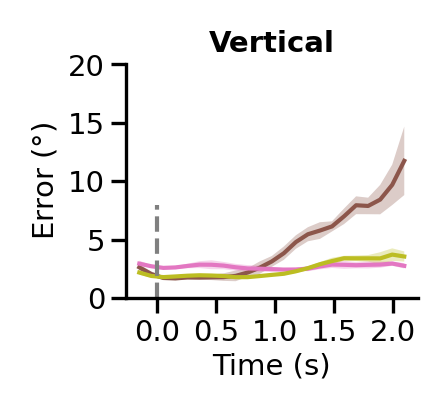

In [350]:
area = 'PPC'
width = 1.3; height = 1.2
yticks = np.linspace(0, 20, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['ver_vs_ideal_ver']) for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['ver_vs_decode_tardist'].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['ver_vs_decode_ver'].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.23)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C5', label='$|tar-eye|$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C6', label='$|\hat{tar.}-eye|$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C8', label='$|\hat{eye}-eye|$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C5', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C6', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C8', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

#ax.legend(fontsize=fontsize-2, frameon=False, 
#          loc=[0, 0.6], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='error_over_time_ver'), orientation='landscape', format='pdf', 
            transparent=True)

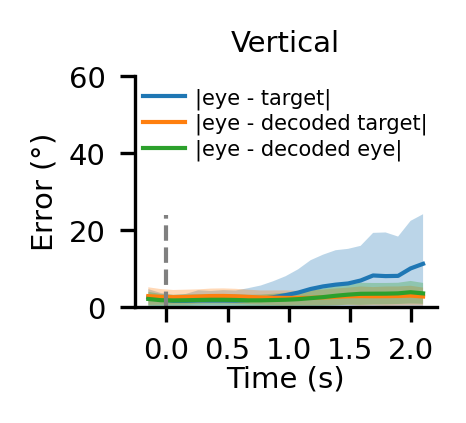

In [217]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([sess_v[t]['ver_vs_ideal_ver'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([sess_v[t]['ver_vs_ideal_ver'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.nanmean(np.hstack([sess_v[t]['ver_vs_decode_tardist'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.nanstd(np.hstack([sess_v[t]['ver_vs_decode_tardist'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.nanmean(np.hstack([sess_v[t]['ver_vs_decode_ver'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.nanstd(np.hstack([sess_v[t]['ver_vs_decode_ver'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]


fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

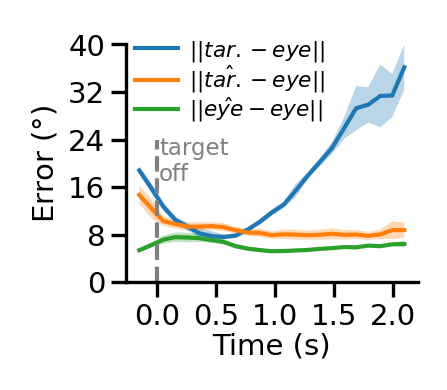

In [402]:
area = 'PPC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
ax.text(0.02, 17, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='error_over_time_both'), orientation='landscape', format='pdf', 
            transparent=True)

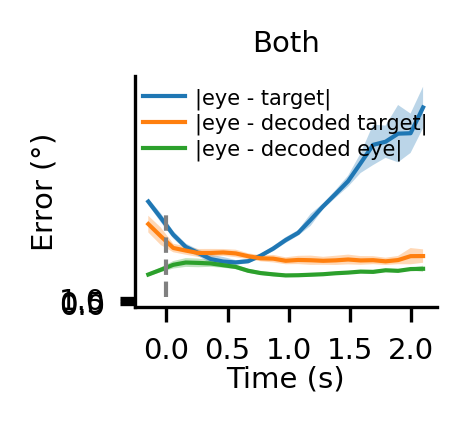

In [384]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

tmask = xdata > -0.1
ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

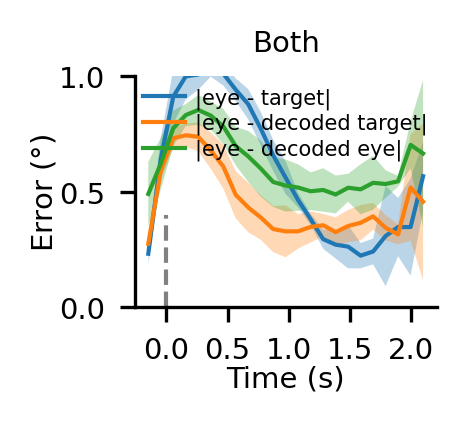

In [39]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

tmask = xdata > -0.1
ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

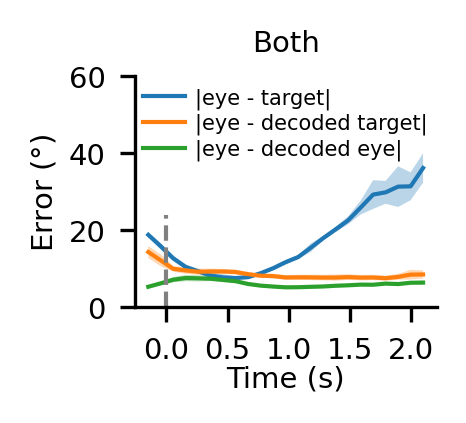

In [223]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

tmask = xdata > -0.1
ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

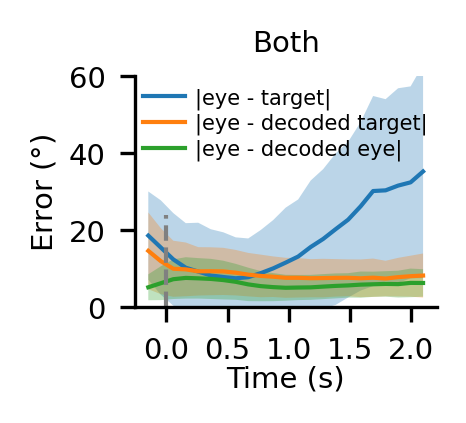

In [230]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2)
                              for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2)
                             for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.nanmean(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2)
                              for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.nanstd(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2)
                             for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.nanmean(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2)
                              for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.nanstd(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2)
                             for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

# fig2, m44

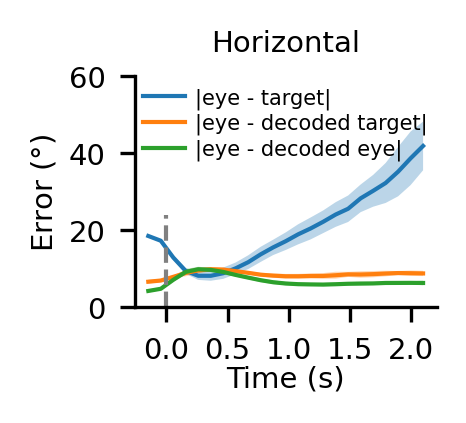

In [102]:
# m44
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['hor_vs_ideal_hor'][1]) for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['hor_vs_decode_tarang'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['hor_vs_decode_hor'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

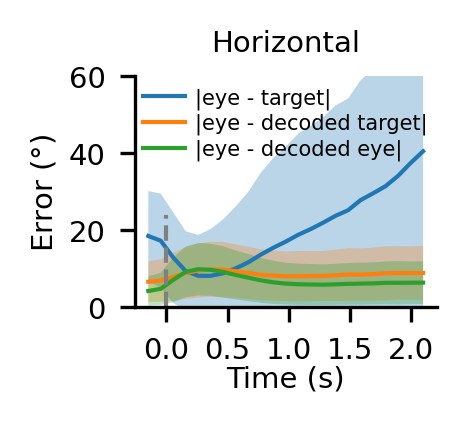

In [103]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([sess_v[t]['hor_vs_ideal_hor'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([sess_v[t]['hor_vs_ideal_hor'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.hstack([sess_v[t]['hor_vs_decode_tarang'][1] for sess_v in error_data[area].values()]).mean()
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.hstack([sess_v[t]['hor_vs_decode_tarang'][1] for sess_v in error_data[area].values()]).std()
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.hstack([sess_v[t]['hor_vs_decode_hor'][1] for sess_v in error_data[area].values()]).mean()
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.hstack([sess_v[t]['hor_vs_decode_hor'][1] for sess_v in error_data[area].values()]).std()
         for t in range(t_total)])[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

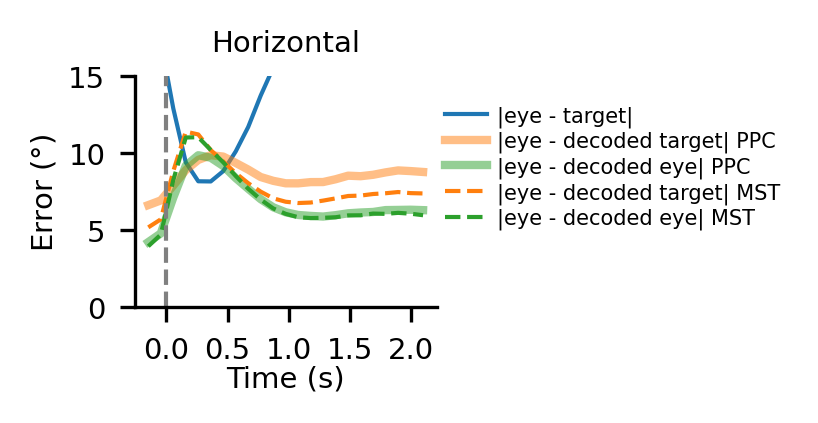

In [104]:
# m44
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 15, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['hor_vs_ideal_hor'][1]) for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['hor_vs_decode_tarang'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['hor_vs_decode_hor'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

ydata4 = np.array([[sess_v[t]['hor_vs_decode_tarang'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean4 = ydata4.mean(axis=0)[tmask]
ystd4 = ydata4.std(axis=0)[tmask]

ydata5 = np.array([[sess_v[t]['hor_vs_decode_hor'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean5 = ydata5.mean(axis=0)[tmask]
ystd5 = ydata5.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw*2, c='C1', label='|eye - decoded target| PPC', alpha=0.5)
ax.plot(xdata, ymean3, lw=lw*2, c='C2', label='|eye - decoded eye| PPC', alpha=0.5)
ax.plot(xdata, ymean4, lw=lw, c='C1', label='|eye - decoded target| MST', alpha=1, ls='--')
ax.plot(xdata, ymean5, lw=lw, c='C2', label='|eye - decoded eye| MST', alpha=1, ls='--')
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[1, 0.3], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

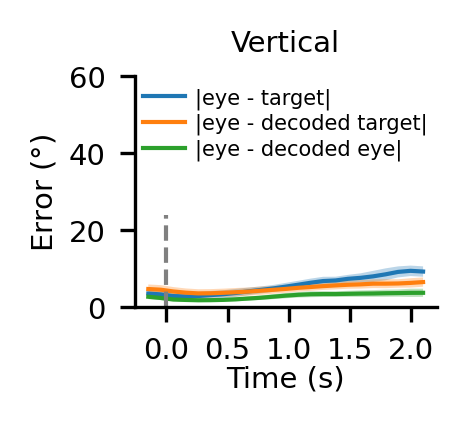

In [105]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['ver_vs_ideal_ver'][1]) for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['ver_vs_decode_tardist'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['ver_vs_decode_ver'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

tmask = xdata > -0.1
ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

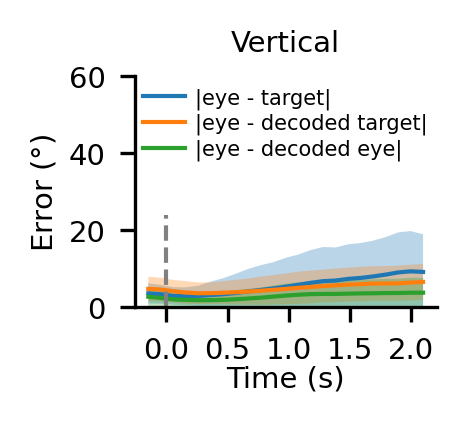

In [106]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([sess_v[t]['ver_vs_ideal_ver'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([sess_v[t]['ver_vs_ideal_ver'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.nanmean(np.hstack([sess_v[t]['ver_vs_decode_tardist'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.nanstd(np.hstack([sess_v[t]['ver_vs_decode_tardist'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.nanmean(np.hstack([sess_v[t]['ver_vs_decode_ver'][1] for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.nanstd(np.hstack([sess_v[t]['ver_vs_decode_ver'][1] for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]


fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

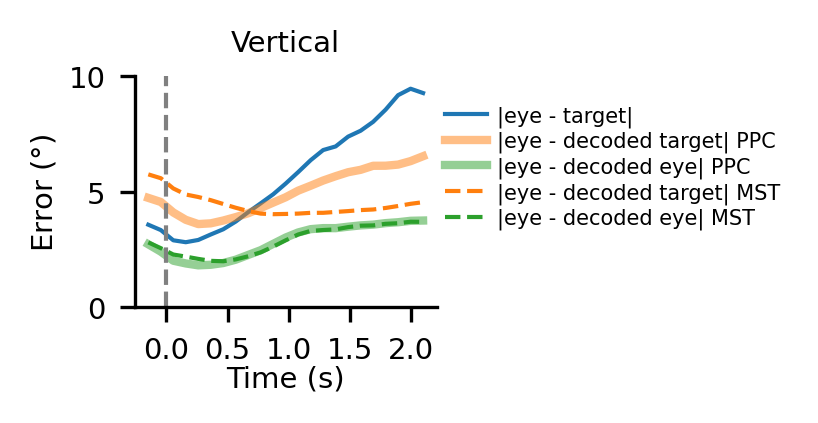

In [107]:
# m44
width = 1.3; height = 1
yticks = np.linspace(0, 10, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['ver_vs_ideal_ver'][1]) for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['ver_vs_decode_tardist'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['ver_vs_decode_ver'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

ydata4 = np.array([[sess_v[t]['ver_vs_decode_tardist'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean4 = ydata4.mean(axis=0)[tmask]
ystd4 = ydata4.std(axis=0)[tmask]

ydata5 = np.array([[sess_v[t]['ver_vs_decode_ver'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean5 = ydata5.mean(axis=0)[tmask]
ystd5 = ydata5.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw*2, c='C1', label='|eye - decoded target| PPC', alpha=0.5)
ax.plot(xdata, ymean3, lw=lw*2, c='C2', label='|eye - decoded eye| PPC', alpha=0.5)
ax.plot(xdata, ymean4, lw=lw, c='C1', label='|eye - decoded target| MST', alpha=1, ls='--')
ax.plot(xdata, ymean5, lw=lw, c='C2', label='|eye - decoded eye| MST', alpha=1, ls='--')
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[1, 0.3], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

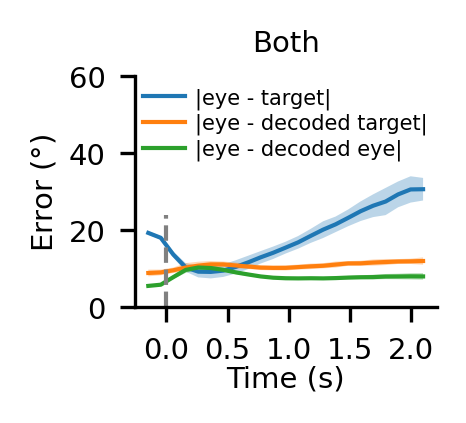

In [108]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

tmask = xdata > -0.1
ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

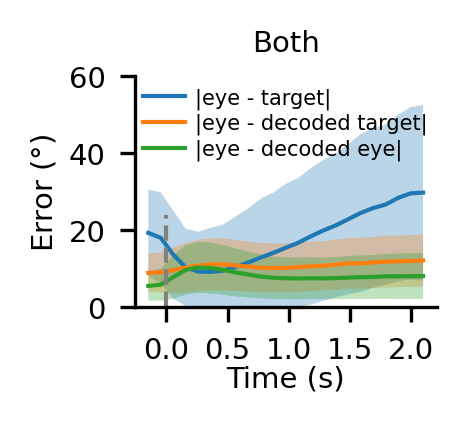

In [109]:
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ymean1 = np.array([np.nanmean(np.hstack([np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2)
                              for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd1 = np.array([np.nanstd(np.hstack([np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2)
                             for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean2 = np.array([np.nanmean(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2)
                              for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd2 = np.array([np.nanstd(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2)
                             for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

ymean3 = np.array([np.nanmean(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2)
                              for sess_v in error_data[area].values()]))
          for t in range(t_total)])[tmask]
ystd3 = np.array([np.nanstd(np.hstack([np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2)
                             for sess_v in error_data[area].values()]))
         for t in range(t_total)])[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='|eye - decoded target|', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='|eye - decoded eye|', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.4), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0.6], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

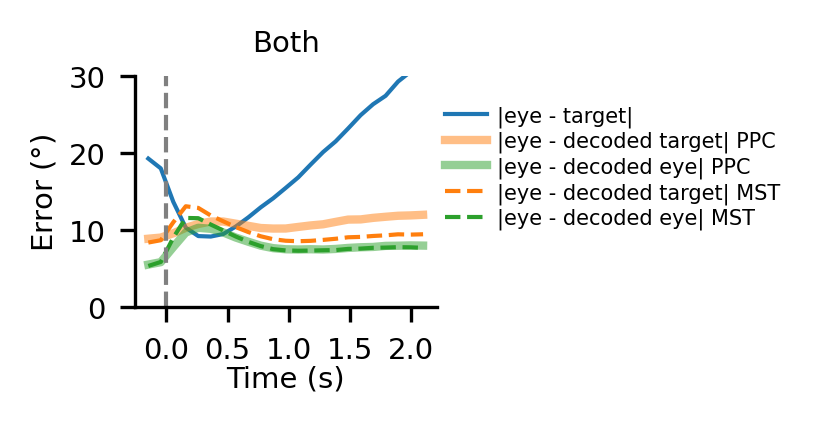

In [110]:
# m44
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 30, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PPC'].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PPC'].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PPC'].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

ydata4 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['MST'].values()])
ymean4 = ydata4.mean(axis=0)[tmask]
ystd4 = ydata4.std(axis=0)[tmask]

ydata5 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['MST'].values()])
ymean5 = ydata5.mean(axis=0)[tmask]
ystd5 = ydata5.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw*2, c='C1', label='|eye - decoded target| PPC', alpha=0.5)
ax.plot(xdata, ymean3, lw=lw*2, c='C2', label='|eye - decoded eye| PPC', alpha=0.5)
ax.plot(xdata, ymean4, lw=lw, c='C1', label='|eye - decoded target| MST', alpha=1, ls='--')
ax.plot(xdata, ymean5, lw=lw, c='C2', label='|eye - decoded eye| MST', alpha=1, ls='--')
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[1, 0.3], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

# fig2, m53

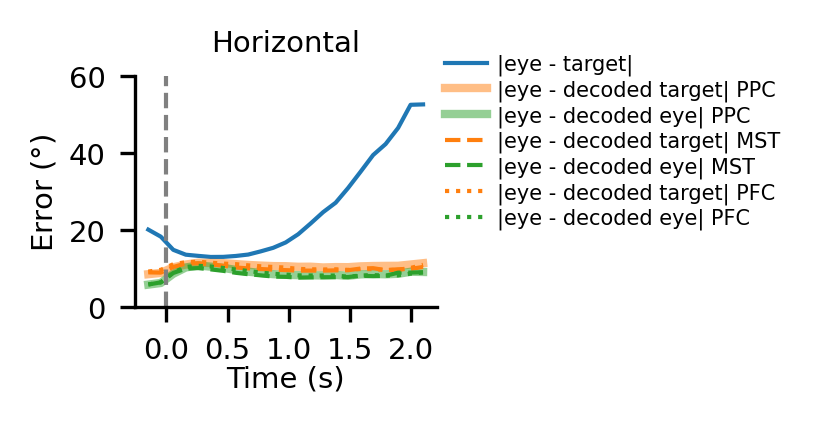

In [57]:
# m44
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 60, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['hor_vs_ideal_hor'][1]) for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['hor_vs_decode_tarang'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['hor_vs_decode_hor'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

ydata4 = np.array([[sess_v[t]['hor_vs_decode_tarang'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean4 = ydata4.mean(axis=0)[tmask]
ystd4 = ydata4.std(axis=0)[tmask]

ydata5 = np.array([[sess_v[t]['hor_vs_decode_hor'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean5 = ydata5.mean(axis=0)[tmask]
ystd5 = ydata5.std(axis=0)[tmask]

ydata6 = np.array([[sess_v[t]['hor_vs_decode_tarang'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PFC'].values()])
ymean6 = ydata6.mean(axis=0)[tmask]
ystd6 = ydata6.std(axis=0)[tmask]

ydata7 = np.array([[sess_v[t]['hor_vs_decode_hor'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PFC'].values()])
ymean7 = ydata7.mean(axis=0)[tmask]
ystd7 = ydata7.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Horizontal', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw*2, c='C1', label='|eye - decoded target| PPC', alpha=0.5)
ax.plot(xdata, ymean3, lw=lw*2, c='C2', label='|eye - decoded eye| PPC', alpha=0.5)
ax.plot(xdata, ymean4, lw=lw, c='C1', label='|eye - decoded target| MST', alpha=1, ls='--')
ax.plot(xdata, ymean5, lw=lw, c='C2', label='|eye - decoded eye| MST', alpha=1, ls='--')
ax.plot(xdata, ymean6, lw=lw, c='C1', label='|eye - decoded target| PFC', alpha=1, ls=':')
ax.plot(xdata, ymean7, lw=lw, c='C2', label='|eye - decoded eye| PFC', alpha=1, ls=':')
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[1, 0.3], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

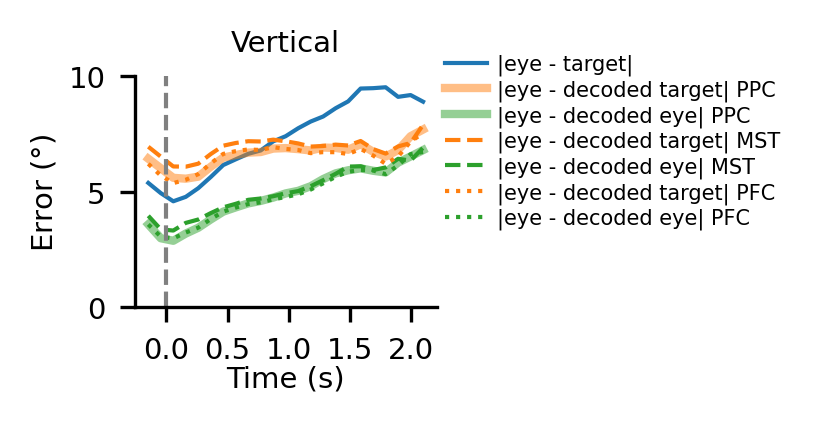

In [61]:
# m44
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 10, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(sess_v[t]['ver_vs_ideal_ver'][1]) for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[sess_v[t]['ver_vs_decode_tardist'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[sess_v[t]['ver_vs_decode_ver'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PPC'].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

ydata4 = np.array([[sess_v[t]['ver_vs_decode_tardist'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean4 = ydata4.mean(axis=0)[tmask]
ystd4 = ydata4.std(axis=0)[tmask]

ydata5 = np.array([[sess_v[t]['ver_vs_decode_ver'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['MST'].values()])
ymean5 = ydata5.mean(axis=0)[tmask]
ystd5 = ydata5.std(axis=0)[tmask]

ydata6 = np.array([[sess_v[t]['ver_vs_decode_tardist'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PFC'].values()])
ymean6 = ydata6.mean(axis=0)[tmask]
ystd6 = ydata6.std(axis=0)[tmask]

ydata7 = np.array([[sess_v[t]['ver_vs_decode_ver'][1].mean() for t in range(t_total)] 
                   for sess_v in error_data['PFC'].values()])
ymean7 = ydata7.mean(axis=0)[tmask]
ystd7 = ydata7.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Vertical', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw*2, c='C1', label='|eye - decoded target| PPC', alpha=0.5)
ax.plot(xdata, ymean3, lw=lw*2, c='C2', label='|eye - decoded eye| PPC', alpha=0.5)
ax.plot(xdata, ymean4, lw=lw, c='C1', label='|eye - decoded target| MST', alpha=1, ls='--')
ax.plot(xdata, ymean5, lw=lw, c='C2', label='|eye - decoded eye| MST', alpha=1, ls='--')
ax.plot(xdata, ymean6, lw=lw, c='C1', label='|eye - decoded target| PFC', alpha=1, ls=':')
ax.plot(xdata, ymean7, lw=lw, c='C2', label='|eye - decoded eye| PFC', alpha=1, ls=':')
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[1, 0.3], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

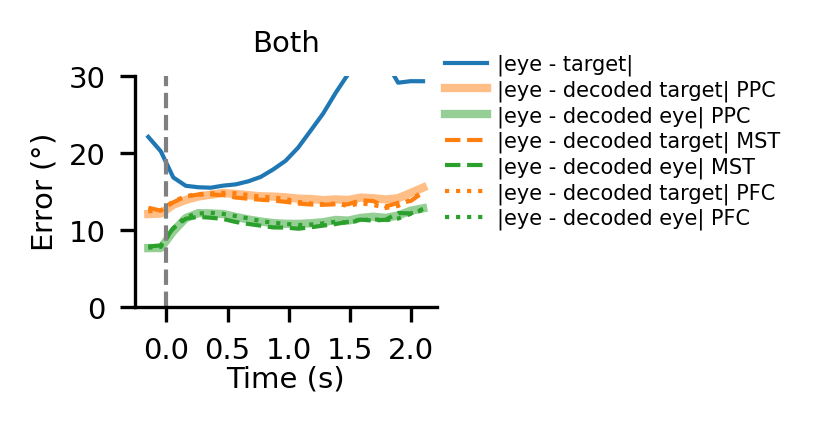

In [63]:
# m44
area = 'PPC'
width = 1.3; height = 1
yticks = np.linspace(0, 30, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver'][1]**2 + sess_v[t]['hor_vs_ideal_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PPC'].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PPC'].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PPC'].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

ydata4 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['MST'].values()])
ymean4 = ydata4.mean(axis=0)[tmask]
ystd4 = ydata4.std(axis=0)[tmask]

ydata5 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['MST'].values()])
ymean5 = ydata5.mean(axis=0)[tmask]
ystd5 = ydata5.std(axis=0)[tmask]

ydata6 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist'][1]**2 + sess_v[t]['hor_vs_decode_tarang'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PFC'].values()])
ymean6 = ydata6.mean(axis=0)[tmask]
ystd6 = ydata6.std(axis=0)[tmask]

ydata7 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver'][1]**2 + sess_v[t]['hor_vs_decode_hor'][1]**2))
                    for t in range(t_total)] for sess_v in error_data['PFC'].values()])
ymean7 = ydata7.mean(axis=0)[tmask]
ystd7 = ydata7.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Both', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='|eye - target|', alpha=1)
ax.plot(xdata, ymean2, lw=lw*2, c='C1', label='|eye - decoded target| PPC', alpha=0.5)
ax.plot(xdata, ymean3, lw=lw*2, c='C2', label='|eye - decoded eye| PPC', alpha=0.5)
ax.plot(xdata, ymean4, lw=lw, c='C1', label='|eye - decoded target| MST', alpha=1, ls='--')
ax.plot(xdata, ymean5, lw=lw, c='C2', label='|eye - decoded eye| MST', alpha=1, ls='--')
ax.plot(xdata, ymean6, lw=lw, c='C1', label='|eye - decoded target| PFC', alpha=1, ls=':')
ax.plot(xdata, ymean7, lw=lw, c='C2', label='|eye - decoded eye| PFC', alpha=1, ls=':')
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[1, 0.3], handletextpad=0.5, labelspacing=0.2, ncol=1, columnspacing=0)
    
plt.show()

# trial example

# m51

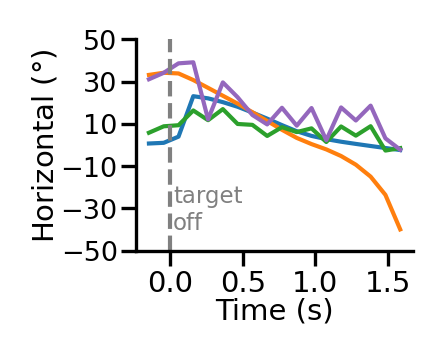

In [359]:
trial_idx = 61
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize - 0.5)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.22)
ax.yaxis.set_label_coords(-0.28, 0.5)
ax.tick_params(axis='both', which='major', pad=1)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='$eye$', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='$tar.$', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='$\hat{eye}$', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C4', label='$\hat{tar.}$', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

#ax.legend(fontsize=fontsize-2, frameon=False, 
#          loc=[0.1, -0.04], handletextpad=0.5, labelspacing=0, ncol=2, columnspacing=0.5)
ax.text(0.02, -40, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example_hor'), orientation='landscape', format='pdf', 
            transparent=True)

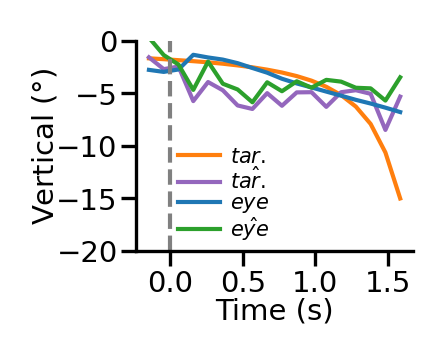

In [363]:
width = 1.3; height = 1
yticks = np.linspace(-20, 0, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 5]
ydata2 = tracking_data[trial_mask][tmask, 6]
ydata3 = decoder_predicted_data[trial_mask][tmask, 5]
ydata4 = decoder_predicted_data[trial_mask][tmask, 7]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Vertical ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.22)
ax.yaxis.set_label_coords(-0.28, 0.5)
ax.tick_params(axis='both', which='major', pad=1)

ax.plot(xdata, ydata2, lw=lw, c='C1', label='$tar.$', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C4', label='$\hat{tar.}$', alpha=1)
ax.plot(xdata, ydata1, lw=lw, c='C0', label='$eye$', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='$\hat{eye}$', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.12, 0], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)

fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example_ver'), orientation='landscape', format='pdf', 
            transparent=True)

In [ ]:
8 20 116 145 149 161 201 205 229 278

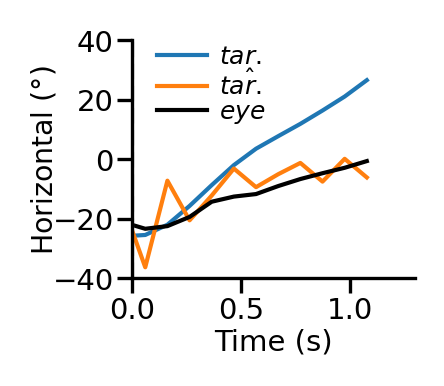

In [68]:
trial_idx = 229
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1.1
yticks = np.linspace(-40, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.4
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
#ydata3 = np.sqrt(decoder_predicted_data[trial_mask][tmask, 4]**2 + decoder_predicted_data[trial_mask][tmask, 5]**2)
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize-0.2)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 1.3)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.26, 0.5)
ax.tick_params(axis='both', which='major', pad=1)

tend = -8
ax.plot(interp(xdata)[:tend], interp(ydata2)[:tend], lw=lw, c='C0', label='$tar.$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata4)[:tend] - 5, lw=lw, c='C1', label='$\hat{tar.}$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata1)[:tend] - 4, lw=lw, c='k', label='$eye$', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1, frameon=False, 
          loc=[0.05, 0.6], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
#ax.text(0.02, 35, 'target\noff', fontsize=fontsize-1.5, c='gray')

fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example_hor'), orientation='landscape', format='pdf', 
            transparent=True)

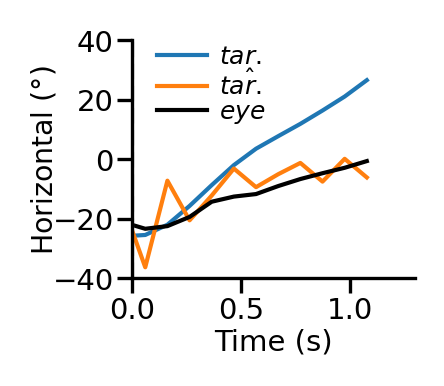

In [15]:
trial_idx = 229
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1.1
yticks = np.linspace(-40, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.4
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
#ydata3 = np.sqrt(decoder_predicted_data[trial_mask][tmask, 4]**2 + decoder_predicted_data[trial_mask][tmask, 5]**2)
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize-0.2)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 1.3)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.26, 0.5)
ax.tick_params(axis='both', which='major', pad=1)

tend = -8
ax.plot(interp(xdata)[:tend], interp(ydata2)[:tend], lw=lw, c='C0', label='$tar.$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata4)[:tend] - 5, lw=lw, c='C1', label='$\hat{tar.}$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata1)[:tend] - 4, lw=lw, c='k', label='$eye$', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1, frameon=False, 
          loc=[0.05, 0.6], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
#ax.text(0.02, 35, 'target\noff', fontsize=fontsize-1.5, c='gray')

fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example_hor'), orientation='landscape', format='pdf', 
#            transparent=True)

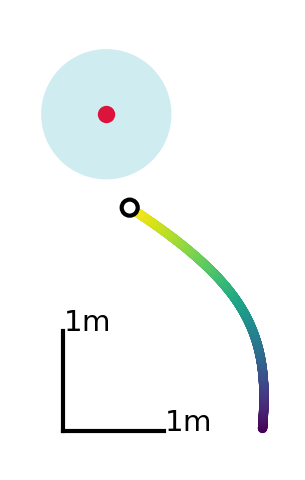

In [190]:
trial_idx = 229
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.4; height = 1.4
yticks = np.linspace(0, 400, 5)
xticks = np.linspace(-200, 0, 3)
mx = decoder_true_data[trial_mask][:, -2]
my = decoder_true_data[trial_mask][:, -1]; mf = UnivariateSpline(my, mx)
target_x = decoder_true_data[trial_mask][0, -4]
target_y = decoder_true_data[trial_mask][0, -3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_visible(False); ax.spines['left'].set_visible(False)
ax.axes.xaxis.set_ticks([]); ax.axes.yaxis.set_ticks([])

my_new = np.linspace(my[0], my[-1], 1000, endpoint=True)[:-80]
ax.scatter(mf(my_new), my_new, lw=0.5, alpha=1, s=3, c=np.arange(my_new.shape[0]),)
#ax.scatter(mf(my_new)[-1], my_new[-1], lw=0, alpha=1, s=50, c='k')

cir2 = Circle(xy=[mf(my_new)[-1], my_new[-1]], 
                  radius=8, 
                  alpha=1, fc='w', ec='k', lw=1)
ax.add_patch(cir2)

cir1 = Circle(xy=[target_x, target_y], 
                  radius=reward_boundary, 
                  alpha=0.6, color='powderblue', lw=0)
ax.add_patch(cir1)
ax.scatter(target_x, target_y, lw=lw, c='crimson', label='Target', alpha=1, s=10)

ax.plot(np.linspace(-200, -100), np.linspace(0, 0), c='k', lw=lw)
ax.plot(np.linspace(-200, -200), np.linspace(0, 100), c='k', lw=lw)
ax.text(-200, 100, s=r'$1$m', fontsize=fontsize)
ax.text(-100, 0, s=r'$1$m', fontsize=fontsize)

fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example2'), orientation='landscape', format='pdf', 
            transparent=True)

In [97]:
interp(xdata1)[:tend].shape[0]

34

In [111]:
from scipy.interpolate import UnivariateSpline

In [ ]:
p_idx = 925
print(p_idx)

dfs = [modular_trajectories[7], holistic_trajectories[5], 
       bruno_normal_trajectory, schro_normal_trajectory]
modular_trial, holistic_trial, bruno_trial, schro_trial = [df.iloc[p_idx] for df in dfs]
    
with initiate_plot(1.8, 1.8, 300) as fig, warnings.catch_warnings():
    warnings.simplefilter('ignore')
    ax = fig.add_subplot(111)
    ax.set_aspect('equal')
    ax.spines['top'].set_visible(False)
    ax.spines['right'].set_visible(False)
    ax.spines['bottom'].set_visible(False)
    ax.spines['left'].set_visible(False)
    ax.axes.xaxis.set_ticks([]); ax.axes.yaxis.set_ticks([])
    
    # modular agent
    mx = modular_trial.pos_x; my = modular_trial.pos_y; mf = UnivariateSpline(my, mx)
    my_new = np.linspace(my[0], my[-1], endpoint=True)
    ax.plot(mf(my_new), my_new, lw=lw, c=modular_c)
    
    # holistic agent
    hx = holistic_trial.pos_x
    hy = holistic_trial.pos_y
    hf = UnivariateSpline(hy, hx)
    hy_new = np.linspace(hy[0], hy[-1], endpoint=True)
    ax.plot(hf(hy_new), hy_new, lw=lw, c=holistic_c)
    
    # monkey Bruno
    bx = bruno_trial.pos_x; by = bruno_trial.pos_y
    ax.plot(bx, by, lw=lw, c=monkB_c)
    
    # monkey Schro
    sx = schro_trial.pos_x; sy = schro_trial.pos_y
    ax.plot(sx, sy, lw=lw, c=monkS_c)
    
    # target position
    target_x = bruno_trial.target_x; target_y = bruno_trial.target_y
    cir1 = Circle(xy=[target_x, target_y], 
                  radius=arg.goal_radius_range[0] * arg.LINEAR_SCALE, 
                  alpha=0.4, color=reward_c, lw=0)
    ax.add_patch(cir1)
    ax.scatter(target_x, target_y, c=reward_c, s=5)
    
    # plot initial position
    ax.scatter(0, 0, c='k', s=20, marker='*')
    ax.text(10, -10, s='Start', fontsize=fontsize)
    ax.text(mx[-1] + 7, my[-1] - 12, s='Modular agent', fontsize=fontsize, c=modular_c)
    ax.text(hx[-1] - 10, hy[-1] + 10, s='Holistic agent', fontsize=fontsize, c=holistic_c)
    ax.text(bx[-1] + 5, by[-1] - 7, s='Monkey B', fontsize=fontsize, c=monkB_c)
    ax.text(sx[-1] - 90, sy[-1] + 5, s='Monkey S', fontsize=fontsize, c=monkS_c)

    
    # inset
    axins = ax.inset_axes([0.45, 0, 0.5, 0.5], zorder=-1)
    axins.set_xticklabels('')
    axins.set_yticklabels('')
    axins.set_xticks([])
    axins.set_yticks([])
    axins.set_aspect('equal')
    axins.spines['top'].set_visible(False)
    axins.spines['right'].set_visible(False)
    axins.spines['bottom'].set_visible(False)
    axins.spines['left'].set_visible(False)
    
    # plot auxiliary lines
    axins.plot(np.linspace(0, 0), np.linspace(0, 290), c='k', ls='-', lw=1)
    axins.plot(np.linspace(0, sx[-1]), np.linspace(0, sy[-1]), c='k', ls='--', lw=1)
    k = target_y / target_x; x_ = np.linspace(0, target_x - 2.2)
    axins.plot(x_, k * x_, c='k', ls='--', lw=1)
    
    
    axins.plot(sx, sy, c=monkS_c, lw=lw)
    axins.scatter(sx[-1], sy[-1], c=monkS_c, s=5)
    # plot target position
    axins.scatter(target_x, target_y, c=reward_c, s=5)
    
    # plot angle symbols
    k_target = target_y / target_x
    r1 = 90
    intersect_x1 = np.sqrt(r1**2 / (1 + k_target**2))
    axins.plot(np.linspace(0, intersect_x1), 
            np.sqrt(r1**2 - np.linspace(0, intersect_x1)**2), c='k', lw=lw)
    
    k_stop = sy[-1] / sx[-1]
    r2 = 140
    intersect_x2 = np.sqrt(r2**2 / (1 + k_stop**2))
    axins.plot(np.linspace(0, intersect_x2),
            np.sqrt(r2**2 - np.linspace(0, intersect_x2)**2), c='k', lw=lw)
    
    
    axins.text(intersect_x1 / 2 - 8, r1 + 2, s=r'$\theta$', fontsize=fontsize)
    axins.text(intersect_x2 / 2 + 5, r2, s=r'$\tilde{\theta}$', fontsize=fontsize)
    axins.text(target_x / 2 + 22, target_y / 2, s=r'$r$', fontsize=fontsize)
    axins.text(sx[-1] / 2 + 4, sy[-1] / 2 + 45, s=r'$\tilde{r}$', fontsize=fontsize)
    axins.text(sx[-1] - 110, sy[-1] + 20, s="Stop location", fontsize=fontsize - 0.5, c=monkS_c)
    axins.text(target_x + 10, target_y - 5, s='Target', fontsize=fontsize - 0.5, c=reward_c)
        
    fig.tight_layout(pad=0)
    
    #plt.savefig(figure_path / 'figure1&2/raw/{name}.pdf'.format(
    #    name='trial_example'), 
    #    orientation='portrait', format='pdf', transparent=True, bbox_inches='tight')

In [42]:
xdata2, ydata2

(-157.0936737060547, 315.8909606933594)

In [36]:
ydata

array([        nan,         nan,         nan,  2.17711605,  1.95279771,
        1.77237699,  1.29181769,  0.58245067, -0.59163454, -1.71477499,
       -1.07756489, -1.54563478, -3.00475869, -3.50197004, -4.29531346,
       -5.27865106, -6.0564989 , -6.58353434, -6.8771972 ])

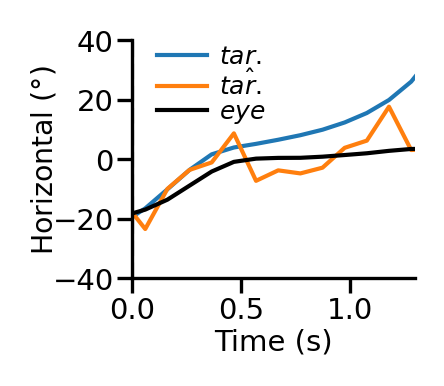

In [124]:
trial_idx = 276
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1.1
yticks = np.linspace(-40, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.4
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
#ydata3 = np.sqrt(decoder_predicted_data[trial_mask][tmask, 4]**2 + decoder_predicted_data[trial_mask][tmask, 5]**2)
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize-0.2)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 1.3)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.26, 0.5)
ax.tick_params(axis='both', which='major', pad=1)

tend = -1
ax.plot(interp(xdata)[:tend], interp(ydata2)[:tend], lw=lw, c='C0', label='$tar.$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata4)[:tend] - 0, lw=lw, c='C1', label='$\hat{tar.}$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata1)[:tend] - 0, lw=lw, c='k', label='$eye$', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1, frameon=False, 
          loc=[0.05, 0.6], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
#ax.text(0.02, 35, 'target\noff', fontsize=fontsize-1.5, c='gray')

fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
#plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example_hor'), orientation='landscape', format='pdf', 
#            transparent=True)

##### 

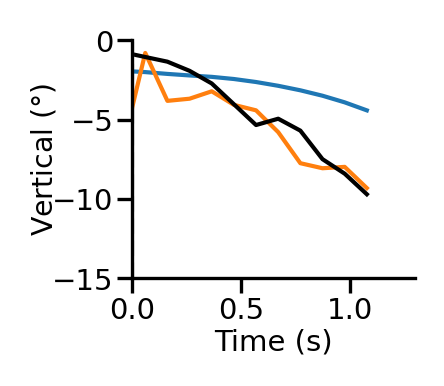

In [69]:
trial_idx = 229
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1.1
yticks = np.linspace(-15, 0, 4)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.4
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 5]
ydata2 = tracking_data[trial_mask][tmask, 6]
#ydata3 = np.sqrt(decoder_predicted_data[trial_mask][tmask, 4]**2 + decoder_predicted_data[trial_mask][tmask, 5]**2)
ydata4 = decoder_predicted_data[trial_mask][tmask, 7]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Vertical ($\degree$)', fontsize=fontsize-0.2)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 1.3)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.26, 0.5)
ax.tick_params(axis='both', which='major', pad=1)

tend = -8
ax.plot(interp(xdata)[:tend], interp(ydata2)[:tend], lw=lw, c='C0', label='$tar.$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata4)[:tend]-1, lw=lw, c='C1', label='$\hat{tar.}$', alpha=1)
ax.plot(interp(xdata)[:tend], interp(ydata1)[:tend]-1, lw=lw, c='k', label='$eye$', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

#ax.legend(fontsize=fontsize-2, frameon=False, 
#          loc=[0.05, 0], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
#ax.text(0.02, 35, 'target\noff', fontsize=fontsize-1.5, c='gray')

fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='trial_example_ver'), orientation='landscape', format='pdf', 
            transparent=True)

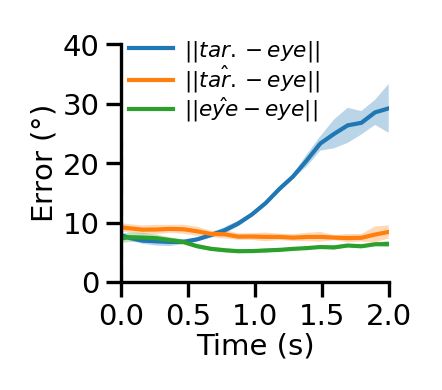

In [71]:
area = 'PPC'
width = 1.3; height = 1.1
yticks = np.linspace(0, 40, 5)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT + 0.051 - 0.4
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_ideal_ver']**2 + sess_v[t]['hor_vs_ideal_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean1 = ydata1.mean(axis=0)[tmask]
ystd1 = ydata1.std(axis=0)[tmask]

ydata2 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_tardist']**2 + sess_v[t]['hor_vs_decode_tarang']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean2 = ydata2.mean(axis=0)[tmask]
ystd2 = ydata2.std(axis=0)[tmask]

ydata3 = np.array([[np.nanmean(np.sqrt(sess_v[t]['ver_vs_decode_ver']**2 + sess_v[t]['hor_vs_decode_hor']**2))
                    for t in range(t_total)] for sess_v in error_data[area].values()])
ymean3 = ydata3.mean(axis=0)[tmask]
ystd3 = ydata3.std(axis=0)[tmask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_title('Horizontal', fontsize=fontsize, fontweight='bold', pad=3)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Error ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(0, 2)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.21)
ax.yaxis.set_label_coords(-0.23, 0.5)
ax.tick_params(axis='both', which='major', pad=1.5)

ax.plot(xdata, ymean1, lw=lw, c='C0', label='$||tar.-eye||$', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='$||\hat{tar.}-eye||$', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='$||\hat{eye}-eye||$', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim()) * 0.6), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-1.8, frameon=False, 
          loc=[0, 0.63], handletextpad=0.5, labelspacing=0, ncol=1, columnspacing=0)
#ax.text(0.02, 15, 'target\noff', fontsize=fontsize-1.5, c='gray')
    
fig.tight_layout(pad=0, rect=[0., 0, 1., 1])
plt.savefig(figure_path / '{name}.pdf'.format(name='error_over_time_both'), orientation='landscape', format='pdf', 
            transparent=True)

In [13]:
def interp(arr):
    means = (arr[:-1] + arr[1:]) / 2

    # Create an array of zeros to hold the interpolated values
    interpolated = np.zeros((len(arr) - 1) * 2 + 1)

    # Insert the original values and interpolated values
    interpolated[::2] = arr
    interpolated[1::2] = means
    
    return interpolated

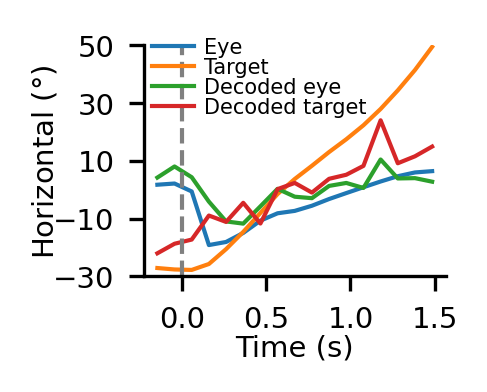

In [259]:
trial_idx = 76
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(-30, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0., 0.65], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

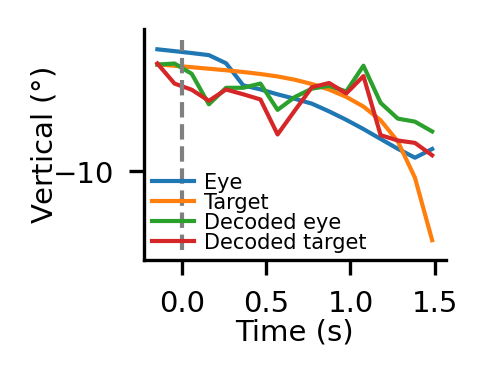

In [346]:
trial_idx = 43
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 5]
ydata2 = tracking_data[trial_mask][tmask, 6]
ydata3 = decoder_predicted_data[trial_mask][tmask, 5]
ydata4 = decoder_predicted_data[trial_mask][tmask, 7]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Vertical ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(-50, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0, 0], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

In [ ]:
trial_idx = 76
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(-30, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0., 0.65], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

# m44

In [113]:
m44[f'PPCtracking_error_trial'].keys()

dict_keys(['m44s174', 'm44s175', 'm44s183', 'm44s185', 'm44s188', 'm44s203', 'm44s206', 'm44s207', 'm44s208', 'm44s209', 'm44s217'])

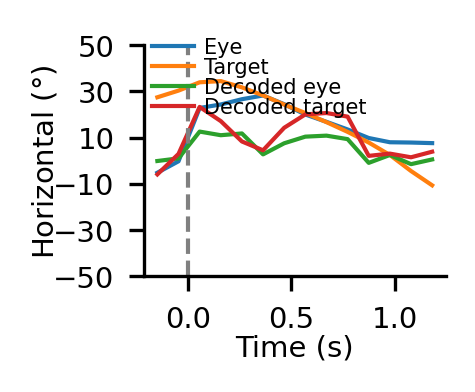

In [140]:
trial_idx = 133
tracking_data = m44[f'PPCtracking_error_trial']['m44s174']
decoder_true_data = m44[f'PPCdecoding_error_trial']['m44s174'][3]
decoder_predicted_data = m44[f'PPCdecoding_error_trial']['m44s174'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(-50, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0., 0.65], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

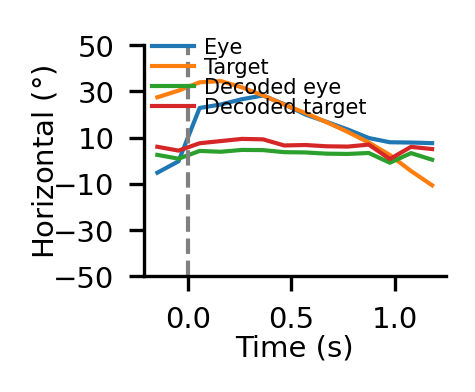

In [141]:
tracking_data = m44[f'MSTtracking_error_trial']['m44s174']
decoder_true_data = m44[f'MSTdecoding_error_trial']['m44s174'][3]
decoder_predicted_data = m44[f'MSTdecoding_error_trial']['m44s174'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(-50, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0., 0.65], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

# m53

In [64]:
m53[f'PPCtracking_error_trial'].keys()

dict_keys(['m53s105', 'm53s113', 'm53s115', 'm53s124', 'm53s127', 'm53s91', 'm53s93', 'm53s97'])

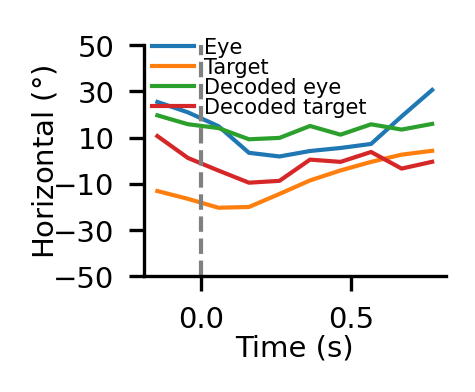

In [122]:
trial_idx = 228
tracking_data = m53[f'PPCtracking_error_trial']['m53s105']
decoder_true_data = m53[f'PPCdecoding_error_trial']['m53s105'][3]
decoder_predicted_data = m53[f'PPCdecoding_error_trial']['m53s105'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(-50, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0., 0.65], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

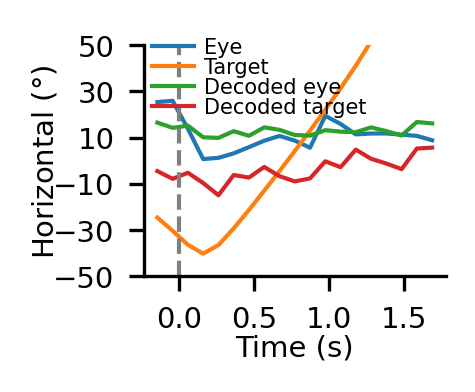

In [107]:
tracking_data = m53[f'PFCtracking_error_trial']['m53s105']
decoder_true_data = m53[f'PFCdecoding_error_trial']['m53s105'][3]
decoder_predicted_data = m53[f'PFCdecoding_error_trial']['m53s105'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(tracking_data[trial_mask][:, 2].size) * DT + 0.051 - 0.3
tmask = xdata > -0.2; xdata = xdata[tmask]
ydata1 = tracking_data[trial_mask][tmask, 2]
ydata2 = tracking_data[trial_mask][tmask, 3]
ydata3 = decoder_predicted_data[trial_mask][tmask, 4]
ydata4 = decoder_predicted_data[trial_mask][tmask, 6]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(-50, yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='Target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded eye', alpha=1)
ax.plot(xdata, ydata4, lw=lw, c='C3', label='Decoded target', alpha=1)

ax.plot(np.linspace(0, 0), np.linspace(*np.array(ax.get_ylim())), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0., 0.65], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

In [21]:
correlation_data = {}
for area in ['PPC']:
    correlation_data_t = {}
    for start_idx in range(t_total):
        end_idx = start_idx + 1
        eye_positions_hor = []; eye_positions_ideal_hor = []; tracking_errors_hor = []
        eye_positions_ver = []; eye_positions_ideal_ver = []; tracking_errors_ver = []
        eye_positions = []; eye_positions_ideal = []
        true_reldist = []; decode_reldist = []; decoding_errors_reldist = []; decoding_errors_reldist_sign = []
        true_relang = []; decode_relang = []; decoding_errors_relang = []
        true_relpositions = []; decode_relpositions = []
        steering_errors = []
        
        for key in eval(m)[f'{area}tracking_error_trial'].keys():  # loop sessions
        #for key in ['m44s174']:
            tracking_data = eval(m)[f'{area}tracking_error_trial'][key]
            decoder_true_data = eval(m)[f'{area}decoding_error_trial'][key][3]
            decoder_predicted_data = eval(m)[f'{area}decoding_error_trial'][key][2]
            decoding_error_data = decoder_predicted_data - decoder_true_data
            steer_error_data = eval(m)[key + 'error_sign']

            trial_idces = np.unique(tracking_data[:, 0]).astype(int)
            for trial_idx in trial_idces:
                if abs(steer_error_data[trial_idx]) > 150:  # not include overshoot trials
                    continue

                trial_mask = tracking_data[:, 0] == trial_idx
                target_angle = eval(m)[key + 'target_angle'][trial_idx]
                target_distance = eval(m)[key + 'target_distance'][trial_idx]

                #if not (target_angle > 30 and target_angle < 40 and target_distance > 200 and target_distance < 300):
                #if not (target_angle > -10 and target_angle < 10):
                #if not (target_distance > 100 and target_distance < 200):
                #    continue

                true_reldist.append(decoder_true_data[trial_mask][start_idx:end_idx, 9])
                decode_reldist.append(decoder_predicted_data[trial_mask][start_idx:end_idx, 9])
                decoding_errors_reldist.append(decoding_error_data[trial_mask][start_idx:end_idx, 9])

                true_relang.append(decoder_true_data[trial_mask][start_idx:end_idx, 8])
                decode_relang.append(decoder_predicted_data[trial_mask][start_idx:end_idx, 8])
                decoding_errors_relang.append(decoding_error_data[trial_mask][start_idx:end_idx, 8])

                true_relpositions.append(np.sqrt(decoder_true_data[trial_mask][start_idx:end_idx, 8]**2 + 
                                                            decoder_true_data[trial_mask][start_idx:end_idx, 9]**2))
                decode_relpositions.append(np.sqrt(decoder_predicted_data[trial_mask][start_idx:end_idx, 8]**2 + 
                                                              decoder_predicted_data[trial_mask][start_idx:end_idx, 9]**2))


                eye_positions_hor.append(tracking_data[trial_mask][start_idx:end_idx, 2])
                eye_positions_ideal_hor.append(tracking_data[trial_mask][start_idx:end_idx, 3])
                tracking_errors_hor.append(tracking_data[trial_mask][start_idx:end_idx, 4])
                eye_positions_ver.append(tracking_data[trial_mask][start_idx:end_idx, 5])
                eye_positions_ideal_ver.append(tracking_data[trial_mask][start_idx:end_idx, 6])
                tracking_errors_ver.append(tracking_data[trial_mask][start_idx:end_idx, 7])
                eye_positions.append(np.sqrt(tracking_data[trial_mask][start_idx:end_idx, 2]**2 + 
                                                        tracking_data[trial_mask][start_idx:end_idx, 5]**2))
                eye_positions_ideal.append(np.sqrt(tracking_data[trial_mask][start_idx:end_idx, 3]**2 + 
                                                              tracking_data[trial_mask][start_idx:end_idx, 6]**2))        

                steering_errors.append(steer_error_data[trial_idx])
   
    
    
    
        correlation_data_t[start_idx] = {'hor_vs_ideal_hor': compute_corr_error(eye_positions_hor, eye_positions_ideal_hor),
                                         'ver_vs_ideal_ver': compute_corr_error(eye_positions_ver, eye_positions_ideal_ver),
                                         'hor_vs_decode_tarang': compute_corr_error(eye_positions_hor, decode_relang),
                                         'ver_vs_decode_tardist': compute_corr_error(eye_positions_ver, decode_reldist)}
    correlation_data[area] = correlation_data_t

In [112]:
trial_idx = 76
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-50, 50, 6)
xticks = np.linspace(0, 2, 5)
ydata1 = tracking_data[trial_mask][:, 2]
ydata2 = decoder_true_data[trial_mask][:, 8]
ydata3 = decoder_predicted_data[trial_mask][:, 8]
xdata = np.arange(ydata1.size) * DT + 0.051

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Horizontal ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye position', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='True target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded target', alpha=1)

ax.plot(np.linspace(0.3, 0.3), np.linspace(*ax.get_ylim()), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

IndexError: index 8 is out of bounds for axis 1 with size 8

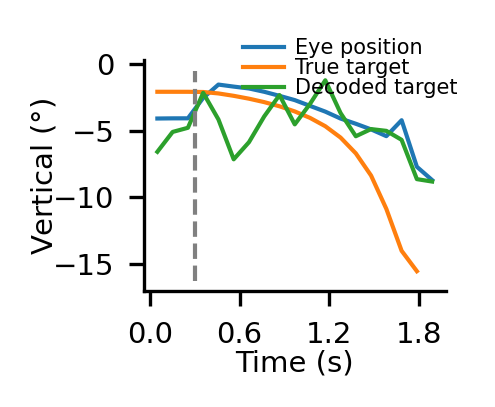

In [203]:
trial_idx = 11
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-15, 0, 4)
xticks = np.linspace(0, 1.8, 4)
ydata1 = tracking_data[trial_mask][:, 5]
ydata2 = decoder_true_data[trial_mask][:, 9]
ydata3 = decoder_predicted_data[trial_mask][:, 9]
xdata = np.arange(ydata1.size) * DT + 0.051

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Vertical ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye position', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='True target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded target', alpha=1)

ax.plot(np.linspace(0.3, 0.3), np.linspace(*ax.get_ylim()), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

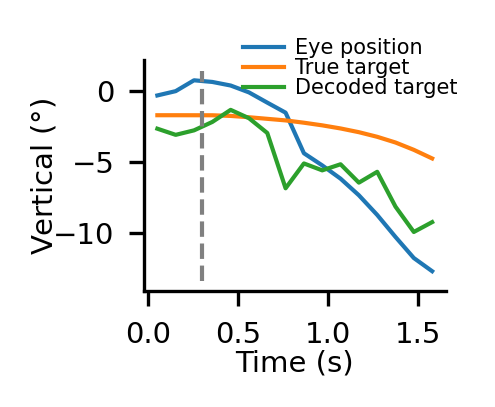

In [200]:
trial_idx = 24
tracking_data = m51[f'PPCtracking_error_trial']['m51s43']
decoder_true_data = m51[f'PPCdecoding_error_trial']['m51s43'][3]
decoder_predicted_data = m51[f'PPCdecoding_error_trial']['m51s43'][2]
trial_mask = tracking_data[:, 0] == trial_idx

width = 1.3; height = 1
yticks = np.linspace(-10, 0, 3)
xticks = np.linspace(0, 1.5, 4)
ydata1 = tracking_data[trial_mask][:, 5]
ydata2 = decoder_true_data[trial_mask][:, 9]
ydata3 = decoder_predicted_data[trial_mask][:, 9]
xdata = np.arange(ydata1.size) * DT + 0.051

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Vertical ($\degree$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.28, 0.5)

ax.plot(xdata, ydata1, lw=lw, c='C0', label='Eye position', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C1', label='True target', alpha=1)
ax.plot(xdata, ydata3, lw=lw, c='C2', label='Decoded target', alpha=1)

ax.plot(np.linspace(0.3, 0.3), np.linspace(*ax.get_ylim()), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

In [50]:
correlation_data = {}
for area in ['PPC']:
    correlation_data_session = {}
    for key in eval(m)[f'{area}tracking_error_trial'].keys():  # loop sessions
        tracking_data = eval(m)[f'{area}tracking_error_trial'][key]
        decoder_true_data = eval(m)[f'{area}decoding_error_trial'][key][3]
        decoder_predicted_data = eval(m)[f'{area}decoding_error_trial'][key][2]
        decoding_error_data = decoder_predicted_data - decoder_true_data
        steer_error_data = eval(m)[key + 'error_sign']
        
        correlation_data_trial = {'true_reldist': []}
        t_idces = np.unique(tracking_data[:, 1]).astype(int)
        for t_idx in t_idces:
            t_mask = tracking_data[:, 1] == t_idx
            
            true_trial_dist = decoder_true_data[t_mask][:, 9]
            predicted_trial_dist = decoder_predicted_data[t_mask][:, 9]
            
            true_trial_ang = decoder_true_data[t_mask][:, 8]
            predicted_trial_ang = decoder_predicted_data[t_mask][:, 8]
            
            eye_positions_hor_trial = tracking_data[t_mask][:, 2]
            eye_positions_ideal_hor_trial = tracking_data[t_mask][:, 3]
            
            for start_idx in range(t_total):
                end_idx = start_idx + 1
                

In [57]:
eye_positions_hor_trial

array([ 3.64649283,  0.73317169, -2.06079932,  4.97222561, -3.63385323,
        4.25602725,  4.94841887,  5.79328947,  1.71103303,  4.55981235,
        0.98607002, -3.48316103,  6.44691094, 10.99535275,  9.40126183,
        1.6600644 ,  0.12173583,  3.28350307,  4.06113733,  2.65874478,
        8.14191787,  3.63127888, -1.11113342,  4.31467181,  6.1135356 ,
       -0.47927703,  8.85022309,  0.01823194,  4.2775847 ,  6.59901355,
       11.11901379,  9.92078725,  5.29491747, -5.74355069,  1.39771617,
        0.05080866, -1.08166459, -1.47249639])

In [56]:
predicted_trial_ang

array([ 0.26708069,  8.87783068, 13.09552062,  3.18059346, 20.23389781,
       15.63074536,  4.4238605 ,  8.13047369, 11.8675687 , 14.19010448,
        5.43330262, -1.32928178, 12.15823753, 15.72045485, -5.15995759,
        9.60610645,  3.9890505 ,  3.91397882, 13.53396842,  6.49596982,
        4.29982544, 16.15618863, 32.72885422,  5.85724995,  7.96820209,
        2.28505206, -1.01547989,  1.7082713 , 16.78763764,  8.03231944,
        2.23820288, 10.07805989, 25.47764278,  1.14267295,  6.39473428,
       25.0169402 ,  1.40238794, 12.30561005])

In [47]:
decoder_true_data.shape

(19003, 10)

In [45]:
np.unique(tracking_data[:, 1]).astype(int)

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23])

In [41]:
true_trial_dist

array([-1.63238064, -1.7101408 , -1.80096421, -1.90155429, -2.01337405,
       -2.13700624, -2.28451188, -2.45293744, -2.65723743, -2.89928351,
       -3.17984374, -3.51931241, -3.93958991, -4.47703187, -5.18568622,
       -6.13652666, -7.27482292])

In [39]:
decoder_true_data[trial_mask].shape

(17, 10)

In [26]:
len(steer_error_data)

1502

In [ ]:
correlation_data = {}
for area in ['PPC']:
    correlation_data_session = {}
    for key in eval(m)[f'{area}tracking_error_trial'].keys():  # loop sessions
        tracking_data = eval(m)[f'{area}tracking_error_trial'][key]
        decoder_true_data = eval(m)[f'{area}decoding_error_trial'][key][3]
        decoder_predicted_data = eval(m)[f'{area}decoding_error_trial'][key][2]
        decoding_error_data = decoder_predicted_data - decoder_true_data
        steer_error_data = eval(m)[key + 'error_sign']

        correlation_data_trial = {'true_reldist': []}
        trial_idces = np.unique(tracking_data[:, 0]).astype(int)
        for trial_idx in trial_idces:
            if abs(steer_error_data[trial_idx]) > 150:  # not include overshoot trials
                continue

            trial_mask = tracking_data[:, 0] == trial_idx
            target_angle = eval(m)[key + 'target_angle'][trial_idx]
            target_distance = eval(m)[key + 'target_distance'][trial_idx]

            #if not (target_angle > 30 and target_angle < 40 and target_distance > 200 and target_distance < 300):
            #if not (target_angle > -10 and target_angle < 10):
            #if not (target_distance > 100 and target_distance < 200):
            #    continue
            
            for start_idx in range(t_total):
                end_idx = start_idx + 1
                correlation_data_trial['true_reldist']
                true_reldist[start_idx].append(decoder_true_data[trial_mask][start_idx:end_idx, 9])
                decode_reldist[start_idx].append(decoder_predicted_data[trial_mask][start_idx:end_idx, 9])
                decoding_errors_reldist[start_idx].append(decoding_error_data[trial_mask][start_idx:end_idx, 9])

                true_relang[start_idx].append(decoder_true_data[trial_mask][start_idx:end_idx, 8])
                decode_relang[start_idx].append(decoder_predicted_data[trial_mask][start_idx:end_idx, 8])
                decoding_errors_relang[start_idx].append(decoding_error_data[trial_mask][start_idx:end_idx, 8])

                true_relpositions[start_idx].append(np.sqrt(decoder_true_data[trial_mask][start_idx:end_idx, 8]**2 + 
                                                            decoder_true_data[trial_mask][start_idx:end_idx, 9]**2))
                decode_relpositions[start_idx].append(np.sqrt(decoder_predicted_data[trial_mask][start_idx:end_idx, 8]**2 + 
                                                              decoder_predicted_data[trial_mask][start_idx:end_idx, 9]**2))


                eye_positions_hor[start_idx].append(tracking_data[trial_mask][start_idx:end_idx, 2])
                eye_positions_ideal_hor[start_idx].append(tracking_data[trial_mask][start_idx:end_idx, 3])
                tracking_errors_hor[start_idx].append(tracking_data[trial_mask][start_idx:end_idx, 4])
                eye_positions_ver[start_idx].append(tracking_data[trial_mask][start_idx:end_idx, 5])
                eye_positions_ideal_ver[start_idx].append(tracking_data[trial_mask][start_idx:end_idx, 6])
                tracking_errors_ver[start_idx].append(tracking_data[trial_mask][start_idx:end_idx, 7])
                eye_positions[start_idx].append(np.sqrt(tracking_data[trial_mask][start_idx:end_idx, 2]**2 + 
                                                        tracking_data[trial_mask][start_idx:end_idx, 5]**2))
                eye_positions_ideal[start_idx].append(np.sqrt(tracking_data[trial_mask][start_idx:end_idx, 3]**2 + 
                                                              tracking_data[trial_mask][start_idx:end_idx, 6]**2))        

            steering_errors.append(steer_error_data[trial_idx])




    correlation_data_t[start_idx] = {'hor_vs_ideal_hor': compute_corr_error(eye_positions_hor, eye_positions_ideal_hor),
                                     'ver_vs_ideal_ver': compute_corr_error(eye_positions_ver, eye_positions_ideal_ver),
                                     'hor_vs_decode_tarang': compute_corr_error(eye_positions_hor, decode_relang),
                                     'ver_vs_decode_tardist': compute_corr_error(eye_positions_ver, decode_reldist)}
correlation_data[area] = correlation_data_t

In [229]:
tracking_data[trial_mask][]

(24, 8)

In [220]:
hor_vs_ideal_hor = []; hor_vs_decode_tarang = []
ver_vs_ideal_ver = []; ver_vs_decode_tardist = []
hor_vs_ideal_hor_error = []; hor_vs_decode_tarang_error = []
ver_vs_ideal_ver_error = []; ver_vs_decode_tardist_error = []
for t in range(t_total):
    hor_vs_ideal_hor.append(correlation_data['PPC'][t]['hor_vs_ideal_hor'][0])
    hor_vs_decode_tarang.append(correlation_data['PPC'][t]['hor_vs_decode_tarang'][0])
    ver_vs_ideal_ver.append(correlation_data['PPC'][t]['ver_vs_ideal_ver'][0])
    ver_vs_decode_tardist.append(correlation_data['PPC'][t]['ver_vs_decode_tardist'][0])
    hor_vs_ideal_hor_error.append(correlation_data['PPC'][t]['hor_vs_ideal_hor'][1])
    hor_vs_decode_tarang_error.append(correlation_data['PPC'][t]['hor_vs_decode_tarang'][1])
    ver_vs_ideal_ver_error.append(correlation_data['PPC'][t]['ver_vs_ideal_ver'][1])
    ver_vs_decode_tardist_error.append(correlation_data['PPC'][t]['ver_vs_decode_tardist'][1])

In [221]:
len(ver_vs_decode_tardist_error[5])

8927

In [222]:
test = []
for a, b in zip(ver_vs_ideal_ver_error, ver_vs_decode_tardist_error):
    test.append(ttest_ind(a, b, equal_var=False).pvalue)

In [224]:
test = []
for a, b in zip(hor_vs_ideal_hor_mae, hor_vs_decode_tarang_mae):
    test.append(ttest_ind(a, b, equal_var=False).pvalue)

(0.0, 0.05)

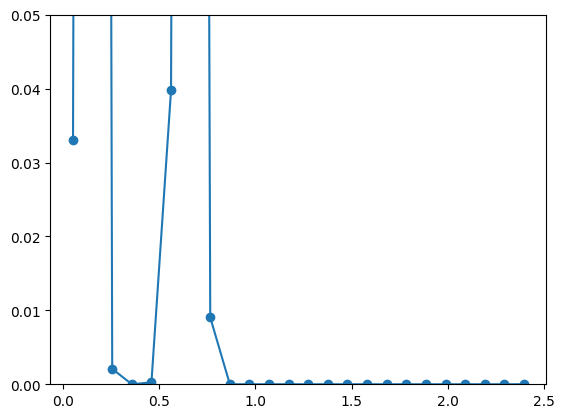

In [225]:
plt.scatter(xdata, test)
plt.plot(xdata, test)
plt.ylim(0, 0.05)

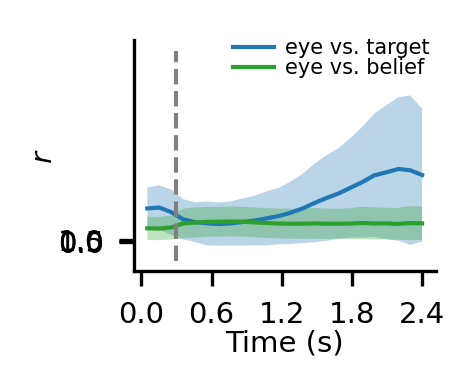

In [226]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2.4, 5)
xdata = np.arange(t_total) * DT + 0.051
ydata1 = np.array([i.mean() for i in hor_vs_ideal_hor_error])
ystd1 = np.array([i.std() for i in hor_vs_ideal_hor_error])
ydata2 = np.array([i.mean() for i in hor_vs_decode_tarang_error])
ystd2 = np.array([i.std() for i in hor_vs_decode_tarang_error])

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 8

ax.plot(xdata, ydata1, lw=lw, c='C0', label='eye vs. target', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C2', label='eye vs. belief', alpha=1)
ax.fill_between(xdata, ydata1 - ystd1, ydata1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ydata2 - ystd2, ydata2 + ystd2, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(-10, 100), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

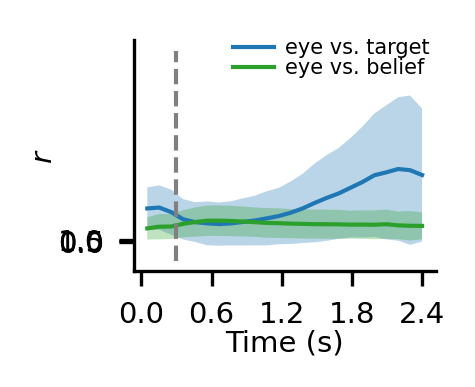

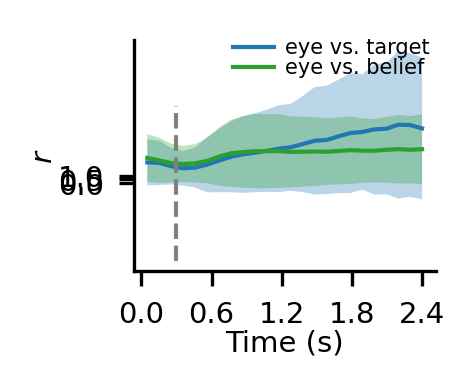

In [202]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2.4, 5)
xdata = np.arange(t_total) * DT + 0.051
ydata1 = np.array([i.mean() for i in ver_vs_ideal_ver_error])
ystd1 = np.array([i.std() for i in ver_vs_ideal_ver_error])
ydata2 = np.array([i.mean() for i in ver_vs_decode_tardist_error])
ystd2 = np.array([i.std() for i in ver_vs_decode_tardist_error])

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 8

ax.plot(xdata, ydata1, lw=lw, c='C0', label='eye vs. target', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C2', label='eye vs. belief', alpha=1)
ax.fill_between(xdata, ydata1 - ystd1, ydata1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ydata2 - ystd2, ydata2 + ystd2, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(-10, 10), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

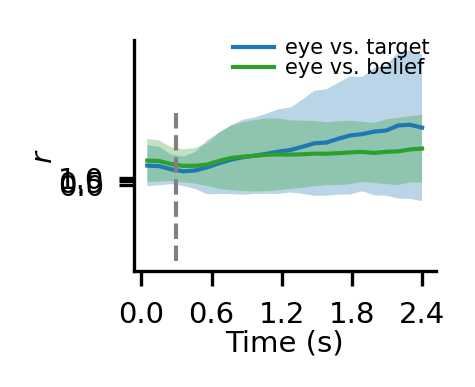

In [227]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2.4, 5)
xdata = np.arange(t_total) * DT + 0.051
ydata1 = np.array([i.mean() for i in ver_vs_ideal_ver_error])
ystd1 = np.array([i.std() for i in ver_vs_ideal_ver_error])
ydata2 = np.array([i.mean() for i in ver_vs_decode_tardist_error])
ystd2 = np.array([i.std() for i in ver_vs_decode_tardist_error])

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 8

ax.plot(xdata, ydata1, lw=lw, c='C0', label='eye vs. target', alpha=1)
ax.plot(xdata, ydata2, lw=lw, c='C2', label='eye vs. belief', alpha=1)
ax.fill_between(xdata, ydata1 - ystd1, ydata1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ydata2 - ystd2, ydata2 + ystd2, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(-10, 10), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

(0.0, 0.05)

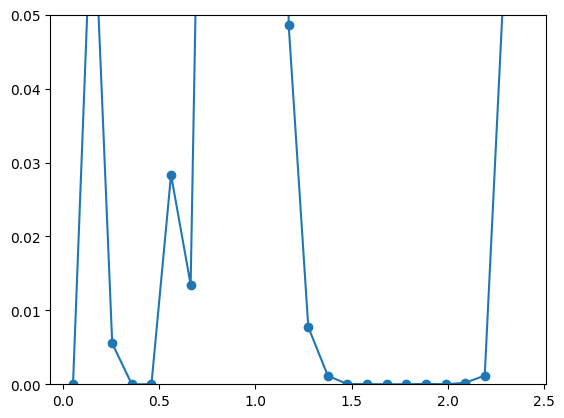

In [173]:
plt.scatter(xdata, test)
plt.plot(xdata, test)
plt.ylim(0, 0.05)

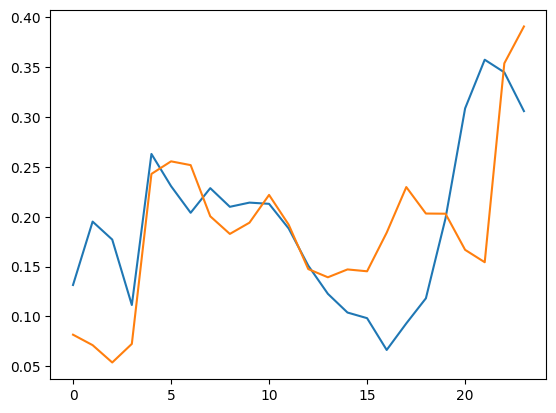

In [129]:
plt.plot(hor_vs_ideal_hor)
plt.plot(hor_vs_decode_tarang)

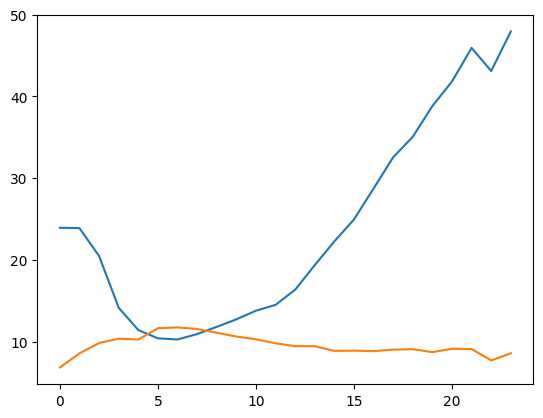

In [130]:
plt.plot(hor_vs_ideal_hor_mae)
plt.plot(hor_vs_decode_tarang_mae)

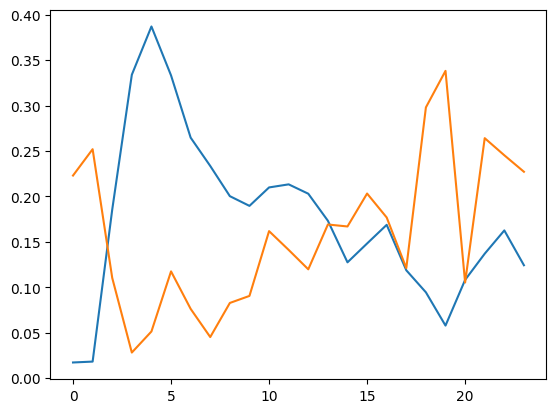

In [131]:
plt.plot(ver_vs_ideal_ver)
plt.plot(ver_vs_decode_tardist)

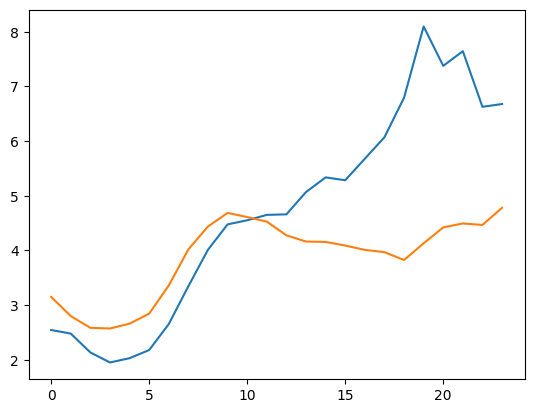

In [132]:
plt.plot(ver_vs_ideal_ver_mae)
plt.plot(ver_vs_decode_tardist_mae)

In [137]:
correlation_data['PPC']

{0: {'hor_vs_ideal_hor': 0.12044939019031296,
  'ver_vs_ideal_ver': 0.10484971056820684,
  'hor_vs_decode_tarang': 0.12546802647392039,
  'ver_vs_decode_tardist': 0.3328521385507035},
 1: {'hor_vs_ideal_hor': 0.2300448946530284,
  'ver_vs_ideal_ver': 0.09775336075428703,
  'hor_vs_decode_tarang': 0.14192487238987941,
  'ver_vs_decode_tardist': 0.22598452451074752},
 2: {'hor_vs_ideal_hor': 0.12276793844638637,
  'ver_vs_ideal_ver': 0.13420081259204075,
  'hor_vs_decode_tarang': 0.15870124509683994,
  'ver_vs_decode_tardist': 0.19310649577068745},
 3: {'hor_vs_ideal_hor': 0.06684360683167523,
  'ver_vs_ideal_ver': 0.3295788467101756,
  'hor_vs_decode_tarang': 0.16718291893176104,
  'ver_vs_decode_tardist': 0.1384953964161547},
 4: {'hor_vs_ideal_hor': 0.0505524290231278,
  'ver_vs_ideal_ver': 0.4757692395091805,
  'hor_vs_decode_tarang': 0.13389279035791102,
  'ver_vs_decode_tardist': 0.2424239976201543},
 5: {'hor_vs_ideal_hor': 0.03651153887675457,
  'ver_vs_ideal_ver': 0.584423867749

In [119]:
correlation_data_t

{'PPC': {'hor_vs_ideal_hor': -0.1744760994221169,
  'ver_vs_ideal_ver': -0.11625577886060486,
  'hor_vs_decode_tarang': 0.365663936080614,
  'ver_vs_decode_tardist': 0.17046784953395458}}

In [124]:
np.sqrt(0.0135)

0.1161895003862225

In [102]:
correlation_data_t

{'PPC': {'hor_vs_ideal_hor': 0.28213680406663766,
  'ver_vs_ideal_ver': 0.45783507281188557,
  'hor_vs_decode_tarang': 0.3450704977706313,
  'ver_vs_decode_tardist': 0.49635525886614174}}

In [93]:
correlation_data_t

{'eye_positions_hor_PPC': array([ -0.33969211,  -0.46196609, -18.5463503 , ...,   3.89282768,
          5.59059384,   6.25714372]),
 'eye_positions_ideal_hor_PPC': array([-35.37682253, -35.23828574, -35.71925062, ...,  43.50670608,
                 nan,          nan]),
 'tracking_errors_hor_PPC': array([ 35.03713042,  34.77631965,  17.17290033, ..., -39.6138784 ,
                 nan,          nan]),
 'eye_positions_ver_PPC': array([ -2.93649351,  -2.89068431,  -2.47867639, ..., -10.91743172,
        -11.87474974, -12.56039827]),
 'eye_positions_ideal_ver_PPC': array([ -3.90822477,  -3.91016973,  -3.9706811 , ..., -44.80156605,
                 nan,          nan]),
 'tracking_errors_ver_PPC': array([ 0.97173126,  1.01948542,  1.49200471, ..., 33.88413433,
                nan,         nan]),
 'eye_positions_PPC': array([ 2.95607592,  2.92736545, 18.71125185, ..., 11.59070415,
        13.12495413, 14.03265664]),
 'eye_positions_ideal_PPC': array([35.59204677, 35.45456542, 35.93927063, ..

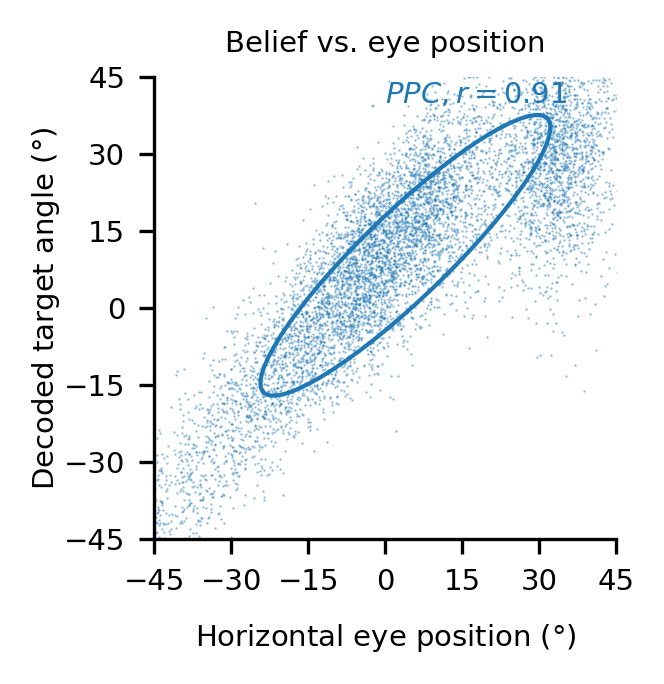

In [79]:
width = 2; height = 2
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = tracking_errors_hor_PPC
ydata1 = decoding_errors_relang_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

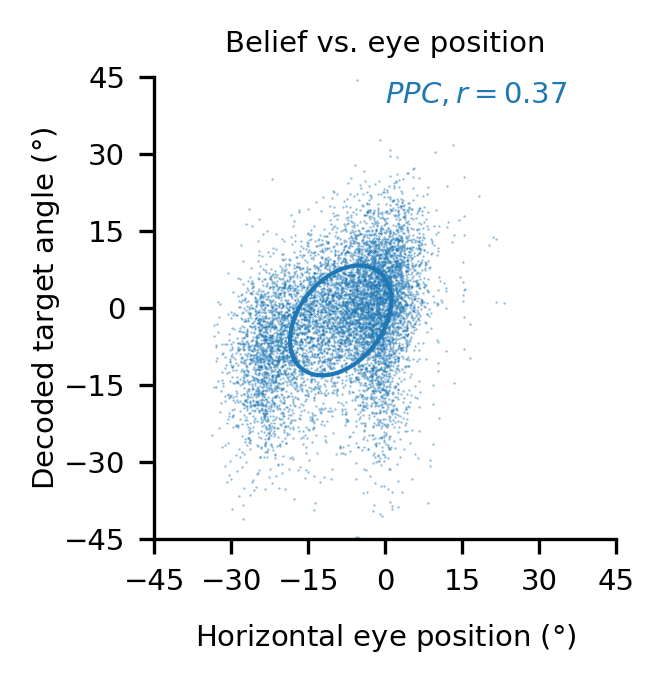

In [83]:
width = 2; height = 2
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_hor_PPC
ydata1 = decode_relang_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

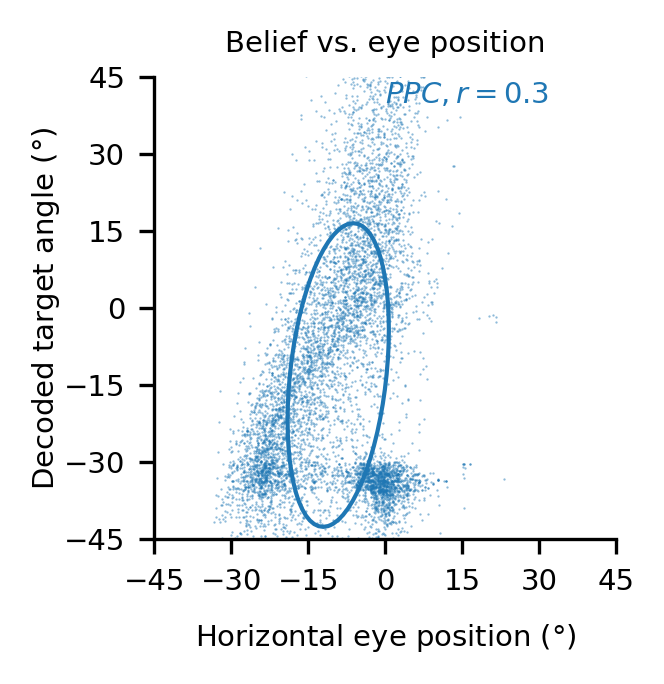

In [81]:
width = 2; height = 2
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_hor_PPC
ydata1 = true_relang_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [84]:
np.mean(abs(xdata1 - ydata1))

10.707487349483001

In [85]:
test = LinearRegression(fit_intercept=True)
test.fit(xdata1.reshape(-1, 1), ydata1)
np.sqrt(test.score(xdata1.reshape(-1, 1), ydata1))
#test.coef_

0.3665995091995763

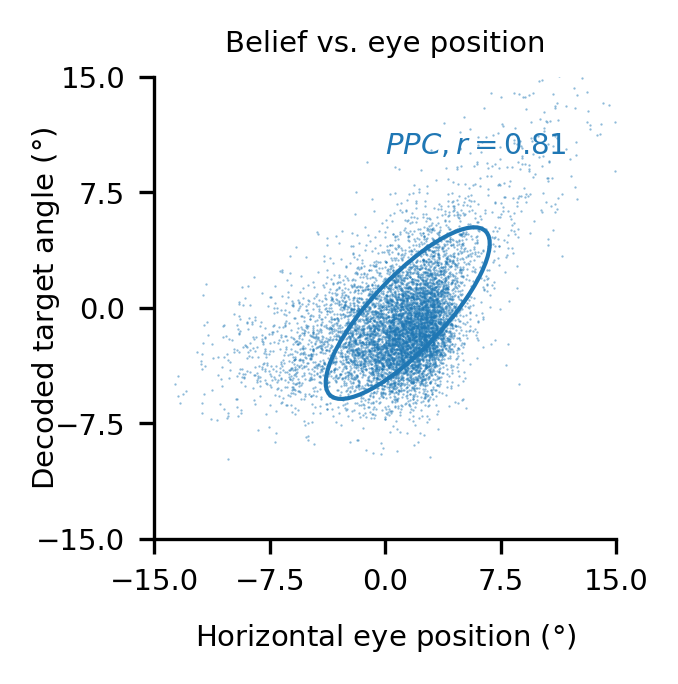

In [86]:
width = 2; height = 2
yticks = np.linspace(-15, 15, 5)
xticks = np.linspace(-15, 15, 5)
xdata1 = tracking_errors_ver_PPC
ydata1 = decoding_errors_reldist_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 10, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

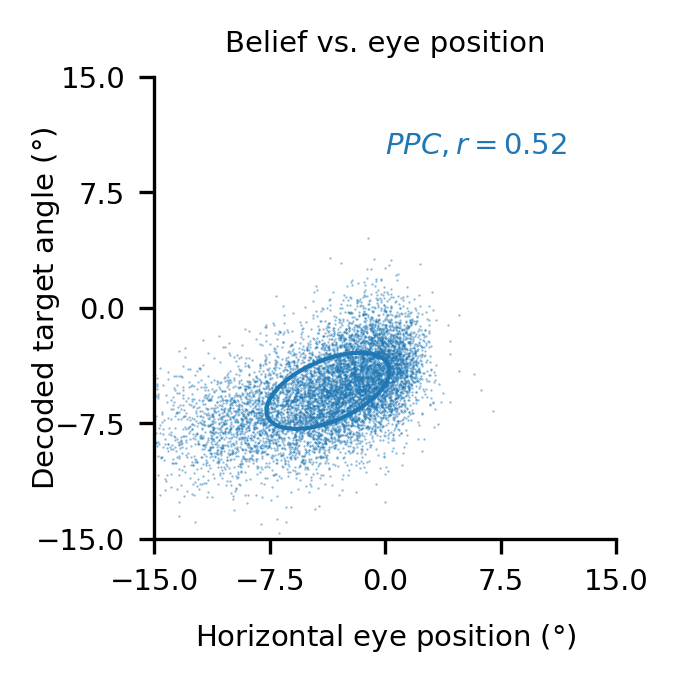

In [90]:
width = 2; height = 2
yticks = np.linspace(-15, 15, 5)
xticks = np.linspace(-15, 15, 5)
xdata1 = eye_positions_ver_PPC
ydata1 = decode_reldist_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 10, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

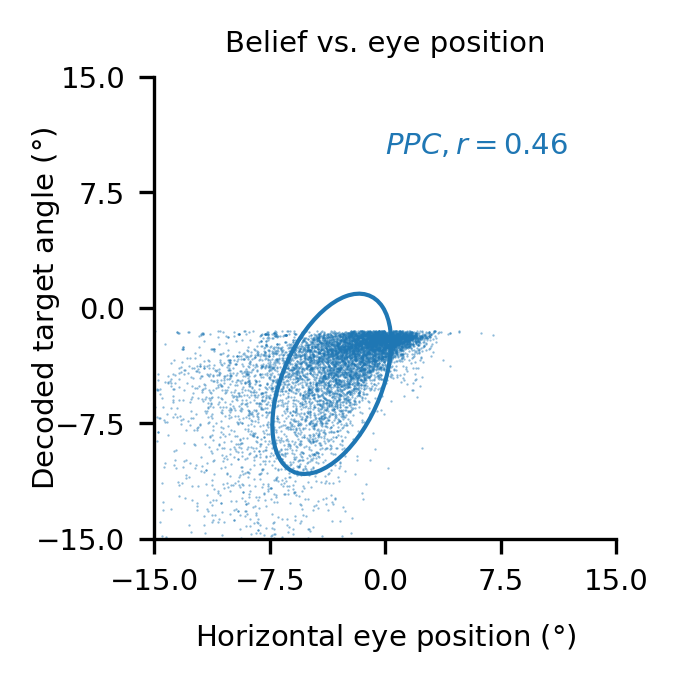

In [88]:
width = 2; height = 2
yticks = np.linspace(-15, 15, 5)
xticks = np.linspace(-15, 15, 5)
xdata1 = eye_positions_ver_PPC
ydata1 = true_reldist_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 10, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [91]:
np.sqrt(np.mean((xdata1 - ydata1)**2))

3.804765731717471

In [400]:
np.mean(abs(xdata1 - ydata1))

3.031114630614876

In [423]:
test = LinearRegression(fit_intercept=True)
test.fit(xdata1.reshape(-1, 1), ydata1)
#np.sqrt(test.score(xdata1.reshape(-1, 1), ydata1))
test.coef_

array([0.13710182])

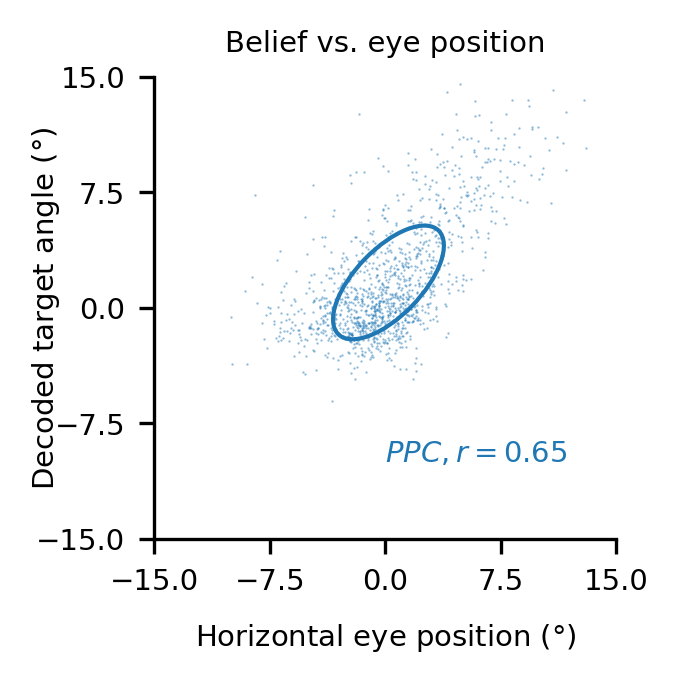

In [174]:
width = 2; height = 2
yticks = np.linspace(-15, 15, 5)
xticks = np.linspace(-15, 15, 5)
xdata1 = tracking_errors_ver_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decoding_errors_reldist_PPC[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, -10, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [176]:
test = LinearRegression(fit_intercept=False)
test.fit(xdata1.reshape(-1, 1), ydata1)
#np.sqrt(test.score(xdata1.reshape(-1, 1), ydata1))
test.coef_

array([0.73679945])

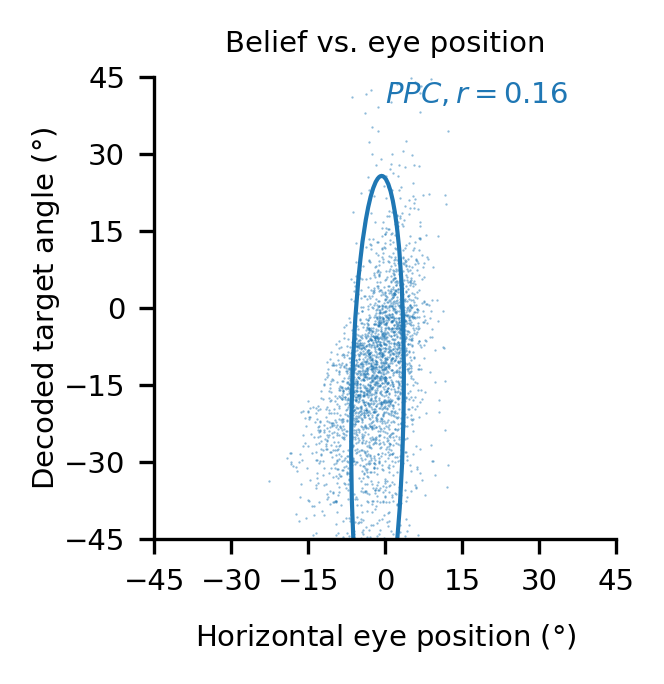

In [113]:
width = 2; height = 2
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_hor_PPC
ydata1 = true_relang_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

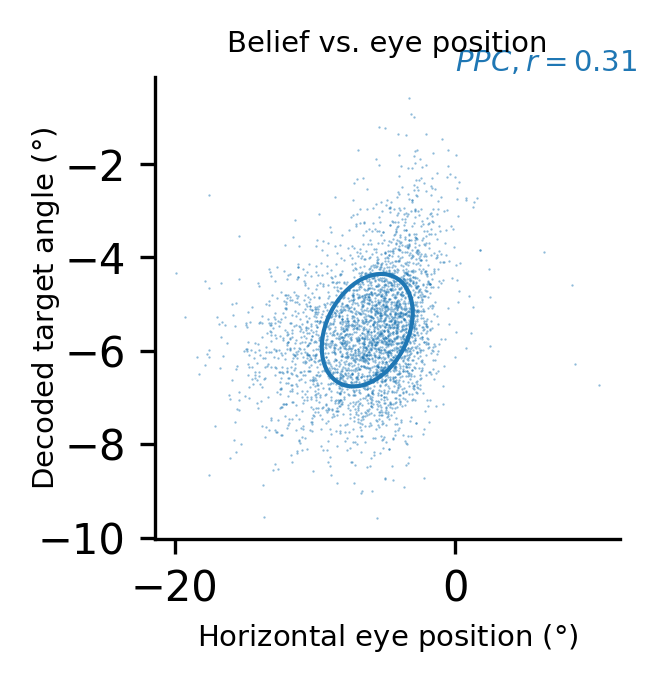

In [119]:
width = 2; height = 2
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_ver_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decode_reldist_PPC[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
#plt.xticks(xticks, fontsize=fontsize)
#plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
#ax.set_xlim(-10, 0)
#ax.set_ylim(-10, 0)
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 0, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

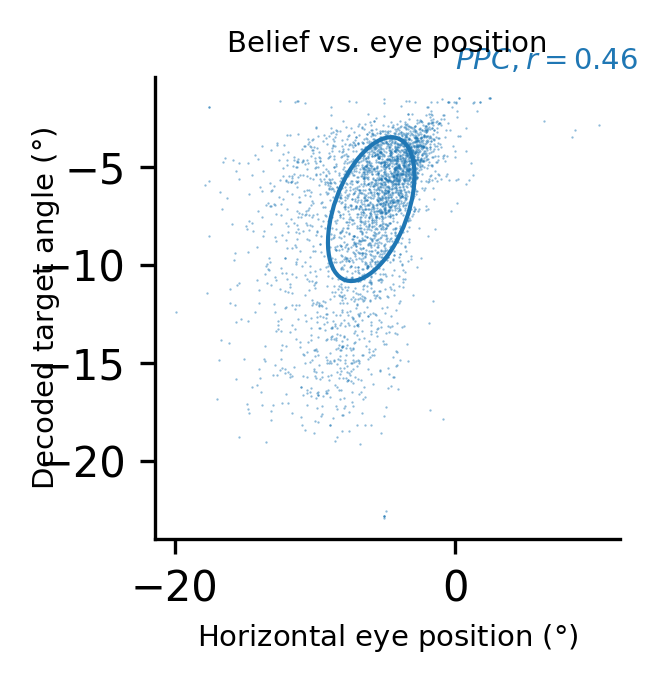

In [117]:
width = 2; height = 2
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_ver_PPC
ydata1 = true_reldist_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
#ax.set_aspect('equal')
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
#plt.xticks(xticks, fontsize=fontsize)
#plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
#ax.set_xlim(-10, 0)
#ax.set_ylim(-10, 0)
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 0, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [130]:
test = LinearRegression(fit_intercept=False)
test.fit(xdata1.reshape(-1, 1), ydata1)
#np.sqrt(test.score(xdata1.reshape(-1, 1), ydata1))
test.coef_

array([1.01472563])

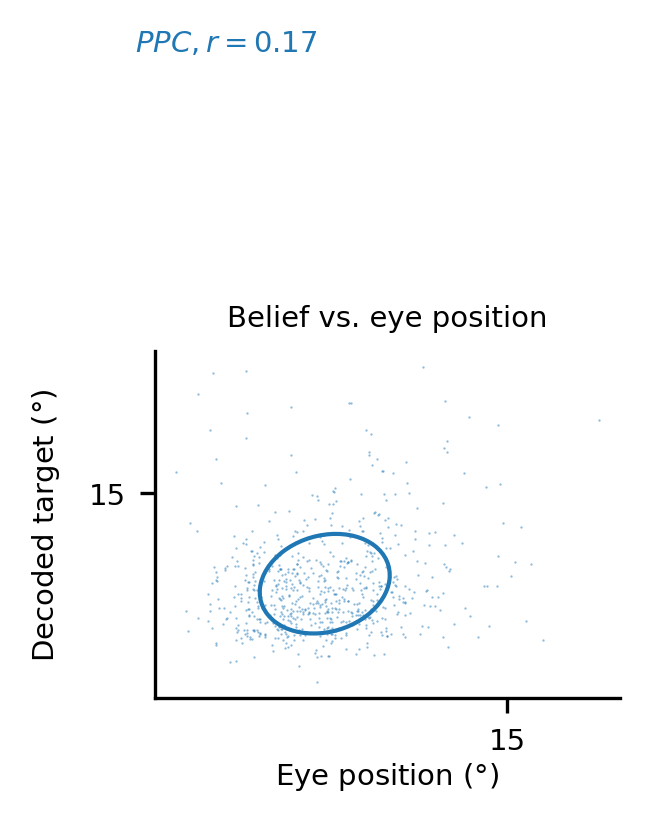

In [77]:
width = 2; height = 1.5
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decode_relpositions_PPC[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target ($\degree$)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

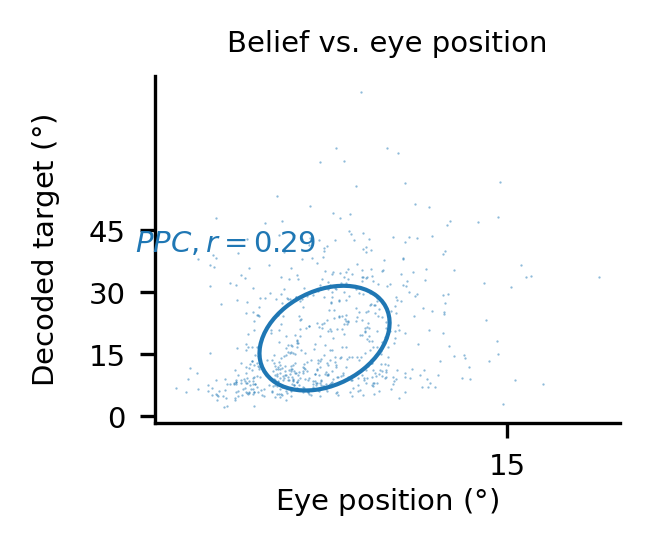

In [79]:
width = 2; height = 1.5
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = eye_positions_PPC
ydata1 = true_relpositions_PPC
mask1 = np.isnan(xdata1) | np.isnan(ydata1)
xdata1 = xdata1[~mask1]
ydata1 = ydata1[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target ($\degree$)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

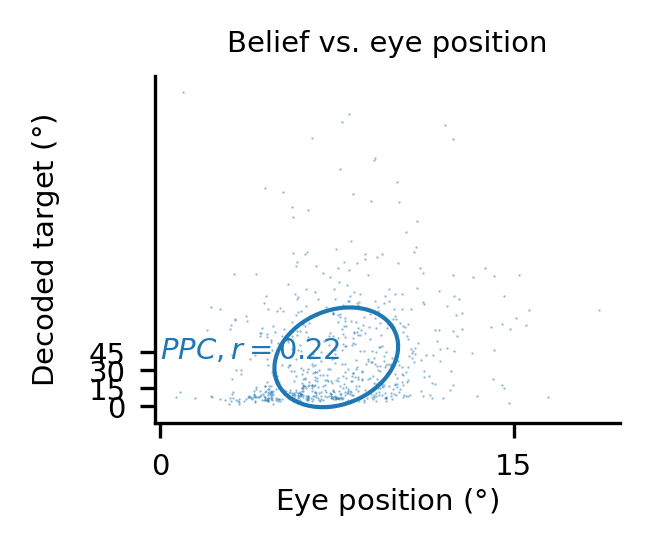

In [81]:
width = 2; height = 1.5
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = np.sqrt(eye_positions_hor_PPC**2 + eye_positions_ver_PPC**2)
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = np.sqrt(true_reldist_PPC**2 + true_relang_PPC**2)[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target ($\degree$)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [305]:
test = LinearRegression(fit_intercept=False)
test.fit(xdata1.reshape(-1, 1), ydata1)
#np.sqrt(test.score(xdata1.reshape(-1, 1), ydata1))
test.coef_

array([1.44328667])

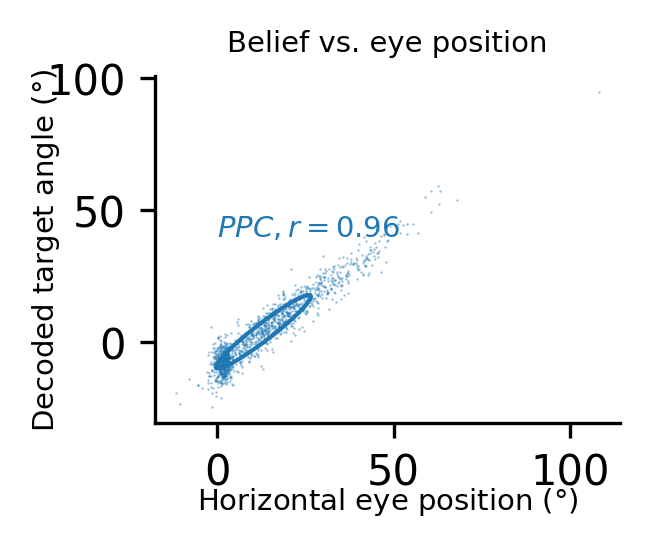

In [75]:
width = 2; height = 1.5
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = tracking_errors_ver_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decoding_errors_reldist_PPC[~mask1]

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
#plt.xticks(xticks, fontsize=fontsize)
#plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
#ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.5)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [41]:
r2_score(xdata1, ydata1)

-3580.1133243783333

In [40]:
from sklearn.metrics import 

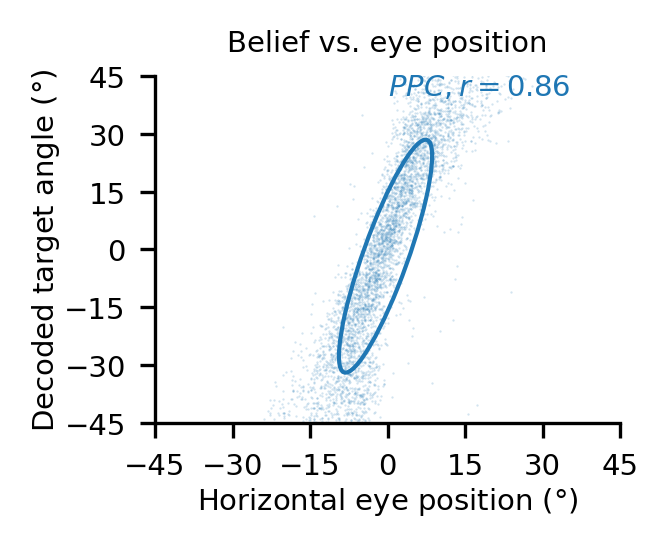

In [73]:
width = 2; height = 1.5
yticks = np.linspace(-45, 45, 7)
xticks = np.linspace(-45, 45, 7)
xdata1 = -eye_positions_hor_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decode_relang_PPC[~mask1] - 90

#xdata2 = tracking_errors_hor_MST
#mask2 = np.isnan(xdata2)
#xdata2 = xdata2[~mask2]
#ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Belief vs. eye position', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal eye position ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoded target angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.2)
ax.text(0, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

#ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
#ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
#        c='C1', fontsize=fontsize)
#confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

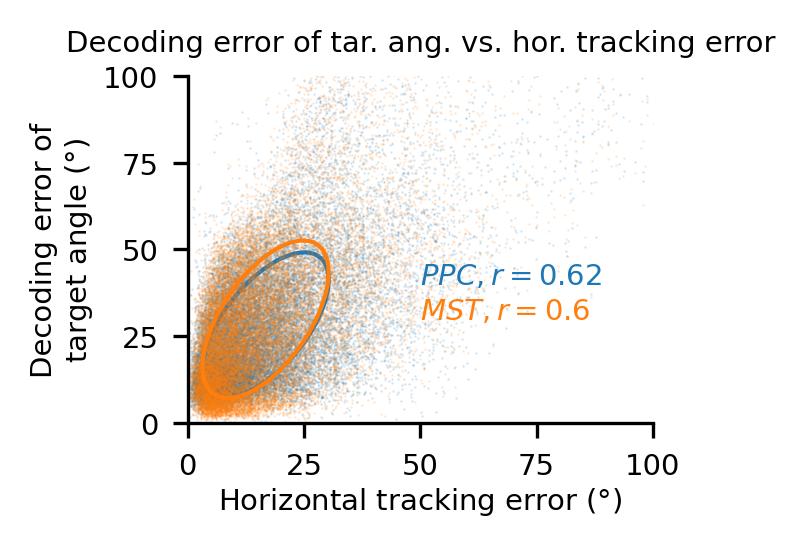

In [29]:
width = 2; height = 1.5
yticks = np.linspace(0, 100, 5)
xticks = np.linspace(0, 100, 5)
xdata1 = tracking_errors_hor_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decoding_errors_relang_PPC[~mask1]

xdata2 = tracking_errors_hor_MST
mask2 = np.isnan(xdata2)
xdata2 = xdata2[~mask2]
ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. ang. vs. hor. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.2)
ax.text(50, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
        c='C1', fontsize=fontsize)
confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

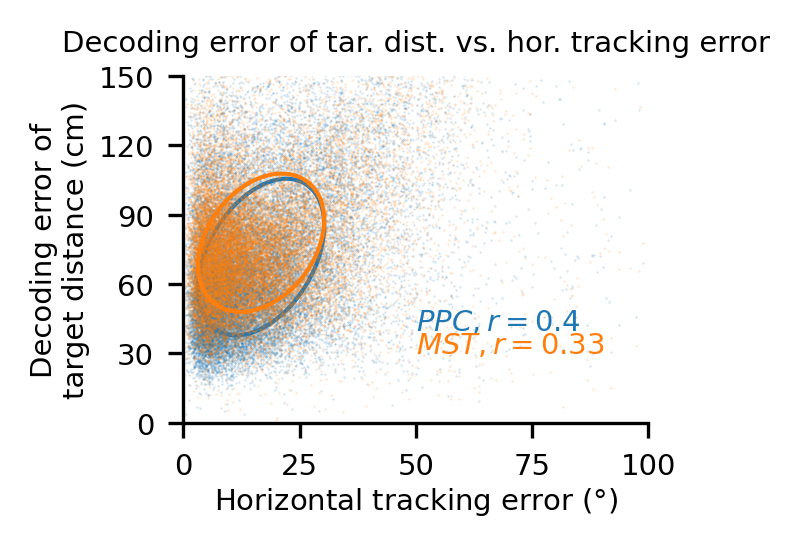

In [31]:
width = 2; height = 1.5
yticks = np.linspace(0, 150, 6)
xticks = np.linspace(0, 100, 5)
xdata1 = tracking_errors_hor_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decoding_errors_reldist_PPC[~mask1]

xdata2 = tracking_errors_hor_MST
mask2 = np.isnan(xdata2)
xdata2 = xdata2[~mask2]
ydata2 = decoding_errors_reldist_MST[~mask2]

#xdata3 = tracking_errors_hor_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_reldist_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. dist. vs. hor. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.2)
ax.text(50, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
ax.text(50, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
        c='C1', fontsize=fontsize)
confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(50, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

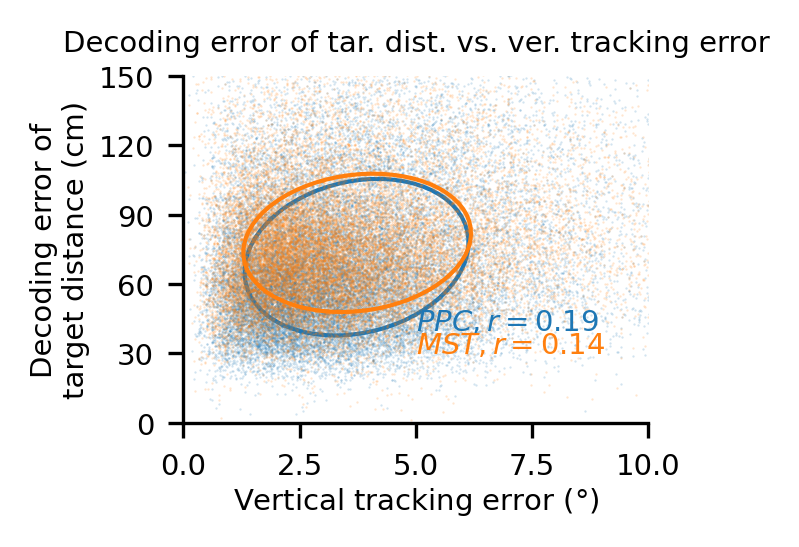

In [33]:
width = 2; height = 1.5
yticks = np.linspace(0, 150, 6)
xticks = np.linspace(0, 10, 5)
xdata1 = tracking_errors_ver_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decoding_errors_reldist_PPC[~mask1]

xdata2 = tracking_errors_ver_MST
mask2 = np.isnan(xdata2)
xdata2 = xdata2[~mask2]
ydata2 = decoding_errors_reldist_MST[~mask2]

#xdata3 = tracking_errors_ver_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_reldist_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. dist. vs. ver. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Vertical tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.2)
ax.text(5, 40, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
ax.text(5, 30, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
        c='C1', fontsize=fontsize)
confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(5, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

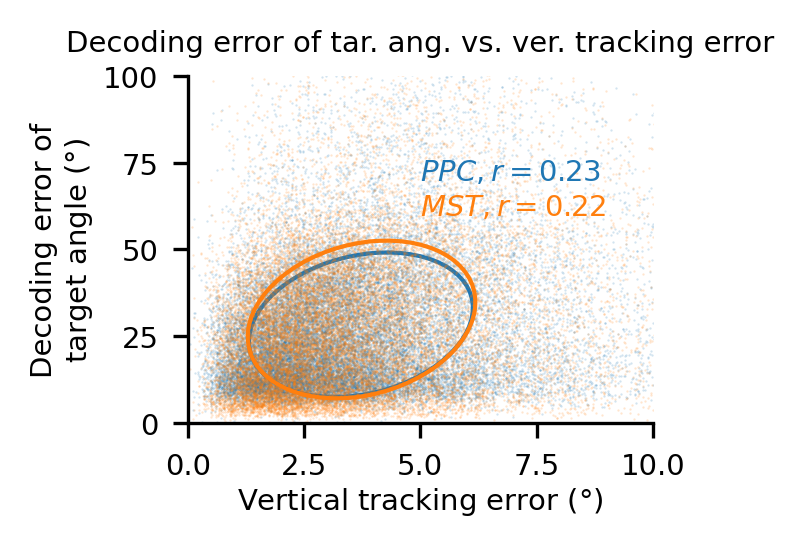

In [37]:
width = 2; height = 1.5
yticks = np.linspace(0, 100, 5)
xticks = np.linspace(0, 10, 5)
xdata1 = tracking_errors_ver_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = decoding_errors_relang_PPC[~mask1]

xdata2 = tracking_errors_ver_MST
mask2 = np.isnan(xdata2)
xdata2 = xdata2[~mask2]
ydata2 = decoding_errors_relang_MST[~mask2]

#xdata3 = tracking_errors_ver_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = decoding_errors_relang_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. ang. vs. ver. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Vertical tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.2)
ax.text(5, 70, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
ax.text(5, 60, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
        c='C1', fontsize=fontsize)
confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(5, 20, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

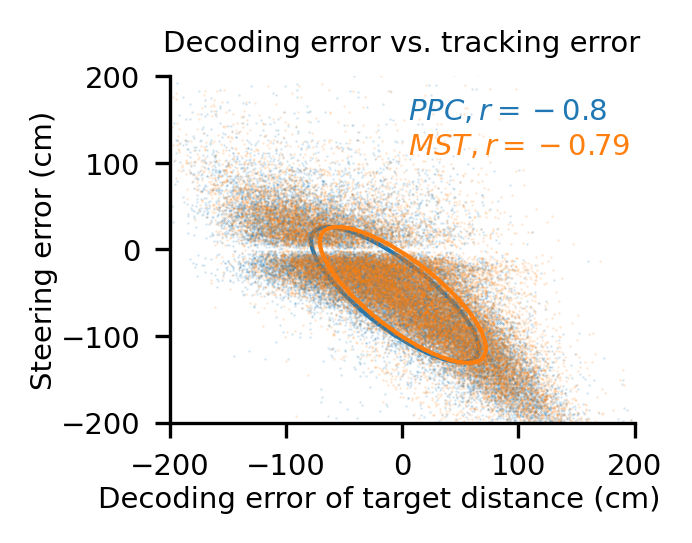

In [38]:
width = 2; height = 1.5
yticks = np.linspace(-200, 200, 5)
xticks = np.linspace(-200, 200, 5)
xdata1 = decoding_errors_reldist_sign_PPC
mask1 = np.isnan(xdata1)
xdata1 = xdata1[~mask1]
ydata1 = steering_errors_PPC[~mask1]

xdata2 = decoding_errors_reldist_sign_MST
mask2 = np.isnan(xdata2)
xdata2 = xdata2[~mask2]
ydata2 = steering_errors_MST[~mask2]

#xdata3 = decoding_errors_reldist_sign_PFC
#mask3 = np.isnan(xdata3)
#xdata3 = xdata3[~mask3]
#ydata3 = steering_errors_PFC[~mask3]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error vs. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Steering error (cm)', fontsize=fontsize)
ax.set_xlabel('Decoding error of target distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.45, -0.18)
ax.yaxis.set_label_coords(-0.24, 0.5)

ax.scatter(xdata1, ydata1, s=0.3, c='C0', lw=0, alpha=0.2)
ax.text(5, 150, f'$PPC, r={round(np.corrcoef(xdata1, ydata1)[0, 1], 2)}$',
        c='C0', fontsize=fontsize)
confidence_ellipse(xdata1, ydata1, ax, n_std=1, ec='C0', lw=lw)

ax.scatter(xdata2, ydata2, s=0.3, c='C1', lw=0, alpha=0.2)
ax.text(5, 110, f'$MST, r={round(np.corrcoef(xdata2, ydata2)[0, 1], 2)}$',
        c='C1', fontsize=fontsize)
confidence_ellipse(xdata2, ydata2, ax, n_std=1, ec='C1', lw=lw)

#ax.scatter(xdata3, ydata3, s=0.3, c='C3', lw=0, alpha=0.2)
#ax.text(5, 70, f'$PFC, r={round(np.corrcoef(xdata3, ydata3)[0, 1], 2)}$',
#        c='C3', fontsize=fontsize)
#confidence_ellipse(xdata3, ydata3, ax, n_std=1, ec='C3', lw=lw)
    
plt.show()

In [ ]:
width = 2; height = 1.5
yticks = np.linspace(-250, 250, 5)
xticks = np.linspace(-250, 250, 5)
xdata = decoding_errors_reldist_sign
mask = np.isnan(xdata)
xdata = xdata[~mask]
ydata = steering_errors[~mask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error vs. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Steering error (cm)', fontsize=fontsize)
ax.set_xlabel('Decoding error of target distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.45, -0.18)
ax.yaxis.set_label_coords(-0.24, 0.5)

ax.scatter(xdata, ydata, s=0.3, c='k', lw=0)
ax.text(-190, -160, f'$r={round(np.corrcoef(xdata, ydata)[0, 1], 2)}$',
        c='r', fontsize=fontsize)
confidence_ellipse(xdata, ydata, ax, n_std=1, ec='r', lw=lw)

ax.plot([0, 0], ax.get_ylim(), lw=lw, c='gray')
ax.plot(ax.get_xlim(), [0, 0], lw=lw, c='gray')
    
plt.show()

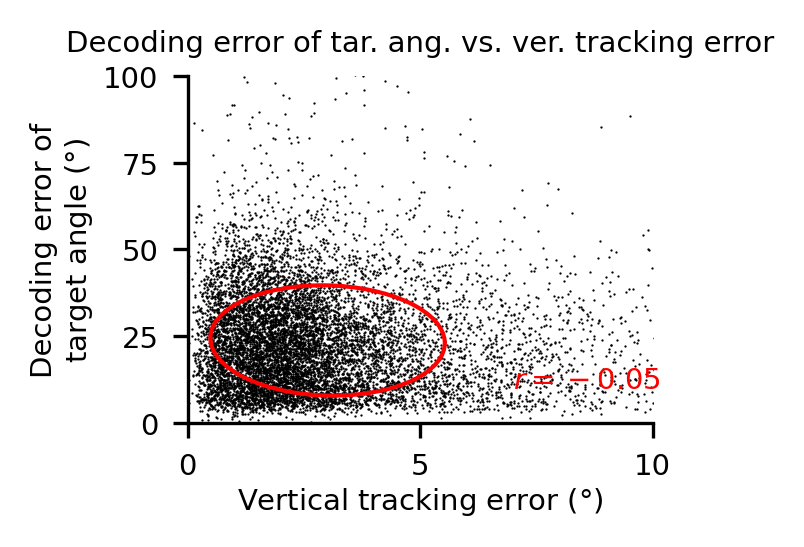

In [22]:
width = 2; height = 1.5
yticks = np.linspace(0, 100, 5)
xticks = np.linspace(0, 10, 3)
xdata = tracking_errors_ver
mask = np.isnan(xdata)
xdata = xdata[~mask]
ydata = decoding_errors_relang[~mask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. ang. vs. ver. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Vertical tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget angle ($\degree$)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata, ydata, s=0.3, c='k', lw=0)
ax.text(7, 10, f'$r={round(np.corrcoef(xdata, ydata)[0, 1], 2)}$',
        c='r', fontsize=fontsize)
confidence_ellipse(xdata, ydata, ax, n_std=1, ec='r', lw=lw)
    
plt.show()

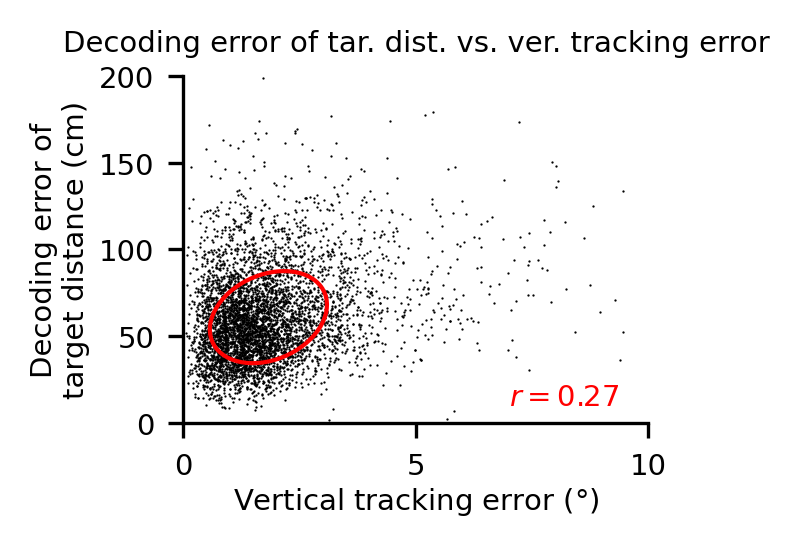

In [98]:
width = 2; height = 1.5
yticks = np.linspace(0, 200, 5)
xticks = np.linspace(0, 10, 3)
xdata = tracking_errors_ver
mask = np.isnan(xdata)
xdata = xdata[~mask]
ydata = decoding_errors_reldist[~mask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. dist. vs. ver. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Vertical tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata, ydata, s=0.3, c='k', lw=0)
ax.text(7, 10, f'$r={round(np.corrcoef(xdata, ydata)[0, 1], 2)}$',
        c='r', fontsize=fontsize)
confidence_ellipse(xdata, ydata, ax, n_std=1, ec='r', lw=lw)
    
plt.show()

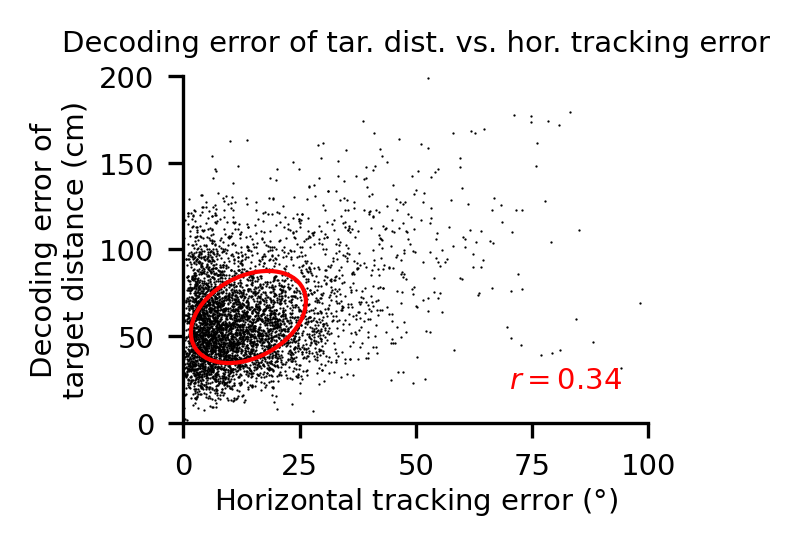

In [99]:
width = 2; height = 1.5
yticks = np.linspace(0, 200, 5)
xticks = np.linspace(0, 100, 5)
xdata = tracking_errors_hor
mask = np.isnan(xdata)
xdata = xdata[~mask]
ydata = decoding_errors_reldist[~mask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error of tar. dist. vs. hor. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_xlabel('Horizontal tracking error ($\degree$)', fontsize=fontsize)
ax.set_ylabel('Decoding error of\ntarget distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.18)
ax.yaxis.set_label_coords(-0.2, 0.5)

ax.scatter(xdata, ydata, s=0.3, c='k', lw=0)
ax.text(70, 20, f'$r={round(np.corrcoef(xdata, ydata)[0, 1], 2)}$',
        c='r', fontsize=fontsize)
confidence_ellipse(xdata, ydata, ax, n_std=1, ec='r', lw=lw)
    
plt.show()

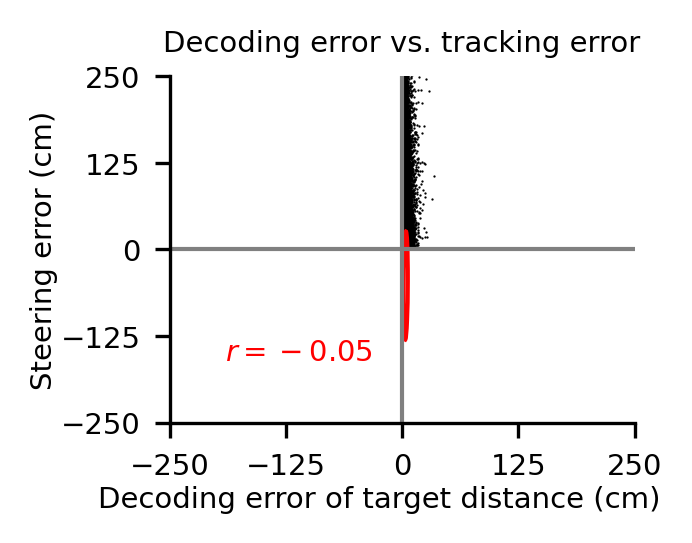

In [26]:
width = 2; height = 1.5
yticks = np.linspace(-250, 250, 5)
xticks = np.linspace(-250, 250, 5)
xdata = tracking_errors_ver_PPC
mask = np.isnan(xdata)
xdata = xdata[~mask]
ydata = steering_errors_PPC[~mask]

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.set_title('Decoding error vs. tracking error', fontsize=fontsize)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Steering error (cm)', fontsize=fontsize)
ax.set_xlabel('Decoding error of target distance (cm)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.45, -0.18)
ax.yaxis.set_label_coords(-0.24, 0.5)

ax.scatter(xdata, abs(ydata), s=0.3, c='k', lw=0)
ax.text(-190, -160, f'$r={round(np.corrcoef(xdata, abs(ydata))[0, 1], 2)}$',
        c='r', fontsize=fontsize)
confidence_ellipse(xdata, ydata, ax, n_std=1, ec='r', lw=lw)

ax.plot([0, 0], ax.get_ylim(), lw=lw, c='gray')
ax.plot(ax.get_xlim(), [0, 0], lw=lw, c='gray')
    
plt.show()

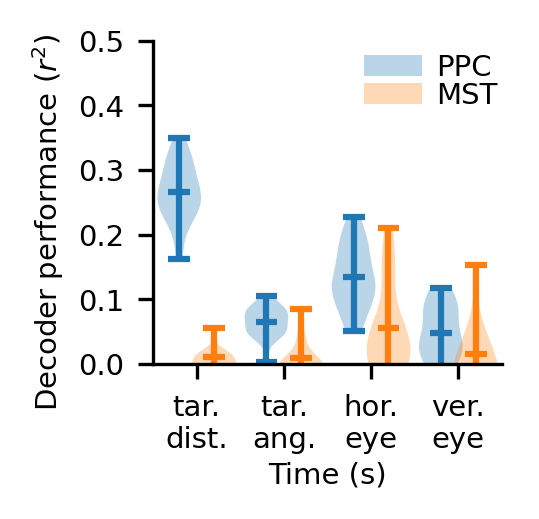

In [30]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
ydata2 = (np.array(list(eval(m)['MSTdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [0, 1, 4, 5]], positions=xticks - 0.2, showmeans=True)
vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [0, 1, 4, 5]], positions=xticks + 0.2, showmeans=True)
ax.legend([vio1['bodies'][0], vio2['bodies'][0]], ['PPC', 'MST'], 
          fontsize=fontsize, frameon=False, loc=[0.57, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

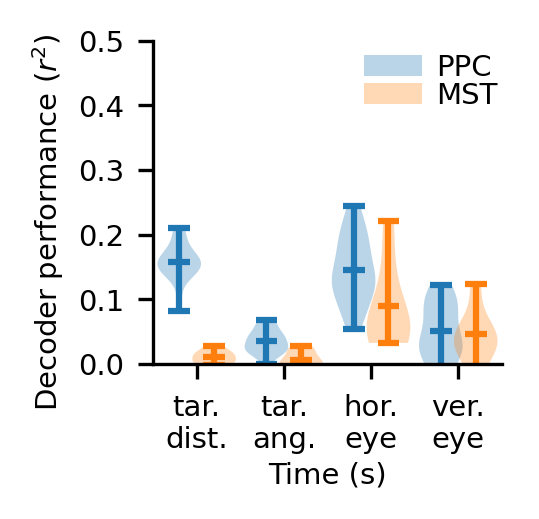

In [32]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
ydata2 = (np.array(list(eval(m)['MSTdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [7, 6, 4, 5]], positions=xticks - 0.2, showmeans=True)
vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [7, 6, 4, 5]], positions=xticks + 0.2, showmeans=True)
ax.legend([vio1['bodies'][0], vio2['bodies'][0]], ['PPC', 'MST'], 
          fontsize=fontsize, frameon=False, loc=[0.57, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

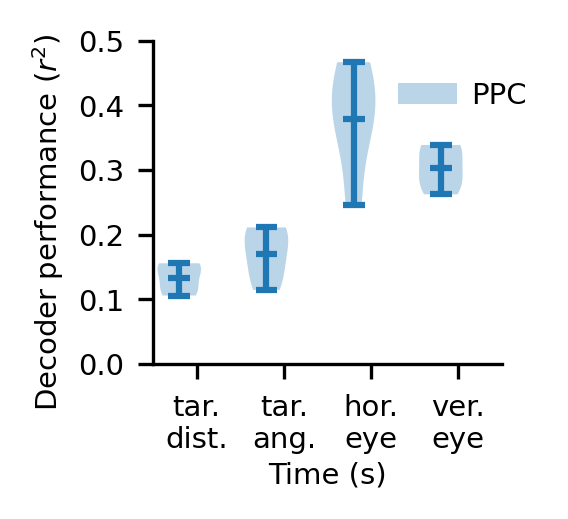

In [229]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
#ydata2 = (np.array(list(eval(m)['MSTdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [7, 6, 4, 5]], positions=xticks - 0.2, showmeans=True)
#vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [0, 1, 4, 5]], positions=xticks + 0.2, showmeans=True)
ax.legend([vio1['bodies'][0]], ['PPC',], 
          fontsize=fontsize, frameon=False, loc=[0.67, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

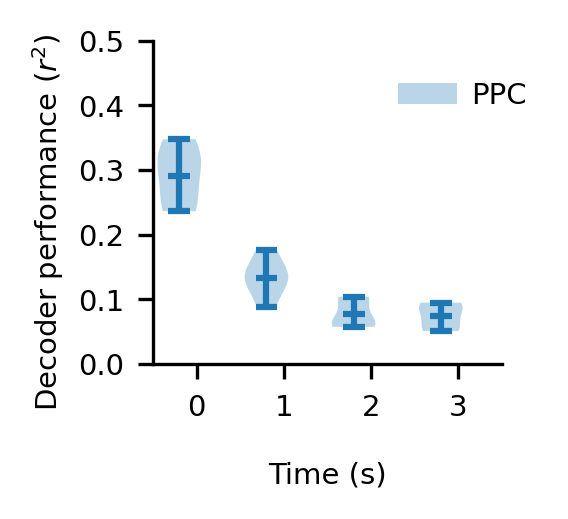

In [22]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
#ydata2 = (np.array(list(eval(m)['MSTdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [0, 1, 6, 7]], positions=xticks - 0.2, showmeans=True)
#vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [0, 1, 4, 5]], positions=xticks + 0.2, showmeans=True)
ax.legend([vio1['bodies'][0]], ['PPC',], 
          fontsize=fontsize, frameon=False, loc=[0.67, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

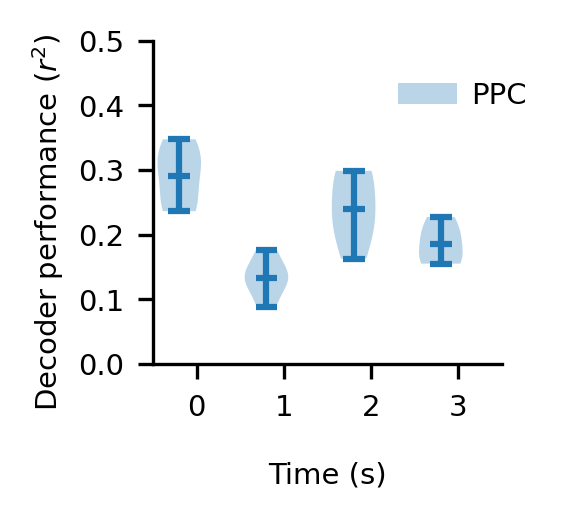

In [394]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
#ydata2 = (np.array(list(eval(m)['MSTdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [0, 1, 8, 9]], positions=xticks - 0.2, showmeans=True)
#vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [0, 1, 4, 5]], positions=xticks + 0.2, showmeans=True)
ax.legend([vio1['bodies'][0]], ['PPC',], 
          fontsize=fontsize, frameon=False, loc=[0.67, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

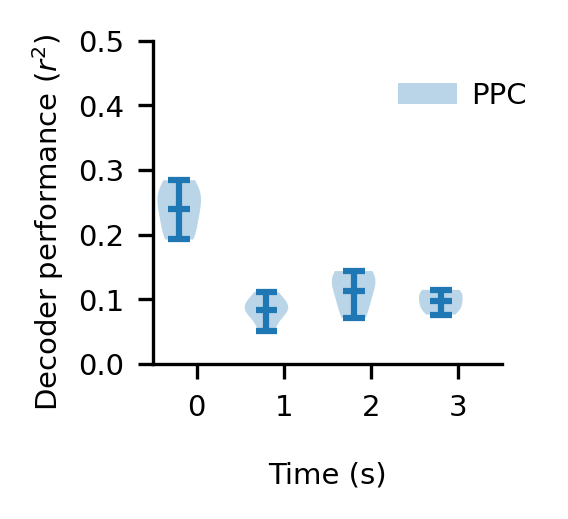

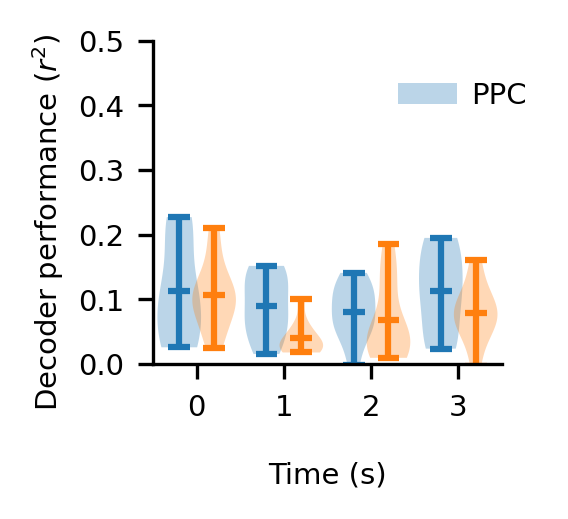

In [55]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
ydata2 = (np.array(list(eval(m)['PFCdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [0, 1, 8, 9]], positions=xticks - 0.2, showmeans=True)
vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [0, 1, 8, 9]], positions=xticks + 0.2, showmeans=True)
ax.legend([vio1['bodies'][0]], ['PPC',], 
          fontsize=fontsize, frameon=False, loc=[0.67, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

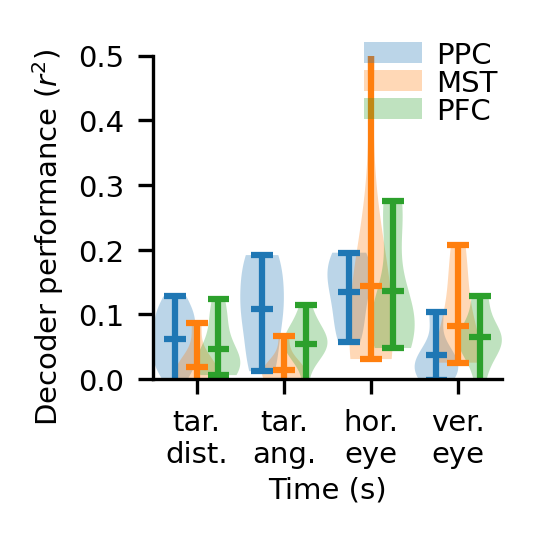

In [40]:
width = 1.5; height = 1.4
yticks = np.linspace(0, 0.5, 6)
xticks = np.arange(4)
xticklabels = ['tar.\ndist.', 'tar.\nang.', 'hor.\neye', 'ver.\neye']

ydata1 = (np.array(list(eval(m)['PPCdecoding_rsq_session'].values())))
ydata2 = (np.array(list(eval(m)['MSTdecoding_rsq_session'].values())))
ydata3 = (np.array(list(eval(m)['PFCdecoding_rsq_session'].values())))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, xticklabels, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('Decoder performance ($r^2$)', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0]-0.5, xticks[-1]+0.5)
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.3)
ax.yaxis.set_label_coords(-0.25, 0.44)

vio1 = ax.violinplot([ydata1[:, i][~np.isnan(ydata1[:, i])] for i in [6, 7, 4, 5]], positions=xticks - 0.25, showmeans=True)
vio2 = ax.violinplot([ydata2[:, i][~np.isnan(ydata2[:, i])] for i in [6, 7, 4, 5]], positions=xticks, showmeans=True)
vio3 = ax.violinplot([ydata3[:, i][~np.isnan(ydata3[:, i])] for i in [6, 7, 4, 5]], positions=xticks + 0.25, showmeans=True)
ax.legend([vio1['bodies'][0], vio2['bodies'][0], vio3['bodies'][0]], ['PPC', 'MST', 'PFC'], 
          fontsize=fontsize, frameon=False, loc=[0.57, 0.75], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
plt.show()

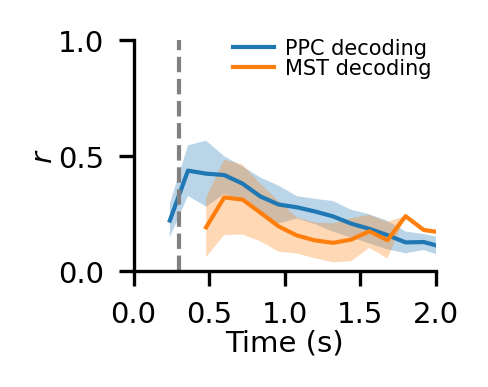

In [43]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(eval(m)['PPCdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(eval(m)['MSTdecoding_rsq'].values()))
#ydata2_ = np.array(list(eval(m)['PFCdecoding_rsq'].values()))
ydata3 = np.array(list(eval(m)['PPCtracking_rsq'].values())).swapaxes(1, 2)
masked_ydata1 = np.ma.sqrt(np.ma.masked_where(ydata1 < 0, ydata1))
masked_ydata2 = np.ma.sqrt(np.ma.masked_where(ydata2 < 0, ydata2))
#masked_ydata2_ = np.ma.sqrt(np.ma.masked_where(ydata2_ < 0, ydata2_))
masked_ydata3 = np.ma.sqrt(np.ma.masked_where(ydata3 < 0, ydata3))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 1
ymean1 = np.ma.mean(masked_ydata1, axis=0)[:, target_idx]; ystd1 = np.ma.std(masked_ydata1, axis=0)[:, target_idx]
ymean2 = np.ma.mean(masked_ydata2, axis=0)[:, target_idx]; ystd2 = np.ma.std(masked_ydata2, axis=0)[:, target_idx]
#ymean2_ = np.ma.mean(masked_ydata2_, axis=0)[:, target_idx]; ystd2_ = np.ma.std(masked_ydata2_, axis=0)[:, target_idx]
#ymean3 = np.ma.mean(masked_ydata3, axis=0)[:, 1]; ystd3 = np.ma.std(masked_ydata3, axis=0)[:, 1]

ax.plot(xdata, ymean1, lw=lw, c='C0', label='PPC decoding', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='MST decoding', alpha=1)
#ax.plot(xdata, ymean2_, lw=lw, c='C3', label='PFC decoding', alpha=1)
#ax.plot(xdata, ymean3, lw=lw, c='C2', label='Target tracking', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean2_ - ystd2_, ymean2_ + ystd2_, facecolor='C3', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

In [53]:
np.arange(t_total) * DT + 0.051

array([0.051, 0.153, 0.255, 0.357, 0.459, 0.561, 0.663, 0.765, 0.867,
       0.969, 1.071, 1.173, 1.275, 1.377, 1.479, 1.581, 1.683, 1.785,
       1.887, 1.989, 2.091, 2.193, 2.295, 2.397])

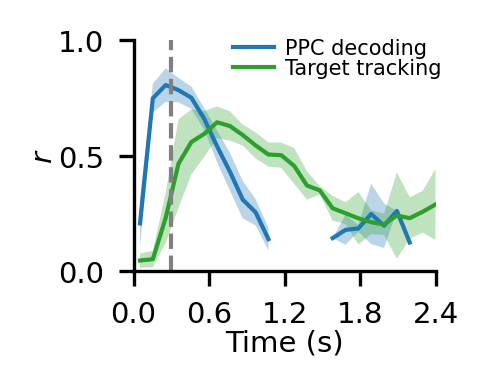

In [77]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2.4, 5)
xdata = np.arange(t_total) * DT + 0.051

ydata1 = np.array(list(eval(m)['PPCdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(eval(m)['MSTdecoding_rsq'].values()))
#ydata2_ = np.array(list(eval(m)['PFCdecoding_rsq'].values()))
ydata3 = np.array(list(eval(m)['PPCtracking_rsq'].values())).swapaxes(1, 2)
masked_ydata1 = np.ma.sqrt(np.ma.masked_where(ydata1 < 0, ydata1))
#masked_ydata2 = np.ma.sqrt(np.ma.masked_where(ydata2 < 0, ydata2))
#masked_ydata2_ = np.ma.sqrt(np.ma.masked_where(ydata2_ < 0, ydata2_))
masked_ydata3 = np.ma.sqrt(np.ma.masked_where(ydata3 < 0, ydata3))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 8
ymean1 = np.ma.mean(masked_ydata1, axis=0)[:, target_idx]; ystd1 = np.ma.std(masked_ydata1, axis=0)[:, target_idx]
#ymean2 = np.ma.mean(masked_ydata2, axis=0)[:, target_idx]; ystd2 = np.ma.std(masked_ydata2, axis=0)[:, target_idx]
#ymean2_ = np.ma.mean(masked_ydata2_, axis=0)[:, target_idx]; ystd2_ = np.ma.std(masked_ydata2_, axis=0)[:, target_idx]
ymean3 = np.ma.mean(masked_ydata3, axis=0)[:, 1]; ystd3 = np.ma.std(masked_ydata3, axis=0)[:, 1]

ax.plot(xdata, ymean1, lw=lw, c='C0', label='PPC decoding', alpha=1)
#ax.plot(xdata, ymean2, lw=lw, c='C1', label='MST decoding', alpha=1)
#ax.plot(xdata, ymean2_, lw=lw, c='C3', label='PFC decoding', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='Target tracking', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean2_ - ystd2_, ymean2_ + ystd2_, facecolor='C3', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

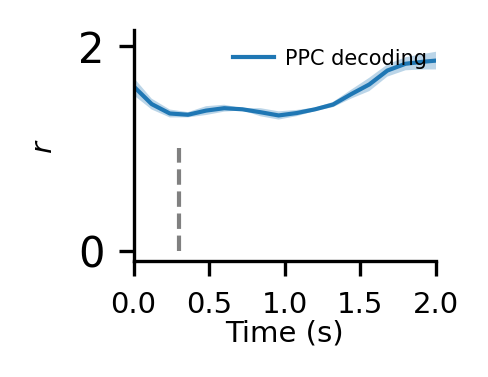

In [47]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(eval(m)['PPCdecoding_rsq'].values()))  # B * L * D
#ydata2 = np.array(list(eval(m)['MSTdecoding_rsq'].values()))
#ydata2_ = np.array(list(eval(m)['PFCdecoding_rsq'].values()))
ydata3 = np.array(list(eval(m)['PPCtracking_rsq'].values())).swapaxes(1, 2)
masked_ydata1 = np.ma.sqrt(np.ma.masked_where(ydata1 < 0, ydata1))
#masked_ydata2 = np.ma.sqrt(np.ma.masked_where(ydata2 < 0, ydata2))
#masked_ydata2_ = np.ma.sqrt(np.ma.masked_where(ydata2_ < 0, ydata2_))
#masked_ydata3 = np.ma.sqrt(np.ma.masked_where(ydata3 < 0, ydata3))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
#plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
#ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 5
ymean1 = np.ma.mean(masked_ydata1, axis=0)[:, target_idx]; ystd1 = np.ma.std(masked_ydata1, axis=0)[:, target_idx]
#ymean2 = np.ma.mean(masked_ydata2, axis=0)[:, target_idx]; ystd2 = np.ma.std(masked_ydata2, axis=0)[:, target_idx]
#ymean2_ = np.ma.mean(masked_ydata2_, axis=0)[:, target_idx]; ystd2_ = np.ma.std(masked_ydata2_, axis=0)[:, target_idx]
#ymean3 = np.ma.mean(masked_ydata3, axis=0)[:, 1]; ystd3 = np.ma.std(masked_ydata3, axis=0)[:, 1]

ax.plot(xdata, ymean1, lw=lw, c='C0', label='PPC decoding', alpha=1)
#ax.plot(xdata, ymean2, lw=lw, c='C1', label='MST decoding', alpha=1)
#ax.plot(xdata, ymean2_, lw=lw, c='C3', label='PFC decoding', alpha=1)
#ax.plot(xdata, ymean3, lw=lw, c='C2', label='Target tracking', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean2_ - ystd2_, ymean2_ + ystd2_, facecolor='C3', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

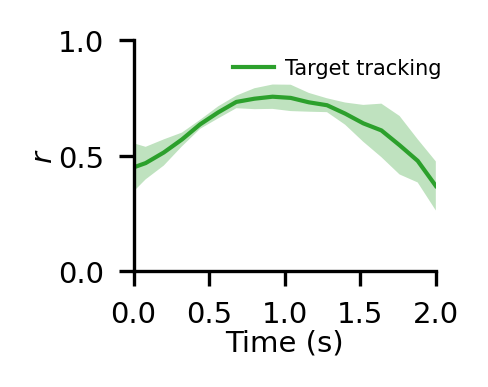

In [21]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = -np.arange(t_total) * DT+2

#ydata1 = np.array(list(eval(m)['PPCdecoding_rsq'].values()))  # B * L * D
#ydata2 = np.array(list(eval(m)['MSTdecoding_rsq'].values()))
#ydata2_ = np.array(list(eval(m)['PFCdecoding_rsq'].values()))
ydata3 = np.array(list(eval(m)['PPCtracking_rsq'].values())).swapaxes(1, 2)
#masked_ydata1 = np.ma.sqrt(np.ma.masked_where(ydata1 < 0, ydata1))
#masked_ydata2 = np.ma.sqrt(np.ma.masked_where(ydata2 < 0, ydata2))
#masked_ydata2_ = np.ma.sqrt(np.ma.masked_where(ydata2_ < 0, ydata2_))
masked_ydata3 = np.ma.sqrt(np.ma.masked_where(ydata3 < 0, ydata3))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 5
#ymean1 = np.ma.mean(masked_ydata1, axis=0)[:, target_idx]; ystd1 = np.ma.std(masked_ydata1, axis=0)[:, target_idx]
#ymean2 = np.ma.mean(masked_ydata2, axis=0)[:, target_idx]; ystd2 = np.ma.std(masked_ydata2, axis=0)[:, target_idx]
#ymean2_ = np.ma.mean(masked_ydata2_, axis=0)[:, target_idx]; ystd2_ = np.ma.std(masked_ydata2_, axis=0)[:, target_idx]
ymean3 = np.ma.mean(masked_ydata3, axis=0)[:, 0]; ystd3 = np.ma.std(masked_ydata3, axis=0)[:, 0]

#ax.plot(xdata, ymean1, lw=lw, c='C0', label='PPC decoding', alpha=1)
#ax.plot(xdata, ymean2, lw=lw, c='C1', label='MST decoding', alpha=1)
#ax.plot(xdata, ymean2_, lw=lw, c='C3', label='PFC decoding', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='Target tracking', alpha=1)
#ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean2_ - ystd2_, ymean2_ + ystd2_, facecolor='C3', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

#ax.plot(np.linspace(0.3, 0.3), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.8], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

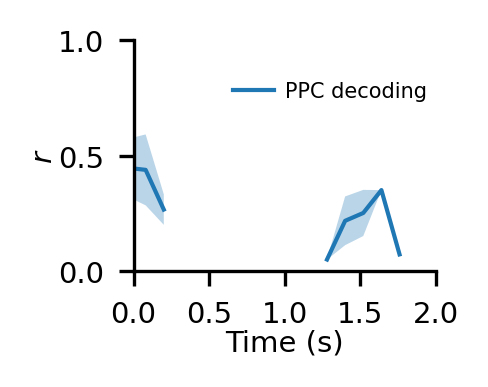

In [25]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = -np.arange(t_total) * DT+2

ydata1 = np.array(list(eval(m)['PPCdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(eval(m)['MSTdecoding_rsq'].values()))
ydata3 = np.array(list(eval(m)['PPCtracking_rsq'].values())).swapaxes(1, 2)
masked_ydata1 = np.ma.sqrt(np.ma.masked_where(ydata1 < 0, ydata1))
masked_ydata2 = np.ma.sqrt(np.ma.masked_where(ydata2 < 0, ydata2))
masked_ydata3 = np.ma.sqrt(np.ma.masked_where(ydata3 < 0, ydata3))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

target_idx = 5
ymean1 = np.ma.mean(masked_ydata1, axis=0)[:, target_idx]; ystd1 = np.ma.std(masked_ydata1, axis=0)[:, target_idx]
#ymean2 = np.ma.mean(masked_ydata2, axis=0)[:, target_idx]; ystd2 = np.ma.std(masked_ydata2, axis=0)[:, target_idx]
#ymean3 = np.ma.mean(masked_ydata3, axis=0)[:, 2]; ystd3 = np.ma.std(masked_ydata3, axis=0)[:, 2]

ax.plot(xdata, ymean1, lw=lw, c='C0', label='PPC decoding', alpha=1)
#ax.plot(xdata, ymean2, lw=lw, c='C1', label='MST decoding', alpha=1)
#ax.plot(xdata, ymean3, lw=lw, c='C2', label='Target tracking', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
#ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
#ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

#ax.plot(np.linspace(0.3, 0.3), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

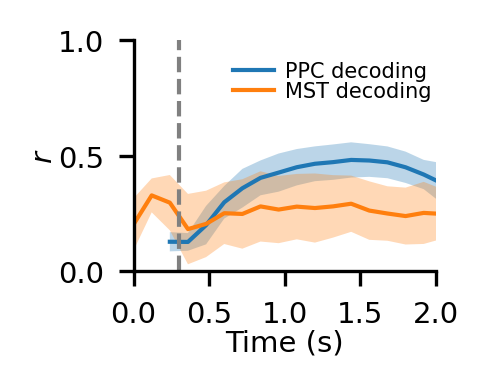

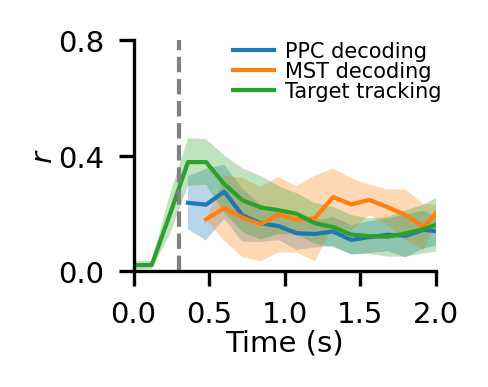

In [178]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.8, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(eval(m)['PPCdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(eval(m)['MSTdecoding_rsq'].values()))
ydata3 = np.array(list(eval(m)['PPCtracking_rsq'].values())).swapaxes(1, 2)
masked_ydata1 = np.ma.sqrt(np.ma.masked_where(ydata1 < 0, ydata1))
masked_ydata2 = np.ma.sqrt(np.ma.masked_where(ydata2 < 0, ydata2))
masked_ydata3 = np.ma.sqrt(np.ma.masked_where(ydata3 < 0, ydata3))

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('$r$', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

ymean1 = np.ma.mean(masked_ydata1, axis=0)[:, 5]; ystd1 = np.ma.std(masked_ydata1, axis=0)[:, 5]
ymean2 = np.ma.mean(masked_ydata2, axis=0)[:, 5]; ystd2 = np.ma.std(masked_ydata2, axis=0)[:, 5]
ymean3 = np.ma.mean(masked_ydata3, axis=0)[:, 1]; ystd3 = np.ma.std(masked_ydata3, axis=0)[:, 1]

ax.plot(xdata, ymean1, lw=lw, c='C0', label='PPC decoding', alpha=1)
ax.plot(xdata, ymean2, lw=lw, c='C1', label='MST decoding', alpha=1)
ax.plot(xdata, ymean3, lw=lw, c='C2', label='Target tracking', alpha=1)
ax.fill_between(xdata, ymean1 - ystd1, ymean1 + ystd1, facecolor='C0', alpha=0.3)
ax.fill_between(xdata, ymean2 - ystd2, ymean2 + ystd2, facecolor='C1', alpha=0.3)
ax.fill_between(xdata, ymean3 - ystd3, ymean3 + ystd3, facecolor='C2', alpha=0.3)

ax.plot(np.linspace(0.3, 0.3), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize-2, frameon=False, 
          loc=[0.3, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

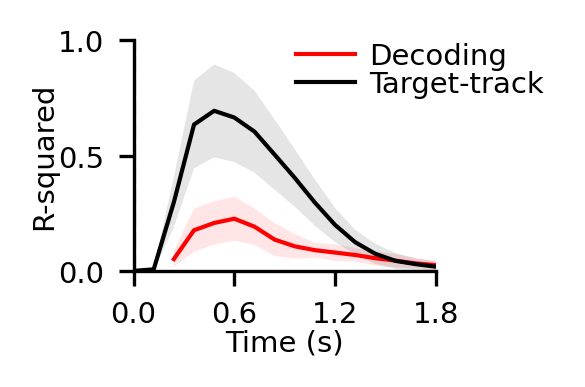

In [21]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.arange(0, 2, 0.6)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(m44['PPCPFCMSTdecoding_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1])
masked_ydata = np.ma.masked_where(ydata < 0, ydata)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 1], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 1], (ymean+ystd)[:, 1], facecolor='r', alpha=0.1)

ydata1 = np.array(list(m44['PPCPFCMSTtracking_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Target-track', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)

ax.plot(np.linspace(0, 0), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize, frameon=False, 
          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

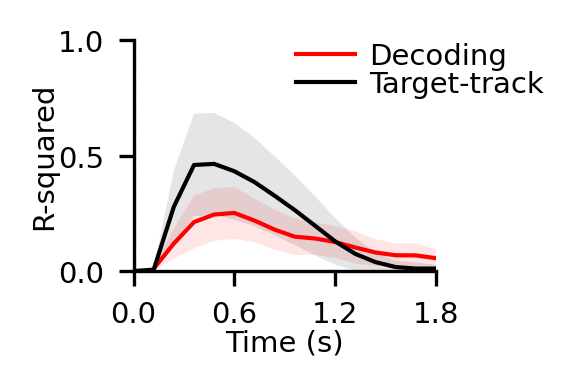

In [116]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.arange(0, 2, 0.6)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(m53['PPCPFCMSTdecoding_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1])
masked_ydata = np.ma.masked_where(ydata < 0, ydata)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 1], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 1], (ymean+ystd)[:, 1], facecolor='r', alpha=0.1)

ydata1 = np.array(list(m53['PPCPFCMSTtracking_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Target-track', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)

ax.plot(np.linspace(0, 0), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize, frameon=False, 
          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

In [329]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.3, 4)
xticks = np.arange(0, 2, 0.6)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(m44['PPCPFCMSTdecoding_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1])
masked_ydata = np.ma.masked_where(ydata < 0, ydata)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='r', alpha=0.1)

ydata1 = np.array(list(m44['MSTtracking_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 1], lw=lw, c='k', label='Target-track', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)

ax.plot(np.linspace(0, 0), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize, frameon=False, 
          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

NameError: name 'm44' is not defined

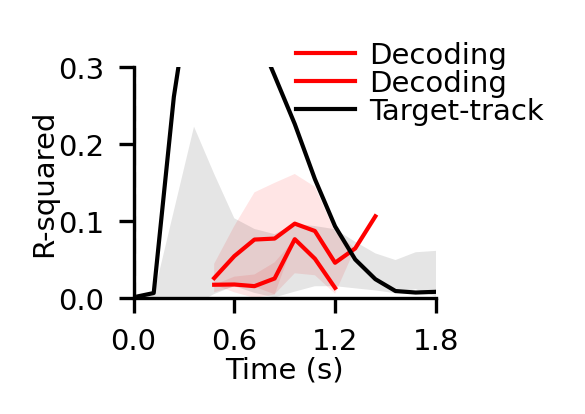

In [335]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.3, 4)
xticks = np.arange(0, 2, 0.6)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(m53['PPCdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(m53['MSTdecoding_rsq'].values()))
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1])
masked_ydata1 = np.ma.masked_where(ydata < 0, ydata)
masked_ydata2 = np.ma.masked_where(ydata2 < 0, ydata2)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata1, axis=0); ystd = np.ma.std(masked_ydata1, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='r', alpha=0.1)
ymean = np.ma.mean(masked_ydata2, axis=0); ystd = np.ma.std(masked_ydata2, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='r', alpha=0.1)

ydata1 = np.array(list(m53['MSTtracking_rsq'].values()))  # B * L * D
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Target-track', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 1], (ymean+ystd)[:, 1], facecolor='k', alpha=0.1)

ax.plot(np.linspace(0, 0), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize, frameon=False, 
          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

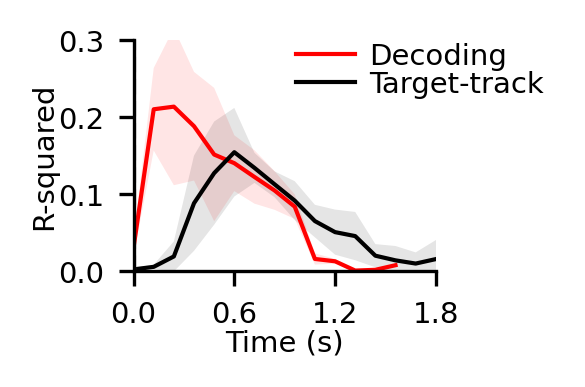

In [1063]:
width = 1.3; height = 1
yticks = np.linspace(0, 0.3, 4)
xticks = np.arange(0, 2, 0.6)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(m44['PPCPFCMSTdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(m51['PPCPFCMSTdecoding_rsq'].values()))
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata2])
masked_ydata = np.ma.masked_where(ydata < 0, ydata)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='r', alpha=0.1)

ydata1 = np.array(list(m44['PPCPFCMSTtracking_rsq'].values()))  # B * L * D
ydata2 = np.array(list(m51['PPCPFCMSTtracking_rsq'].values()))
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata2]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 1], lw=lw, c='k', label='Target-track', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 1], (ymean+ystd)[:, 1], facecolor='k', alpha=0.1)

ax.plot(np.linspace(0, 0), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize, frameon=False, 
          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

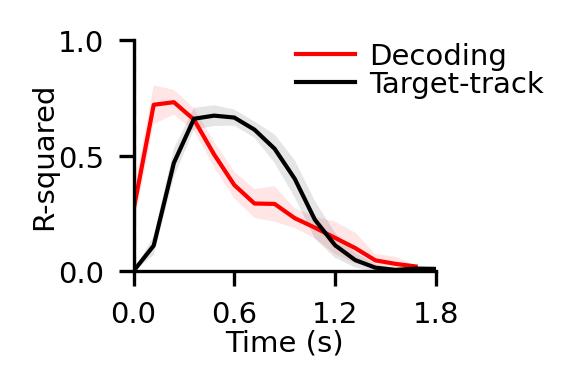

In [1058]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.arange(0, 2, 0.6)
xdata = np.arange(t_total) * DT

ydata1 = np.array(list(m44['PPCPFCMSTdecoding_rsq'].values()))  # B * L * D
ydata2 = np.array(list(m51['PPCPFCMSTdecoding_rsq'].values()))
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata2])
masked_ydata = np.ma.masked_where(ydata < 0, ydata)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 1], lw=lw, c='r', label='Decoding', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 1], (ymean+ystd)[:, 1], facecolor='r', alpha=0.1)

ydata1 = np.array(list(m44['PPCPFCMSTtracking_rsq'].values()))  # B * L * D
ydata2 = np.array(list(m51['PPCPFCMSTtracking_rsq'].values()))
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata2]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
#ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
#ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Target-track', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)

ax.plot(np.linspace(0, 0), np.linspace(0, 1), lw=lw, c='gray', ls='--')

ax.legend(fontsize=fontsize, frameon=False, 
          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

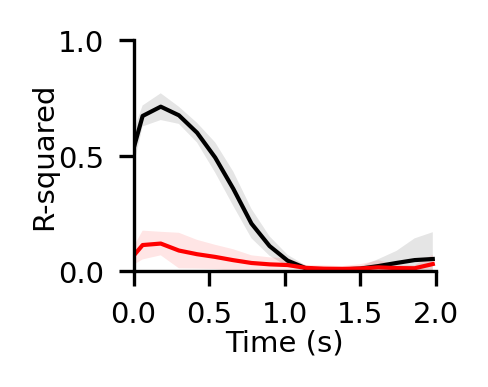

In [924]:
width = 1.3; height = 1
yticks = np.linspace(0, 1, 3)
xticks = np.linspace(0, 2, 5)
xdata = np.arange(t_total) * DT - 0.3

ydata1 = np.array(list(m44['PPCPFCMSTtracking_rsq'].values()))  # B * L * D
ydata2 = np.array(list(m51['PPCPFCMSTtracking_rsq'].values()))
#ydata3 = np.array(list(m53score['PPCPFCMSTscore'].values()))
ydata = np.concatenate([ydata1, ydata2]).swapaxes(1, 2)
masked_ydata = np.ma.masked_where(ydata < 0, ydata)

fig = plt.figure(figsize=(width, height), dpi=300)
ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
plt.xticks(xticks, fontsize=fontsize)
plt.yticks(yticks, fontsize=fontsize)
ax.set_ylabel('R-squared', fontsize=fontsize)
ax.set_xlabel('Time (s)', fontsize=fontsize)
ax.set_xlim(xticks[0], xticks[-1])
ax.set_ylim(yticks[0], yticks[-1])
ax.xaxis.set_label_coords(0.5, -0.25)
ax.yaxis.set_label_coords(-0.25, 0.5)

#for yd in ydata:
#    ax.plot(xdata, yd[:, 0], lw=lw, c='k', alpha=0.05)
#    ax.plot(xdata, yd[:, 1], lw=lw, c='r', alpha=0.05)
ymean = np.ma.mean(masked_ydata, axis=0); ystd = np.ma.std(masked_ydata, axis=0)
ax.plot(xdata, ymean[:, 0], lw=lw, c='k', label='Tar. dist.', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 0], (ymean+ystd)[:, 0], facecolor='k', alpha=0.1)
ax.plot(xdata, ymean[:, 1], lw=lw, c='r', label='Tar. dist.', alpha=1)
ax.fill_between(xdata, (ymean-ystd)[:, 1], (ymean+ystd)[:, 1], facecolor='r', alpha=0.1)

#ax.legend(fontsize=fontsize, frameon=False, 
#          loc=[0.5, 0.7], handletextpad=0.5, labelspacing=0., ncol=1, columnspacing=0)
    
plt.show()

In [ ]:
m44['PPCdecoding_rsq']

In [362]:
m_score['PPCdecoding_error_trial']['m51s38'][1][tdata[:, 0] == trial_idx]

array([[ 0.,  0.,  0.,  0.],
       [ 1.,  1.,  1.,  1.],
       [ 2.,  2.,  2.,  2.],
       [ 3.,  3.,  3.,  3.],
       [ 4.,  4.,  4.,  4.],
       [ 5.,  5.,  5.,  5.],
       [ 6.,  6.,  6.,  6.],
       [ 7.,  7.,  7.,  7.],
       [ 8.,  8.,  8.,  8.],
       [ 9.,  9.,  9.,  9.],
       [10., 10., 10., 10.],
       [11., 11., 11., 11.],
       [12., 12., 12., 12.],
       [13., 13., 13., 13.],
       [14., 14., 14., 14.],
       [15., 15., 15., 15.],
       [16., 16., 16., 16.],
       [17., 17., 17., 17.],
       [18., 18., 18., 18.],
       [19., 19., 19., 19.]])

In [312]:
tdata[:, 0].shape

(8889,)

In [324]:
m_score['PPCdecoding_error_trial']['m51s38'][2]

array([[1.26121589e+01, 1.94784881e-01, 2.94174597e+00, 2.21796775e-03],
       [2.74235790e+01, 2.68241811e-02, 4.59999546e+00, 3.17245803e-03],
       [1.43963537e+01, 1.19357203e-01, 3.29717706e-01, 2.30887807e-04],
       ...,
       [4.89486584e+01, 9.71127250e-01, 6.28091617e+01, 2.87735983e-01],
       [1.80466925e+00, 1.08097926e+00, 3.97554972e+01, 1.81493743e-01],
       [1.69530683e+02, 9.02777281e-01, 1.35768839e+02, 9.86013479e-01]])

In [262]:
X[trial_idx:trial_idx+1]

array([[0.  , 0.  , 0.  , 0.  , 0.  , 0.15, 0.  , 0.  , 0.  , 0.  , 0.  ,
        0.  , 0.25, 0.  , 0.  , 0.1 , 0.  , 0.1 , 0.  , 0.  , 0.15, 0.  ,
        0.1 , 0.1 , 0.  , 0.05, 0.1 , 0.  , 0.  , 0.15, 0.05, 0.  , 0.05,
        0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.05, 0.  , 0.1 , 0.05, 0.05,
        0.  , 0.1 , 0.  , 0.  , 0.1 , 0.  , 0.05, 0.  , 0.  , 0.  , 0.05,
        0.1 , 0.05, 0.2 , 0.2 , 0.15, 0.05, 0.15, 0.  , 0.  , 0.05, 0.1 ,
        0.  , 0.1 , 0.05, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.05, 0.05,
        0.05, 0.  , 0.  , 0.  , 0.  , 0.  , 0.  , 0.05, 0.15, 0.  , 0.  ,
        0.  , 0.  , 0.05, 0.  , 0.  , 0.  ]], dtype=float32)

In [241]:
np.concatenate(m_score['PPCdecoding_error_trial']['m51s38'], axis=1).shape

(4, 8889, 3)

In [239]:
m_score['PPCtracking_error_trial']['m51s38']

(8889, 4)

In [265]:
plt.plot(test[test[:, 0] == 14][:, 3])

TypeError: list indices must be integers or slices, not tuple

In [ ]:
kf = KFold(n_splits=5)
decoded_target_idx = [0, 1, 2, 3]
m_score = {}
for area in areas:
    regressors_session = {}; decoders
    scores_session = {}; tracking_idx_session = {}
    for key, data in eval(m).items():
        if key[-1].isalpha():
            continue
        
        Xt = eval(m)[key + 'Xt'][area]
        if len(Xt[0]) == 0:
            continue
        Yt = eval(m)[key + 'Yt']
        scores = []; track_index_hor = []; track_index_ver = []
        for t in range(num_bins):
            X = np.vstack(Xt[t])
            Y = np.vstack(Yt[t])
            # tracking index
            model = LinearRegression(); model.fit(Y[:, [4]], Y[:, 5])
            track_index_hor.append(model.score(Y[:, [4]], Y[:, 5]))
            model = LinearRegression(); model.fit(Y[:, [6]], Y[:, 7])
            track_index_ver.append(model.score(Y[:, [6]], Y[:, 7]))
            # decoding
            score = []
            for idx_variable in decoded_target_idx:
                Y_ = Y[:, idx_variable]
                score_ = []
                for train_index, test_index in kf.split(X):
                    model = RidgeCV()
                    model.fit(X[train_index], Y_[train_index])
                    score_.append(model.score(X[test_index], Y_[test_index]))
                score.append(np.mean(score_))
            scores.append(score)
        scores_session[key] = scores
        tracking_idx_session[key] = np.vstack([track_index_hor, track_index_ver])
    m_score[area + 'decoding_rsq'] = scores_session
    m_score[area + 'tracking_rsq'] = tracking_idx_session
eval(m).update(m_score)

In [32]:
model

RidgeCV()

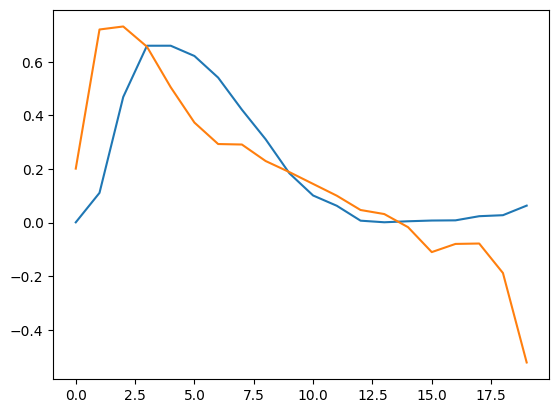

In [328]:
plt.plot(np.stack(list(m_score['PPCtracking_rsq'].values()))[:, 0, :].mean(0))
plt.plot(np.array(list(m_score['PPCdecoding_rsq'].values())).mean(0)[:, 1])

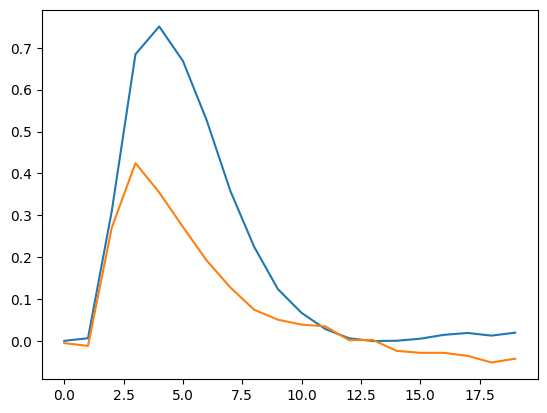

In [443]:
plt.plot(np.stack(list(m_score['PPCtracking_rsq'].values()))[:, 0, :].mean(0))
plt.plot(np.array(list(m_score['PPCdecoding_rsq'].values())).mean(0)[:, 1])

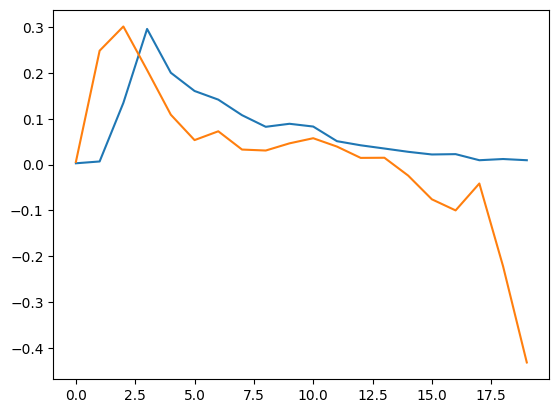

In [329]:
plt.plot(np.stack(list(m_score['PPCtracking_rsq'].values()))[:, 1, :].mean(0))
plt.plot(np.array(list(m_score['PPCdecoding_rsq'].values())).mean(0)[:, 0])

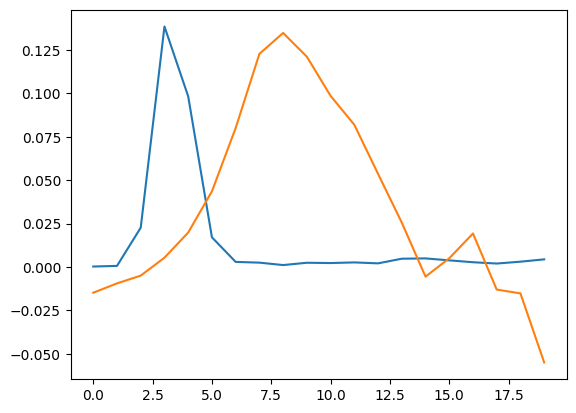

In [444]:
plt.plot(np.stack(list(m_score['PPCtracking_rsq'].values()))[:, 1, :].mean(0))
plt.plot(np.array(list(m_score['PPCdecoding_rsq'].values())).mean(0)[:, 0])

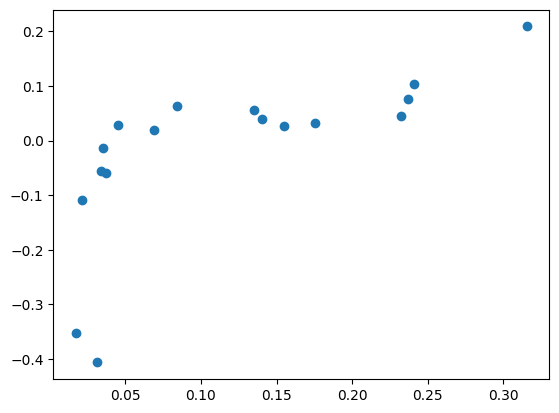

In [537]:
plt.scatter(np.stack(list(m_score['PPCtracking_r2'].values()))[:, 1, 3:].mean(0),
            np.array(list(m_score['PPCdecoding_r2'].values())).mean(0)[3:, 0])

In [ ]:
m51['m51s38Y']

In [380]:
hor_theta.shape

(733,)

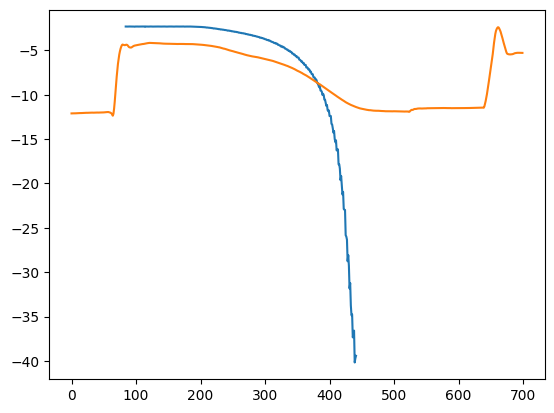

In [416]:
dt = 0.006; monkey_height = 10
trial_idx = 565
y = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['ymp'][0][0].reshape(-1)
x = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['xmp'][0][0].reshape(-1)
v = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['v'][0][0].reshape(-1)
w = -m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['w'][0][0].reshape(-1)
v[np.isnan(y)] = 0
w[np.isnan(y)] = 0
target_x = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['xfp'][0][0].reshape(-1)
target_y = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['yfp'][0][0].reshape(-1)

hor = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['yre'][0][0].reshape(-1)
ver = m51['m51s38']['trials_behv'][0][trial_idx]['continuous']['zre'][0][0].reshape(-1)

body_theta = np.deg2rad(np.cumsum(w)*DT + 90)
body_x, body_y = x, y
gaze_r = np.sqrt((target_x-x)**2 + (target_y-y)**2)
gaze_x = target_x
gaze_y = target_y
hor_theta = -np.rad2deg(np.arctan2(-(gaze_x - body_x), gaze_y - body_y) - (body_theta-np.deg2rad(90))) 
#overshoot_idx = np.where(((gaze_x - body_x) * gaze_x < 0) | (gaze_y < body_y))[0]
#if overshoot_idx.size > 0:
#    hor_theta[overshoot_idx[0]:] = np.nan

k = -1 / np.tan(body_theta); b = body_y - k * body_x
gaze_r_sign = (k * gaze_x + b < gaze_y).astype(int)
gaze_r_sign[gaze_r_sign == 0] = -1
ver_theta = np.rad2deg(np.arctan2(monkey_height, gaze_r_sign * gaze_r))

overshoot_idx = np.where((gaze_r_sign < 0) & ~np.isnan(y))[0]
if overshoot_idx.size > 0:
    ver_theta[overshoot_idx[0]:] = np.nan


plt.plot(-ver_theta)
plt.plot(ver)

In [359]:
np.isnan(y)

array([ True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,

In [360]:
np.where((gaze_r_sign < 0) & ~np.isnan(y))

(array([543, 544, 545, 546, 547, 548, 549, 550, 551, 552, 553, 554, 555,
        556, 557, 558, 559, 560, 561, 562, 563, 564, 565, 566, 567, 568,
        569, 570, 571, 572, 573, 574, 575, 576, 577, 578, 579, 580, 581,
        582, 583, 584, 585, 586, 587, 588, 589, 590, 591, 592, 593, 594,
        595, 596, 597, 598, 599, 600, 601, 602, 603, 604, 605, 606, 607,
        608, 609, 610, 611, 612, 613, 614, 615, 616, 617, 618, 619, 620,
        621, 622, 623, 624, 625, 626, 627, 628, 629, 630, 631, 632, 633,
        634, 635, 636, 637, 638, 639, 640, 641, 642, 643, 644, 645, 646,
        647, 648, 649, 650, 651, 652, 653, 654, 655, 656, 657, 658, 659,
        660, 661, 662, 663, 664, 665, 666, 667, 668, 669, 670, 671, 672,
        673, 674, 675, 676, 677, 678, 679, 680, 681, 682, 683, 684, 685,
        686, 687, 688, 689, 690, 691, 692, 693, 694, 695, 696, 697, 698,
        699, 700, 701, 702, 703, 704, 705, 706, 707, 708, 709, 710, 711,
        712, 713, 714, 715, 716, 717, 718, 719, 720

In [ ]:
def get_perfect_tracking_eye_angle(df, monkey_height=10):
    hor_thetas = []; ver_thetas = []
    hor_thetas_ds = []; ver_thetas_ds = []
    for trial in df.itertuples():
        body_theta = np.deg2rad(trial.head_dir)
        body_x, body_y = trial.pos_x, trial.pos_y
        gaze_r = trial.relative_radius
        gaze_x = trial.target_x
        gaze_y = trial.target_y
        
        #hor_theta = np.rad2deg(np.arcsin((gaze_y - body_y) / gaze_r) - body_theta)
        #sign = 1 if gaze_x < 0 else -1
        #hor_theta = np.rad2deg(np.arctan2(-(gaze_x - body_x), 
        #                                 np.sqrt(monkey_height**2 + (gaze_y-body_y)**2)) - (body_theta-np.deg2rad(90)))       
        hor_theta = np.rad2deg(np.arctan2(-(gaze_x - body_x), gaze_y - body_y) - (body_theta-np.deg2rad(90)))       
        #overshoot_idx = np.where(((gaze_x - body_x) * gaze_x < 0) | (gaze_y < body_y))[0]
        #if overshoot_idx.size > 0:
        #    hor_theta[overshoot_idx[0]:] = np.nan
            
            
        k = -1 / np.tan(body_theta); b = body_y - k * body_x
        gaze_r_sign = (k * gaze_x + b < gaze_y).astype(int)
        gaze_r_sign[gaze_r_sign == 0] = -1
        ver_theta = np.rad2deg(np.arctan2(monkey_height, gaze_r_sign * gaze_r))
        
        overshoot_idx = np.where(gaze_r_sign < 0)[0]
        if overshoot_idx.size > 0:
            ver_theta[overshoot_idx[0]:] = np.nan
        
        
        #ver_theta = np.rad2deg(np.arctan(monkey_height / gaze_r))
        hor_thetas.append(-hor_theta); ver_thetas.append(-ver_theta)
        
        bin_edges = np.hstack([np.arange(0, hor_theta.size, ds_interval), hor_theta.size])
        ver_thetas_ds.append(np.array([-ver_theta[bin_edges[i]:bin_edges[i+1]].mean() 
                             for i in range(bin_edges.size - 1)]))
        hor_thetas_ds.append(np.array([-hor_theta[bin_edges[i]:bin_edges[i+1]].mean() 
                             for i in range(bin_edges.size - 1)]))
        
        
    return df.assign(eye_ver_ideal=ver_thetas, eye_hor_ideal=hor_thetas,
                     eye_ver_ideal_ds=ver_thetas_ds, eye_hor_ideal_ds=hor_thetas_ds)

In [14]:
kf = KFold(n_splits=5)
m_score = {}
for area in areas:
    scores_session = {}
    for key, data in eval(m).items():
        if key[-1].isalpha():
            continue
        
        Xt = eval(m)[key + 'Xt'][area]
        if len(Xt[0]) == 0:
            continue
        Yt = eval(m)[key + 'Yt']
        scores = []
        for t in range(num_bins):
            X = np.vstack(Xt[t])
            Y = np.vstack(Yt[t])
            score = []
            for idx_variable in range(Y.shape[1]):
                Y_ = Y[:, idx_variable]
                score_ = []
                for train_index, test_index in kf.split(X):
                    model = RidgeCV()
                    model.fit(X[train_index], Y_[train_index])
                    score_.append(model.score(X[test_index], Y_[test_index]))
                score.append(np.mean(score_))
            scores.append(score)
        scores_session[key] = scores
    m_score[area + 'score'] = scores_session
eval(m).update(m_score)

In [198]:
for key in list(m44.keys()):
    if key[-1].isdigit():
        del m44[key]

In [ ]:
m_score_t_shuffle

In [277]:
with open('D:/firefly_monkey_data_mat/m51/shuffle_data.pkl', 'wb') as file:
    pickle.dump(m_score_t_shuffle, file)

In [194]:
key[-1].isdigit()

True

In [199]:
m44.keys()

dict_keys(['m44s174error', 'm44s175error', 'm44s183error', 'm44s185error', 'm44s188error', 'm44s189error', 'm44s200error', 'm44s202error', 'm44s203error', 'm44s205error', 'm44s206error', 'm44s207error', 'm44s208error', 'm44s209error', 'm44s211error', 'm44s212error', 'm44s215error', 'm44s216error', 'm44s217error', 'm44s218error', 'm44s219error', 'm44s220error', 'm44s221error', 'm44s174error_sign', 'm44s175error_sign', 'm44s183error_sign', 'm44s185error_sign', 'm44s188error_sign', 'm44s189error_sign', 'm44s200error_sign', 'm44s202error_sign', 'm44s203error_sign', 'm44s205error_sign', 'm44s206error_sign', 'm44s207error_sign', 'm44s208error_sign', 'm44s209error_sign', 'm44s211error_sign', 'm44s212error_sign', 'm44s215error_sign', 'm44s216error_sign', 'm44s217error_sign', 'm44s218error_sign', 'm44s219error_sign', 'm44s220error_sign', 'm44s221error_sign', 'm44s174neural', 'm44s175neural', 'm44s183neural', 'm44s185neural', 'm44s188neural', 'm44s189neural', 'm44s200neural', 'm44s202neural', 'm

In [2]:
with open('D:/firefly_monkey_data_mat/m51/data.pkl', 'rb') as file:
    m51 = pickle.load(file)

In [ ]:
m51

In [16]:
with open('D:/firefly_monkey_data_mat/m51/score.pkl', 'wb') as file:
    pickle.dump(m_score, file)

In [41]:
with open('D:/firefly_monkey_data_mat/m44/score.pkl', 'rb') as file:
    m44score = pickle.load(file)
with open('D:/firefly_monkey_data_mat/m53/score.pkl', 'rb') as file:
    m53score = pickle.load(file)

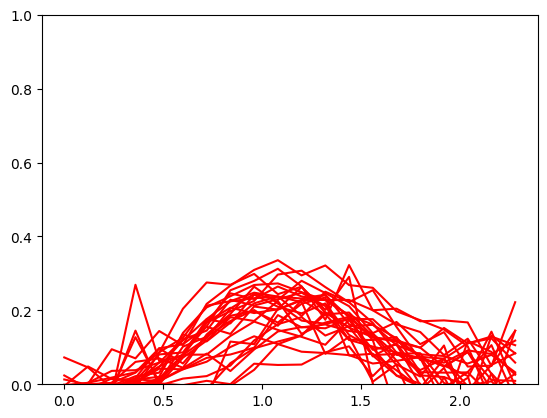

In [87]:
for i in range(27):
    plt.ylim([, 1])
    
    xdata = np.arange(20) * 0.12
    plt.plot(xdata, np.array(list(m44score['PPCPFCMSTscore'].values()))[i, :, 0], c='r')
    #plt.plot(xdata, np.array(list(m44score['PPCPFCMSTscore'].values()))[i, :, 1], c='k')
    #plt.plot(xdata, np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 2], c='g')
    #plt.plot(xdata, np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 3], c='b')

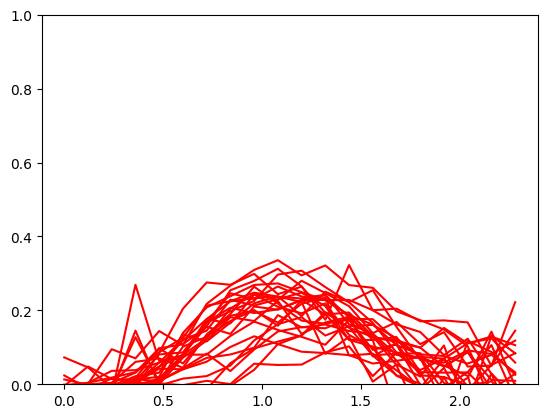

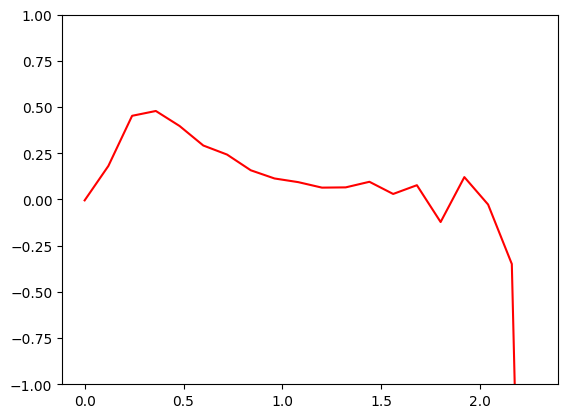

In [292]:
for i in range(25):
    plt.ylim([-1, 1])
    
    xdata = np.arange(20) * 0.12
    if i == 8:
        plt.plot(xdata, np.array(list(m53score['PPCPFCMSTscore'].values()))[i, :, 1], c='r')
    #plt.plot(xdata, np.array(list(m44score['PPCPFCMSTscore'].values()))[i, :, 1], c='k')
    #plt.plot(xdata, np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 2], c='g')
    #plt.plot(xdata, np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 3], c='b')

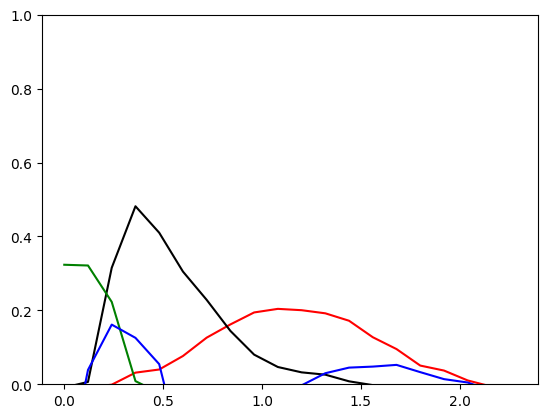

In [270]:
plt.ylim([0, 1])
plt.plot(xdata[:], np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 0], c='r')
plt.plot(xdata[:], np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 1], c='k')
plt.plot(xdata[:], np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 2], c='g')
plt.plot(xdata[:], np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 3], c='b')

In [295]:
np.array(list(m53score['PPCPFCMSTscore'].values()))

(25, 20, 4)

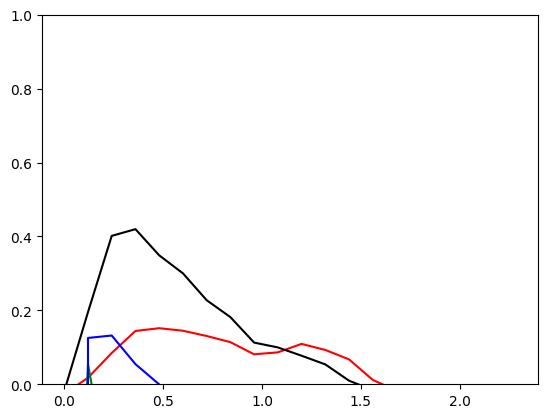

In [293]:
plt.ylim([0, 1])
plt.plot(xdata[:], 
         np.array(list(m53score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 0], c='r')
plt.plot(xdata[:], np.array(list(m53score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 1], c='k')
plt.plot(xdata[:], np.array(list(m53score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 2], c='g')
plt.plot(xdata[:], np.array(list(m53score['PPCPFCMSTscore'].values())).mean(axis=0)[:, 3], c='b')

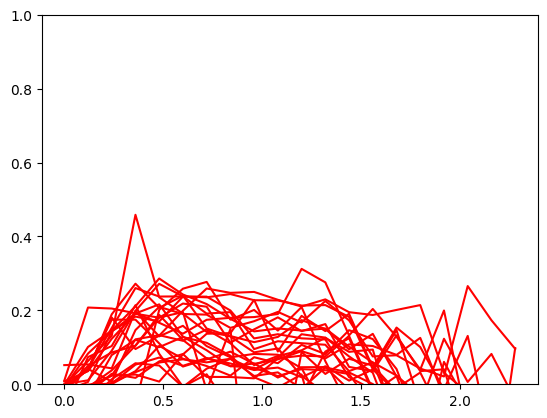

In [272]:
for i in range(25):
    plt.ylim([0, 1])
    
    xdata = np.arange(20) * 0.12
    plt.plot(xdata, np.array(list(m53score['PPCPFCMSTscore'].values()))[i, :, 0], c='r')
    #plt.plot(xdata, np.array(list(m44score['PPCPFCMSTscore'].values()))[i, :, 1], c='k')
    #plt.plot(xdata, np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 2], c='g')
    #plt.plot(xdata, np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 3], c='b')

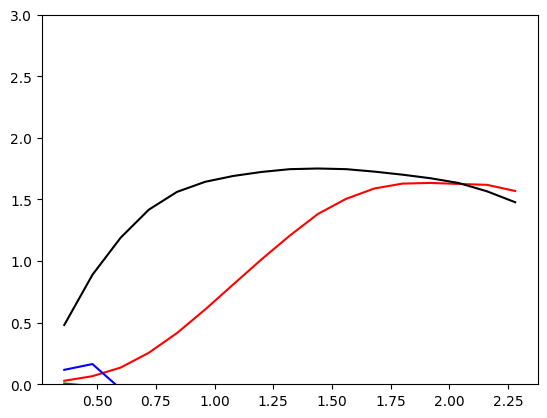

In [67]:
plt.ylim([0, 3])
plt.plot(xdata[3:], np.cumsum(np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[3:, 0]), c='r')
plt.plot(xdata[3:], np.cumsum(np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[3:, 1]), c='k')
plt.plot(xdata[3:], np.cumsum(np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[3:, 2]), c='g')
plt.plot(xdata[3:], np.cumsum(np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0)[3:, 3]), c='b')

In [58]:
np.array(list(m44score['PPCPFCMSTscore'].values())).mean(axis=0).shape

(20, 4)

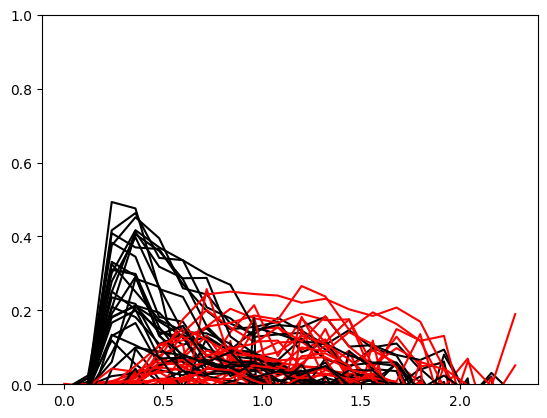

In [51]:
for i in range(31):
    plt.ylim([0, 1])
    xdata = np.arange(20) * 0.12
    plt.plot(xdata, np.array(list(m53score['PPCscore'].values()))[i, :, 0], c='r')
    plt.plot(xdata, np.array(list(m53score['PPCscore'].values()))[i, :, 1], c='k')
    #plt.plot(np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 2], c='g')
    #plt.plot(np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 3], c='b')

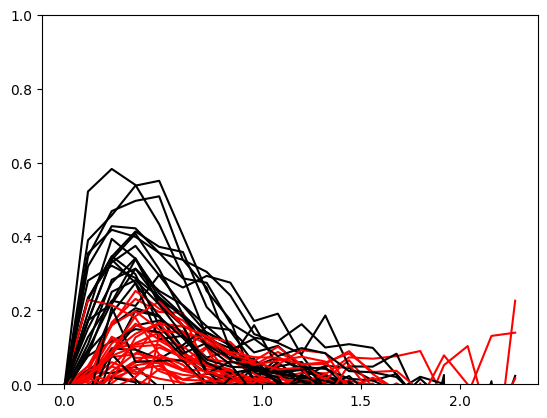

In [53]:
for i in range(30):
    plt.ylim([0, 1])
    xdata = np.arange(20) * 0.12
    plt.plot(xdata, np.array(list(m53score['PFCscore'].values()))[i, :, 0], c='r')
    plt.plot(xdata, np.array(list(m53score['PFCscore'].values()))[i, :, 1], c='k')
    #plt.plot(np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 2], c='g')
    #plt.plot(np.array(list(m_score['PPCPFCMSTscore'].values()))[i, :, 3], c='b')

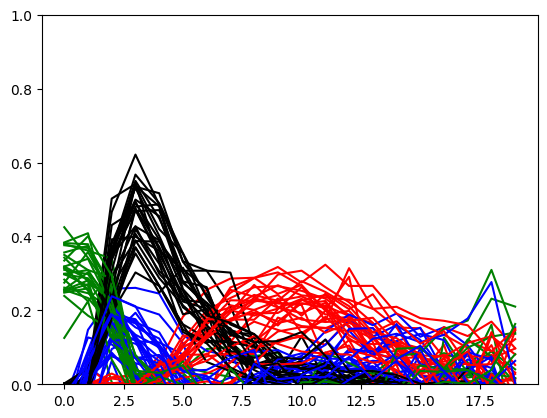

In [310]:
for i in range(27):
    plt.ylim([0, 1])
    plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 0], c='r')
    plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 1], c='k')
    plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 2], c='g')
    plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 3], c='b')

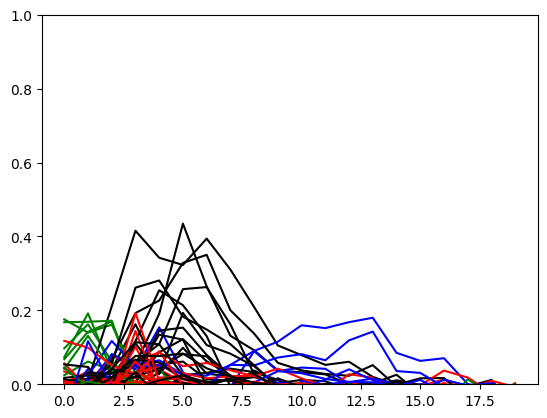

In [315]:
for i in range(27):
    plt.ylim([0, 1])
    try:
        plt.plot(np.array(list(m_score['MST'].values()))[i, :, 0], c='r')
        plt.plot(np.array(list(m_score['MST'].values()))[i, :, 1], c='k')
        plt.plot(np.array(list(m_score['MST'].values()))[i, :, 2], c='g')
        plt.plot(np.array(list(m_score['MST'].values()))[i, :, 3], c='b')
    except:
        1

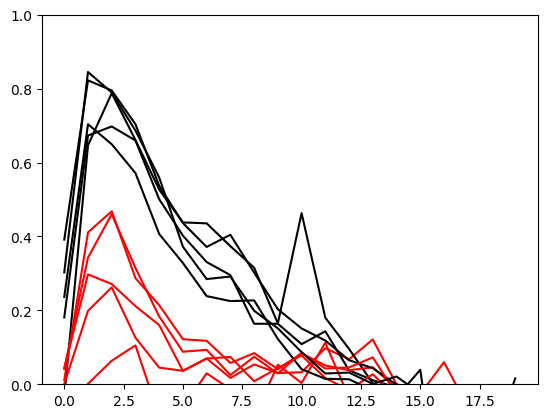

In [300]:
for i in range(5):
    plt.ylim([0, 1])
    plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 0], c='r')
    plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 1], c='k')
    #plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 2], c='g')
    #plt.plot(np.array(list(m_score['PPC'].values()))[i, :, 3], c='b')

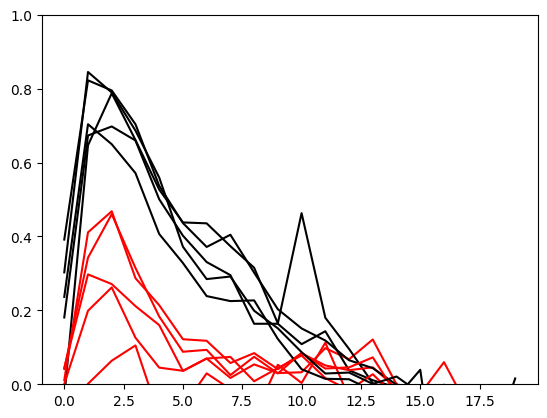

In [118]:
for i in range(5):
    plt.ylim([0, 1])
    plt.plot(np.vstack(list(m_score['PPC'].values()))[i], c='r')
    plt.plot(np.vstack(list(m_score2['PPC'].values()))[i], c='k')

In [186]:
num_bins=20; bin_size=20; error_threshold = 100
m_Xt = {}
for key, data in eval(m).items():
    if key[-1].isalpha():
        continue
    trials_behv = data['trials_behv'][0]
    trials_units = data['units'][0]
    units_area = np.array([v[0] for v in trials_units['brain_area']])
        
    Xt_area = {}; Yt_rel_dist_area = {}; Yt_rel_ang_area = {}
    Yt_abs_dist_area = {}; Yt_abs_ang_area = {}
    areas = np.hstack([np.unique(units_area), 'MSTPPCPFC'])
    for area in areas:
        Xt = [[] for _ in range(num_bins)]
        Yt = [[] for _ in range(num_bins)]
        area_mask = [v in area for v in units_area]

        for trial_idx, (trial_behv, trial_error) in enumerate(zip(trials_behv, eval(m)[key + 'error'])):
            if np.isnan(trial_error) or trial_error > error_threshold:
                continue

            trial_ts = trial_behv['continuous']['ts'][0][0].reshape(-1)
            t_mask = (trial_ts > 0) & (~np.isnan(trial_behv['continuous']['ymp'][0][0].reshape(-1)))
            t_mask &= trial_ts < trial_behv['events']['t_stop'][0][0].reshape(-1)
            # get X
            activity = eval(m)[key + 'neural'][trial_idx][t_mask][:, area_mask]
            activity = downsample(activity, bin_size=bin_size)
            # get Y
            target_variable1 = (trial_behv['continuous']['xfp'][0][0]-trial_behv['continuous']['xmp'][0][0]).reshape(-1)[t_mask]
            target_variable2 = (trial_behv['continuous']['yfp'][0][0]-trial_behv['continuous']['ymp'][0][0]).reshape(-1)[t_mask]
            #target_variable1 = (trial_behv['continuous']['xfp'][0][0]).reshape(-1)[t_mask]
            #target_variable2 = (trial_behv['continuous']['yfp'][0][0]).reshape(-1)[t_mask]
            target_variable = np.sqrt(target_variable1**2+target_variable2**2)
            #target_variable = np.arctan2(target_variable2, target_variable1)
            #target_variable = (trial_behv['continuous']['yre'][0][0]).reshape(-1)[t_mask]
            target_variable = downsample(target_variable.reshape(-1, 1), bin_size=bin_size)

            for bin_idx in range(num_bins):
                if activity.shape[0] > bin_idx:
                    Xt[bin_idx].append(activity[bin_idx])
                    Yt[bin_idx].append(target_variable[bin_idx])

        Xt_area[area] = Xt
        Yt_area[area] = Yt
        
    m_Xt[key + 'Xt'] = Xt_area
    m_Yt[key + 'Yt'] = Yt_area
    
eval(m).update(m_Xt); eval(m).update(m_Yt)

In [129]:
units_area = np.unique([np.unique(np.array([v[0] for v in data['units'][0]['brain_area']])) 
                        for key, data in eval(m).items() if key[-1].isdigit()])
units_area = np.hstack([units_area, 'MSTPPCPFC'])

ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (27,) + inhomogeneous part.

In [187]:
units_area = ['MST', 'PPC', 'VIP', 'MSTPPCPFC']
kf = KFold(n_splits=5)
m_score2 = {}
for area in units_area:
    scores_session = {}
    for key, data in eval(m).items():
        if key[-1].isalpha() or area not in eval(m)[key + 'Xt'].keys():
            continue
        
        Xt = eval(m)[key + 'Xt'][area]
        Yt = eval(m)[key + 'Yt'][area]
        scores = []
        for t in range(num_bins):
            X = np.vstack(Xt[t])
            Y = np.vstack(Yt[t])
            score = []
            for train_index, test_index in kf.split(X):
                model = RidgeCV()
                model.fit(X[train_index], Y[train_index])
                score.append(model.score(X[test_index], Y[test_index]))
            scores.append(np.mean(score))
        scores_session[key] = scores
    m_score2[area] = scores_session

KeyboardInterrupt: 

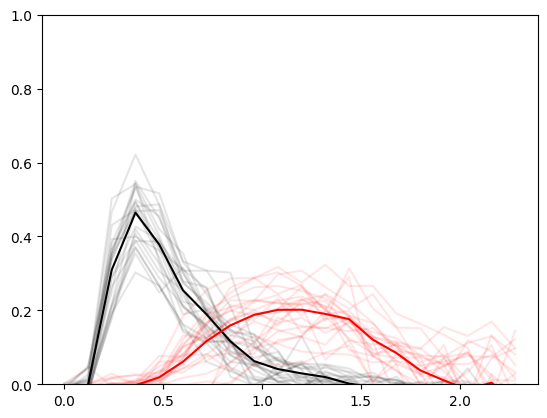

In [202]:
for i in range(23):
    plt.ylim([0, 1])
    plt.plot(np.arange(20) * bin_size * DT, np.vstack(list(m_score['PPC'].values()))[i], c='k', alpha=0.1)
    plt.plot(np.arange(20) * bin_size * DT, np.vstack(list(m_score2['PPC'].values()))[i], c='r', alpha=0.1)
    
plt.plot(np.arange(20) * bin_size * DT, np.vstack(list(m_score['PPC'].values())).mean(axis=0), c='k')
plt.plot(np.arange(20) * bin_size * DT, np.vstack(list(m_score2['PPC'].values())).mean(axis=0), c='r')

(0.0, 1.0)

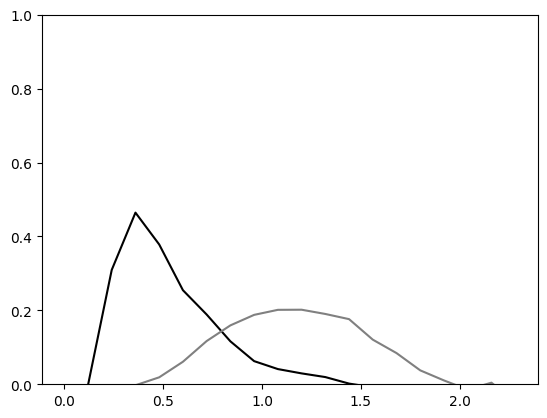

In [197]:
plt.plot(np.arange(20) * bin_size * DT, np.vstack(list(m_score['PPC'].values())).mean(axis=0), c='k')
plt.plot(np.arange(20) * bin_size * DT, np.vstack(list(m_score2['PPC'].values())).mean(axis=0), c='gray')
plt.ylim([0, 1])

In [196]:
np.vstack(list(m_score['PPC'].values())).mean(axis=0)

(20,)

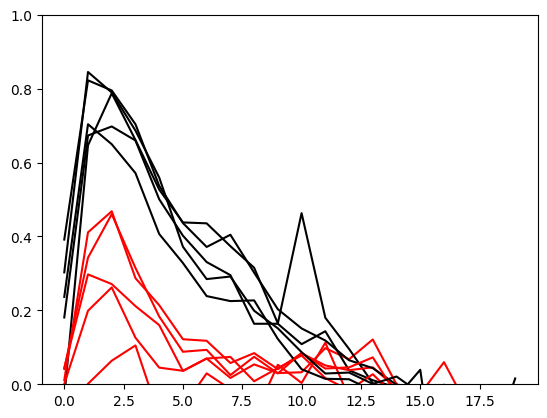

In [118]:
for i in range(5):
    plt.ylim([0, 1])
    plt.plot(np.vstack(list(m_score['PPC'].values()))[i], c='r')
    plt.plot(np.vstack(list(m_score2['PPC'].values()))[i], c='k')

In [77]:
kf = KFold(n_splits=5)
m_score = {}
for key, data in eval(m).items():
    if 'error' in key or 'neural' in key or 'Xt' in key or 'Yt' in key or 'score' in key:
        continue
        
    scores_area = {}
    for areakey, Xt in eval(m)[key + 'Xt'].items():
        Yt = eval(m)[key + 'Yt'][areakey]
        scores = []
        for t in range(num_bins):
            X = np.vstack(Xt[t])
            Y = np.vstack(Yt[t])
            score = []
            for train_index, test_index in kf.split(X):
                model = RidgeCV()
                model.fit(X[train_index], Y[train_index])
                score.append(model.score(X[test_index], Y[test_index]))
            scores.append(np.mean(score))
        scores_area[areakey] = scores
    m_score[key + 'score'] = scores_area
    
eval(m).update(m_score)

In [75]:
m_score.keys()

dict_keys(['m51s38score', 'm51s40score', 'm51s41score', 'm51s42score', 'm51s43score'])

In [78]:
m_score['m51s41score']

{'PPC': [0.011283705891083119,
  0.41106027450921373,
  0.468136815966197,
  0.287057969675793,
  0.21404146801184512,
  0.12188182812875488,
  0.11766209709044806,
  0.05756111117991332,
  0.08427422288823591,
  0.04088274384091808,
  0.08366405020973397,
  0.050997635220323745,
  0.03817498987736305,
  0.04580660894568804,
  -0.01088550499834311,
  -0.017187987653846236,
  -0.06101057360137583,
  -0.11663147761265098,
  -0.4327684670139423,
  -0.9867540929526125],
 'MSTPPCPFC': [0.011283705891083119,
  0.41106027450921373,
  0.468136815966197,
  0.287057969675793,
  0.21404146801184512,
  0.12188182812875488,
  0.11766209709044806,
  0.05756111117991332,
  0.08427422288823591,
  0.04088274384091808,
  0.08366405020973397,
  0.050997635220323745,
  0.03817498987736305,
  0.04580660894568804,
  -0.01088550499834311,
  -0.017187987653846236,
  -0.06101057360137583,
  -0.11663147761265098,
  -0.4327684670139423,
  -0.9867540929526125]}

In [66]:
np.array(list(m_score.values())).shape

(5, 2, 20)

In [ ]:
scores_area = []; kf = KFold(n_splits=5)
for Xt, Yt in zip(Xt_area, Yt_area):
    scores = []
    for t in range(num_bins):
        X = np.vstack(Xt[t])
        Y = np.vstack(Yt[t])
        score = []
        for train_index, test_index in kf.split(X):
            model = RidgeCV()
            model.fit(X[train_index], Y[train_index])
            score.append(model.score(X[test_index], Y[test_index]))
        scores.append(np.mean(score))
    scores_area.append(scores)

In [354]:
num_bins=20; bin_size=20; error_threshold = 100
print(num_bins * bin_size * DT)
Xt_area = []
Yt_area = []
areas = np.hstack([np.unique(units_area), 'MSTPPCPFC']) # the last contains all neurons
for area in areas:
    Xt = [[] for _ in range(num_bins)]
    Yt = [[] for _ in range(num_bins)]
    area_mask = [v in area for v in units_area]

    for trial_idx, (trial_behv, trial_error) in enumerate(zip(trials_behv, trials_error)):
        if trial_error > error_threshold:
            continue
        
        trial_ts = trial_behv['continuous']['ts'][0][0].reshape(-1)
        t_mask = (trial_ts > 0) & (~np.isnan(trial_behv['continuous']['ymp'][0][0].reshape(-1)))
        t_mask &= trial_ts < trial_behv['events']['t_stop'][0][0].reshape(-1)
        # get X
        activity = trials_neural[trial_idx][t_mask][:, area_mask]
        activity = downsample(activity, bin_size=bin_size)
        # get Y
        target_variable1 = (trial_behv['continuous']['xfp'][0][0]-trial_behv['continuous']['xmp'][0][0]).reshape(-1)[t_mask]
        target_variable2 = (trial_behv['continuous']['yfp'][0][0]-trial_behv['continuous']['ymp'][0][0]).reshape(-1)[t_mask]
        #target_variable1 = (trial_behv['continuous']['xfp'][0][0]).reshape(-1)[t_mask]
        #target_variable2 = (trial_behv['continuous']['yfp'][0][0]).reshape(-1)[t_mask]
        target_variable = np.sqrt(target_variable1**2+target_variable2**2)
        #target_variable = np.arctan2(target_variable2, target_variable1)
        #target_variable = (trial_behv['continuous']['yre'][0][0]).reshape(-1)[t_mask]
        target_variable = downsample(target_variable.reshape(-1, 1), bin_size=bin_size)
        
        for bin_idx in range(num_bins):
            if activity.shape[0] > bin_idx:
                Xt[bin_idx].append(activity[bin_idx])
                Yt[bin_idx].append(target_variable[bin_idx])
                
    Xt_area.append(Xt)
    Yt_area.append(Yt)

3.6


In [355]:
scores_area = []; kf = KFold(n_splits=5)
for Xt, Yt in zip(Xt_area, Yt_area):
    scores = []
    for t in range(num_bins):
        X = np.vstack(Xt[t])
        Y = np.vstack(Yt[t])
        score = []
        for train_index, test_index in kf.split(X):
            model = RidgeCV()
            model.fit(X[train_index], Y[train_index])
            score.append(model.score(X[test_index], Y[test_index]))
        scores.append(np.mean(score))
    scores_area.append(scores)

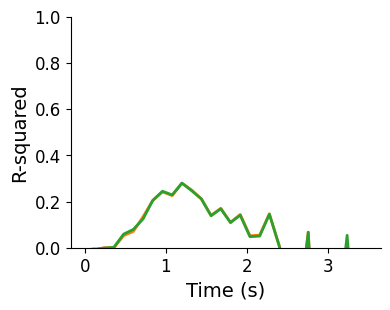

In [357]:
xdata = np.arange(np.array(scores).size) * bin_size * DT

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

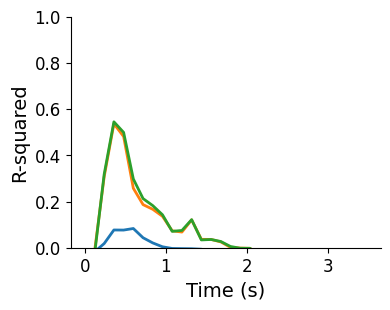

In [353]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

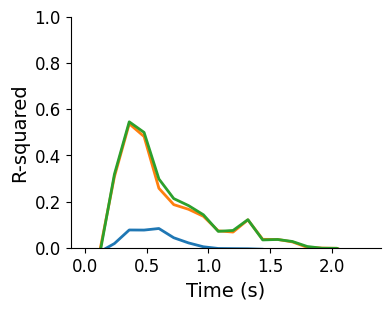

In [345]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

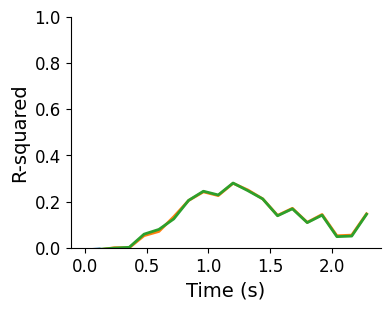

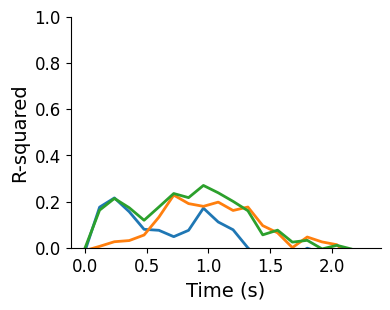

In [324]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

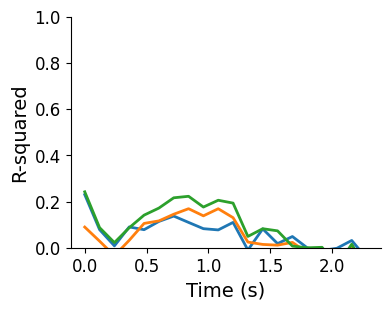

In [317]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

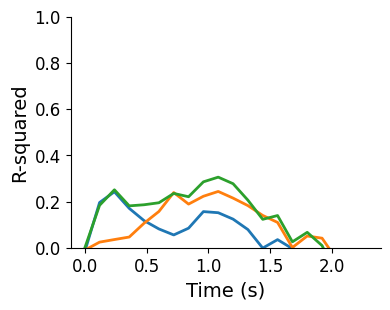

In [301]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

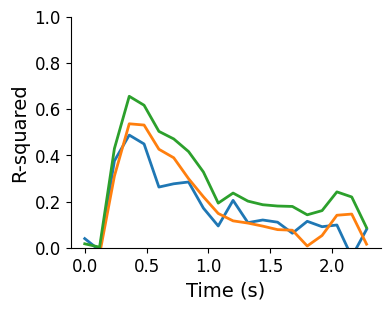

In [309]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

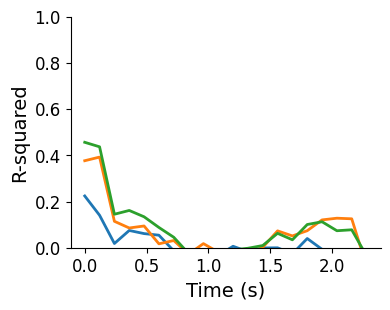

In [294]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

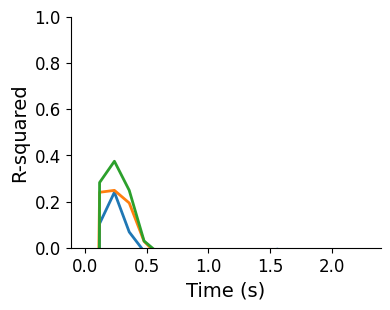

In [297]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

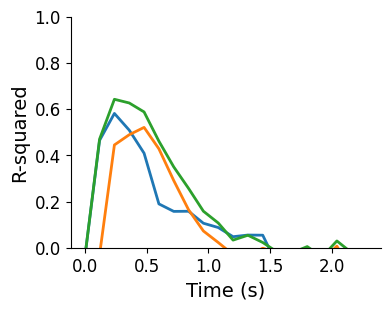

In [288]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

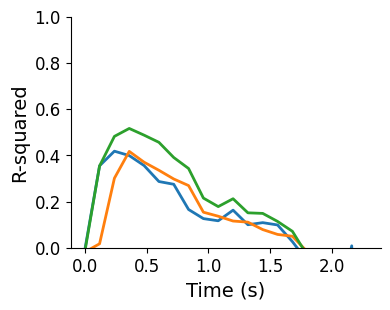

In [266]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

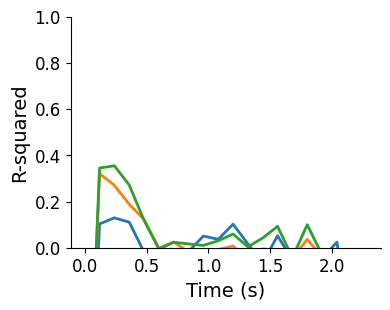

In [272]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

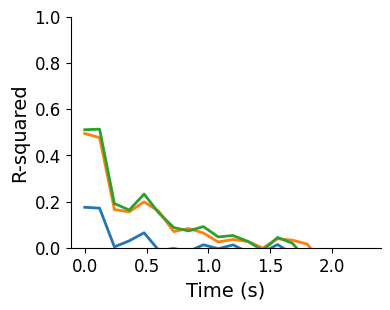

In [269]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

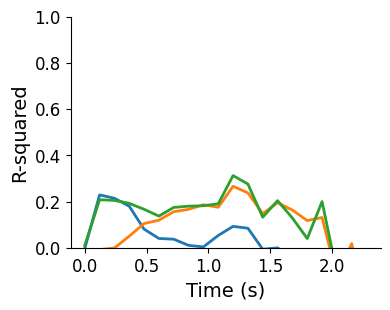

In [263]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

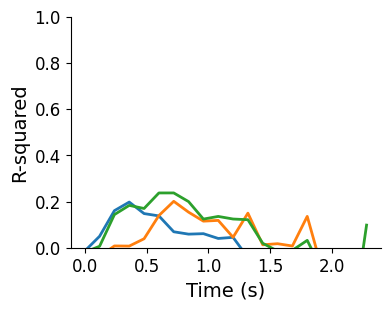

In [251]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

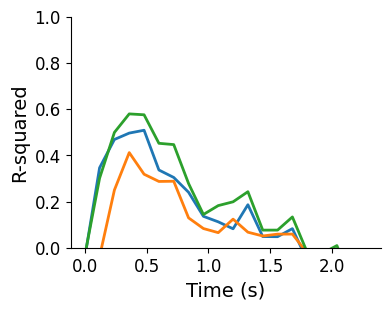

In [248]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

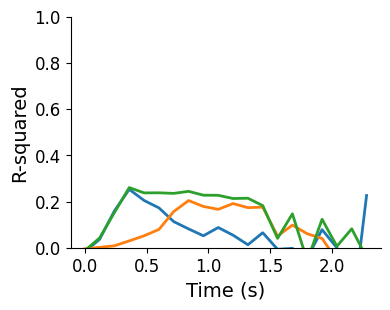

In [215]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

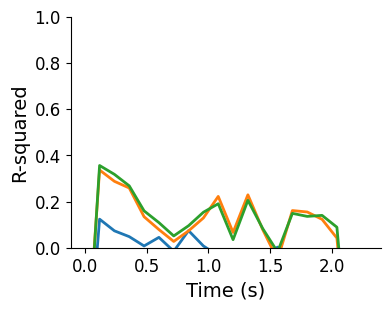

In [221]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

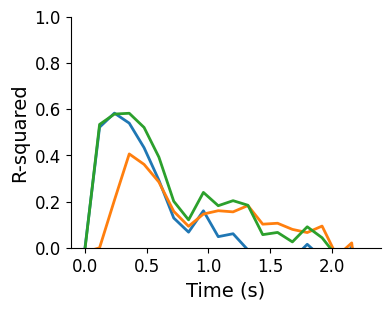

In [212]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

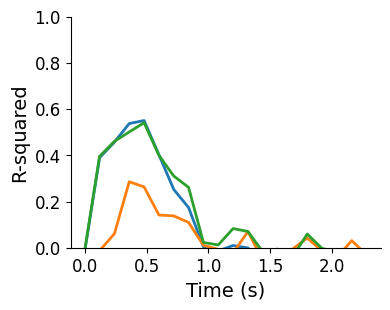

In [200]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

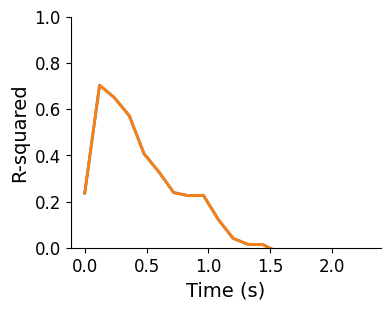

In [140]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

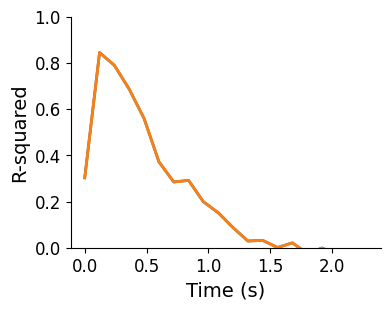

In [118]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

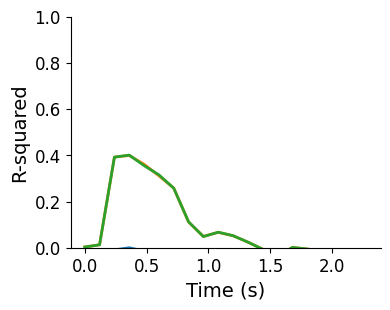

In [104]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

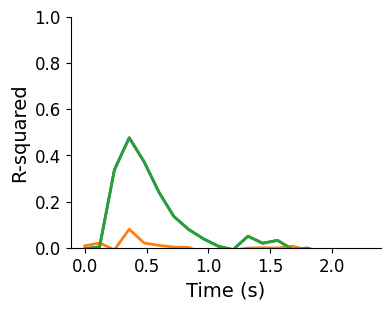

In [85]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

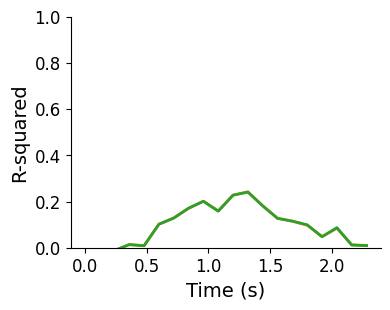

In [101]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

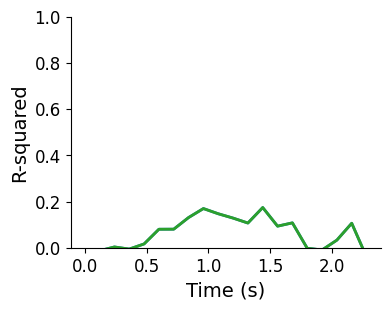

In [88]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

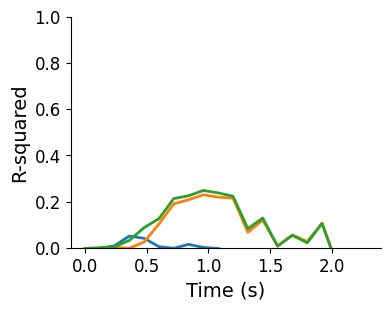

In [488]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

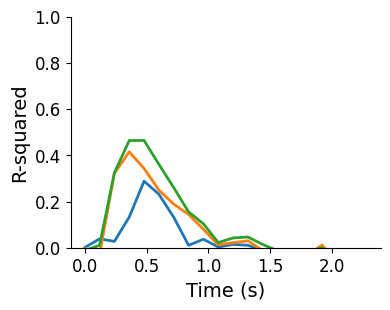

In [482]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

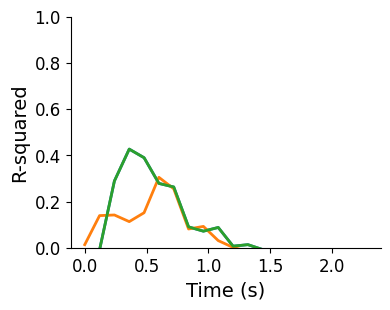

In [60]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

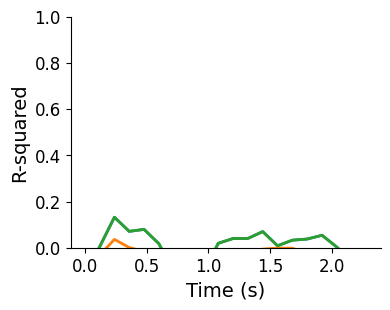

In [63]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

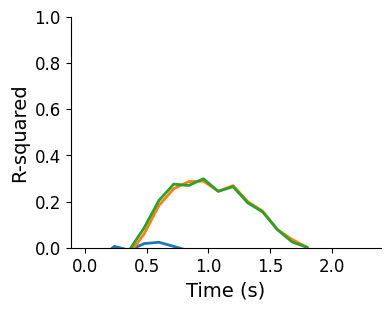

In [18]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

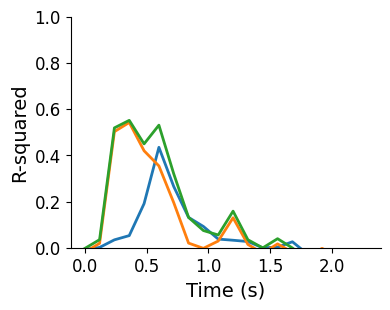

In [15]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

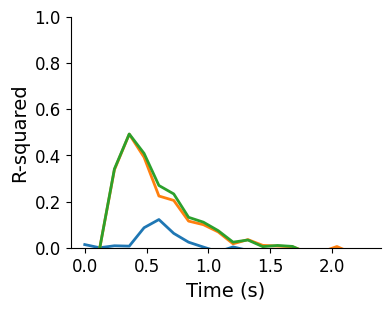

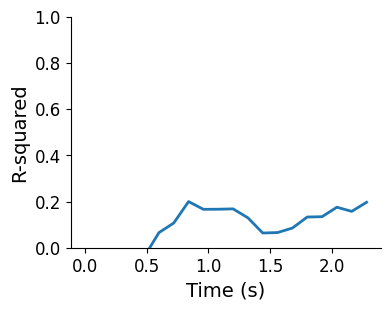

In [48]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
#ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

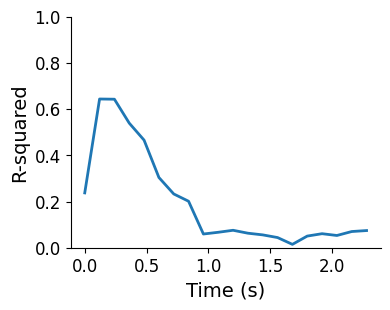

In [312]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
#ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

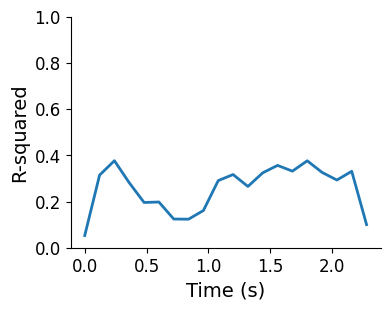

In [298]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
#ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

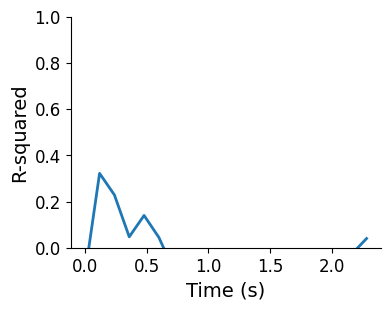

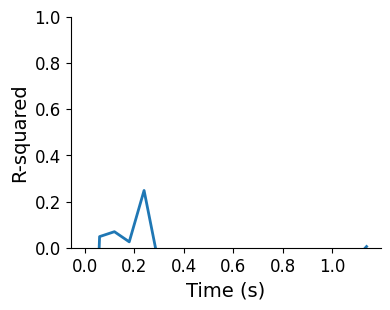

In [364]:
xdata = np.arange(np.array(scores).size) * 0.06

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
#ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

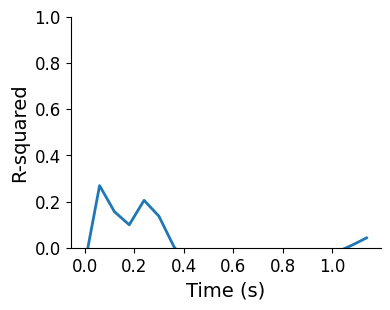

In [368]:
xdata = np.arange(np.array(scores).size) * 0.06

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
#ax.plot(xdata, scores_area[1], lw=2, c='C1')
#ax.plot(xdata, scores_area[2], lw=2, c='C2')

plt.show()

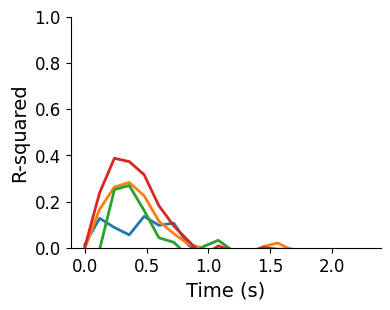

In [33]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')
ax.plot(xdata, scores_area[3], lw=2, c='C3')

plt.show()

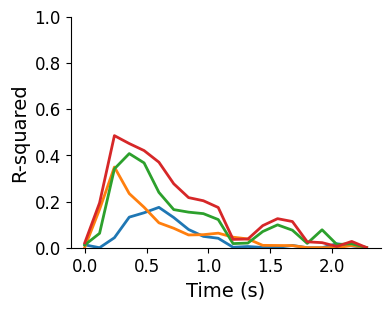

In [142]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')
ax.plot(xdata, scores_area[3], lw=2, c='C3')

plt.show()

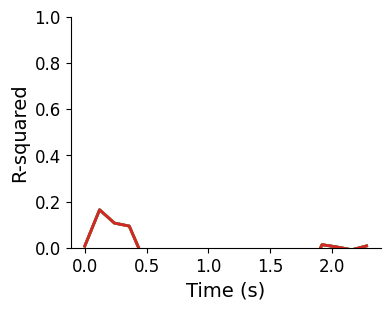

In [215]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')
ax.plot(xdata, scores_area[3], lw=2, c='C3')

plt.show()

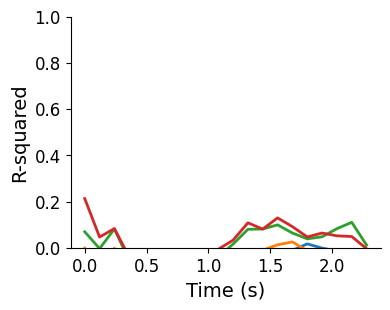

In [188]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='C0')
ax.plot(xdata, scores_area[1], lw=2, c='C1')
ax.plot(xdata, scores_area[2], lw=2, c='C2')
ax.plot(xdata, np.array(scores_area[3]), lw=2, c='C3')

plt.show()

In [313]:
num_bins = 20
areas = ['PPC', 'PFC']
Xt_area = []
Yt_area = []
for area in areas:
    Xt = [[] for _ in range(num_bins)]
    Yt = [[] for _ in range(num_bins)]
    area_mask = np.array([data['units'][0][unit_idx][7][0] for unit_idx in range(len(data['units'][0]))]) == area
    print(area_mask.sum())
    for trial_idx in range(len(trials_behv)):
        #if trials_behv[trial_idx][2][0][0][0][0][0]: # if rewarded
        t = trials_behv[trial_idx][0][0][0][12].flatten()
        #t = trials_behv[trial_idx][0][0][0][10].flatten()
        mask = (t > 0) & (~np.isnan(trials_behv[trial_idx][0][0][0][4]).flatten())
        activity = trials_neural[trial_idx][mask][:, area_mask]
        downsampled_activity = downsample(activity)
        target_variable1 = (trials_behv[trial_idx][0][0][0][4]-trials_behv[trial_idx][0][0][0][6]).flatten()[mask]
        target_variable2 = (trials_behv[trial_idx][0][0][0][5]-trials_behv[trial_idx][0][0][0][7]).flatten()[mask]
        target_variable = np.sqrt(target_variable1**2 + target_variable2**2)
        if (target_variable[-1] < 80):
            target_variable1 = (trials_behv[trial_idx][0][0][0][6]).flatten()[mask]
            target_variable2 = (trials_behv[trial_idx][0][0][0][7]).flatten()[mask]
            #target_variable = np.sqrt(target_variable1**2 + target_variable2**2)
            target_variable = np.arctan2(target_variable2, target_variable1)
            #target_variable = (trials_behv[trial_idx][0][0][0][1]).flatten()[mask]
            #target_variable[np.isnan(target_variable)] = target_variable[~np.isnan(target_variable)].mean()
            downsampled_target = downsample(target_variable.reshape(-1, 1))

            for bin_idx in range(num_bins):
                try:
                    Xt[bin_idx].append(downsampled_activity[bin_idx])
                    Yt[bin_idx].append(downsampled_target[bin_idx])
                except:
                    1
    Xt_area.append(Xt)
    Yt_area.append(Yt)

48
22


In [314]:
scores_area = []
for Xt, Yt in zip(Xt_area, Yt_area):
    scores = []
    for t in range(num_bins):
        model = RidgeCV()
        X = np.vstack(Xt[t])
        Y = np.vstack(Yt[t])
        training_idx = int(X.shape[0] * 0.7)
        model.fit(X[:training_idx], Y[:training_idx])
        scores.append((model.score(X[training_idx:], Y[training_idx:])))
    scores_area.append(scores)

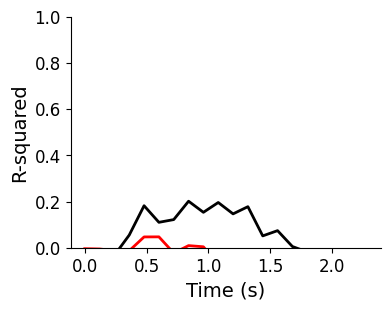

In [226]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='k')
ax.plot(xdata, scores_area[1], lw=2, c='r')

plt.show()

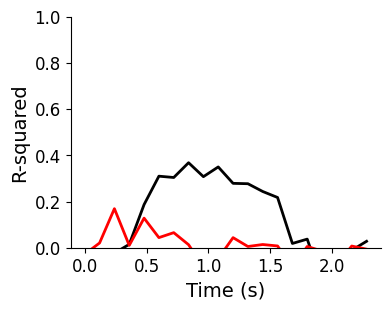

In [268]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='k')
ax.plot(xdata, scores_area[1], lw=2, c='r')

plt.show()

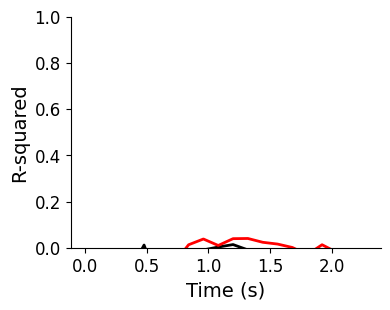

In [312]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='k')
ax.plot(xdata, scores_area[1], lw=2, c='r')

plt.show()

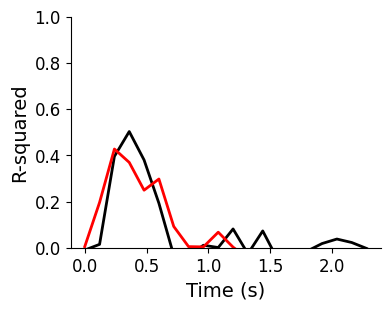

In [229]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='k')
ax.plot(xdata, scores_area[1], lw=2, c='r')

plt.show()

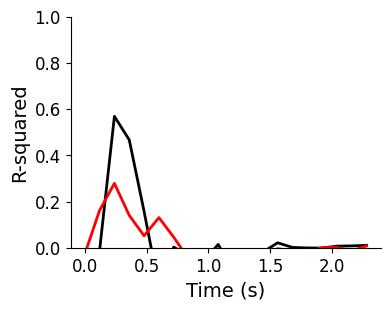

In [271]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='k')
ax.plot(xdata, scores_area[1], lw=2, c='r')

plt.show()

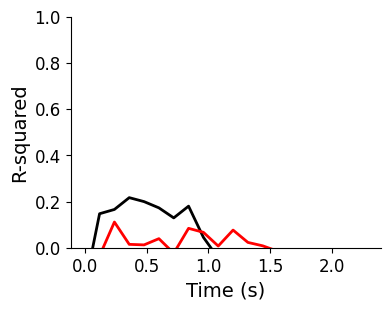

In [316]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores_area[0], lw=2, c='k')
ax.plot(xdata, scores_area[1], lw=2, c='r')

plt.show()

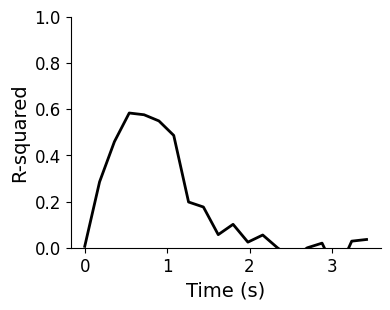

In [1630]:
xdata = np.arange(np.array(scores).size) * 0.18

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

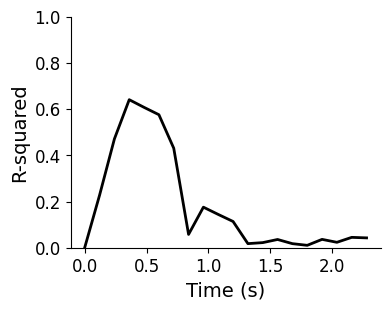

In [1638]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

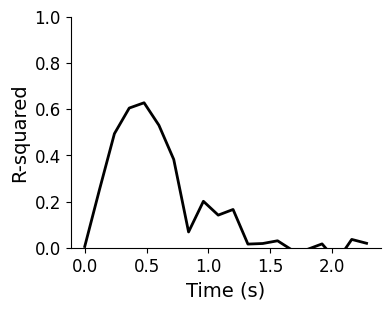

In [1659]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

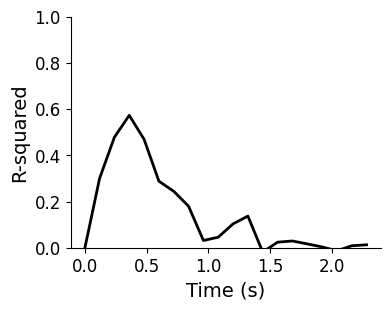

In [1459]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

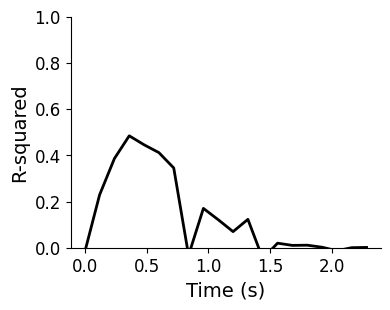

In [1468]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

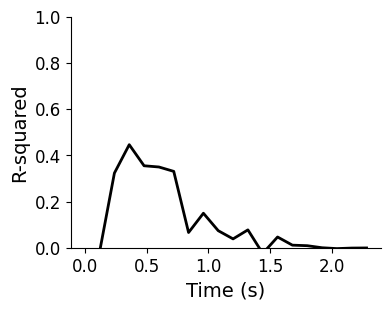

In [1485]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

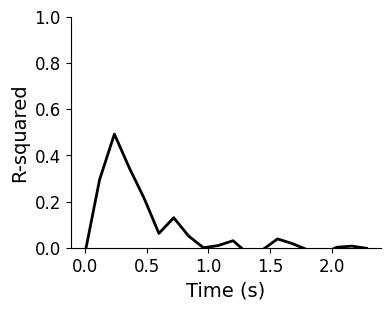

In [1499]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

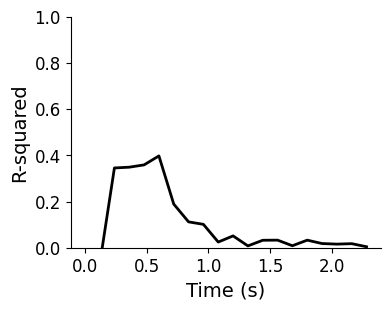

In [1503]:
xdata = np.arange(np.array(scores).size) * 0.12

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

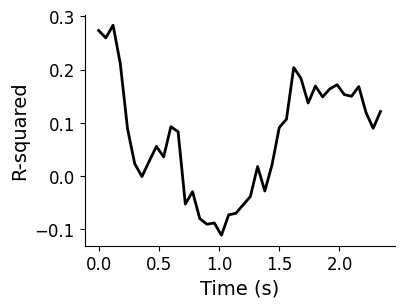

In [842]:
xdata = np.arange(np.array(scores).size) * 0.06

fontsize = 12
fig = plt.figure(figsize=(4, 3))

ax = fig.add_subplot(111)
ax.spines['top'].set_visible(False); ax.spines['right'].set_visible(False)
_ = ax.set_ylabel('R-squared', fontsize=fontsize + 2)
_ = ax.set_xlabel('Time (s)', fontsize=fontsize + 2)
_ = plt.xticks(fontsize=fontsize)
_ = plt.yticks(fontsize=fontsize)
#ax.set_ylim([0, 1])

ax.plot(xdata, scores, lw=2, c='k')

plt.show()

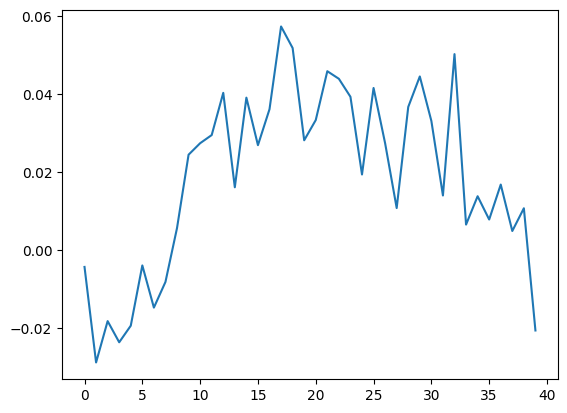

In [809]:
plt.plot(scores)

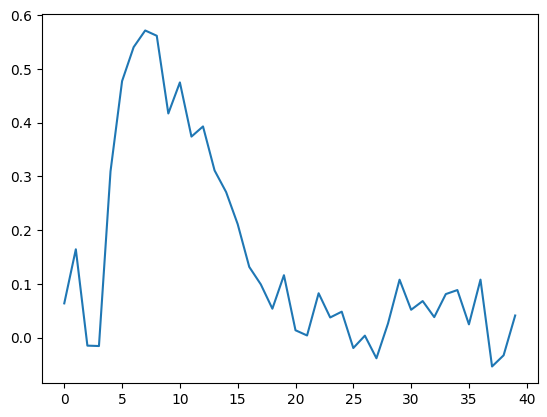

In [536]:
plt.plot(scores)

In [333]:
target_variable

array([268.43716, 268.39337, 268.2933 , 268.28973, 268.4221 , 268.21344,
       268.1872 , 268.50906, 268.4459 , 268.48883, 268.5949 , 268.4626 ,
       268.46613, 268.2337 , 268.1503 , 268.40897, 268.42566, 268.217  ,
       268.49594, 268.53888, 268.56512, 268.62473, 268.3994 , 268.32666,
       268.41608, 268.27307, 268.3923 , 268.44232, 268.3696 , 268.55554,
       268.50906, 268.41254, 268.76065, 268.39584, 268.31   , 268.3696 ,
       268.3029 , 268.51508, 268.50195, 268.35648, 268.6652 , 268.6783 ,
       268.36603, 268.68436, 268.47214, 268.32312, 268.2337 , 268.27307,
       268.48526, 268.70102, 268.35648, 268.6056 , 268.695  , 268.459  ,
       268.56155, 268.34937, 268.23013, 268.2635 , 268.19678, 268.27307,
       268.6712 , 268.47925, 268.5889 , 268.55554, 268.5222 , 268.43878,
       268.33267, 268.10736, 268.43277, 268.33624, 268.31955, 268.51862,
       268.5222 , 268.54242, 268.46613, 268.30643, 268.45547, 268.3923 ,
       268.03107, 268.33978, 268.3529 , 268.47214, 

In [914]:
# get good trials
GoodRealX = []
GoodRealY = []
GoodRealX_shift = []
GoodRealY_shift = []
    
for i in range(1502):   
    if behv_stats[0][4][0][0][0][0][0][0][0][i]:       #good trials
        xp = trials_behv[i][0][0][0][6]
        yp = trials_behv[i][0][0][0][7]
        t = trials_behv[i][0][0][0][12]
        stop_point = trials_behv[i][1][0][0][3][0][0]
        xpp = xp[(t > 0) & (t < stop_point)]
        xpp = xpp[np.logical_not(np.isnan(xpp))]
        xpp = savgol_filter(xpp,9,1)
        GoodRealX.append(xpp)
        xpp = xpp - xpp[0]
        GoodRealX_shift.append(xpp)
        ypp = yp[(t > 0) & (t < stop_point)]
        ypp = ypp[np.logical_not(np.isnan(ypp))]
        ypp = savgol_filter(ypp,9,1)
        GoodRealY.append(ypp)
        ypp = ypp - ypp[0]
        GoodRealY_shift.append(ypp)

IndexError: invalid index to scalar variable.

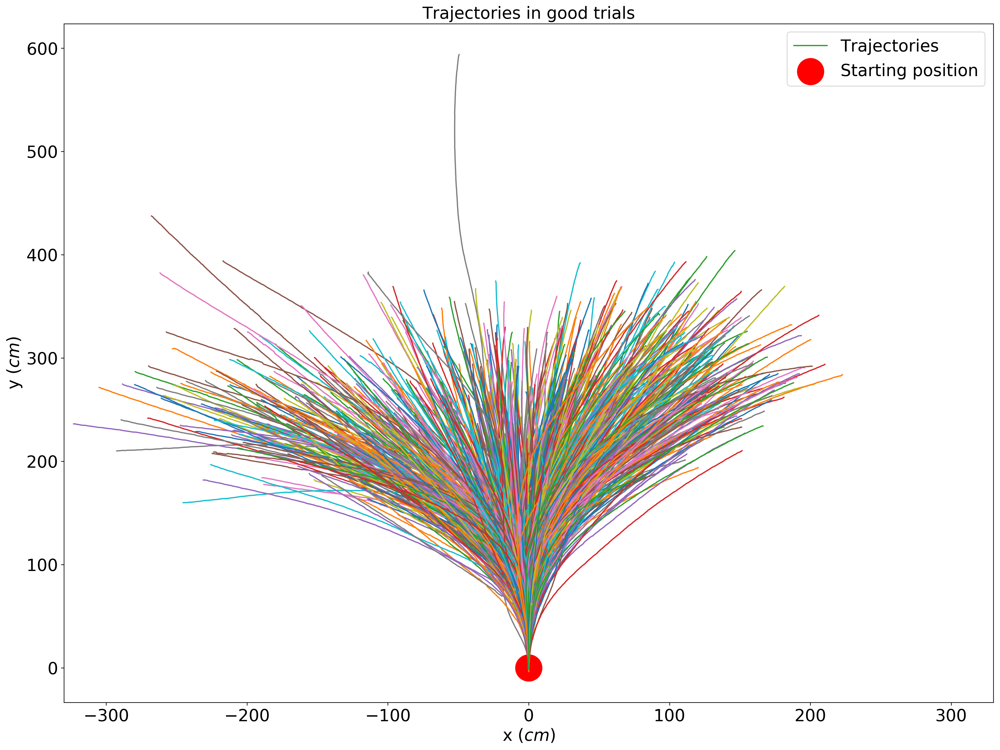

In [410]:
with initiate_plot(20,15,300):
    
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Trajectories in good trials',fontsize=20)
    plt_config(xlabel='x ($cm$)', ylabel='y ($cm$)', xlim=[-330, 330])
    ax.scatter(0, 0, marker='o', s=1000, color="red", label='Starting position')
    for i in range(len(GoodRealX_shift)-1):
        ax.plot(GoodRealX_shift[i],GoodRealY_shift[i])
        
    ax.plot(GoodRealX_shift[-1],GoodRealY_shift[-1], label='Trajectories')
    ax.legend(fontsize=20)
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Trajectories_in_good_trials'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)
   


In [231]:
#get good FF position
GoodFFX = []
GoodFFY = []
for i in range(1502):
    if behv_stats[0][4][0][0][0][0][0][0][0][i]: 
        xp = np.nanmedian(trials_behv[i][0][0][0][4])
        yp = np.nanmedian(trials_behv[i][0][0][0][5])
        GoodFFX.append(xp)
        GoodFFY.append(yp)

In [233]:
#get reward trials
RewardX = []
RewardY = []
RewardX_shift = []
RewardY_shift = []
unRewardX = []
unRewardY = []
unRewardX_shift = []
unRewardY_shift = []

for i in range(1502):   
    xp = trials_behv[i][0][0][0][6]
    yp = trials_behv[i][0][0][0][7]
    t = trials_behv[i][0][0][0][12]
    stop_point = trials_behv[i][1][0][0][3][0][0]
    xpp = xp[(t > 0) & (t < stop_point)]
    xpp = xpp[np.logical_not(np.isnan(xpp))]
    ypp = yp[(t > 0) & (t < stop_point)]
    ypp = ypp[np.logical_not(np.isnan(ypp))]
    if trials_behv[i][2][0][0][0][0][0]:       #reward trials
        xpp = savgol_filter(xpp,9,1)
        RewardX.append(xpp)
        xpp = xpp - xpp[0]
        RewardX_shift.append(xpp)
        ypp = savgol_filter(ypp,9,1)
        RewardY.append(ypp)
        ypp = ypp - ypp[0]
        RewardY_shift.append(ypp)
    else:
        unRewardX.append(xpp)
        xpp = xpp - xpp[0]
        unRewardX_shift.append(xpp)
        unRewardY.append(ypp)
        ypp = ypp - ypp[0]
        unRewardY_shift.append(ypp)

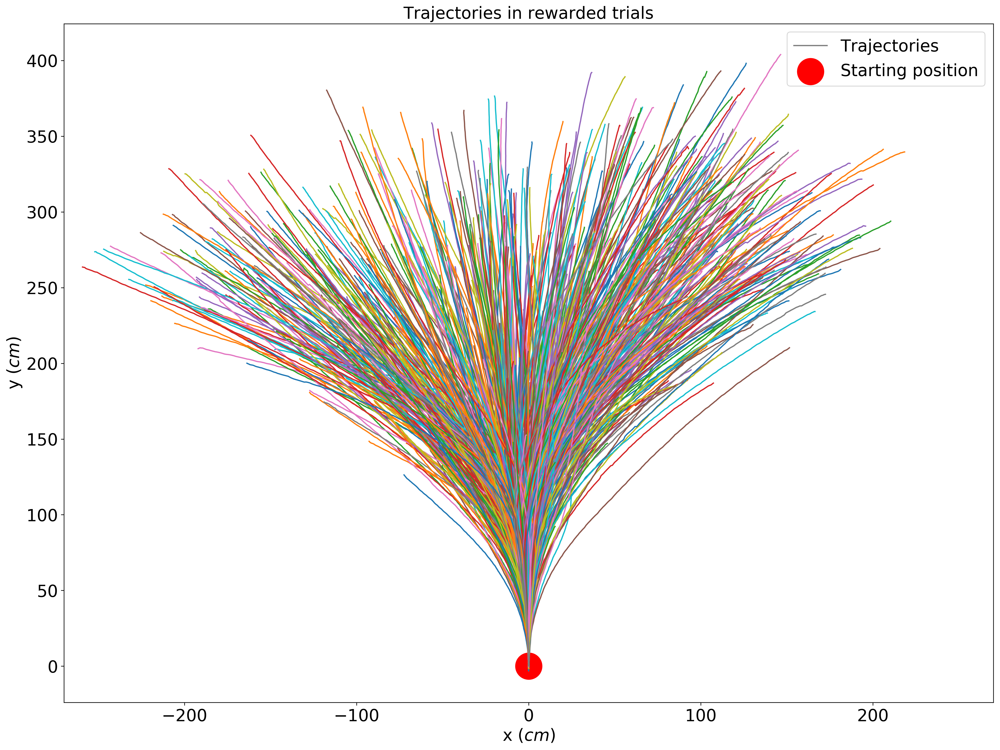

In [411]:
with initiate_plot(20,15,300):
    
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Trajectories in rewarded trials',fontsize=20)
    plt_config(xlabel='x ($cm$)', ylabel='y ($cm$)', xlim=[-270, 270])
    ax.scatter(0, 0, marker='o', s=1000, color="red", label='Starting position')
    for i in range(len(RewardX_shift)-1):
        ax.plot(RewardX_shift[i],RewardY_shift[i])
        
    ax.plot(RewardX_shift[-1],RewardY_shift[-1], label='Trajectories')
    ax.legend(fontsize=20)   
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Trajectories_in_rewarded_trials'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

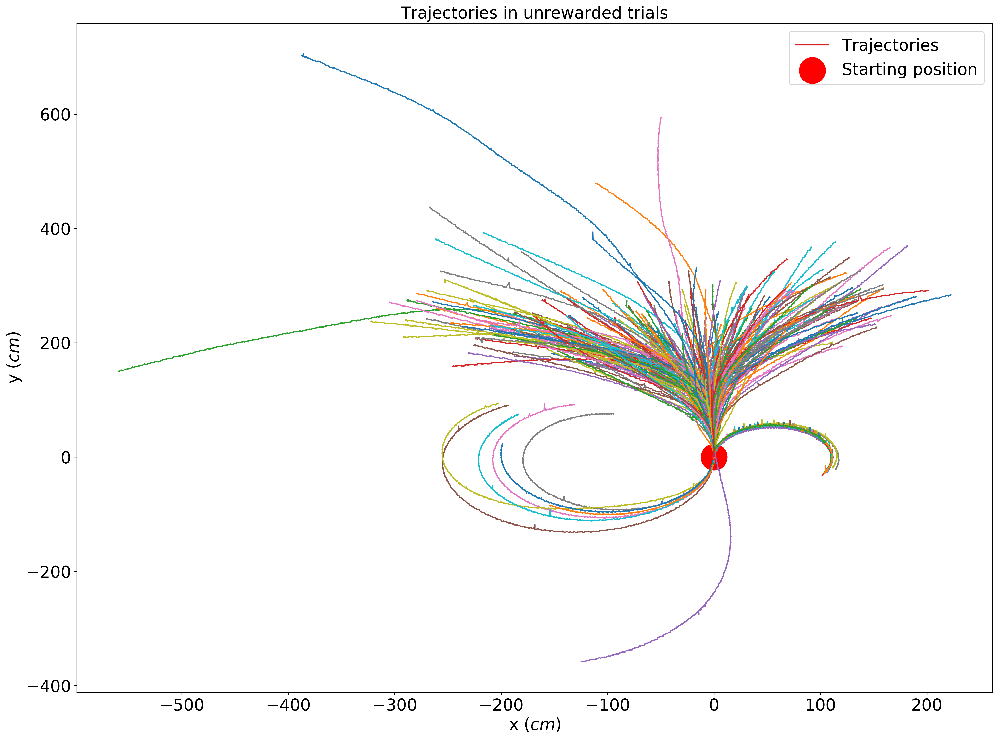

In [412]:
with initiate_plot(20,15,300):
    
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Trajectories in unrewarded trials',fontsize=20)
    plt_config(xlabel='x ($cm$)', ylabel='y ($cm$)')
    ax.scatter(0, 0, marker='o', s=1000, color="red", label='Starting position')
    for i in range(len(unRewardX_shift)-1):
        ax.plot(unRewardX_shift[i],unRewardY_shift[i])
        
    ax.plot(unRewardX_shift[-1],unRewardY_shift[-1], label='Trajectories')
    ax.legend(fontsize=20)   
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Trajectories_in_unrewarded_trials'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

In [239]:
#get reward FF position
RewardFFX = []
RewardFFY = []
unRewardFFX = []
unRewardFFY = []
for i in range(1502):
    if trials_behv[i][2][0][0][0][0][0]: 
        xp = np.nanmedian(trials_behv[i][0][0][0][4])
        yp = np.nanmedian(trials_behv[i][0][0][0][5])
        RewardFFX.append(xp)
        RewardFFY.append(yp)
    else:
        unRewardFFX.append(xp)
        unRewardFFY.append(yp)

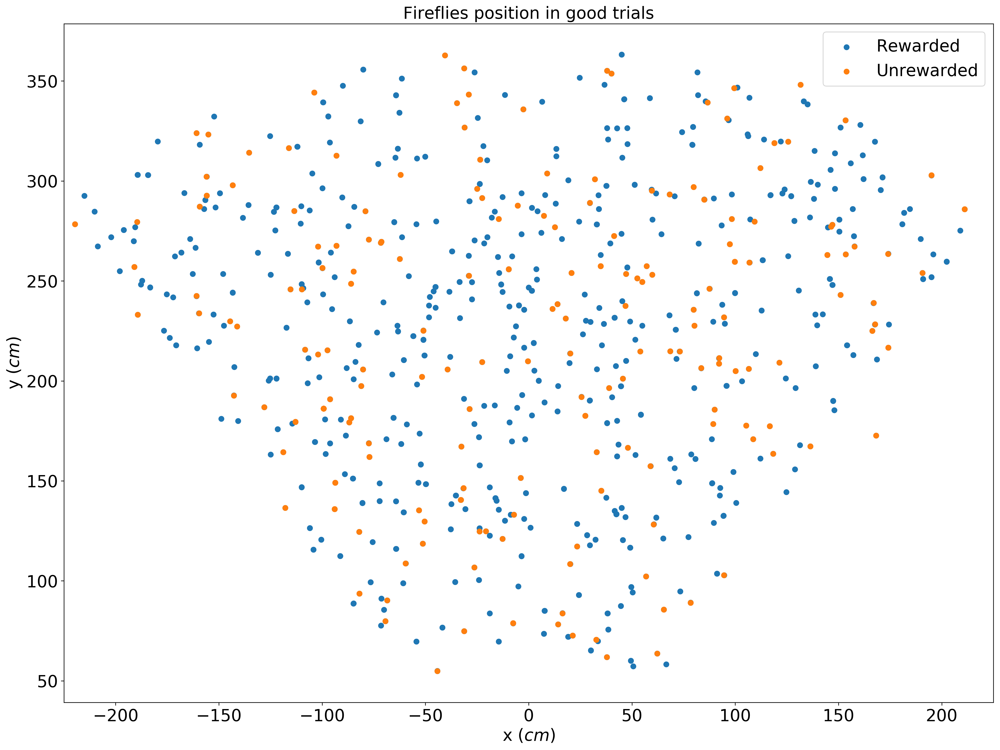

In [413]:
with initiate_plot(20,15,300):
    
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Fireflies position in good trials',fontsize=20)
    plt_config(xlabel='x ($cm$)', ylabel='y ($cm$)', xlim=[-225, 225])
    
    ax.scatter(RewardFFX,RewardFFY,label = 'Rewarded')
    ax.scatter(unRewardFFX,unRewardFFY,label = 'Unrewarded')
    ax.legend(fontsize=20)
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Fireflies_position_in_good_trials'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

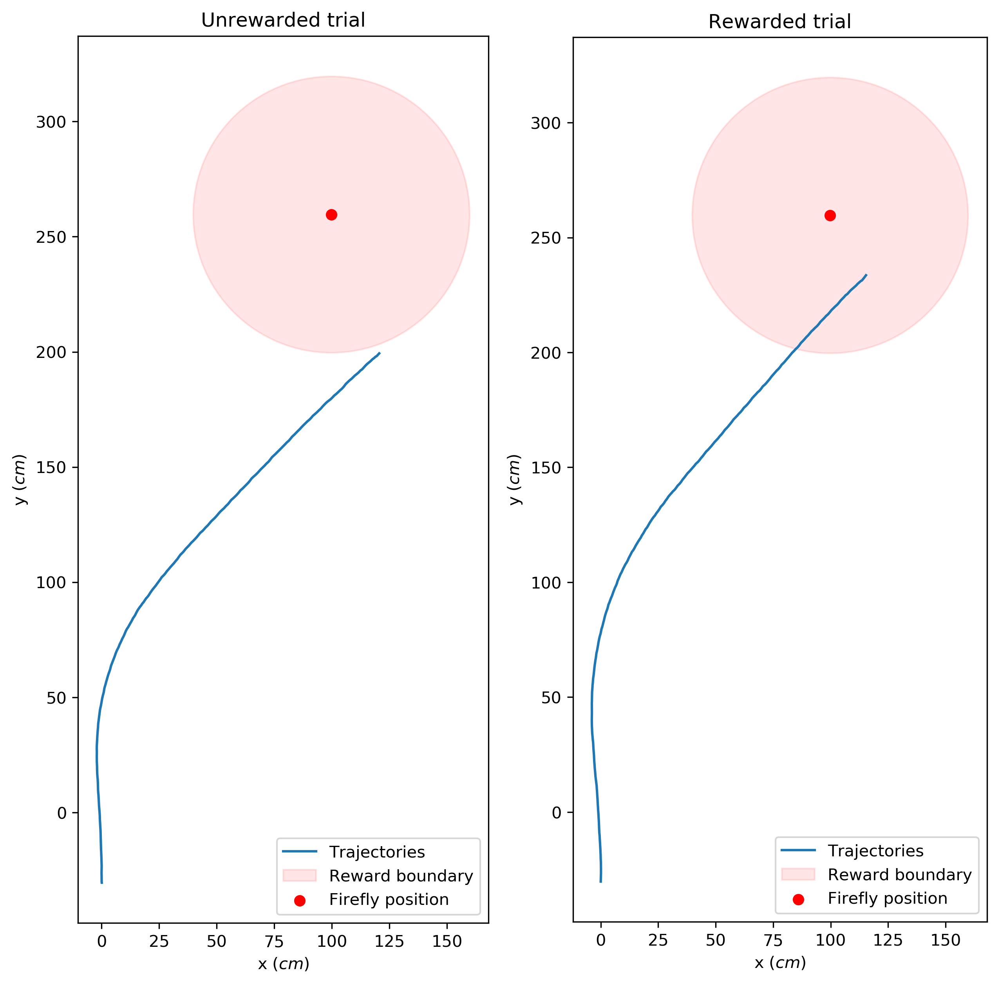

In [409]:
# an example of reward/unreward trials
with initiate_plot(10,10,300):
    ax = fig.add_subplot(121)
    ax.set_title('Unrewarded trial')
    plt_config(xlabel='x ($cm$)', ylabel='y ($cm$)')
    ax.plot(savgol_filter(unRewardX[11],9,1),savgol_filter(unRewardY[11],9,1),label='Trajectories')
    ax.scatter(unRewardFFX[11],unRewardFFY[11],label='Firefly position',c='r')
    cir1 = Circle(xy = (unRewardFFX[11],unRewardFFY[11]), radius=60, alpha=0.1,label='Reward boundary',color='r')
    ax.add_patch(cir1)
    ax.legend(fontsize=10)
    plt.axis('scaled') 
    
    axt = fig.add_subplot(122)
    axt.set_title('Rewarded trial')
    plt_config(xlabel='x ($cm$)', ylabel='y ($cm$)')
    axt.plot(RewardX[11],RewardY[11],label='Trajectories')
    axt.scatter(RewardFFX[11],RewardFFY[11],label='Firefly position',c='r')
    cir1 = Circle(xy = (RewardFFX[11],RewardFFY[11]), radius=60, alpha=0.1,label='Reward boundary',color='r')
    axt.add_patch(cir1)
    axt.legend(fontsize=10)
    plt.axis('scaled')  
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Trial_examples'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

In [300]:
#r vs r*, theta vs theta*
Good_monkey_final_R = []
Good_monkey_final_theta = []
Good_target_final_R = []
Good_target_final_theta = []
for i in range(1502):
    if behv_stats[0][4][0][0][0][0][0][0][0][i]:
        Good_monkey_final_R.append(behv_stats[0][1][0][0][0][0][i])
        Good_monkey_final_theta.append(behv_stats[0][1][0][0][1][0][i])
        Good_target_final_R.append(behv_stats[0][1][0][0][2][0][i])
        Good_target_final_theta.append(behv_stats[0][1][0][0][3][0][i])

In [352]:
r_target =  Good_target_final_R
r_monkey =  Good_monkey_final_R
model_r = LinearRegression()
model_r.fit(np.reshape(r_target,[len(r_target),1]), np.reshape(r_monkey,[len(r_monkey),1]))
r_monkey_predict = model_r.predict(np.reshape(r_target,[len(r_target),1]))
k_r = model_r.coef_[0][0]
b_r = model_r.intercept_[0]

theta_target =  Good_target_final_theta
theta_monkey =  Good_monkey_final_theta
model_theta = LinearRegression()
model_theta.fit(np.reshape(theta_target,[len(theta_target),1]), np.reshape(theta_monkey,[len(theta_monkey),1]))
theta_monkey_predict = model_theta.predict(np.reshape(theta_target,[len(theta_target),1]))
k_theta = model_theta.coef_[0][0]
b_theta = model_theta.intercept_[0]


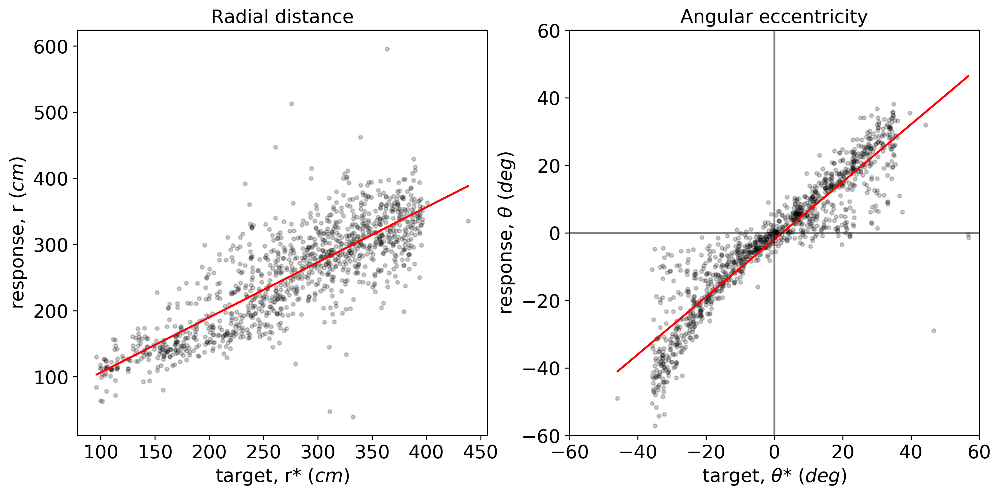

In [425]:
with initiate_plot(13,6,300):
    ax = fig.add_subplot(121)
    ax.set_title('Radial distance',fontsize=15)
    ax.set_xlabel(...,fontsize=15)
    ax.set_ylabel(...,fontsize=15)
    plt_config(xlabel='target, r* ($cm$)', ylabel='response, r ($cm$)')
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    ax.plot(r_target,r_monkey_predict,c = "r")
    ax.scatter(r_target,r_monkey,marker = '.',alpha = 0.2,c = "k")
    
    
    axt = fig.add_subplot(122)
    axt.set_title('Angular eccentricity',fontsize=15)
    axt.set_xlabel(...,fontsize=15)
    axt.set_ylabel(...,fontsize=15)
    plt_config(xlabel=(r'target, $\theta$* ($deg$)'), ylabel=(r'response, $\theta$ ($deg$)'),xlim=[-60, 60],ylim=[-60, 60])
    plt.xticks(fontsize=15)
    plt.yticks(fontsize=15)
    axt.plot(theta_target,theta_monkey_predict,c = "r")
    axt.plot([0,0],[-10000,10000],c = "k",alpha = 0.5)
    axt.plot([-10000,10000],[0,0],c = "k",alpha = 0.5)
    axt.scatter(theta_target,theta_monkey,marker = '.',alpha = 0.2,c = "k")
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='r_theta'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

In [11]:
#neuron data smoothing
neuron_data_smoothed = np.ones((len(neuron_data[0][1].T[0]),181))
gaussian_weight = _gaussian_kernel1d(4,0,10)

for i in range(181):
    neuron_data_temp = np.convolve(neuron_data[0][1].T[i],gaussian_weight,mode='same') 
    neuron_data_smoothed[:,i] = neuron_data_temp

In [12]:
#neuron decoding for linear velocity
model_neuron_decoding_linear_velocity = LinearRegression()
linear_velocity_label = neuron_data[0][0].T[2]
model_neuron_decoding_linear_velocity.fit(neuron_data_smoothed, linear_velocity_label)
prediction_linear_velocity = np.dot(model_neuron_decoding_linear_velocity.coef_.reshape(181,1).T,neuron_data_smoothed.T) + model_neuron_decoding_linear_velocity.intercept_

In [13]:
#neuron decoding for angular velocity
model_neuron_decoding_angular_velocity = LinearRegression()
angular_velocity_label = neuron_data[0][0].T[1]
model_neuron_decoding_angular_velocity.fit(neuron_data_smoothed, angular_velocity_label)
prediction_angular_velocity = np.dot(model_neuron_decoding_angular_velocity.coef_.reshape(181,1).T,neuron_data_smoothed.T) + model_neuron_decoding_angular_velocity.intercept_

In [14]:
#neuron decoding for dist moved
model_neuron_decoding_dist_moved = LinearRegression()
dist_moved_label = neuron_data[0][0].T[2]
model_neuron_decoding_dist_moved.fit(neuron_data_smoothed, dist_moved_label)
prediction_dist_moved = np.dot(model_neuron_decoding_dist_moved.coef_.reshape(181,1).T,neuron_data_smoothed.T) + model_neuron_decoding_dist_moved.intercept_

In [15]:
#neuron decoding for angular turned
model_neuron_decoding_angular_turned = LinearRegression()
angular_turned_label = neuron_data[0][0].T[3]
model_neuron_decoding_angular_turned.fit(neuron_data_smoothed, angular_turned_label)
prediction_angular_turned = np.dot(model_neuron_decoding_angular_turned.coef_.reshape(181,1).T,neuron_data_smoothed.T) + model_neuron_decoding_angular_turned.intercept_

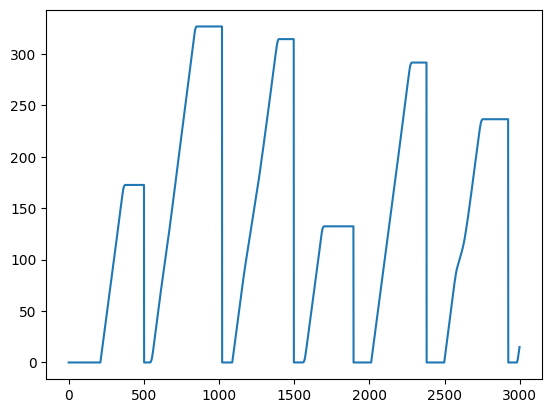

In [21]:
plt.plot(linear_velocity_label[:3000])

In [54]:
plt.set_cmap('jet')

<Figure size 2000x1000 with 0 Axes>

In [40]:
neuron_data[0][0].T[2].shape

(592539,)

In [50]:
neuron_data_smoothed.shape

(592539, 181)

In [1228]:
from sklearn.decomposition import PCA

In [1250]:
area = 'PFC'
area_mask = np.array([data['units'][0][unit_idx][7][0] for unit_idx in range(len(data['units'][0]))]) == area

In [1254]:
embds_model = PCA(n_components=30)
embds = embds_model.fit_transform(np.vstack(trials_neural)[:20000, area_mask])

In [1257]:
embds_model.explained_variance_ratio_

array([0.05435848, 0.04681765, 0.04472009, 0.04353568, 0.04241595,
       0.04043572, 0.03997302, 0.03897975, 0.03774739, 0.03651164,
       0.03459147, 0.03370959, 0.03335013, 0.03241901, 0.03131704,
       0.02942282, 0.02322457, 0.02255558, 0.02173859, 0.02028074,
       0.01903119, 0.0180828 , 0.01703237, 0.01643331, 0.01541398,
       0.01515231, 0.01271624, 0.01189329, 0.01123985, 0.01096559],
      dtype=float32)

In [58]:
%matplotlib notebook

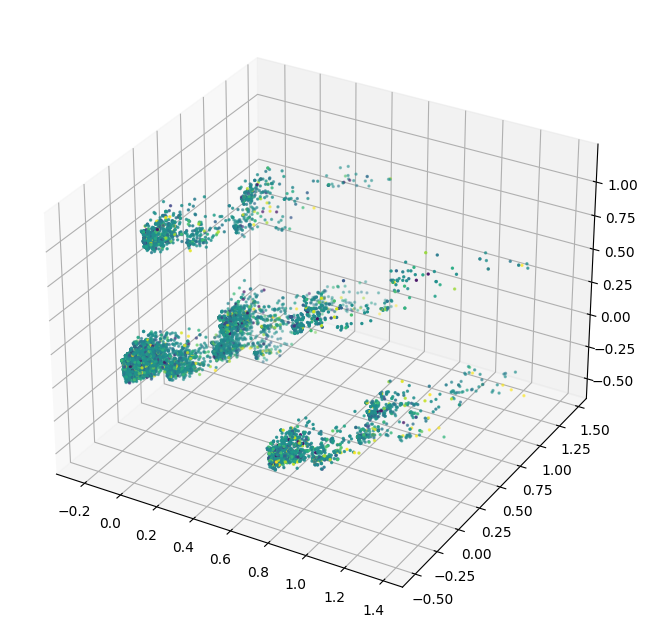

In [1253]:
xydata = embds[:, :3]
cdata = neuron_data[0][0].T[1][:20000]
ax = plt.figure(figsize=(10, 8)).add_subplot(projection='3d')
ax.scatter(*xydata.T, s=2, marker='o', c=cdata)

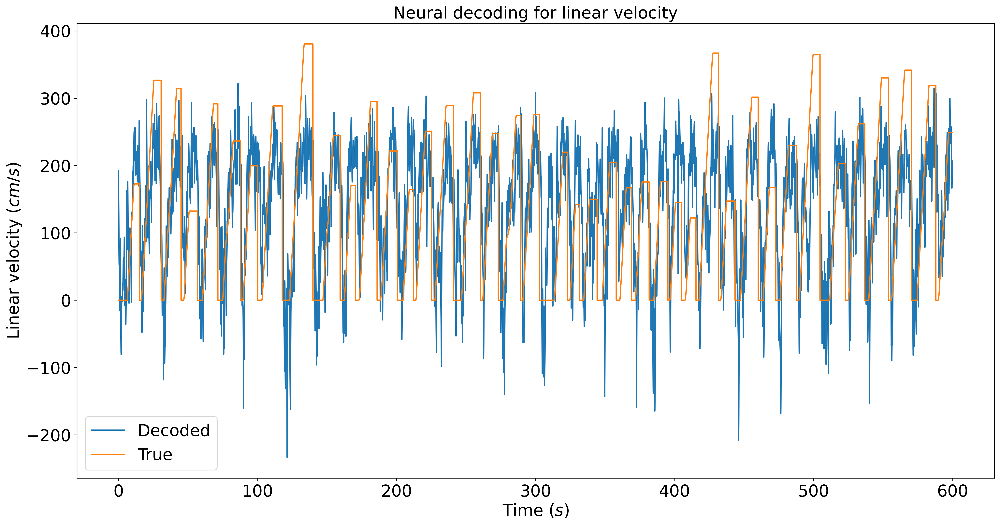

In [48]:
with initiate_plot(20,10,300):
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Neural decoding for linear velocity',fontsize=20)
    plt_config(xlabel='Time ($s$)', ylabel='Linear velocity ($cm/s$)')
    ax.plot(np.linspace(0,9999,20000)*0.06,prediction_linear_velocity[0][:20000],label = 'Decoded')
    ax.plot(np.linspace(0,9999,20000)*0.06,linear_velocity_label[:20000],label = 'True')
    ax.legend(fontsize=20)
    

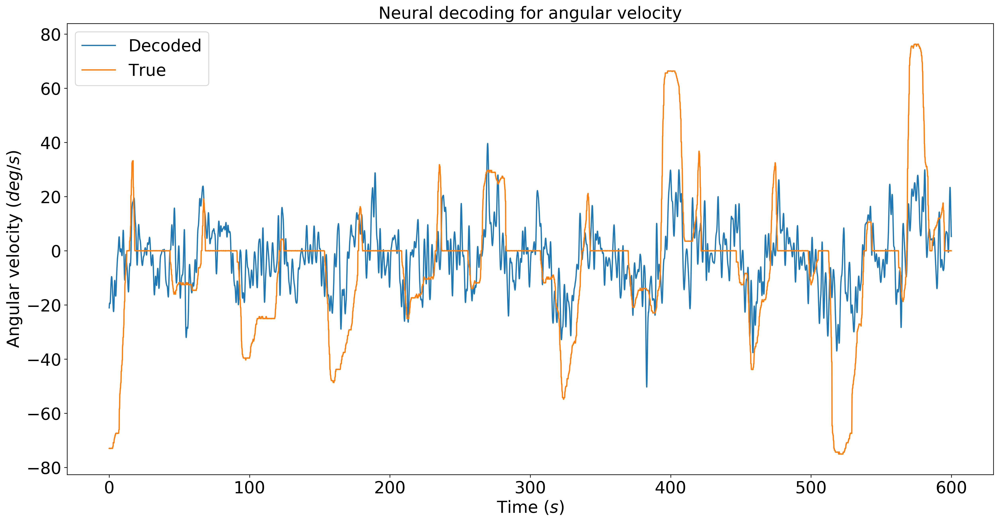

In [58]:
with initiate_plot(20,10,300):
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Neural decoding for angular velocity',fontsize=20)
    plt_config(xlabel='Time ($s$)', ylabel='Angular velocity ($deg/s$)')
    ax.plot(np.linspace(0,9999,5000)*0.06,prediction_angular_velocity[0][5000:10000],label = 'Decoded')
    ax.plot(np.linspace(0,9999,5000)*0.06,angular_velocity_label[5000:10000],label = 'True')
    ax.legend(fontsize=20)
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Neural_decoding_for_angular_velocity'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

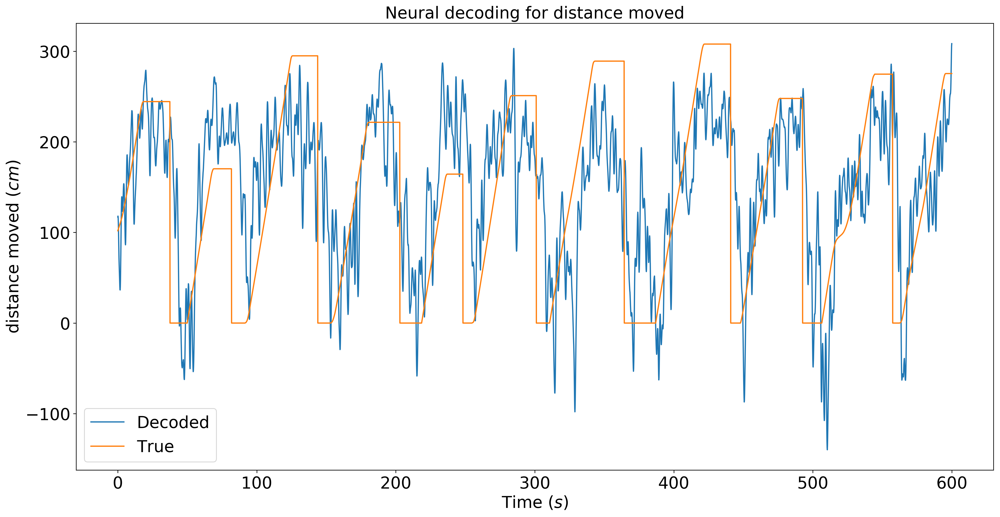

In [60]:
with initiate_plot(20,10,300):
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Neural decoding for distance moved',fontsize=20)
    plt_config(xlabel='Time ($s$)', ylabel='distance moved ($cm$)')
    ax.plot(np.linspace(0,9999,5000)*0.06,prediction_dist_moved[0][5000:10000],label = 'Decoded')
    ax.plot(np.linspace(0,9999,5000)*0.06,dist_moved_label[5000:10000],label = 'True')
    ax.legend(fontsize=20)
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Neural_decoding_for_distance_moved'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

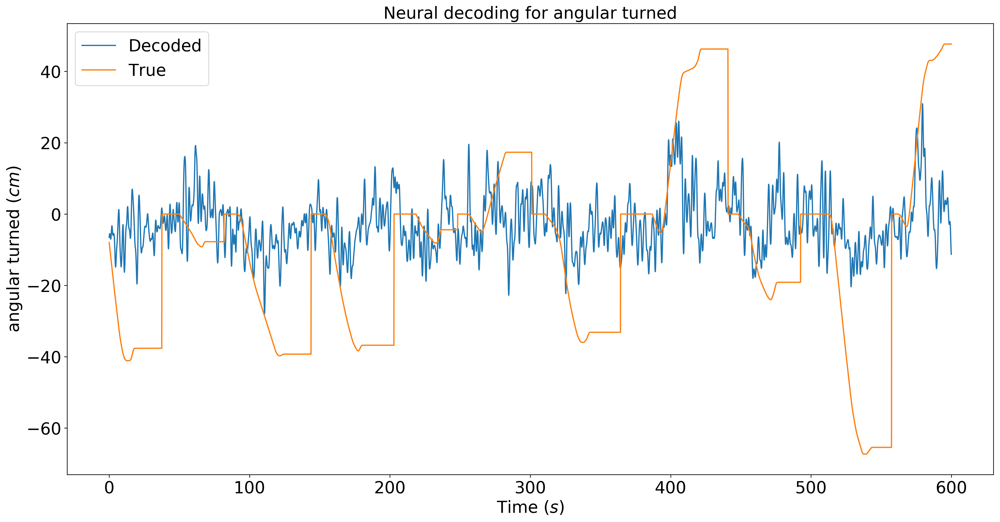

In [62]:
with initiate_plot(20,10,300):
    ax = fig.add_subplot(111)
    plt.xticks(fontsize=20)
    plt.yticks(fontsize=20)
    ax.set_xlabel(...,fontsize=20)
    ax.set_ylabel(...,fontsize=20)
    ax.set_title('Neural decoding for angular turned',fontsize=20)
    plt_config(xlabel='Time ($s$)', ylabel='angular turned ($cm$)')
    ax.plot(np.linspace(0,9999,5000)*0.06,prediction_angular_turned[0][5000:10000],label = 'Decoded')
    ax.plot(np.linspace(0,9999,5000)*0.06,angular_turned_label[5000:10000],label = 'True')
    ax.legend(fontsize=20)
    
    plt.savefig('C:/Users/rz31/Desktop/{name}.png'.format(name='Neural_decoding_for_angular_turned'), 
        dpi=None, facecolor='w', edgecolor='w',
        orientation='portrait', papertype=None, format='png',)

In [215]:
density_list = []
for i in range(len(x['trials_behv'][0])):
    density_list.append(trials_behv[i][3][0][0][4][0][0])

In [216]:
trials_behv[i][3][0][0][4][0][0]

0.195955

In [217]:
max(density_list)

1.960632

(array([187., 169., 132., 105.,  90.,  95.,  91.,  80.,  50.,  70.,  57.,
         55.,  29.,  29.,  39.,  30.,  27.,  28.,  15.,  18.,  16.,  20.,
         18.,  11.,  10.,   9.,   7.,   3.,   6.,   6.]),
 array([0.100061  , 0.16208003, 0.22409907, 0.2861181 , 0.34813713,
        0.41015617, 0.4721752 , 0.53419423, 0.59621327, 0.6582323 ,
        0.72025133, 0.78227037, 0.8442894 , 0.90630843, 0.96832747,
        1.0303465 , 1.09236553, 1.15438457, 1.2164036 , 1.27842263,
        1.34044167, 1.4024607 , 1.46447973, 1.52649877, 1.5885178 ,
        1.65053683, 1.71255587, 1.7745749 , 1.83659393, 1.89861297,
        1.960632  ]),
 <a list of 30 Patch objects>)

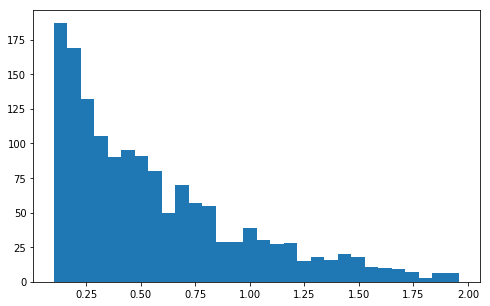

In [221]:
plt.hist(density_list, bins=30)